<a href="https://colab.research.google.com/github/TemmytheDA/Dog-and-Cat-Classification/blob/main/Dog%20and%20Cat%20Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Installing Packages and Call of Libraries

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.optim.lr_scheduler as lr_scheduler
from torch.optim.lr_scheduler import _LRScheduler
import torch.utils.data as data
import torchvision

import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision.models as models

from sklearn import decomposition
from sklearn import manifold
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from tqdm.notebook import tqdm, trange
import matplotlib.pyplot as plt
import numpy as np

import copy
from collections import namedtuple
import os
import random
import shutil
import time
import collections
import math
import pandas as pd

# Set Seed for Reproducibility





## Seed is set for the result to be reproducible



In [ ]:
SEED = 1234

random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.backends.cudnn.deterministic = True

# Loading the dataset

##Mount to Google drive and unpack your dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


# Exploratory data analysis & preprocessing

Image resizing and image augmentation

In [ ]:
batch_size = 32
transform_train = transforms.Compose([
    # Randomly crop the image to obtain an image with an area of 0.08 to 1 of
    # the original area and height-to-width ratio between 3/4 and 4/3. Then,
    # scale the image to create a new 224 x 224 image
    transforms.Resize((128,128)),
    torchvision.transforms.RandomResizedCrop(128, scale=(0.08, 1.0),
                                             ratio=(3.0/4.0, 4.0/3.0)),
    torchvision.transforms.RandomHorizontalFlip(),
    # Randomly change the brightness, contrast, and saturation
    torchvision.transforms.ColorJitter(brightness=0.4,
                                       contrast=0.4,
                                       saturation=0.4),
    # Add random noise
    transforms.ToTensor(),
    # Standardize each channel of the image
    transforms.Normalize([0.4720, 0.4377, 0.3980],
                                     [0.1948, 0.1929, 0.1911])
   ])

transform_test = transforms.Compose([
    transforms.Resize((128,128)),
    # Crop a 224 x 224 square area from the center of the image
    torchvision.transforms.CenterCrop(128),
    transforms.ToTensor(),
    transforms.Normalize([0.4720, 0.4377, 0.3980],
                                     [0.1948, 0.1929, 0.1911])
   ])

Reading the dataset

In [ ]:
data_dir = '/content/drive/MyDrive/'

train_ds, train_valid_ds = [datasets.ImageFolder(
    os.path.join(data_dir, 'Dogs-vs-Cats_Split', folder),
    transform=transform_train) for folder in ['train', 'train_valid']]

valid_ds, test_ds = [datasets.ImageFolder(
    os.path.join(data_dir, 'Dogs-vs-Cats_Split', folder),
    transform=transform_test) for folder in ['valid', 'test']]

In [ ]:
train_iter, train_valid_iter = [torch.utils.data.DataLoader(
    dataset, batch_size, shuffle=True, drop_last=True)
    for dataset in (train_ds, train_valid_ds)]

valid_iter = torch.utils.data.DataLoader(valid_ds, batch_size, shuffle=False,
                                         drop_last=True)

test_iter = torch.utils.data.DataLoader(test_ds, batch_size, shuffle=False,
                                        drop_last=False)

Checking the size of the dataset and display class

In [ ]:
train_dir_size = '/content/drive/MyDrive/Dogs-vs-Cats_Split/train'
train_cat_dir = os.path.join(train_dir_size, 'New Cats')
train_dog_dir = os.path.join(train_dir_size, 'New Dogs')

# Training images - Cats and Dogs
print(f"Total of training images: {len(os.listdir(train_cat_dir)) + len(os.listdir(train_dog_dir))}")
print(f"Of those, there are {len(os.listdir(train_cat_dir))} cat images and {len(os.listdir(train_dog_dir))} dog images. \n")

# Testing images - Cats and Dogs
test_dir_size = '/content/drive/MyDrive/Dogs-vs-Cats_Split/test_size'
test_cat_dir = os.path.join(test_dir_size, 'New Cats')
test_dog_dir = os.path.join(test_dir_size, 'New Dogs')

print(f"Total of testing images: {len(os.listdir(test_cat_dir)) + len(os.listdir(test_dog_dir))}")
print(f"Of those, there are {len(os.listdir(test_cat_dir))} cat images and {len(os.listdir(test_dog_dir))} dog images. \n")

# Validating images - Cats and Dogs
valid_dir_size = '/content/drive/MyDrive/Dogs-vs-Cats_Split/test_size'
valid_cat_dir = os.path.join(valid_dir_size, 'New Cats')
valid_dog_dir = os.path.join(valid_dir_size, 'New Dogs')

print(f"Total of validating images: {len(os.listdir(test_cat_dir)) + len(os.listdir(test_dog_dir))}")
print(f"Of those, there are {len(os.listdir(test_cat_dir))} cat images and {len(os.listdir(test_dog_dir))} dog images. \n")

Total of training images: 1200
Of those, there are 600 cat images and 600 dog images. 

Total of testing images: 400
Of those, there are 200 cat images and 200 dog images. 

Total of validating images: 400
Of those, there are 200 cat images and 200 dog images. 



A stack bar plot displaying the numbers of images in each set and class.

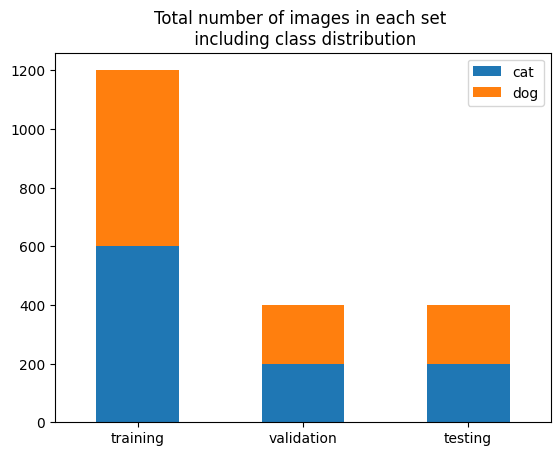

In [ ]:
num_training_cat = len(os.listdir(train_cat_dir))
num_validation_cat = len(os.listdir(valid_cat_dir))
num_testing_cat = len(os.listdir(test_cat_dir))

num_training_dog = len(os.listdir(train_cat_dir))
num_validation_dog = len(os.listdir(valid_dog_dir))
num_testing_dog = len(os.listdir(test_cat_dir))

totals_df = pd.DataFrame({
    'cat': [num_training_cat, num_validation_cat, num_testing_cat],
    'dog': [num_training_dog, num_validation_dog, num_testing_dog]
}, index=['training', 'validation', 'testing'])

ax = totals_df.plot(kind='bar', stacked=True, title="Total number of images in each set \n including class distribution")
ax.set_xticklabels(ax.get_xticklabels(), rotation=0);

Additional code used to calculate the mean and standard deviation values required for transforms.

In [ ]:
# means = torch.zeros(3)
# stds = torch.zeros(3)

# for img, label in train_ds:
#     means += torch.mean(img, dim = (1,2))
#     stds += torch.std(img, dim = (1,2))

# means /= len(train_ds)
# stds /= len(train_ds)

# print(f'Calculated means: {means}')
# print(f'Calculated stds: {stds}')

# Selection of images and their labels for viewing.

Show image - display some of your images for observation.

In [ ]:
def normalize_image(image):
    image_min = image.min()
    image_max = image.max()
    image.clamp_(min = image_min, max = image_max)
    image.add_(-image_min).div_(image_max - image_min + 1e-5)
    return image

def plot_images(images, labels, classes, normalize = True):

    n_images = len(images)

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (15, 15))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image = images[i]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.permute(1, 2, 0).cpu().numpy())
        label = classes[labels[i]]
        ax.set_title(label)
        ax.axis('off')

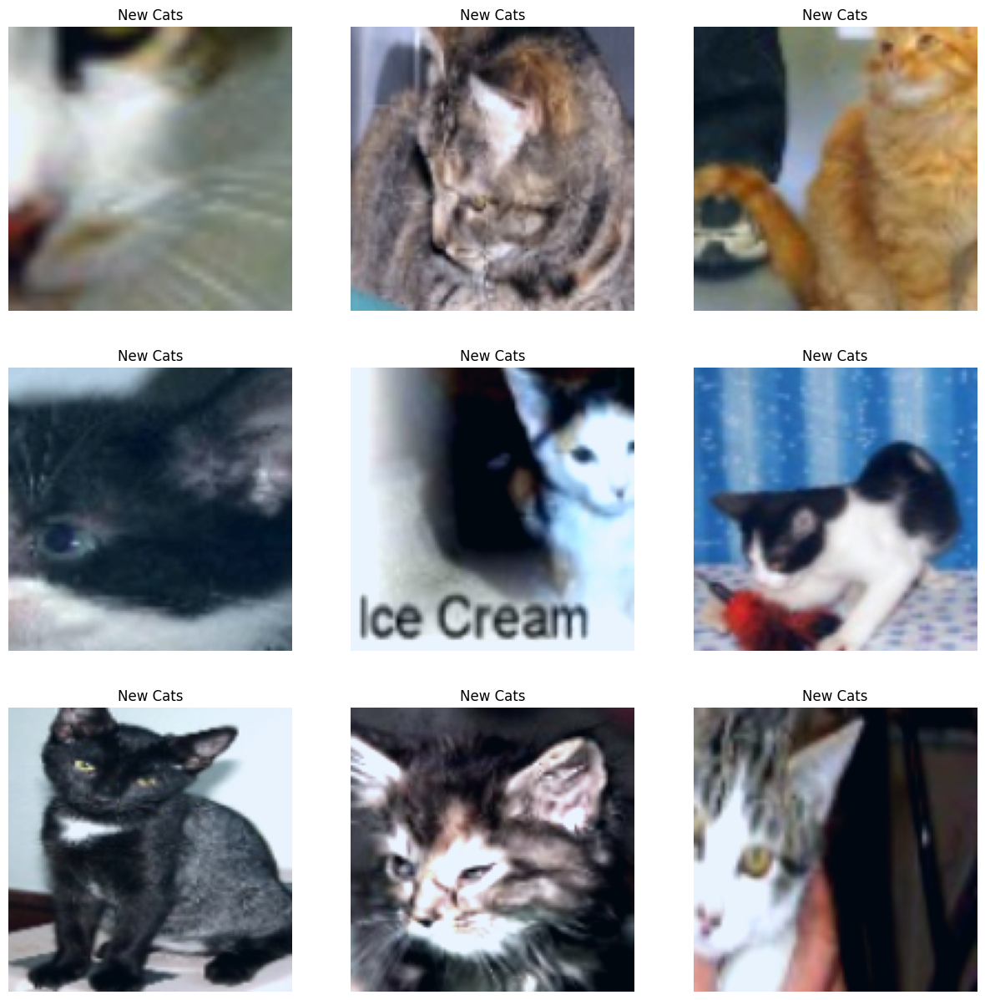

In [ ]:
# Observation of train images and their lebels
N_IMAGES = 10

images, labels = zip(*[(image, label) for image, label in
                           [train_ds[i] for i in range(N_IMAGES)]])

classes = train_ds.classes

plot_images(images, labels, classes)

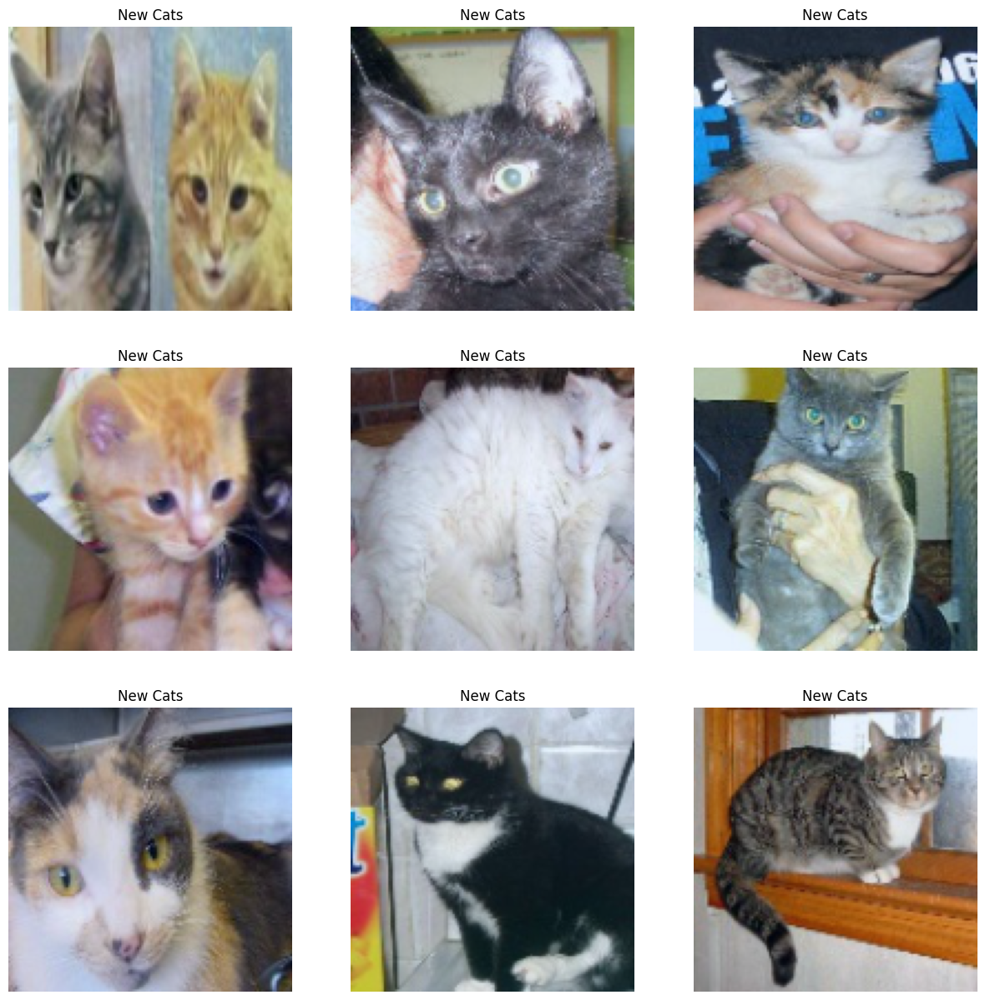

In [ ]:
# Observation of valid images and their lebels
N_IMAGES = 10

images, labels = zip(*[(image, label) for image, label in [valid_ds[i] for i in range(N_IMAGES)]])

classes = valid_ds.classes

plot_images(images, labels, classes)

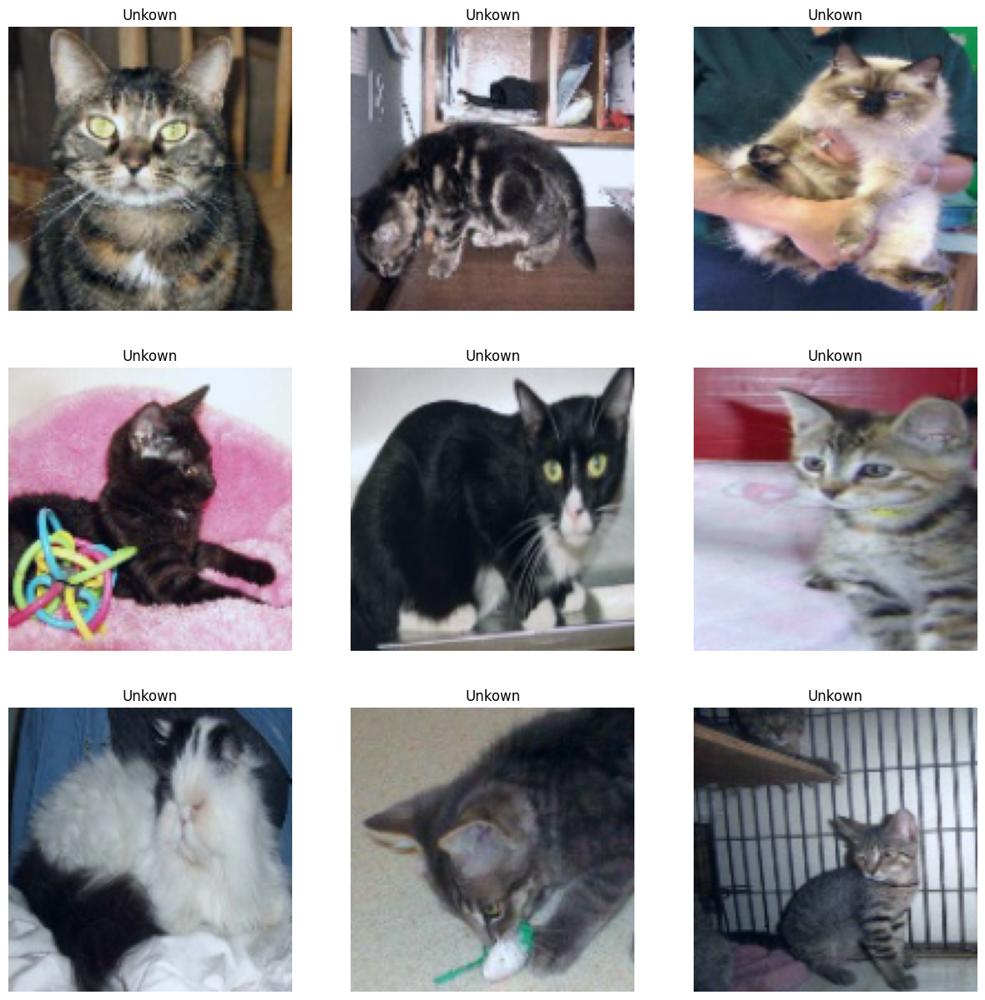

In [ ]:
# Observation of test images and their lebels
N_IMAGES = 10

images, labels = zip(*[(image, label) for image, label in [test_ds[i] for i in range(N_IMAGES)]])

classes = test_ds.classes

plot_images(images, labels, classes)

# Define the CNN Pretrained Model Class - ResNet

## Defining the CNN - ResNet and its variation.


In [ ]:
class ResNet(nn.Module):
    def __init__(self, config, output_dim):
        super().__init__()

        block, n_blocks, channels = config
        self.in_channels = channels[0]

        assert len(n_blocks) == len(channels) == 4

        self.conv1 = nn.Conv2d(3, self.in_channels, kernel_size = 7, stride = 2, padding = 3, bias = False)
        self.bn1 = nn.BatchNorm2d(self.in_channels)
        self.relu = nn.ReLU(inplace = True)
        self.maxpool = nn.MaxPool2d(kernel_size = 3, stride = 2, padding = 1)

        self.layer1 = self.get_resnet_layer(block, n_blocks[0], channels[0])
        self.layer2 = self.get_resnet_layer(block, n_blocks[1], channels[1], stride = 2)
        self.layer3 = self.get_resnet_layer(block, n_blocks[2], channels[2], stride = 2)
        self.layer4 = self.get_resnet_layer(block, n_blocks[3], channels[3], stride = 2)

        self.avgpool = nn.AdaptiveAvgPool2d((1,1))
        self.fc = nn.Linear(self.in_channels, output_dim)

    def get_resnet_layer(self, block, n_blocks, channels, stride = 1):

        layers = []

        if self.in_channels != block.expansion * channels:
            downsample = True
        else:
            downsample = False

        layers.append(block(self.in_channels, channels, stride, downsample))

        for i in range(1, n_blocks):
            layers.append(block(block.expansion * channels, channels))

        self.in_channels = block.expansion * channels

        return nn.Sequential(*layers)

    def forward(self, x):

        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.avgpool(x)
        h = x.view(x.shape[0], -1)
        x = self.fc(h)

        return x, h

class BasicBlock(nn.Module):

    expansion = 1

    def __init__(self, in_channels, out_channels, stride = 1, downsample = False):
        super().__init__()

        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size = 3,
                               stride = stride, padding = 1, bias = False)
        self.bn1 = nn.BatchNorm2d(out_channels)

        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size = 3,
                               stride = 1, padding = 1, bias = False)
        self.bn2 = nn.BatchNorm2d(out_channels)

        self.relu = nn.ReLU(inplace = True)

        if downsample:
            conv = nn.Conv2d(in_channels, out_channels, kernel_size = 1,
                             stride = stride, bias = False)
            bn = nn.BatchNorm2d(out_channels)
            downsample = nn.Sequential(conv, bn)
        else:
            downsample = None

        self.downsample = downsample

    def forward(self, x):

        i = x

        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)

        x = self.conv2(x)
        x = self.bn2(x)

        if self.downsample is not None:
            i = self.downsample(i)

        x += i
        x = self.relu(x)

        return x

ResNetConfig = namedtuple('ResNetConfig', ['block', 'n_blocks', 'channels'])
resnet18_config = ResNetConfig(block = BasicBlock,
                               n_blocks = [2,2,2,2],
                               channels = [64, 128, 256, 512])

resnet34_config = ResNetConfig(block = BasicBlock,
                               n_blocks = [3,4,6,3],
                               channels = [64, 128, 256, 512])

class Bottleneck(nn.Module):

    expansion = 4

    def __init__(self, in_channels, out_channels, stride = 1, downsample = False):
        super().__init__()

        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size = 1,
                               stride = 1, bias = False)
        self.bn1 = nn.BatchNorm2d(out_channels)

        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size = 3,
                               stride = stride, padding = 1, bias = False)
        self.bn2 = nn.BatchNorm2d(out_channels)

        self.conv3 = nn.Conv2d(out_channels, self.expansion * out_channels, kernel_size = 1,
                               stride = 1, bias = False)
        self.bn3 = nn.BatchNorm2d(self.expansion * out_channels)

        self.relu = nn.ReLU(inplace = True)

        if downsample:
            conv = nn.Conv2d(in_channels, self.expansion * out_channels, kernel_size = 1,
                             stride = stride, bias = False)
            bn = nn.BatchNorm2d(self.expansion * out_channels)
            downsample = nn.Sequential(conv, bn)
        else:
            downsample = None

        self.downsample = downsample

    def forward(self, x):

        i = x

        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)

        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)

        x = self.conv3(x)
        x = self.bn3(x)

        if self.downsample is not None:
            i = self.downsample(i)

        x += i
        x = self.relu(x)

        return x

resnet50_config = ResNetConfig(block = Bottleneck,
                               n_blocks = [3, 4, 6, 3],
                               channels = [64, 128, 256, 512])

resnet101_config = ResNetConfig(block = Bottleneck,
                                n_blocks = [3, 4, 23, 3],
                                channels = [64, 128, 256, 512])

resnet152_config = ResNetConfig(block = Bottleneck,
                                n_blocks = [3, 8, 36, 3],
                                channels = [64, 128, 256, 512])

# Experimentation

## Pre-existing deep learning algorithms and optimizer

### Testing a selection of architectures

#### ResNet50 with optimization

HERE you can start to define your model, you can use different resnet for your work.

In [ ]:
pretrained_model = models.resnet50(pretrained = True)
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(train_ds.classes)

fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)
pretrained_model.fc = fc
model = ResNet(resnet50_config, OUTPUT_DIM)
model.load_state_dict(pretrained_model.state_dict())

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 218MB/s]


<All keys matched successfully>

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,512,130 trainable parameters


##### Adam Optimizer

###### Adam Optimizer and lr = 0.01

Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-2

params = [
          {'params': model.conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.fc.parameters()}
         ]

optimizer = optim.Adam(params, lr = FOUND_LR)

In [ ]:
EPOCHS = 30
STEPS_PER_EPOCH = len(train_iter)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [ ]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, acc_k

In [ ]:
def train(model, iterator, optimizer, criterion, scheduler, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()


    for (x, y) in iterator:

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        scheduler.step()

        epoch_loss += loss.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_acc = []
valid_acc = []

best_valid_acc_1 = 0  # Track the best validation top-1 accuracy
best_train_acc_1 = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')
#best_valid_acc_1 = float('inf')
#best_train_acc_1 = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iter, optimizer, criterion, scheduler, device)
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_acc.append(train_acc_1)
    valid_acc.append(valid_acc_1)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc_1 > best_valid_acc_1:
        best_valid_acc_1 = valid_acc_1
    if train_acc_1 > best_train_acc_1:
        best_train_acc_1 = train_acc_1
        print(epoch)
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

0
Epoch: 01 | Epoch Time: 3m 44s
	Train Loss: 0.348 | Train Acc @1:  85.14% | Train Acc @5: 100.00%
	Valid Loss: 0.452 | Valid Acc @1:  86.46% | Valid Acc @5: 100.00%
1
Epoch: 02 | Epoch Time: 0m 12s
	Train Loss: 0.236 | Train Acc @1:  90.29% | Train Acc @5: 100.00%
	Valid Loss: 0.421 | Valid Acc @1:  88.28% | Valid Acc @5: 100.00%
Epoch: 03 | Epoch Time: 0m 11s
	Train Loss: 0.324 | Train Acc @1:  85.56% | Train Acc @5: 100.00%
	Valid Loss: 0.304 | Valid Acc @1:  90.10% | Valid Acc @5: 100.00%
Epoch: 04 | Epoch Time: 0m 10s
	Train Loss: 0.352 | Train Acc @1:  85.05% | Train Acc @5: 100.00%
	Valid Loss: 2.220 | Valid Acc @1:  69.53% | Valid Acc @5: 100.00%
Epoch: 05 | Epoch Time: 0m 10s
	Train Loss: 0.602 | Train Acc @1:  72.72% | Train Acc @5: 100.00%
	Valid Loss: 2.425 | Valid Acc @1:  52.60% | Valid Acc @5: 100.00%
Epoch: 06 | Epoch Time: 0m 10s
	Train Loss: 1.010 | Train Acc @1:  52.96% | Train Acc @5: 100.00%
	Valid Loss: 18.450 | Valid Acc @1:  51.56% | Valid Acc @5: 100.00%
Epoch

In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc_1 * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc_1 * 100))

Lowest valid_loss: 30.36%
Best valid_Acc: 90.10%
Lowest train_loss: 23.55%
Best train_Acc: 90.29%


Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.01 - Train and Valid Loss Plot')

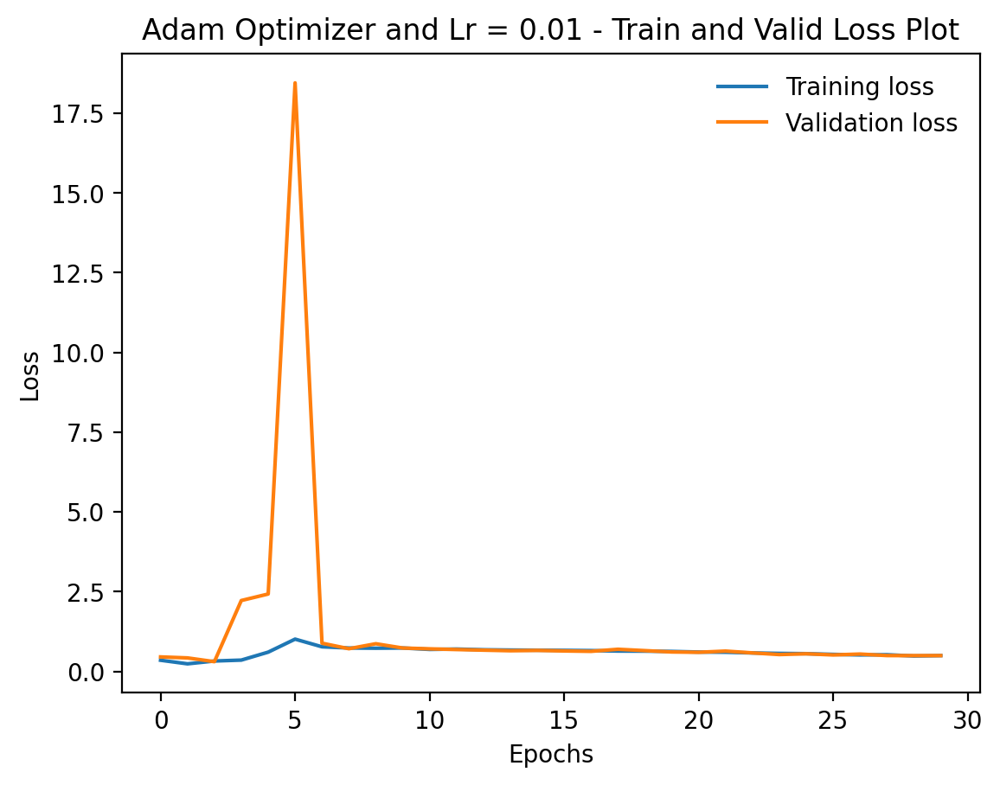

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.01 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.01 - Train and Valid Accuracy Plot')

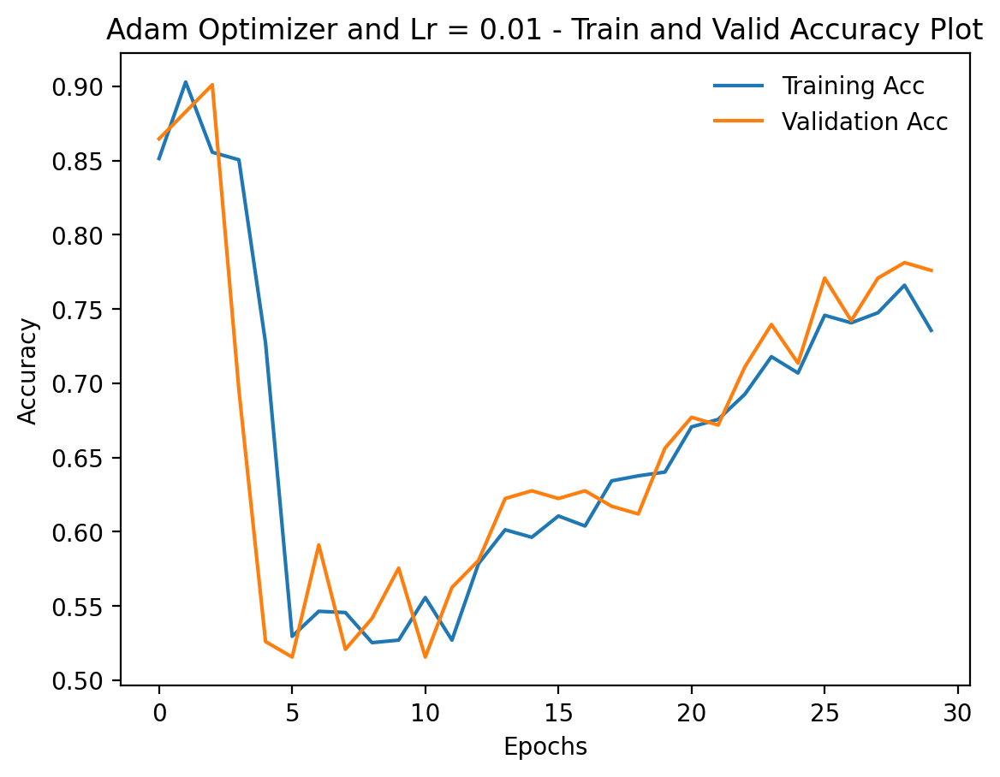

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_acc, label='Training Acc')
plt.plot(valid_acc, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.01 - Train and Valid Accuracy Plot")

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

Loading the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

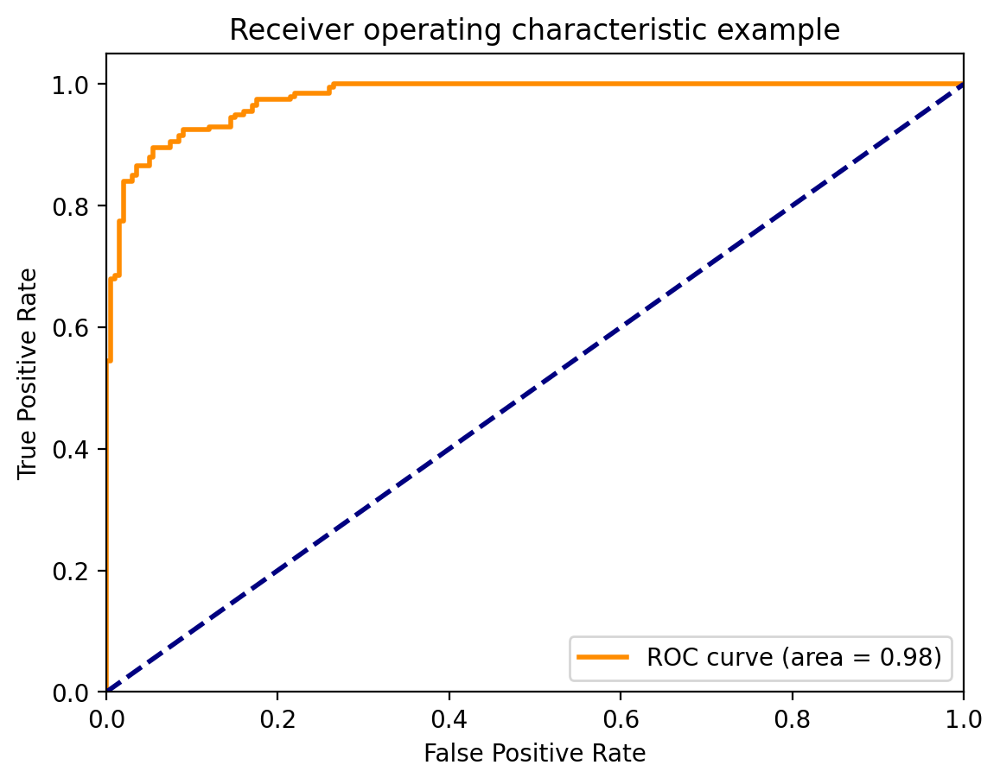

<ipython-input-32-056648a226ce>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


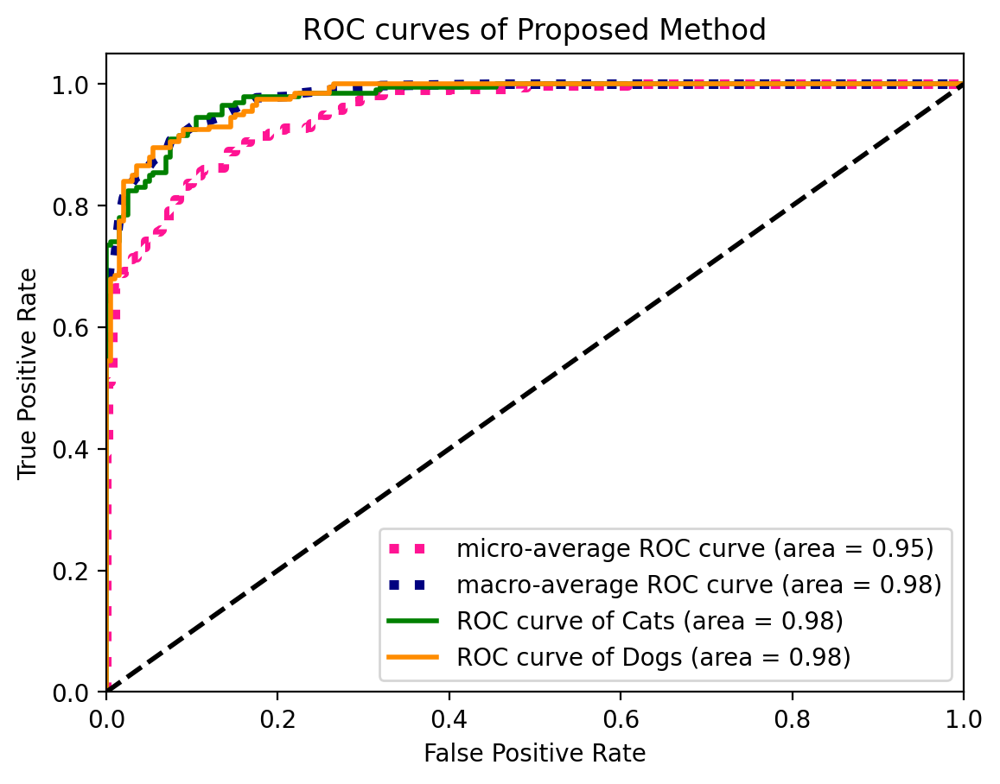

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Cats (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Dogs (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[148  52]
 [  3 197]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


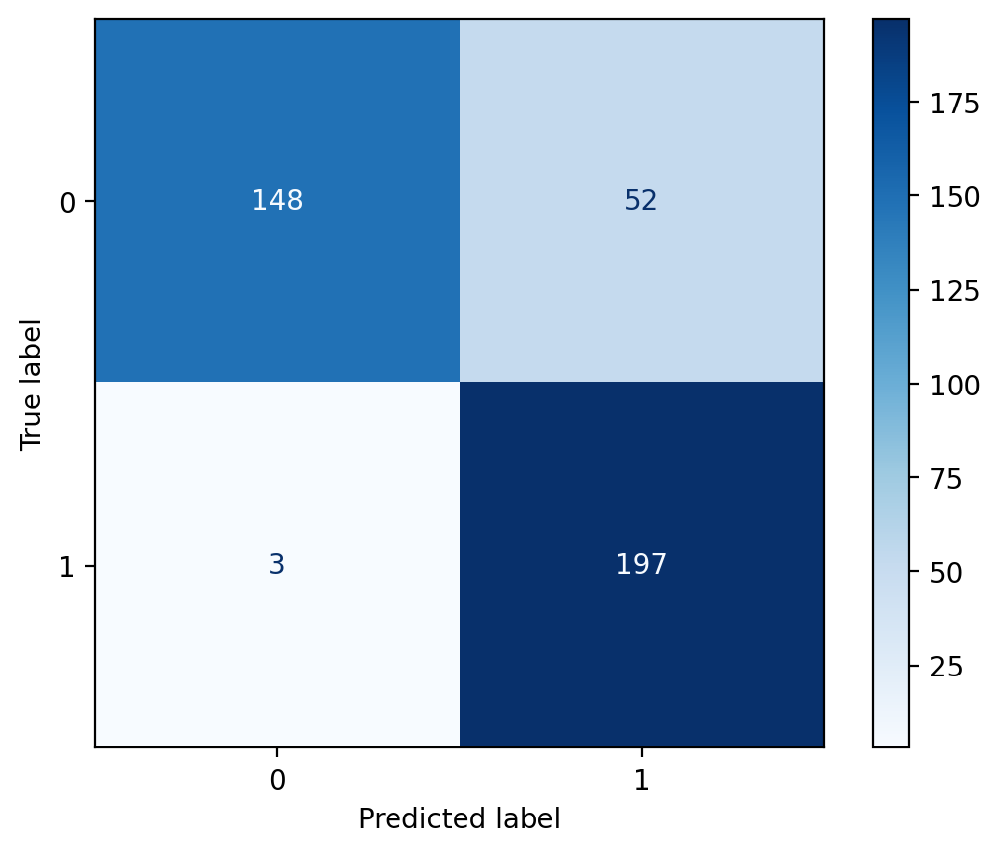

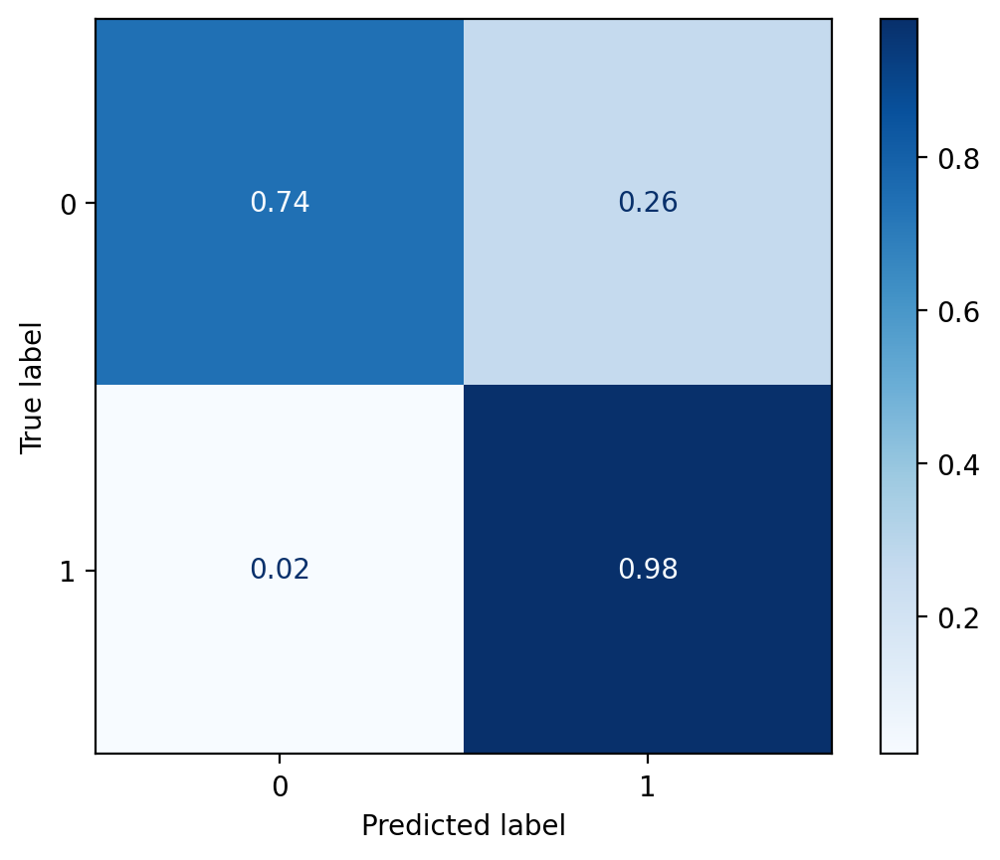

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.98, Recall: 0.74, F1_score: 0.84, Specificity: 0.98


###### Adam Optimizer and lr = 0.001

In [ ]:
pretrained_model = models.resnet50(pretrained = True)
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(train_ds.classes)

fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)
pretrained_model.fc = fc
model = ResNet(resnet50_config, OUTPUT_DIM)
model.load_state_dict(pretrained_model.state_dict())

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


<All keys matched successfully>

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,512,130 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-3

params = [
          {'params': model.conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.fc.parameters()}
         ]

optimizer = optim.Adam(params, lr = FOUND_LR)

In [ ]:
EPOCHS = 30
STEPS_PER_EPOCH = len(train_iter)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [ ]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, acc_k

In [ ]:
def train(model, iterator, optimizer, criterion, scheduler, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()


    for (x, y) in iterator:

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        scheduler.step()

        epoch_loss += loss.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_acc = []
valid_acc = []

best_valid_acc_1 = 0  # Track the best validation top-1 accuracy
best_train_acc_1 = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')
#best_valid_acc_1 = float('inf')
#best_train_acc_1 = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iter, optimizer, criterion, scheduler, device)
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_acc.append(train_acc_1)
    valid_acc.append(valid_acc_1)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc_1 > best_valid_acc_1:
        best_valid_acc_1 = valid_acc_1
    if train_acc_1 > best_train_acc_1:
        best_train_acc_1 = train_acc_1
        print(epoch)
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

0
Epoch: 01 | Epoch Time: 0m 11s
	Train Loss: 0.447 | Train Acc @1:  80.74% | Train Acc @5: 100.00%
	Valid Loss: 0.119 | Valid Acc @1:  95.05% | Valid Acc @5: 100.00%
1
Epoch: 02 | Epoch Time: 0m 11s
	Train Loss: 0.226 | Train Acc @1:  91.30% | Train Acc @5: 100.00%
	Valid Loss: 0.091 | Valid Acc @1:  96.35% | Valid Acc @5: 100.00%
2
Epoch: 03 | Epoch Time: 0m 11s
	Train Loss: 0.173 | Train Acc @1:  92.31% | Train Acc @5: 100.00%
	Valid Loss: 0.122 | Valid Acc @1:  96.09% | Valid Acc @5: 100.00%
3
Epoch: 04 | Epoch Time: 0m 11s
	Train Loss: 0.163 | Train Acc @1:  92.74% | Train Acc @5: 100.00%
	Valid Loss: 0.145 | Valid Acc @1:  94.79% | Valid Acc @5: 100.00%
Epoch: 05 | Epoch Time: 0m 10s
	Train Loss: 0.203 | Train Acc @1:  90.62% | Train Acc @5: 100.00%
	Valid Loss: 0.378 | Valid Acc @1:  87.76% | Valid Acc @5: 100.00%
Epoch: 06 | Epoch Time: 0m 10s
	Train Loss: 0.213 | Train Acc @1:  90.46% | Train Acc @5: 100.00%
	Valid Loss: 0.099 | Valid Acc @1:  96.88% | Valid Acc @5: 100.00%
Ep

In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc_1 * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc_1 * 100))

Lowest valid_loss: 9.13%
Best valid_Acc: 96.88%
Lowest train_loss: 5.39%
Best train_Acc: 97.89%


Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.001 - Train and Valid Loss Plot')

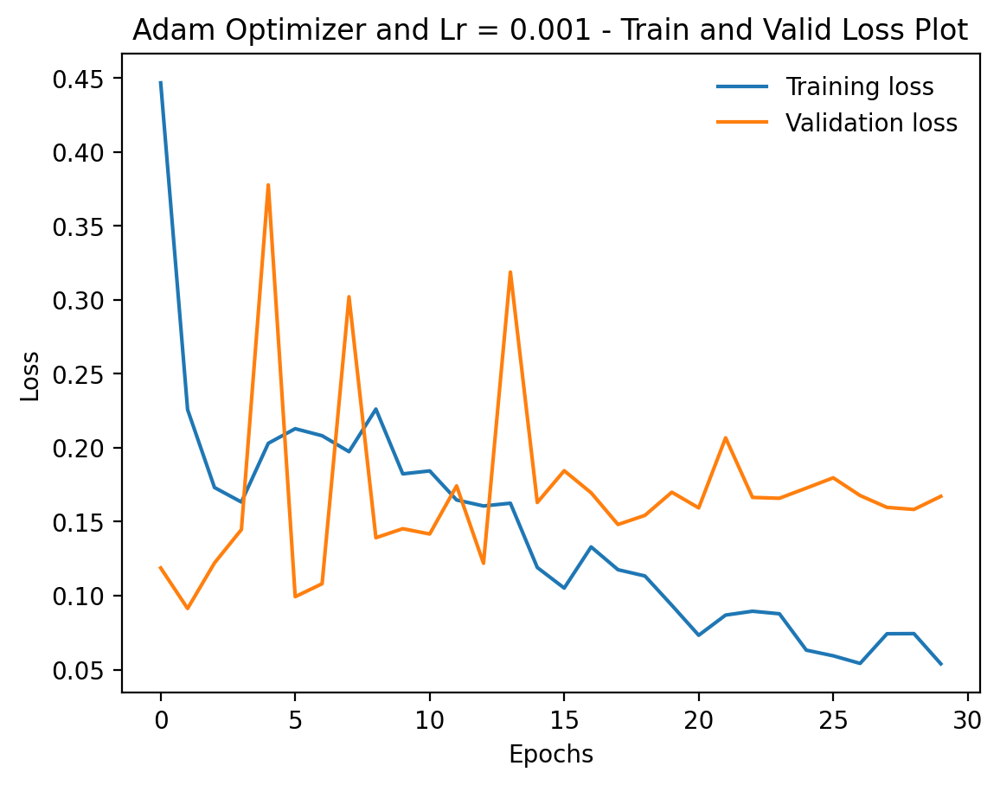

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.001 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.001 - Train and Valid Accuracy Plot')

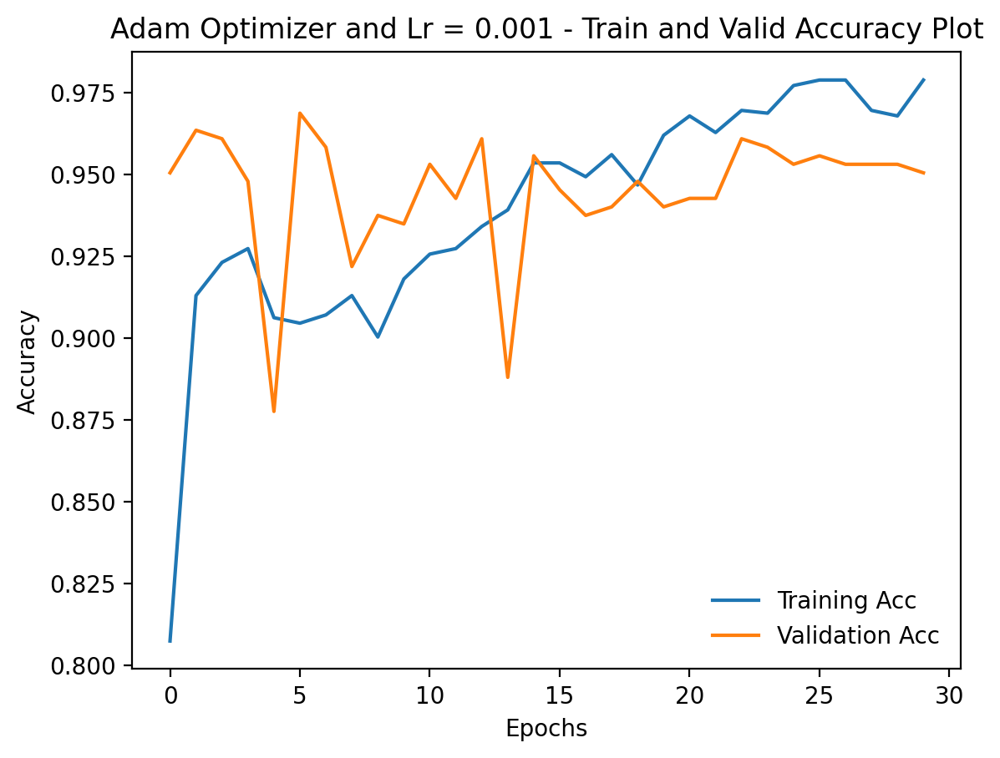

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_acc, label='Training Acc')
plt.plot(valid_acc, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.001 - Train and Valid Accuracy Plot")

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

Loading the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

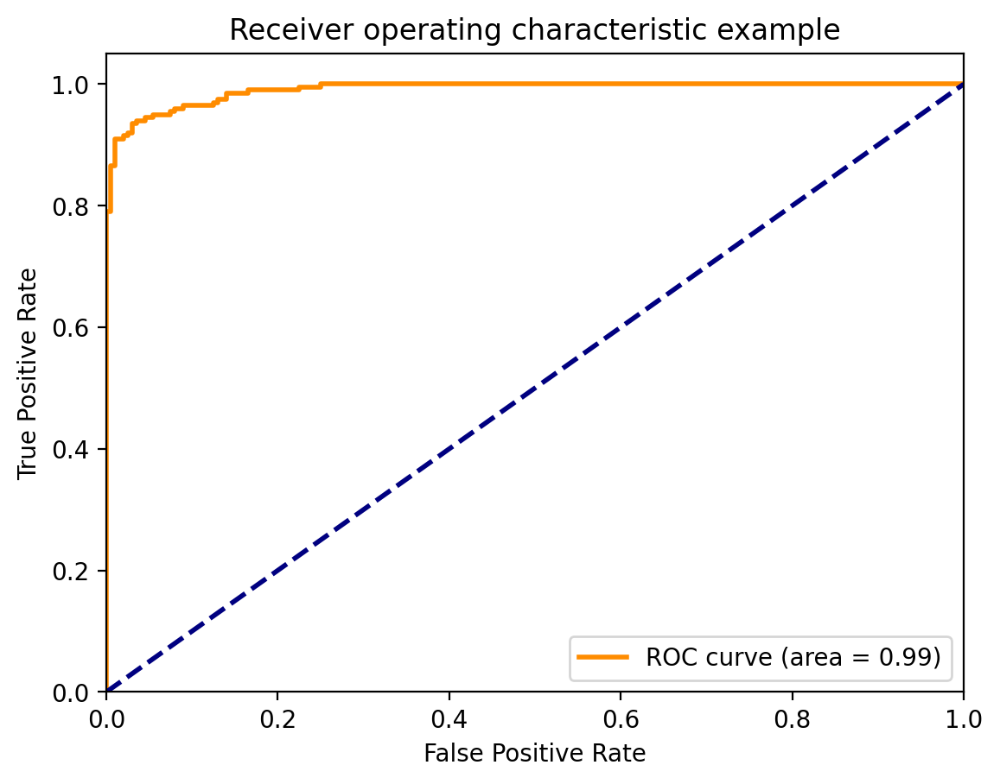

<ipython-input-51-056648a226ce>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


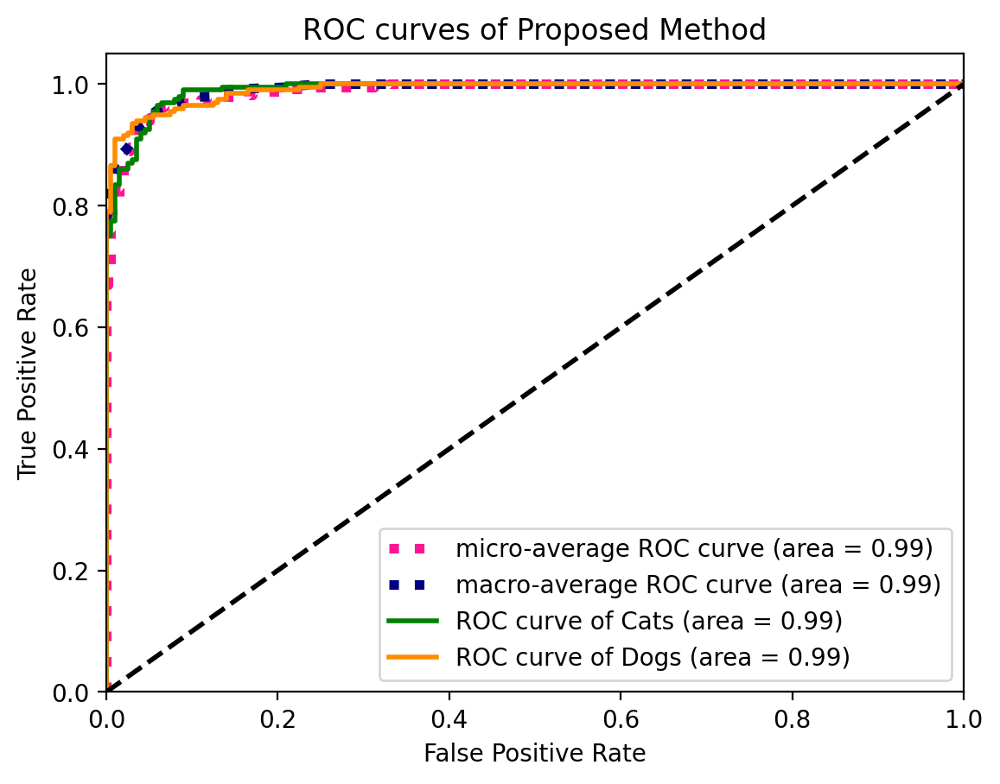

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Cats (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Dogs (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[195   5]
 [ 17 183]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


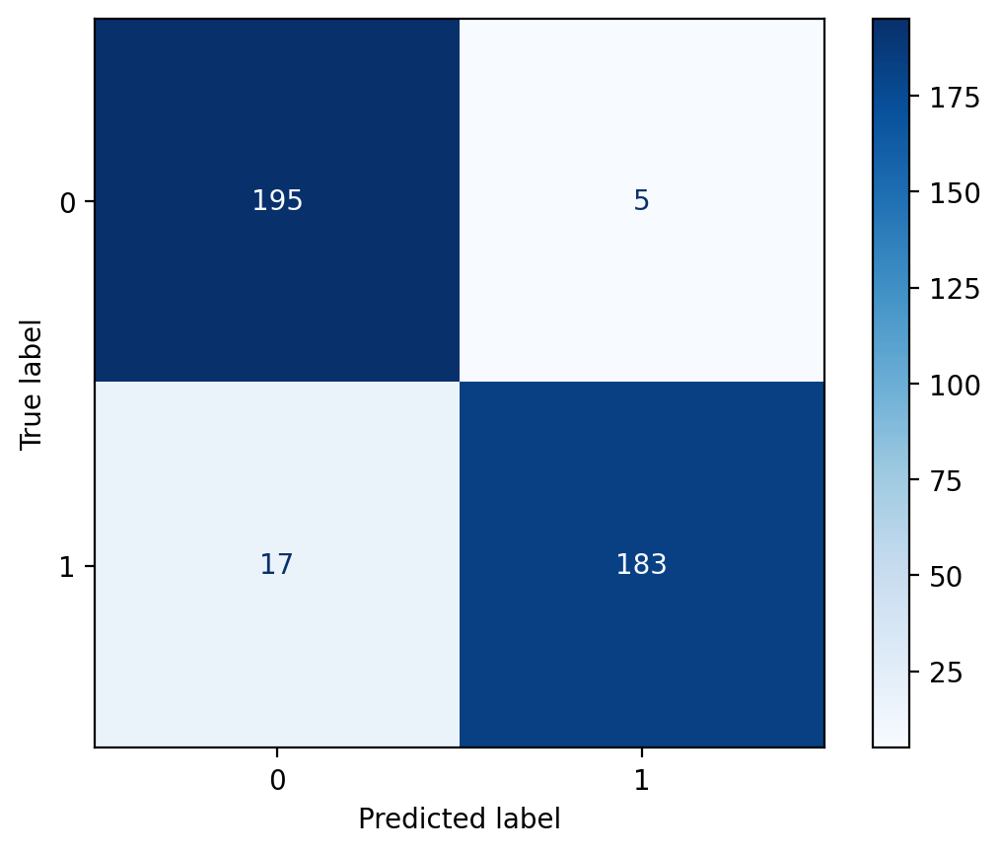

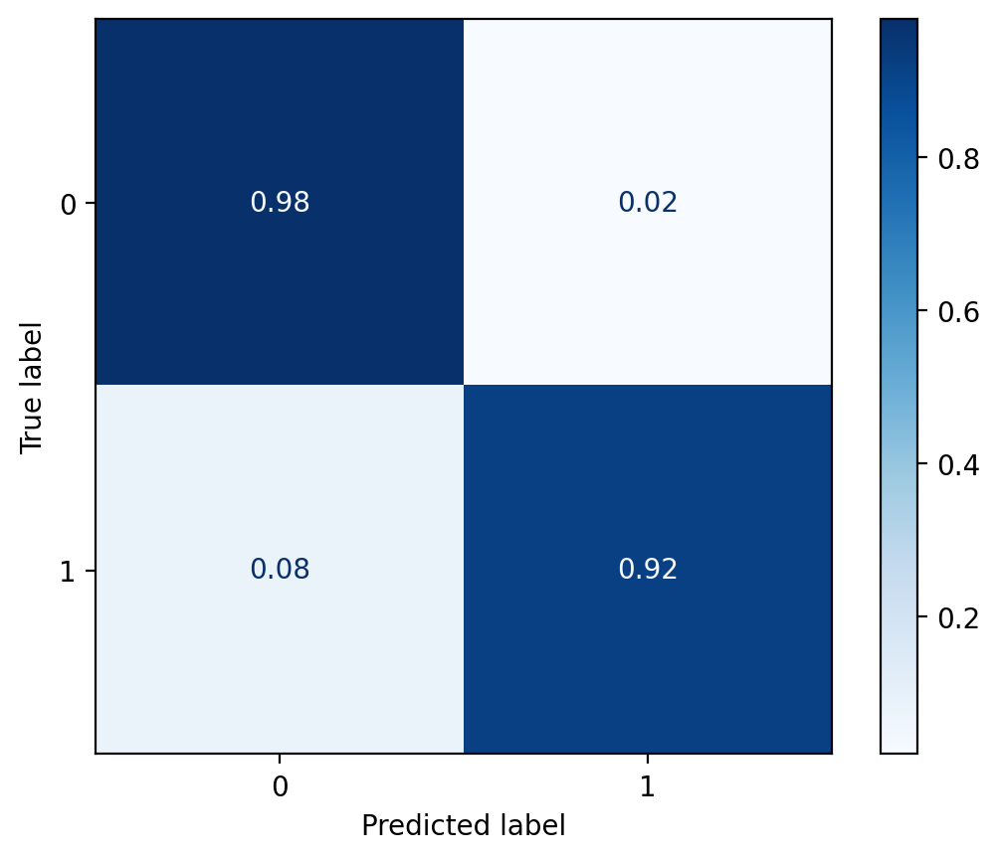

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.92, Recall: 0.97, F1_score: 0.95, Specificity: 0.92


###### Adam Optimizer and lr = 0.0001

In [ ]:
pretrained_model = models.resnet50(pretrained = True)
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(train_ds.classes)

fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)
pretrained_model.fc = fc
model = ResNet(resnet50_config, OUTPUT_DIM)
model.load_state_dict(pretrained_model.state_dict())

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


<All keys matched successfully>

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,512,130 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-4

params = [
          {'params': model.conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.fc.parameters()}
         ]

optimizer = optim.Adam(params, lr = FOUND_LR)

In [ ]:
EPOCHS = 30
STEPS_PER_EPOCH = len(train_iter)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [ ]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, acc_k

In [ ]:
def train(model, iterator, optimizer, criterion, scheduler, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()


    for (x, y) in iterator:

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        scheduler.step()

        epoch_loss += loss.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_acc = []
valid_acc = []

best_valid_acc_1 = 0  # Track the best validation top-1 accuracy
best_train_acc_1 = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')
#best_valid_acc_1 = float('inf')
#best_train_acc_1 = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iter, optimizer, criterion, scheduler, device)
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_acc.append(train_acc_1)
    valid_acc.append(valid_acc_1)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc_1 > best_valid_acc_1:
        best_valid_acc_1 = valid_acc_1
    if train_acc_1 > best_train_acc_1:
        best_train_acc_1 = train_acc_1
        print(epoch)
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

0
Epoch: 01 | Epoch Time: 0m 11s
	Train Loss: 0.637 | Train Acc @1:  63.01% | Train Acc @5: 100.00%
	Valid Loss: 0.523 | Valid Acc @1:  79.69% | Valid Acc @5: 100.00%
1
Epoch: 02 | Epoch Time: 0m 11s
	Train Loss: 0.515 | Train Acc @1:  80.66% | Train Acc @5: 100.00%
	Valid Loss: 0.321 | Valid Acc @1:  94.53% | Valid Acc @5: 100.00%
2
Epoch: 03 | Epoch Time: 0m 11s
	Train Loss: 0.371 | Train Acc @1:  86.40% | Train Acc @5: 100.00%
	Valid Loss: 0.175 | Valid Acc @1:  95.83% | Valid Acc @5: 100.00%
3
Epoch: 04 | Epoch Time: 0m 11s
	Train Loss: 0.256 | Train Acc @1:  90.54% | Train Acc @5: 100.00%
	Valid Loss: 0.118 | Valid Acc @1:  95.31% | Valid Acc @5: 100.00%
4
Epoch: 05 | Epoch Time: 0m 10s
	Train Loss: 0.207 | Train Acc @1:  90.96% | Train Acc @5: 100.00%
	Valid Loss: 0.087 | Valid Acc @1:  96.61% | Valid Acc @5: 100.00%
5
Epoch: 06 | Epoch Time: 0m 10s
	Train Loss: 0.194 | Train Acc @1:  91.39% | Train Acc @5: 100.00%
	Valid Loss: 0.092 | Valid Acc @1:  96.61% | Valid Acc @5: 100.00

In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc_1 * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc_1 * 100))

Lowest valid_loss: 7.30%
Best valid_Acc: 97.40%
Lowest train_loss: 4.83%
Best train_Acc: 98.06%


Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.0001 - Train and Valid Loss Plot')

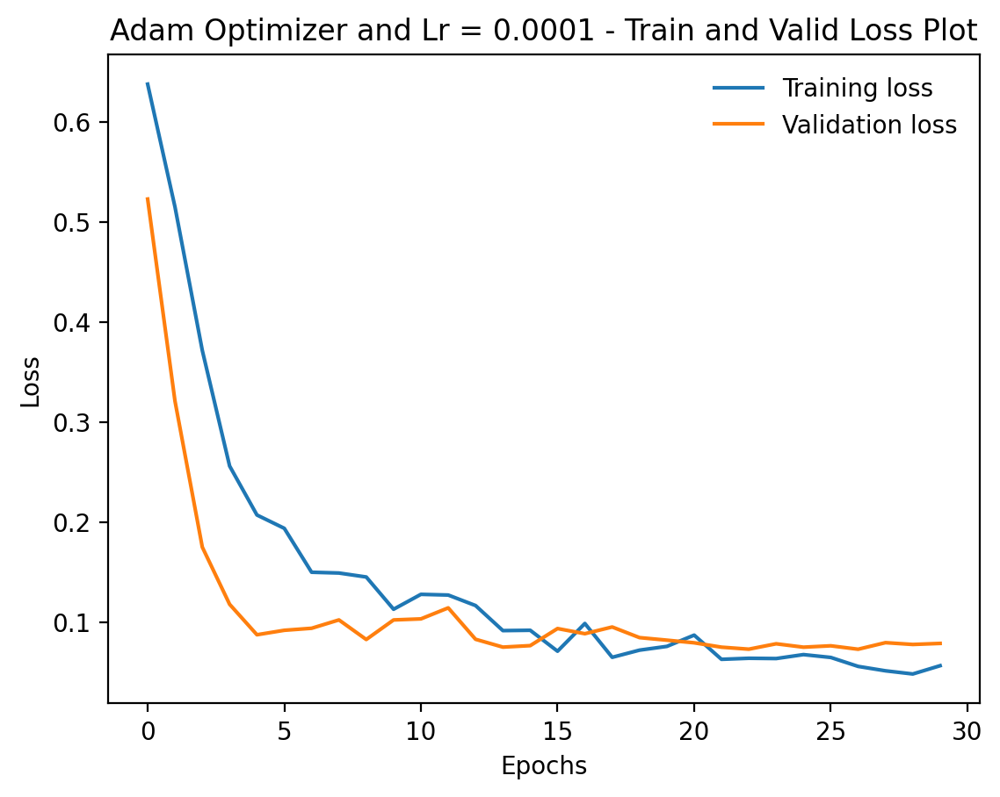

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.0001 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.0001 - Train and Valid Accuracy Plot')

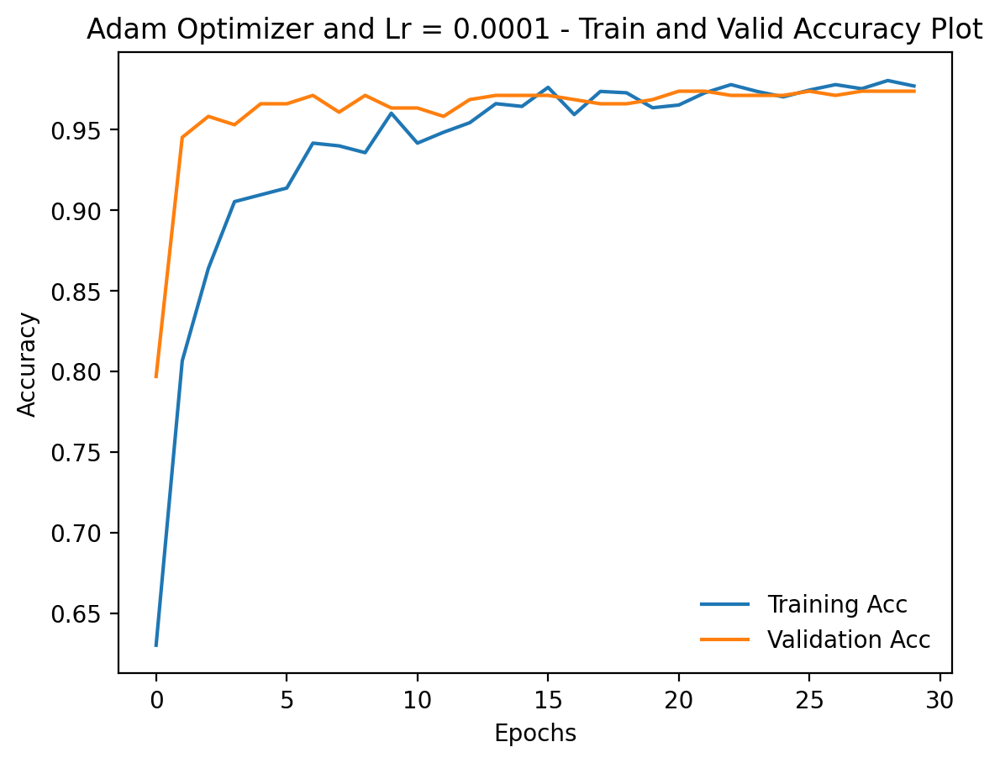

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_acc, label='Training Acc')
plt.plot(valid_acc, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.0001 - Train and Valid Accuracy Plot")

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

Loading the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

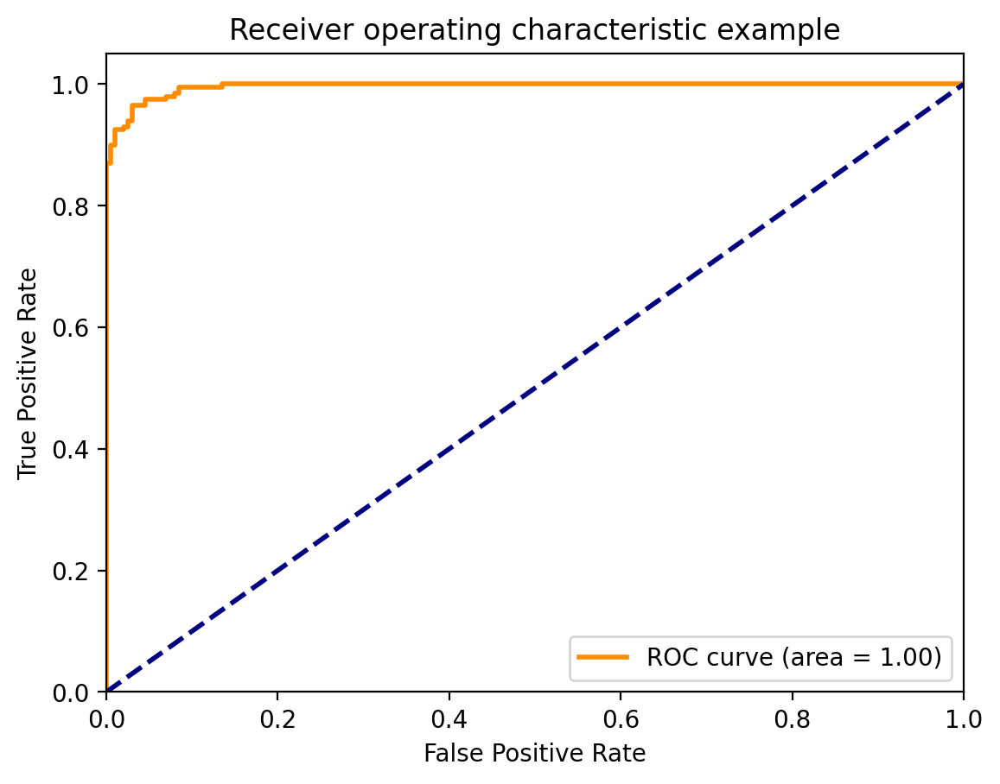

<ipython-input-70-056648a226ce>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


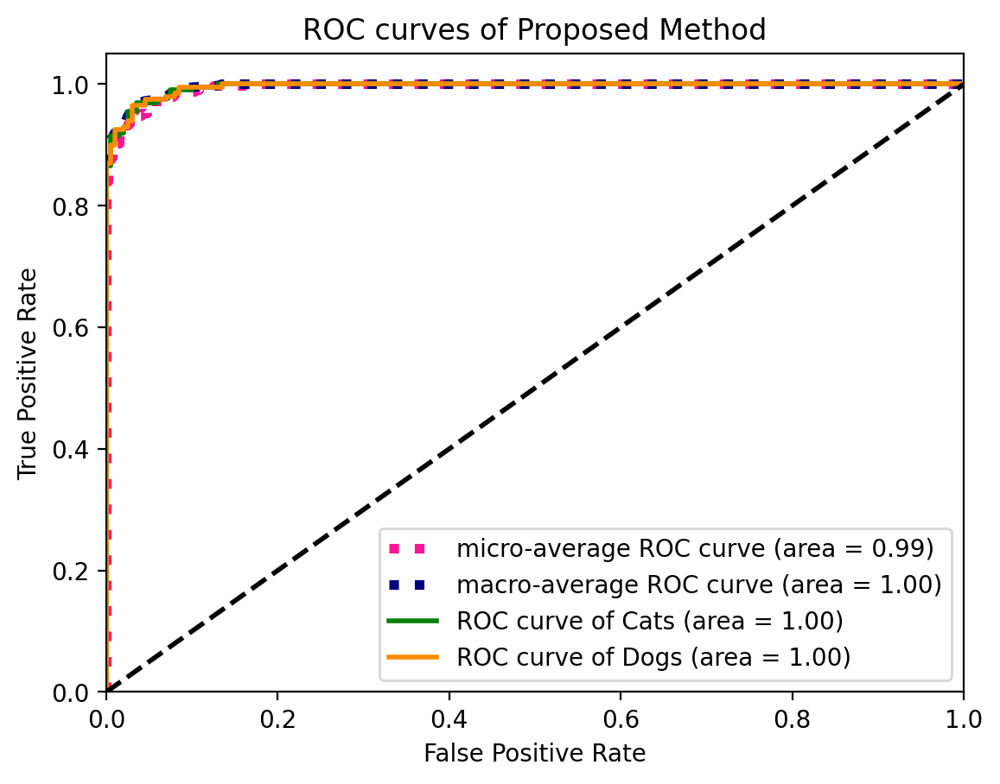

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Cats (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Dogs (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[195   5]
 [ 14 186]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


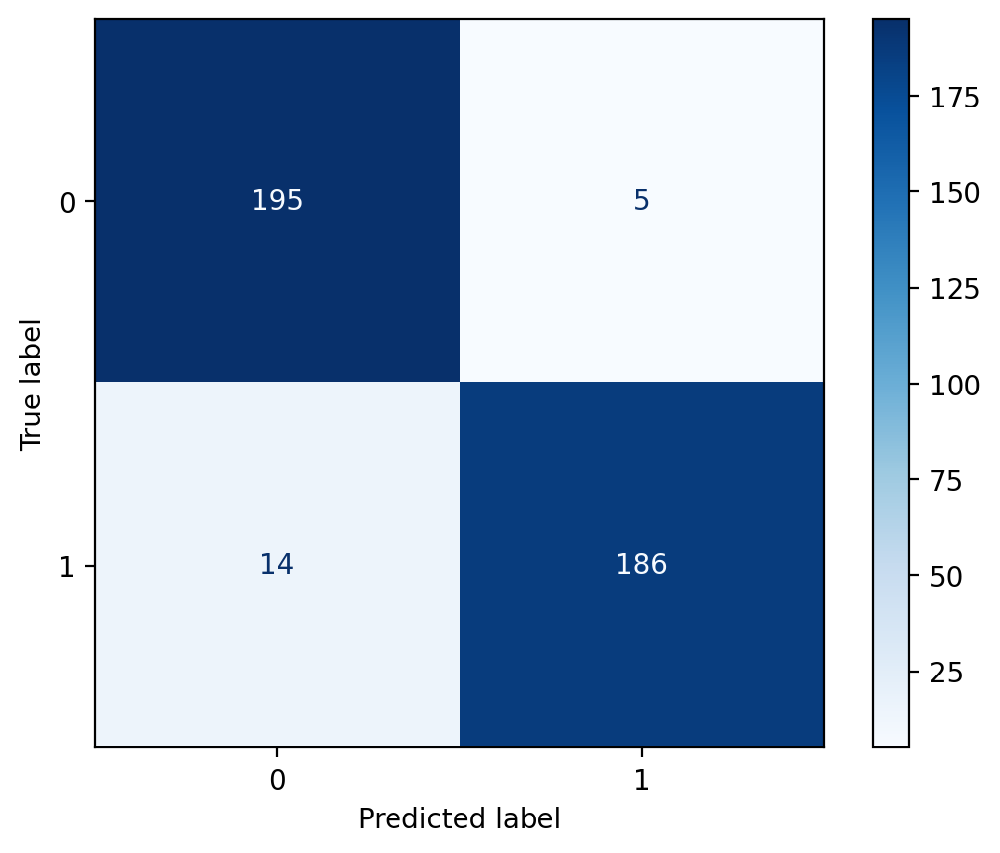

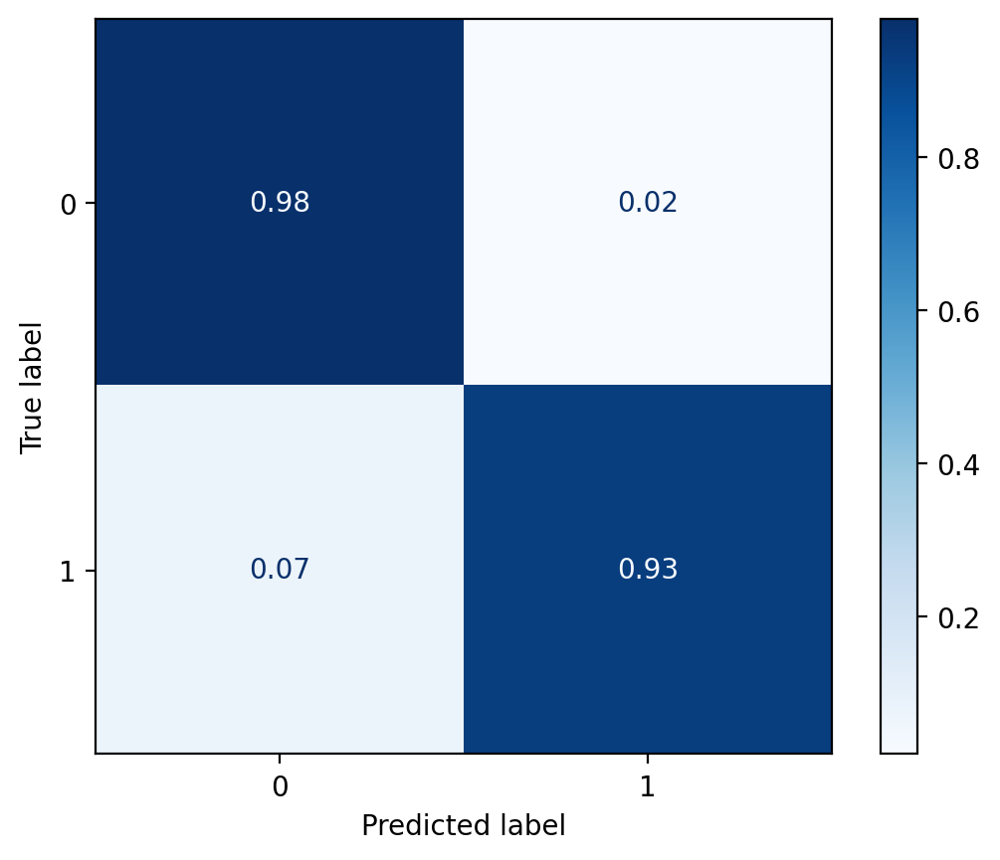

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.93, Recall: 0.97, F1_score: 0.95, Specificity: 0.93


###### Adam Optimizer and lr = 0.0005

In [ ]:
pretrained_model = models.resnet50(pretrained = True)
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(train_ds.classes)

fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)
pretrained_model.fc = fc
model = ResNet(resnet50_config, OUTPUT_DIM)
model.load_state_dict(pretrained_model.state_dict())

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


<All keys matched successfully>

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,512,130 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 5e-4

params = [
          {'params': model.conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.fc.parameters()}
         ]

optimizer = optim.Adam(params, lr = FOUND_LR)

In [ ]:
EPOCHS = 30
STEPS_PER_EPOCH = len(train_iter)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [ ]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, acc_k

In [ ]:
def train(model, iterator, optimizer, criterion, scheduler, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()


    for (x, y) in iterator:

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        scheduler.step()

        epoch_loss += loss.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_acc = []
valid_acc = []

best_valid_acc_1 = 0  # Track the best validation top-1 accuracy
best_train_acc_1 = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')
#best_valid_acc_1 = float('inf')
#best_train_acc_1 = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iter, optimizer, criterion, scheduler, device)
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_acc.append(train_acc_1)
    valid_acc.append(valid_acc_1)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc_1 > best_valid_acc_1:
        best_valid_acc_1 = valid_acc_1
    if train_acc_1 > best_train_acc_1:
        best_train_acc_1 = train_acc_1
        print(epoch)
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

0
Epoch: 01 | Epoch Time: 0m 11s
	Train Loss: 0.530 | Train Acc @1:  75.00% | Train Acc @5: 100.00%
	Valid Loss: 0.227 | Valid Acc @1:  95.57% | Valid Acc @5: 100.00%
1
Epoch: 02 | Epoch Time: 0m 11s
	Train Loss: 0.286 | Train Acc @1:  88.68% | Train Acc @5: 100.00%
	Valid Loss: 0.108 | Valid Acc @1:  96.35% | Valid Acc @5: 100.00%
2
Epoch: 03 | Epoch Time: 0m 10s
	Train Loss: 0.183 | Train Acc @1:  92.40% | Train Acc @5: 100.00%
	Valid Loss: 0.077 | Valid Acc @1:  96.35% | Valid Acc @5: 100.00%
3
Epoch: 04 | Epoch Time: 0m 10s
	Train Loss: 0.165 | Train Acc @1:  92.48% | Train Acc @5: 100.00%
	Valid Loss: 0.139 | Valid Acc @1:  95.57% | Valid Acc @5: 100.00%
4
Epoch: 05 | Epoch Time: 0m 10s
	Train Loss: 0.158 | Train Acc @1:  94.17% | Train Acc @5: 100.00%
	Valid Loss: 0.150 | Valid Acc @1:  94.79% | Valid Acc @5: 100.00%
Epoch: 06 | Epoch Time: 0m 10s
	Train Loss: 0.180 | Train Acc @1:  93.16% | Train Acc @5: 100.00%
	Valid Loss: 0.148 | Valid Acc @1:  95.31% | Valid Acc @5: 100.00%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc_1 * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc_1 * 100))

Lowest valid_loss: 7.69%
Best valid_Acc: 96.88%
Lowest train_loss: 3.83%
Best train_Acc: 98.48%


Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.0005 - Train and Valid Loss Plot')

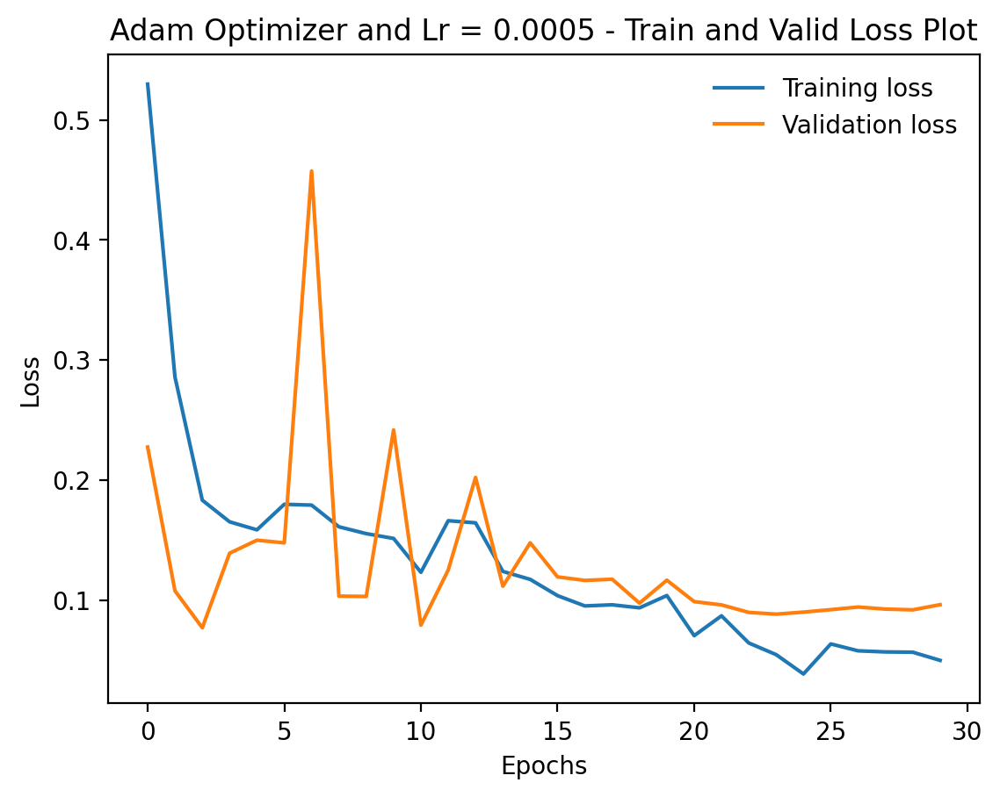

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.0005 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.0005 - Train and Valid Accuracy Plot')

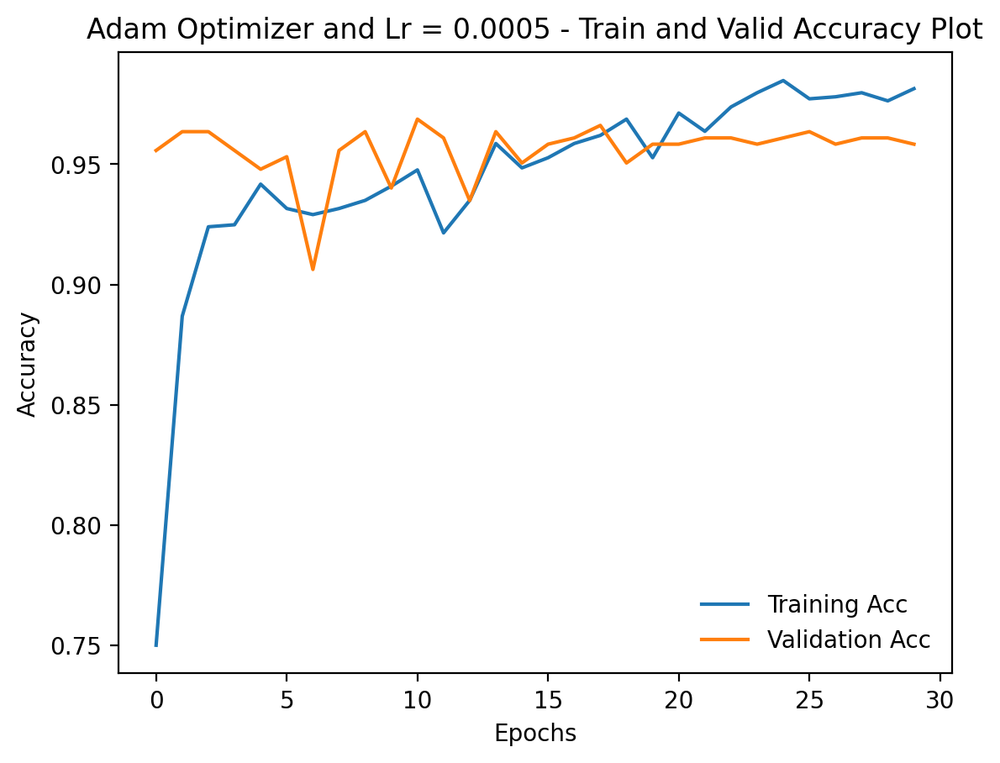

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_acc, label='Training Acc')
plt.plot(valid_acc, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.0005 - Train and Valid Accuracy Plot")

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

Loading the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

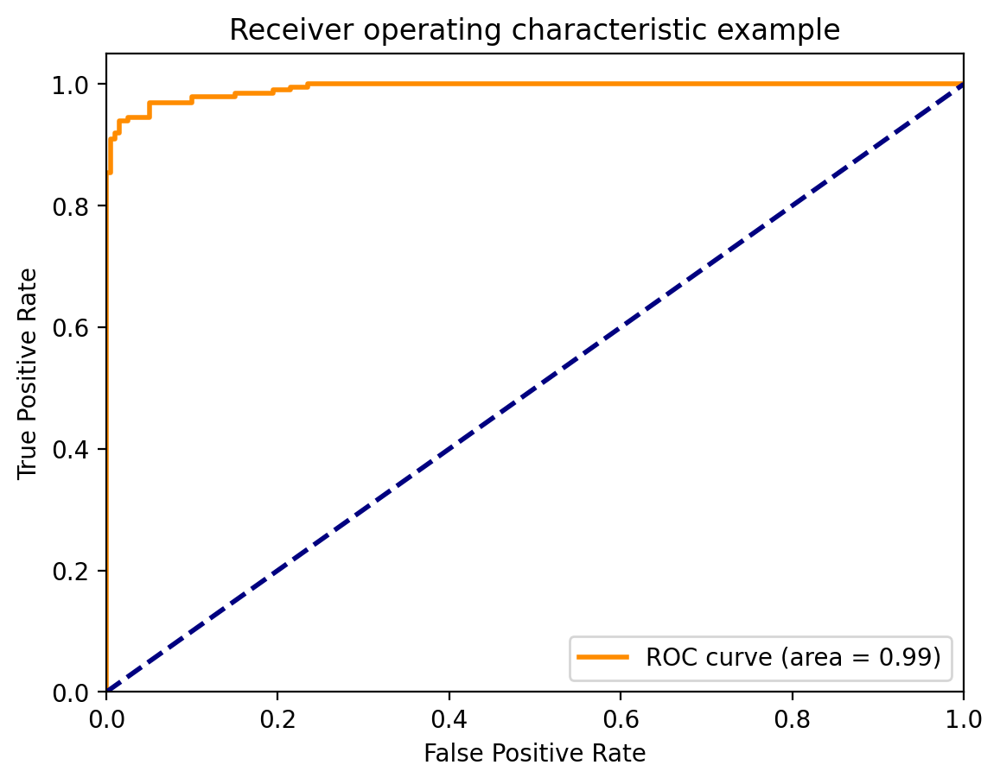

<ipython-input-89-056648a226ce>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


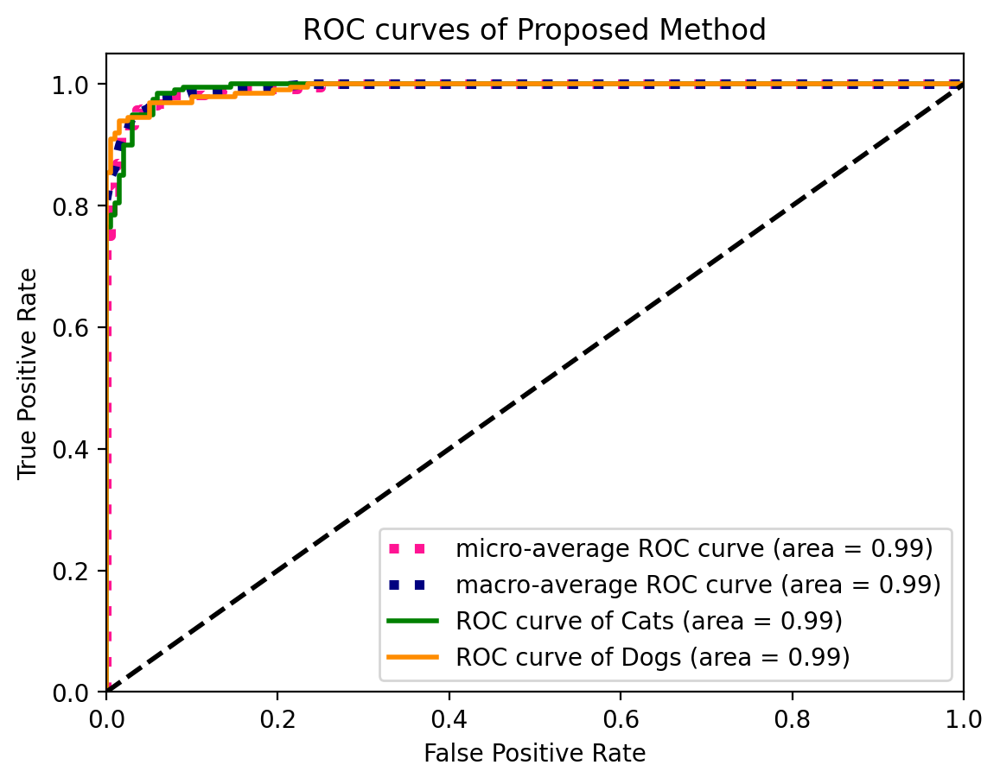

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Cats (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Dogs (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[196   4]
 [ 12 188]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


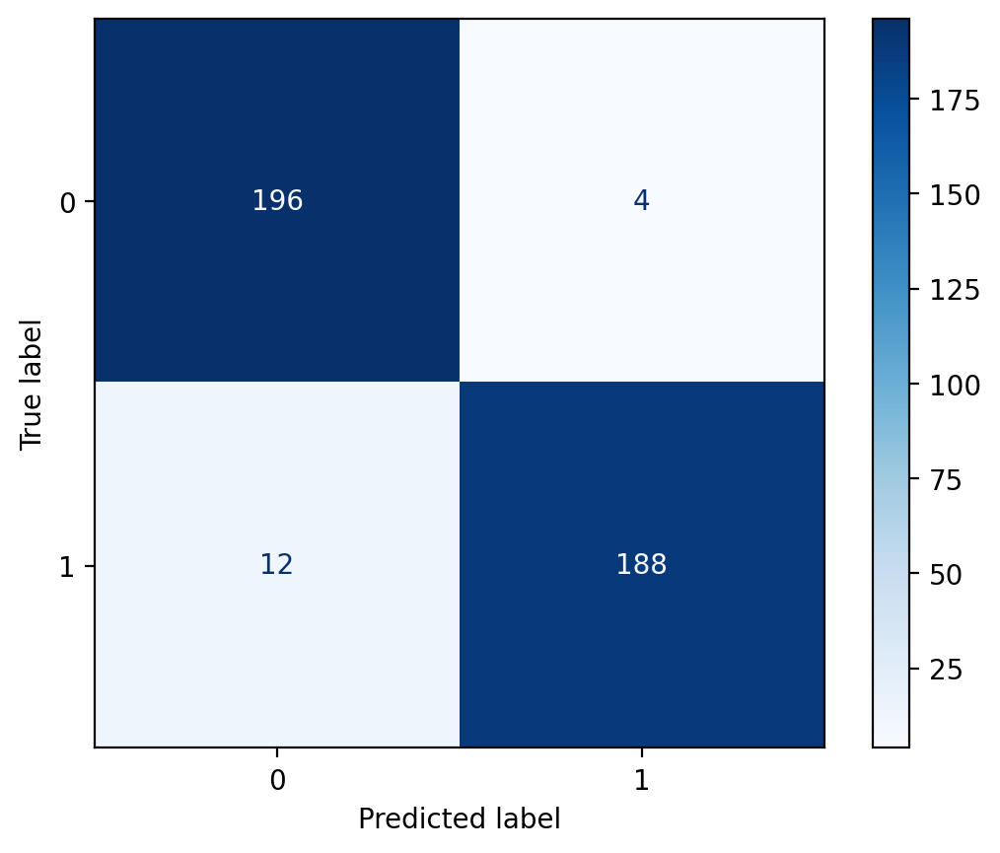

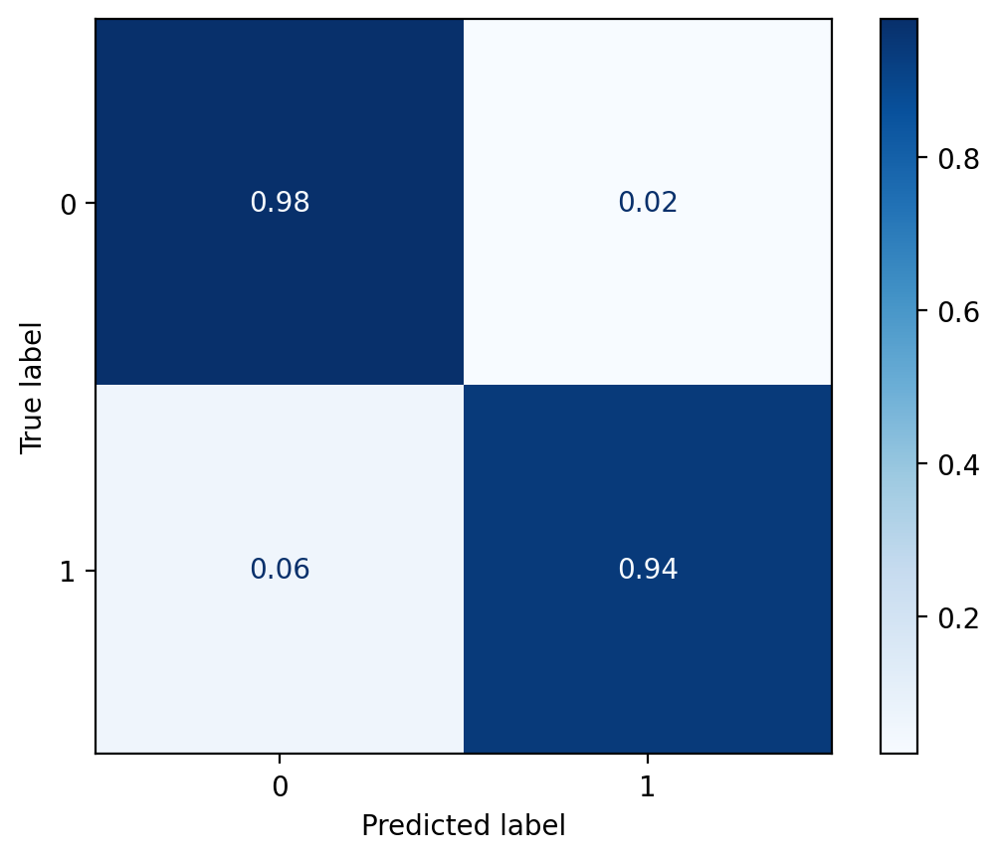

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.94, Recall: 0.98, F1_score: 0.96, Specificity: 0.94


##### SGD Optimizer

###### SGD Optimizer and lr = 0.01

Setting the hyperparameters and train the model

In [ ]:
pretrained_model = models.resnet50(pretrained = True)
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(train_ds.classes)

fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)
pretrained_model.fc = fc
model = ResNet(resnet50_config, OUTPUT_DIM)
model.load_state_dict(pretrained_model.state_dict())

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


<All keys matched successfully>

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,512,130 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-2

params = [
          {'params': model.conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.fc.parameters()}
         ]

optimizer = optim.SGD(params, lr = FOUND_LR)

In [ ]:
EPOCHS = 30
STEPS_PER_EPOCH = len(train_iter)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [ ]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, acc_k

In [ ]:
def train(model, iterator, optimizer, criterion, scheduler, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()


    for (x, y) in iterator:

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        scheduler.step()

        epoch_loss += loss.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_acc = []
valid_acc = []

best_valid_acc_1 = 0  # Track the best validation top-1 accuracy
best_train_acc_1 = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')
#best_valid_acc_1 = float('inf')
#best_train_acc_1 = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iter, optimizer, criterion, scheduler, device)
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_acc.append(train_acc_1)
    valid_acc.append(valid_acc_1)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc_1 > best_valid_acc_1:
        best_valid_acc_1 = valid_acc_1
    if train_acc_1 > best_train_acc_1:
        best_train_acc_1 = train_acc_1
        print(epoch)
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

0
Epoch: 01 | Epoch Time: 0m 10s
	Train Loss: 0.502 | Train Acc @1:  72.64% | Train Acc @5: 100.00%
	Valid Loss: 0.148 | Valid Acc @1:  95.31% | Valid Acc @5: 100.00%
1
Epoch: 02 | Epoch Time: 0m 10s
	Train Loss: 0.243 | Train Acc @1:  89.10% | Train Acc @5: 100.00%
	Valid Loss: 0.102 | Valid Acc @1:  96.09% | Valid Acc @5: 100.00%
2
Epoch: 03 | Epoch Time: 0m 10s
	Train Loss: 0.210 | Train Acc @1:  90.46% | Train Acc @5: 100.00%
	Valid Loss: 0.101 | Valid Acc @1:  96.35% | Valid Acc @5: 100.00%
3
Epoch: 04 | Epoch Time: 0m 10s
	Train Loss: 0.190 | Train Acc @1:  92.06% | Train Acc @5: 100.00%
	Valid Loss: 0.084 | Valid Acc @1:  96.88% | Valid Acc @5: 100.00%
Epoch: 05 | Epoch Time: 0m 10s
	Train Loss: 0.210 | Train Acc @1:  91.13% | Train Acc @5: 100.00%
	Valid Loss: 0.169 | Valid Acc @1:  94.53% | Valid Acc @5: 100.00%
5
Epoch: 06 | Epoch Time: 0m 10s
	Train Loss: 0.181 | Train Acc @1:  92.82% | Train Acc @5: 100.00%
	Valid Loss: 0.116 | Valid Acc @1:  96.61% | Valid Acc @5: 100.00%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc_1 * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc_1 * 100))

Lowest valid_loss: 8.44%
Best valid_Acc: 97.92%
Lowest train_loss: 5.10%
Best train_Acc: 97.97%


Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.01 - Train and Valid Loss Plot')

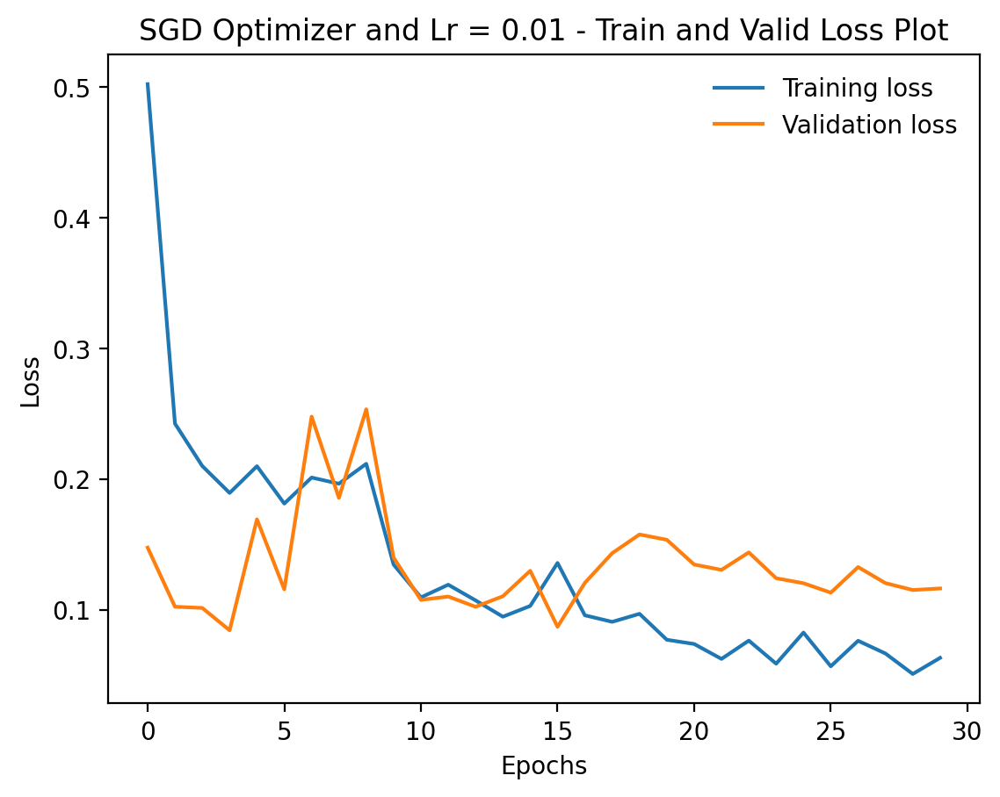

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.01 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.01 - Train and Valid Accuracy Plot')

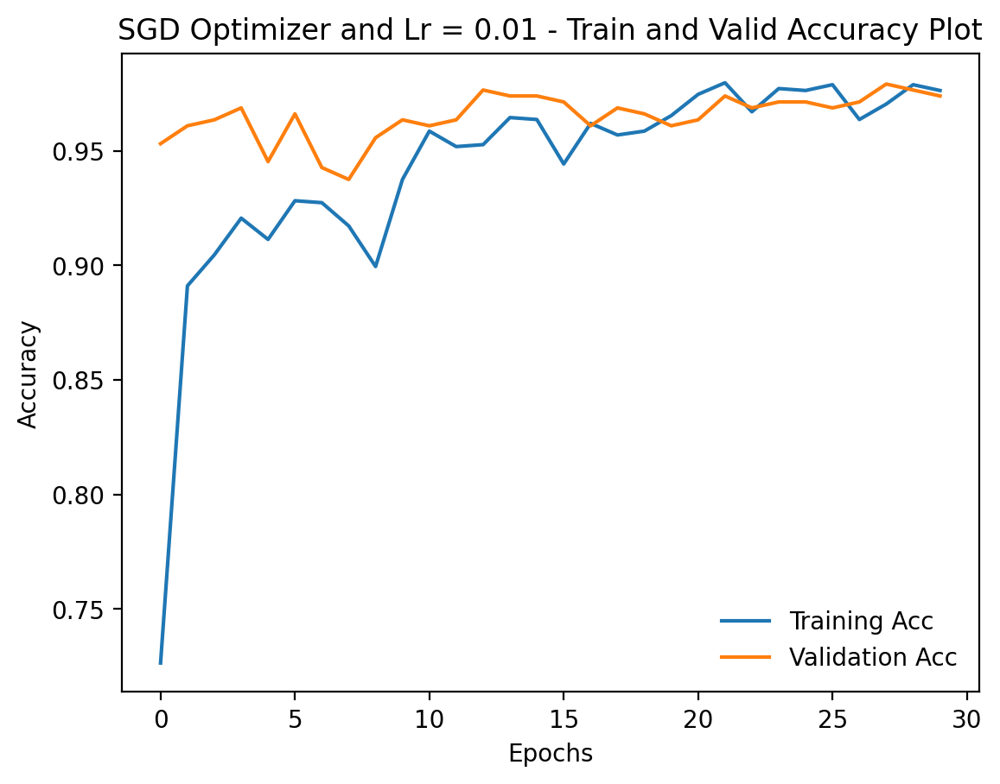

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_acc, label='Training Acc')
plt.plot(valid_acc, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.01 - Train and Valid Accuracy Plot")

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

Loading the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

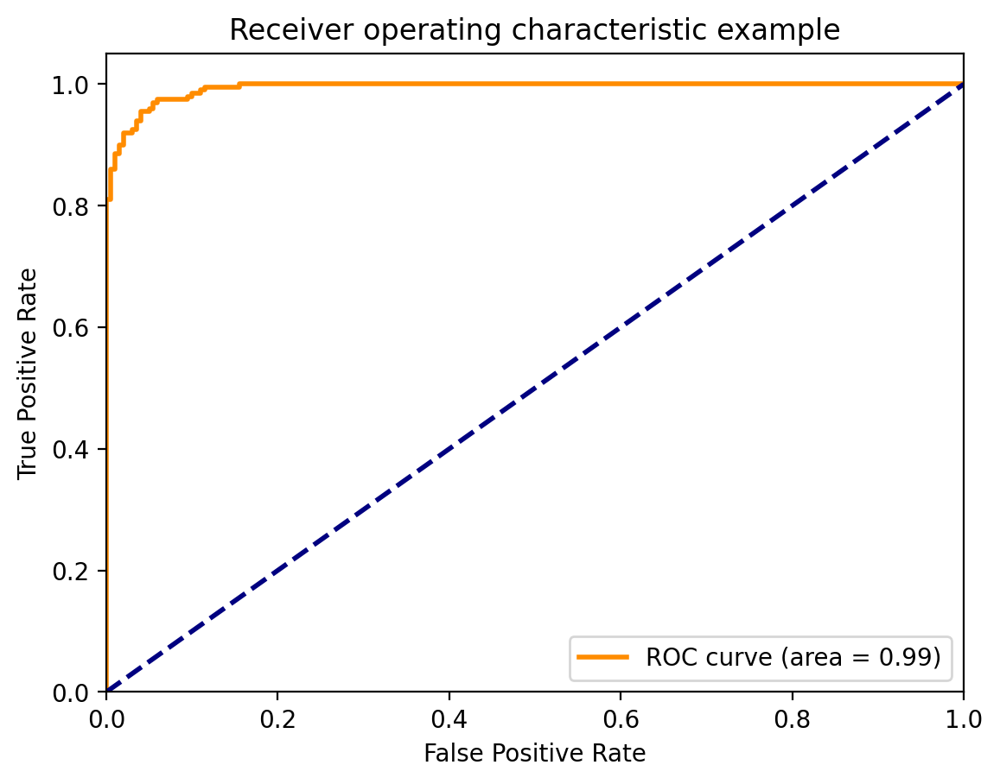

<ipython-input-108-056648a226ce>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


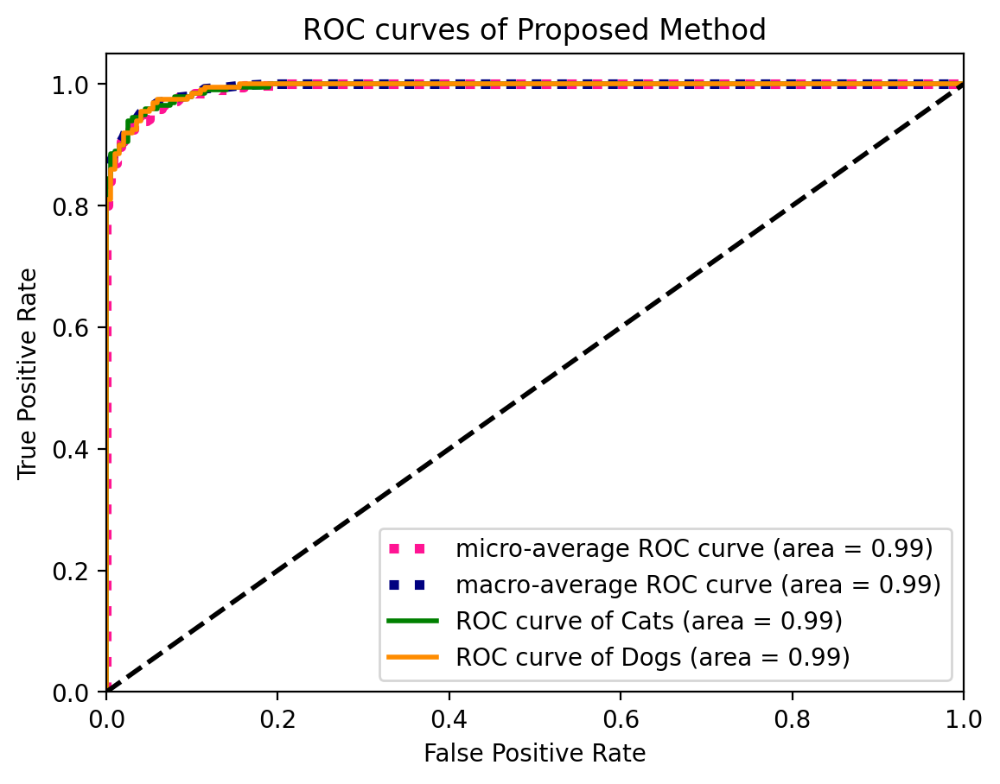

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Cats (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Dogs (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[196   4]
 [ 16 184]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


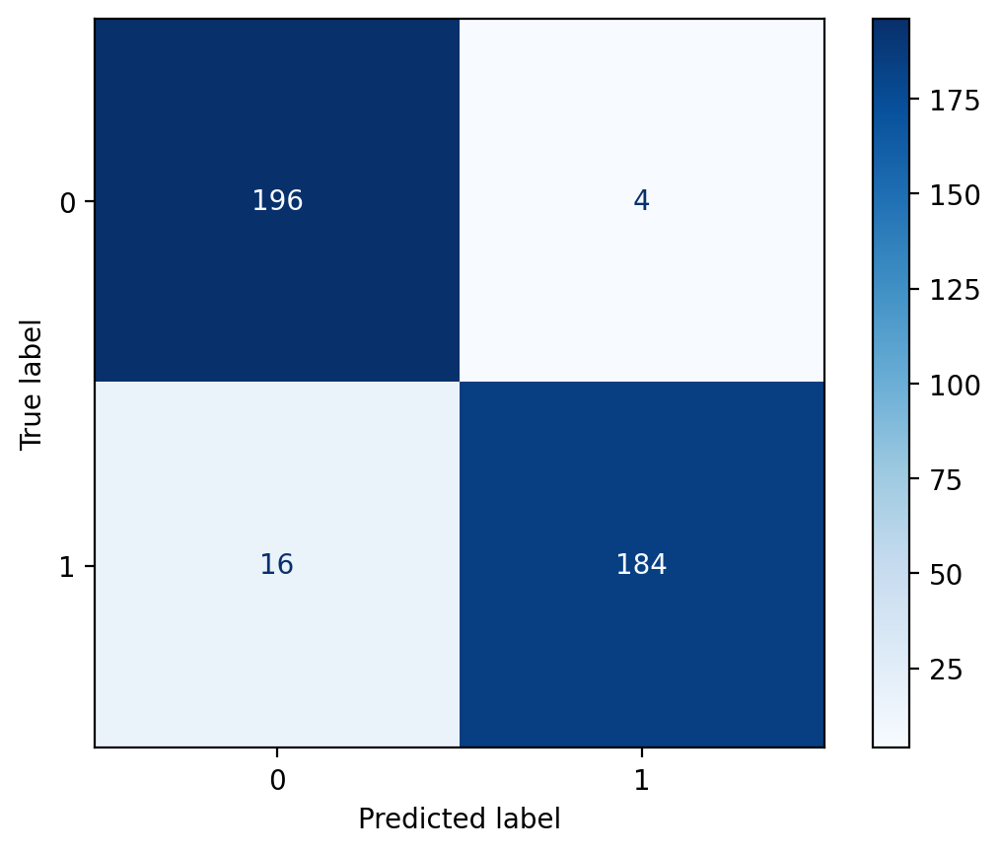

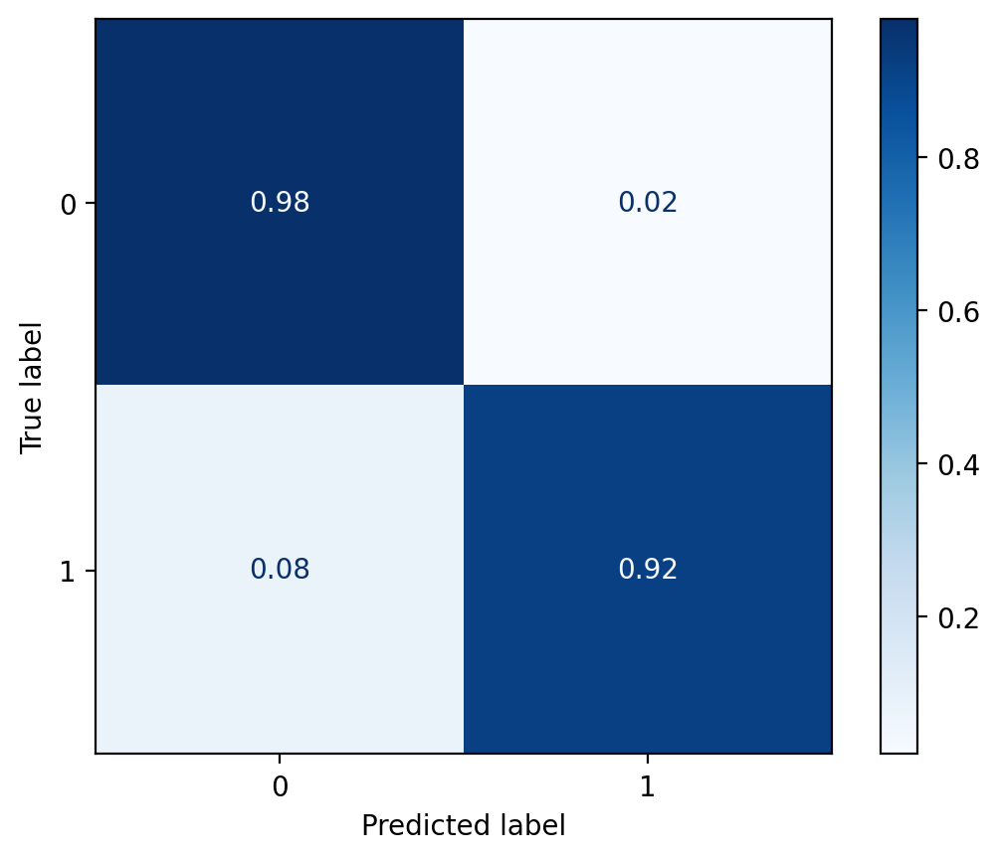

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.92, Recall: 0.98, F1_score: 0.95, Specificity: 0.92


###### SGD Optimizer and lr = 0.001

In [ ]:
pretrained_model = models.resnet50(pretrained = True)
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(train_ds.classes)

fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)
pretrained_model.fc = fc
model = ResNet(resnet50_config, OUTPUT_DIM)
model.load_state_dict(pretrained_model.state_dict())

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


<All keys matched successfully>

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,512,130 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-3

params = [
          {'params': model.conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.fc.parameters()}
         ]

optimizer = optim.SGD(params, lr = FOUND_LR)

In [ ]:
EPOCHS = 30
STEPS_PER_EPOCH = len(train_iter)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [ ]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, acc_k

In [ ]:
def train(model, iterator, optimizer, criterion, scheduler, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()


    for (x, y) in iterator:

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        scheduler.step()

        epoch_loss += loss.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_acc = []
valid_acc = []

best_valid_acc_1 = 0  # Track the best validation top-1 accuracy
best_train_acc_1 = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')
#best_valid_acc_1 = float('inf')
#best_train_acc_1 = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iter, optimizer, criterion, scheduler, device)
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_acc.append(train_acc_1)
    valid_acc.append(valid_acc_1)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc_1 > best_valid_acc_1:
        best_valid_acc_1 = valid_acc_1
    if train_acc_1 > best_train_acc_1:
        best_train_acc_1 = train_acc_1
        print(epoch)
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

0
Epoch: 01 | Epoch Time: 0m 10s
	Train Loss: 0.698 | Train Acc @1:  56.42% | Train Acc @5: 100.00%
	Valid Loss: 0.547 | Valid Acc @1:  70.83% | Valid Acc @5: 100.00%
1
Epoch: 02 | Epoch Time: 0m 10s
	Train Loss: 0.503 | Train Acc @1:  76.86% | Train Acc @5: 100.00%
	Valid Loss: 0.271 | Valid Acc @1:  93.75% | Valid Acc @5: 100.00%
2
Epoch: 03 | Epoch Time: 0m 10s
	Train Loss: 0.350 | Train Acc @1:  87.58% | Train Acc @5: 100.00%
	Valid Loss: 0.174 | Valid Acc @1:  94.79% | Valid Acc @5: 100.00%
Epoch: 04 | Epoch Time: 0m 10s
	Train Loss: 0.292 | Train Acc @1:  87.50% | Train Acc @5: 100.00%
	Valid Loss: 0.157 | Valid Acc @1:  93.49% | Valid Acc @5: 100.00%
4
Epoch: 05 | Epoch Time: 0m 10s
	Train Loss: 0.259 | Train Acc @1:  88.26% | Train Acc @5: 100.00%
	Valid Loss: 0.127 | Valid Acc @1:  95.05% | Valid Acc @5: 100.00%
5
Epoch: 06 | Epoch Time: 0m 10s
	Train Loss: 0.246 | Train Acc @1:  89.53% | Train Acc @5: 100.00%
	Valid Loss: 0.108 | Valid Acc @1:  96.35% | Valid Acc @5: 100.00%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc_1 * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc_1 * 100))

Lowest valid_loss: 7.52%
Best valid_Acc: 97.66%
Lowest train_loss: 11.17%
Best train_Acc: 95.61%


Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.001 - Train and Valid Loss Plot')

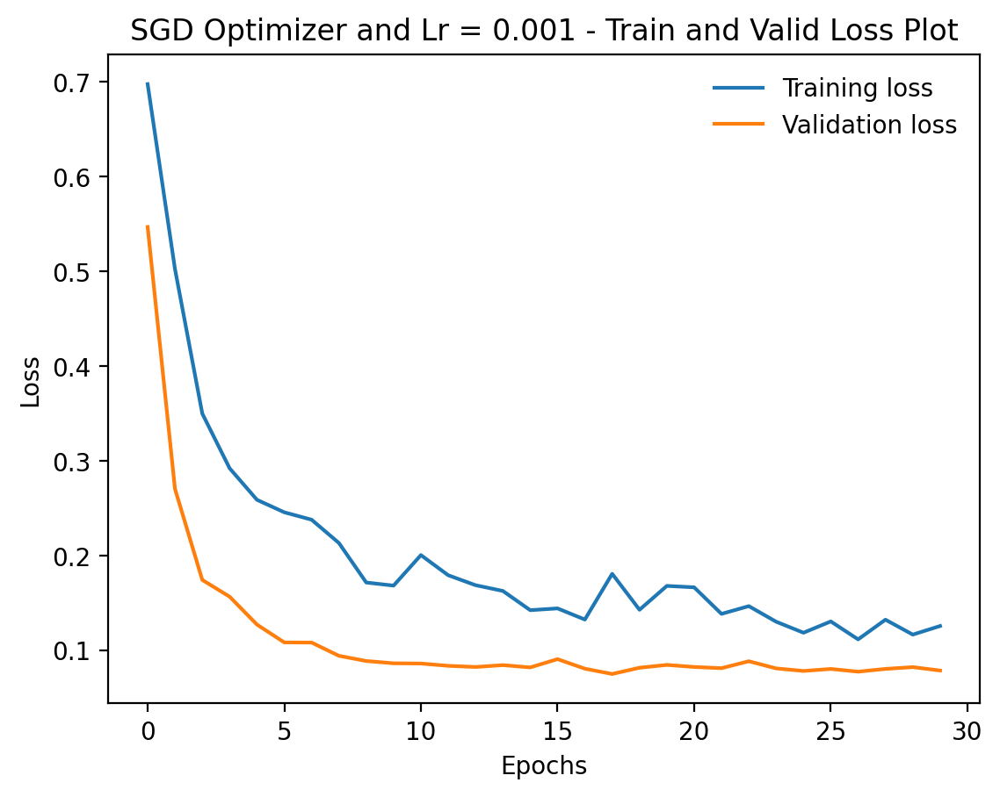

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.001 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.001 - Train and Valid Accuracy Plot')

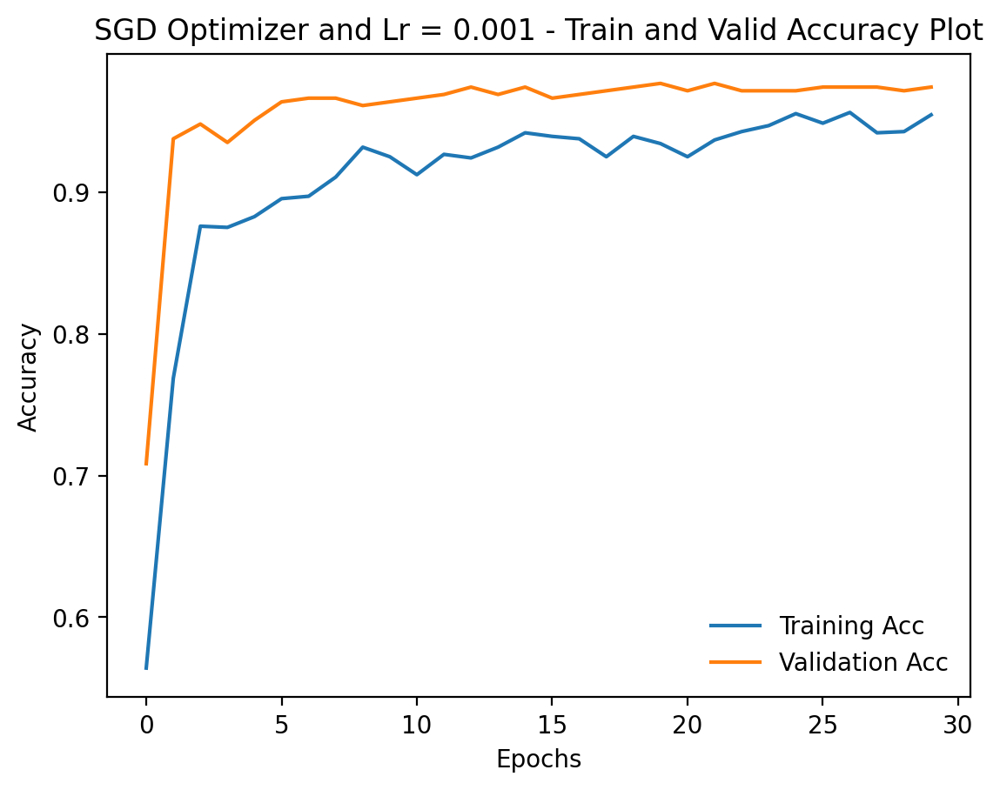

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_acc, label='Training Acc')
plt.plot(valid_acc, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.001 - Train and Valid Accuracy Plot")

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

Loading the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

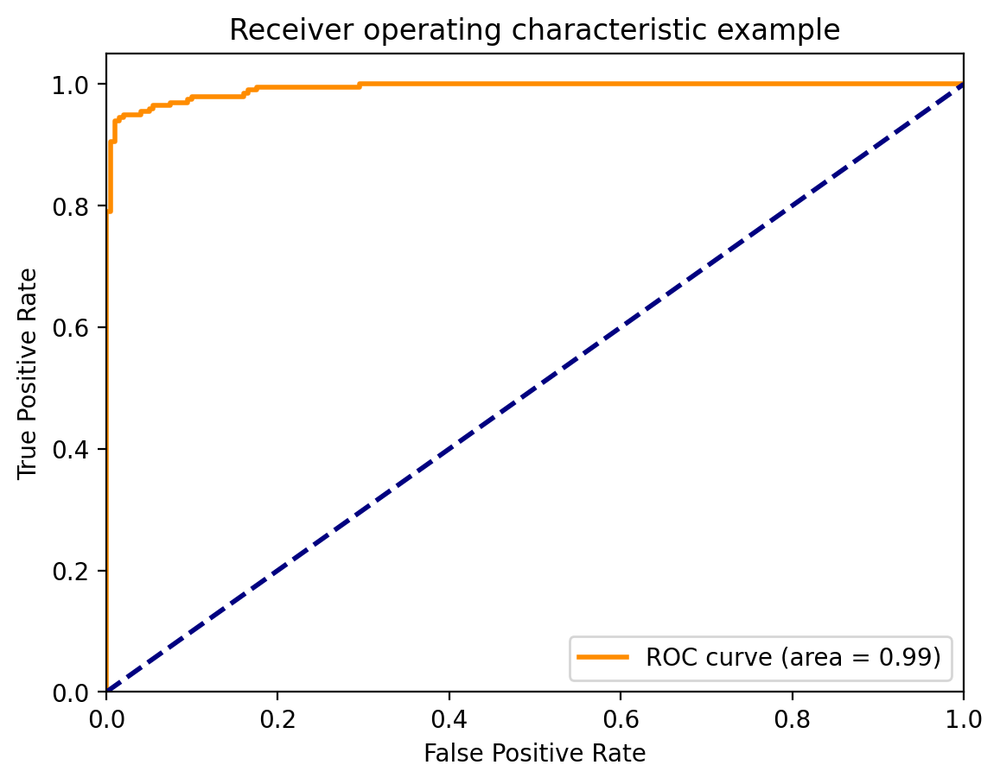

<ipython-input-127-056648a226ce>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


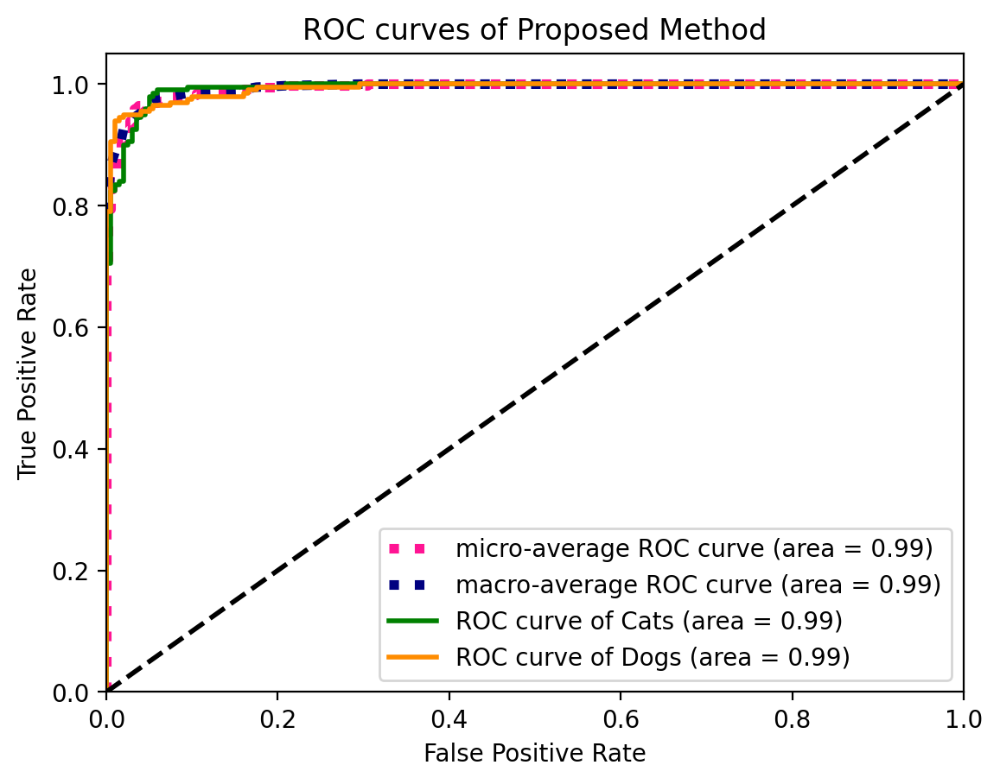

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Cats (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Dogs (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[196   4]
 [ 11 189]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


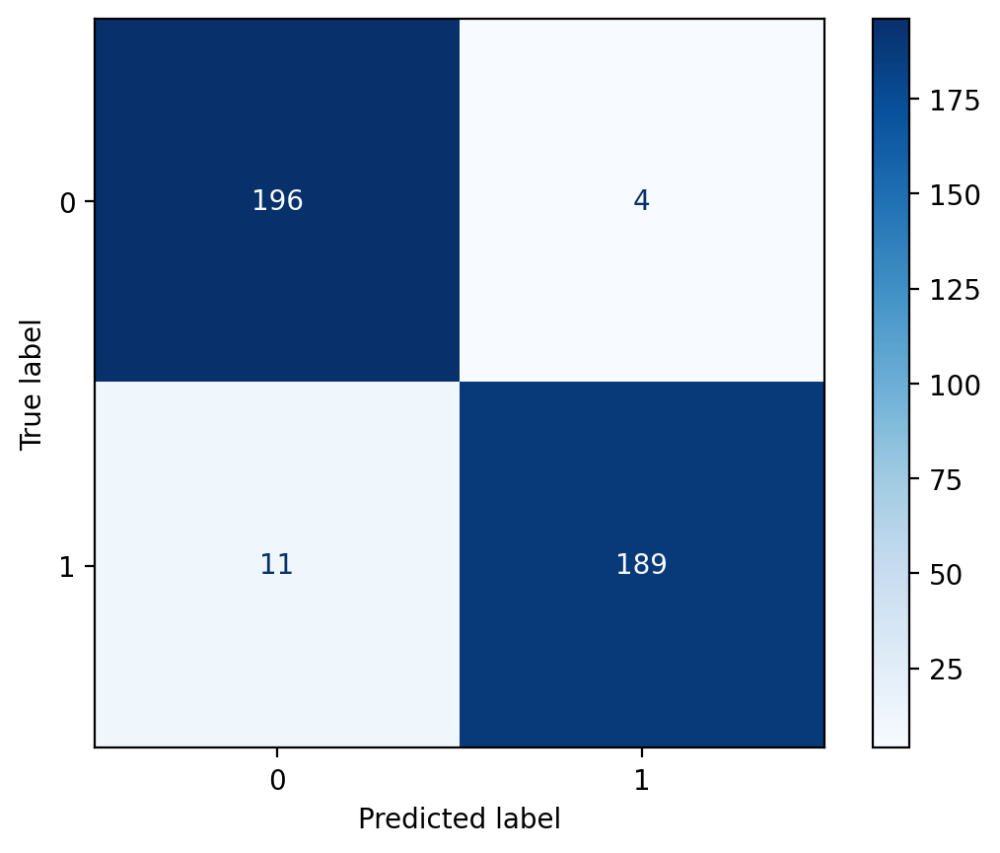

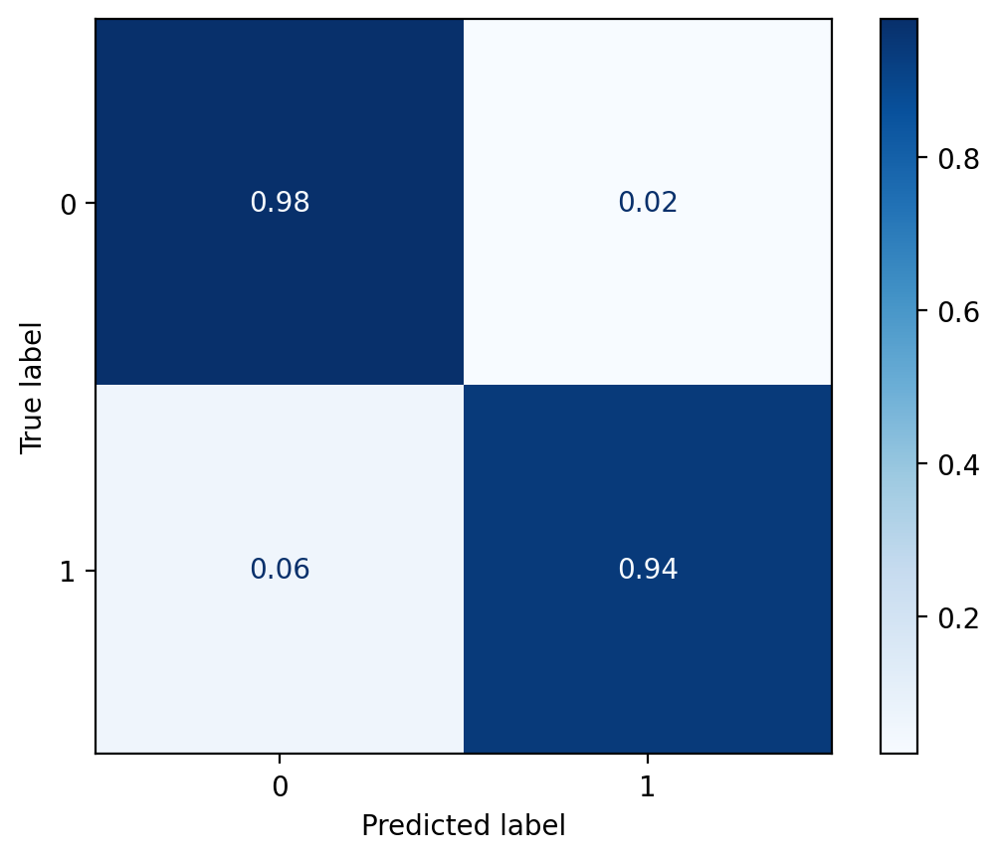

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.95, Recall: 0.98, F1_score: 0.96, Specificity: 0.94


###### SGD Optimizer and lr = 0.0001

In [ ]:
pretrained_model = models.resnet50(pretrained = True)
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(train_ds.classes)

fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)
pretrained_model.fc = fc
model = ResNet(resnet50_config, OUTPUT_DIM)
model.load_state_dict(pretrained_model.state_dict())

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


<All keys matched successfully>

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,512,130 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-4

params = [
          {'params': model.conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.fc.parameters()}
         ]

optimizer = optim.SGD(params, lr = FOUND_LR)

In [ ]:
EPOCHS = 30
STEPS_PER_EPOCH = len(train_iter)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [ ]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, acc_k

In [ ]:
def train(model, iterator, optimizer, criterion, scheduler, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()


    for (x, y) in iterator:

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        scheduler.step()

        epoch_loss += loss.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_acc = []
valid_acc = []

best_valid_acc_1 = 0  # Track the best validation top-1 accuracy
best_train_acc_1 = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')
#best_valid_acc_1 = float('inf')
#best_train_acc_1 = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iter, optimizer, criterion, scheduler, device)
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_acc.append(train_acc_1)
    valid_acc.append(valid_acc_1)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc_1 > best_valid_acc_1:
        best_valid_acc_1 = valid_acc_1
    if train_acc_1 > best_train_acc_1:
        best_train_acc_1 = train_acc_1
        print(epoch)
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

0
Epoch: 01 | Epoch Time: 0m 10s
	Train Loss: 0.783 | Train Acc @1:  42.82% | Train Acc @5: 100.00%
	Valid Loss: 0.805 | Valid Acc @1:  40.89% | Valid Acc @5: 100.00%
1
Epoch: 02 | Epoch Time: 0m 10s
	Train Loss: 0.736 | Train Acc @1:  44.85% | Train Acc @5: 100.00%
	Valid Loss: 0.704 | Valid Acc @1:  51.56% | Valid Acc @5: 100.00%
2
Epoch: 03 | Epoch Time: 0m 10s
	Train Loss: 0.661 | Train Acc @1:  61.15% | Train Acc @5: 100.00%
	Valid Loss: 0.584 | Valid Acc @1:  72.14% | Valid Acc @5: 100.00%
3
Epoch: 04 | Epoch Time: 0m 10s
	Train Loss: 0.578 | Train Acc @1:  74.49% | Train Acc @5: 100.00%
	Valid Loss: 0.476 | Valid Acc @1:  84.38% | Valid Acc @5: 100.00%
4
Epoch: 05 | Epoch Time: 0m 10s
	Train Loss: 0.530 | Train Acc @1:  78.38% | Train Acc @5: 100.00%
	Valid Loss: 0.389 | Valid Acc @1:  89.58% | Valid Acc @5: 100.00%
5
Epoch: 06 | Epoch Time: 0m 10s
	Train Loss: 0.463 | Train Acc @1:  82.94% | Train Acc @5: 100.00%
	Valid Loss: 0.335 | Valid Acc @1:  90.62% | Valid Acc @5: 100.00

In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc_1 * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc_1 * 100))

Lowest valid_loss: 13.25%
Best valid_Acc: 95.57%
Lowest train_loss: 24.90%
Best train_Acc: 90.37%


Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.0001 - Train and Valid Loss Plot')

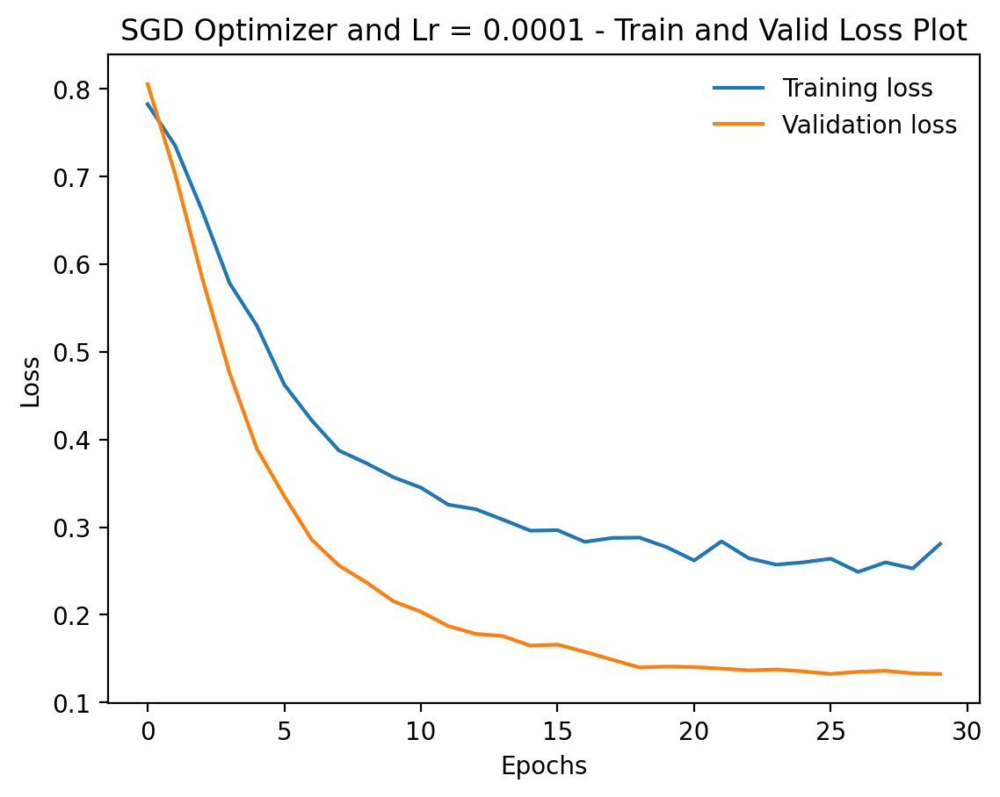

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.0001 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.0001 - Train and Valid Accuracy Plot')

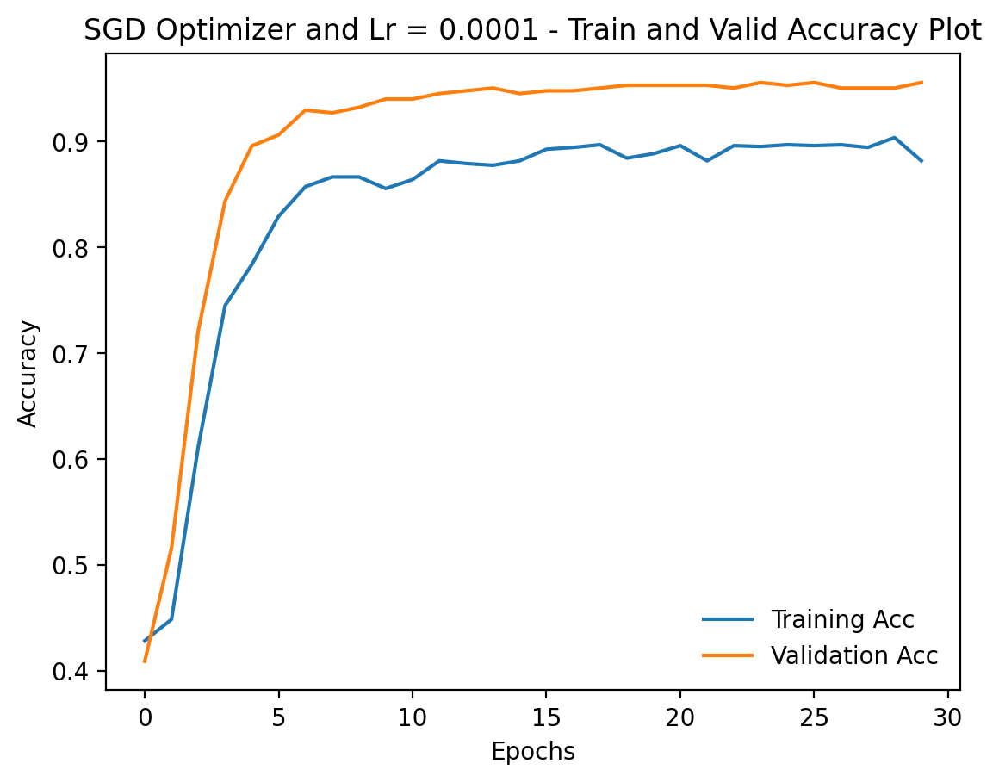

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_acc, label='Training Acc')
plt.plot(valid_acc, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.0001 - Train and Valid Accuracy Plot")

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

Loading the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

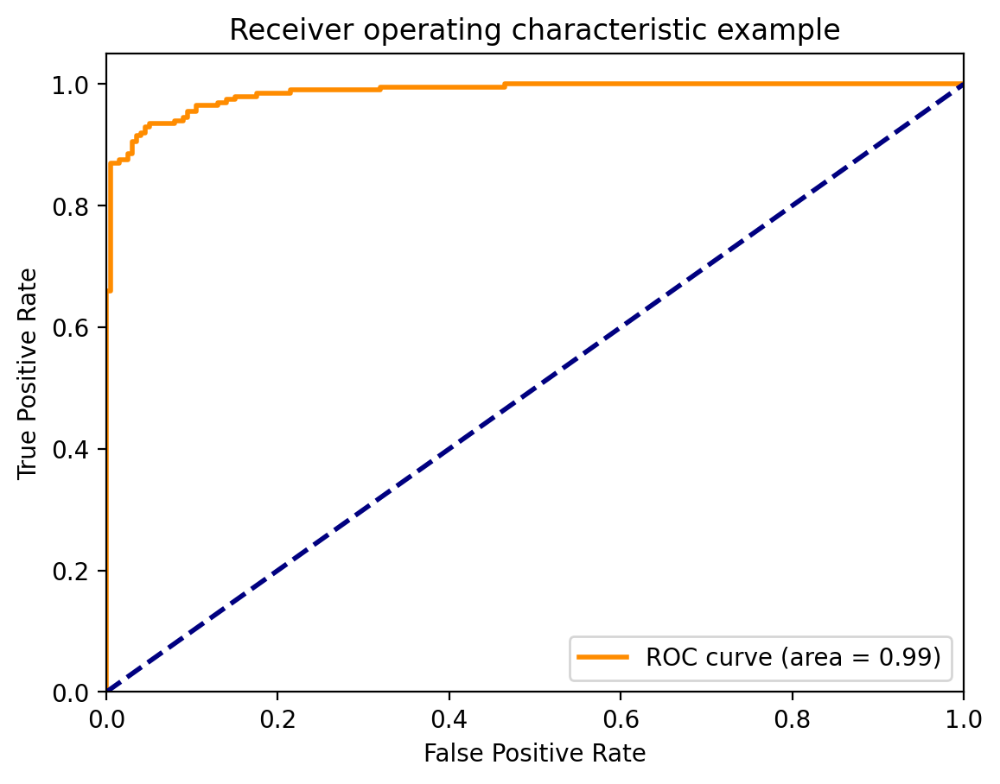

<ipython-input-146-056648a226ce>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


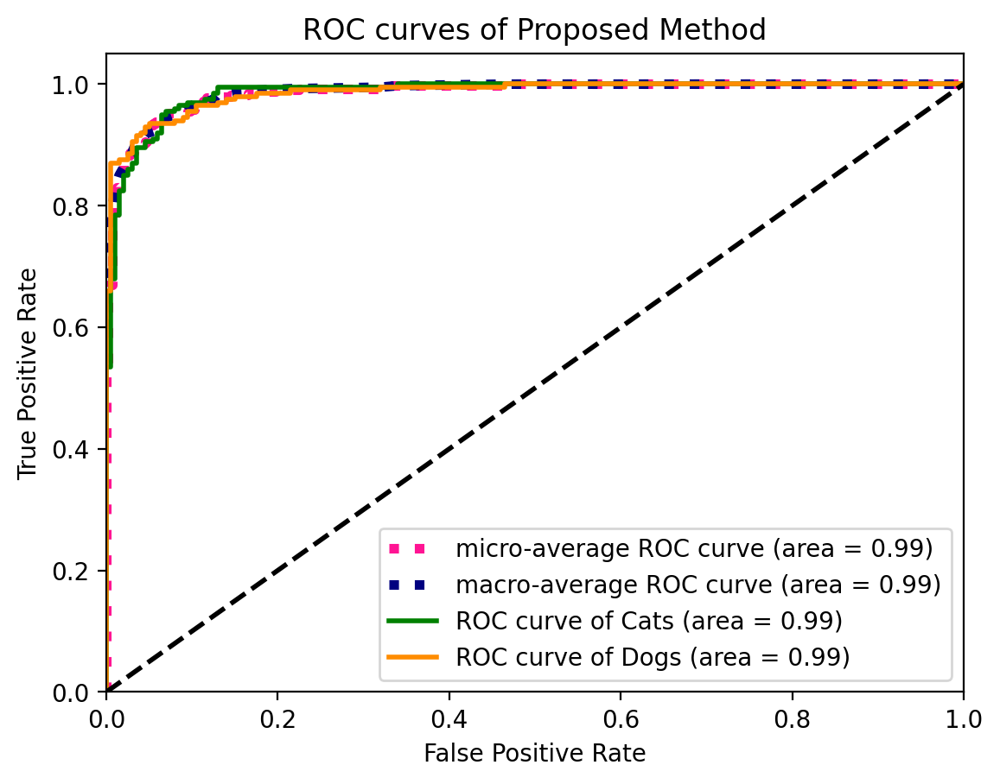

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Cats (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Dogs (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[191   9]
 [ 15 185]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


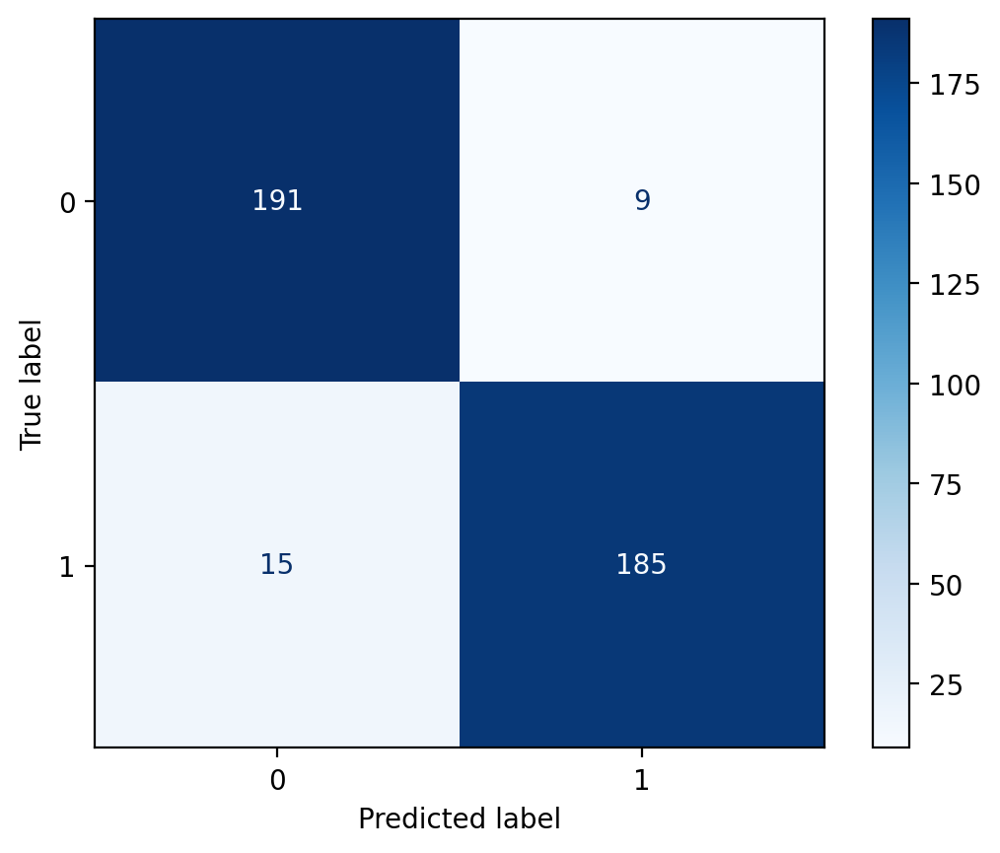

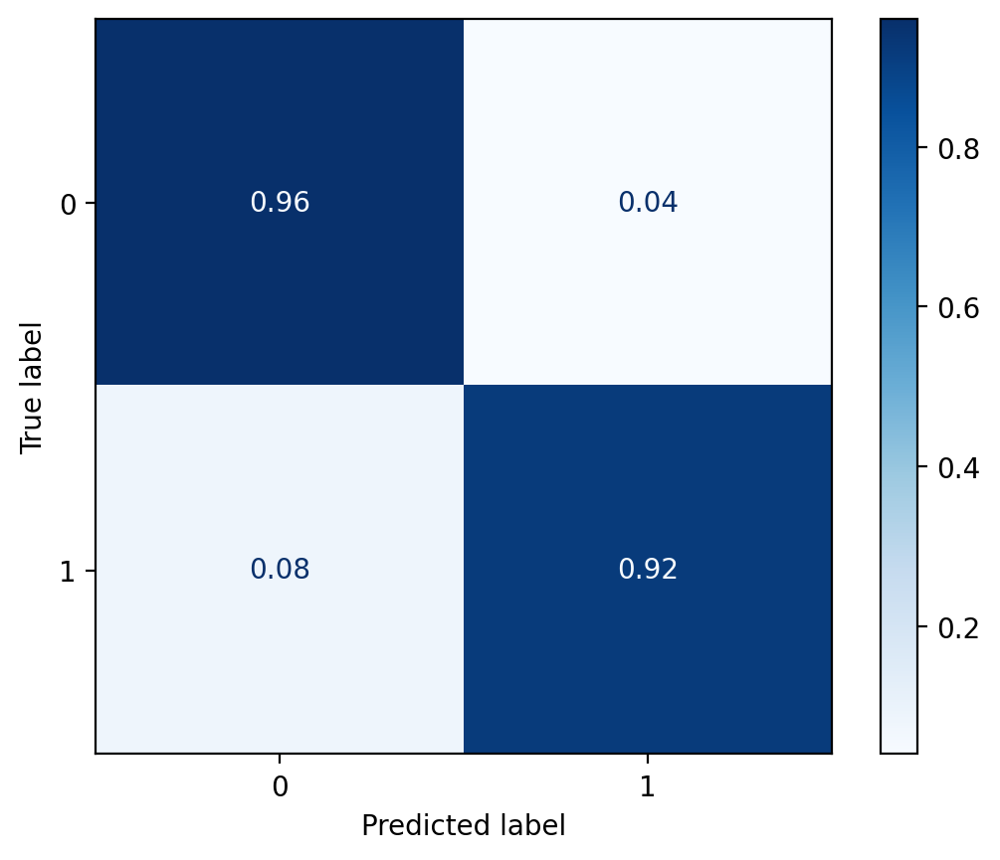

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.93, Recall: 0.95, F1_score: 0.94, Specificity: 0.93


###### SGD Optimizer and lr = 0.0005

In [ ]:
pretrained_model = models.resnet50(pretrained = True)
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(train_ds.classes)

fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)
pretrained_model.fc = fc
model = ResNet(resnet50_config, OUTPUT_DIM)
model.load_state_dict(pretrained_model.state_dict())

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


<All keys matched successfully>

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,512,130 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 5e-4

params = [
          {'params': model.conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.fc.parameters()}
         ]

optimizer = optim.SGD(params, lr = FOUND_LR)

In [ ]:
EPOCHS = 30
STEPS_PER_EPOCH = len(train_iter)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [ ]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, acc_k

In [ ]:
def train(model, iterator, optimizer, criterion, scheduler, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()


    for (x, y) in iterator:

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        scheduler.step()

        epoch_loss += loss.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_acc = []
valid_acc = []

best_valid_acc_1 = 0  # Track the best validation top-1 accuracy
best_train_acc_1 = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')
#best_valid_acc_1 = float('inf')
#best_train_acc_1 = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iter, optimizer, criterion, scheduler, device)
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_acc.append(train_acc_1)
    valid_acc.append(valid_acc_1)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc_1 > best_valid_acc_1:
        best_valid_acc_1 = valid_acc_1
    if train_acc_1 > best_train_acc_1:
        best_train_acc_1 = train_acc_1
        print(epoch)
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

0
Epoch: 01 | Epoch Time: 0m 10s
	Train Loss: 0.703 | Train Acc @1:  51.94% | Train Acc @5: 100.00%
	Valid Loss: 0.643 | Valid Acc @1:  62.76% | Valid Acc @5: 100.00%
1
Epoch: 02 | Epoch Time: 0m 10s
	Train Loss: 0.587 | Train Acc @1:  70.61% | Train Acc @5: 100.00%
	Valid Loss: 0.406 | Valid Acc @1:  90.36% | Valid Acc @5: 100.00%
2
Epoch: 03 | Epoch Time: 0m 10s
	Train Loss: 0.440 | Train Acc @1:  84.21% | Train Acc @5: 100.00%
	Valid Loss: 0.261 | Valid Acc @1:  92.19% | Valid Acc @5: 100.00%
3
Epoch: 04 | Epoch Time: 0m 11s
	Train Loss: 0.359 | Train Acc @1:  86.32% | Train Acc @5: 100.00%
	Valid Loss: 0.194 | Valid Acc @1:  94.53% | Valid Acc @5: 100.00%
4
Epoch: 05 | Epoch Time: 0m 10s
	Train Loss: 0.311 | Train Acc @1:  88.34% | Train Acc @5: 100.00%
	Valid Loss: 0.164 | Valid Acc @1:  94.53% | Valid Acc @5: 100.00%
5
Epoch: 06 | Epoch Time: 0m 10s
	Train Loss: 0.268 | Train Acc @1:  89.70% | Train Acc @5: 100.00%
	Valid Loss: 0.142 | Valid Acc @1:  95.05% | Valid Acc @5: 100.00

In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc_1 * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc_1 * 100))

Lowest valid_loss: 8.38%
Best valid_Acc: 97.14%
Lowest train_loss: 15.00%
Best train_Acc: 93.67%


Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.0005 - Train and Valid Loss Plot')

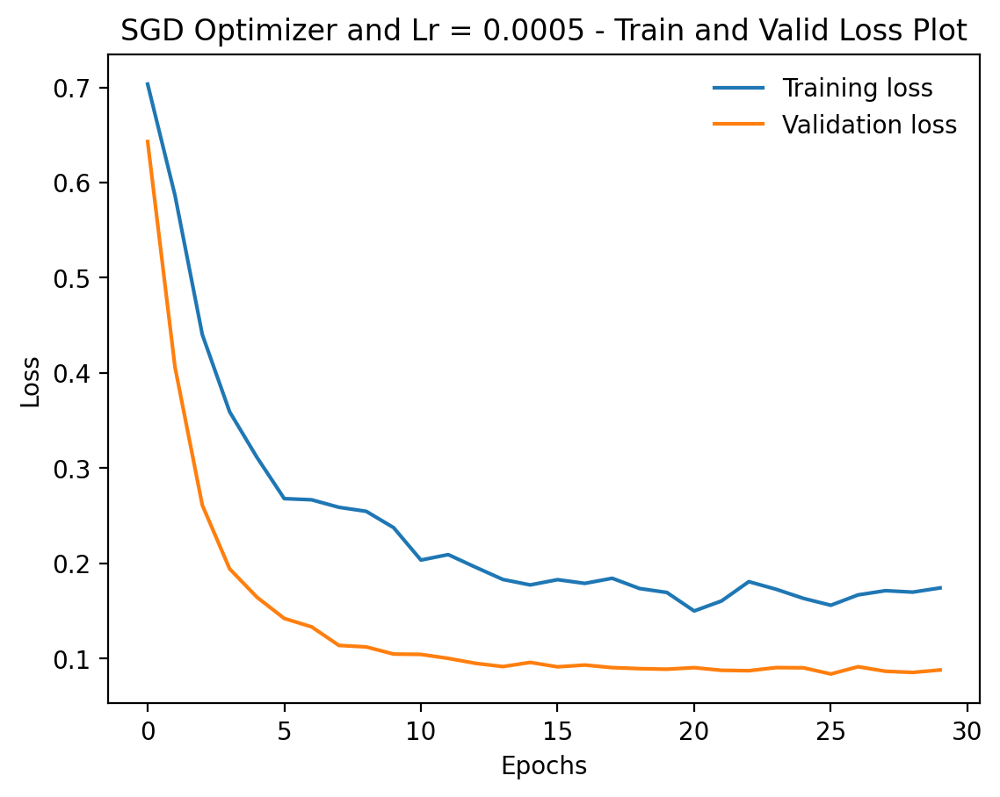

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.0005 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.0005 - Train and Valid Accuracy Plot')

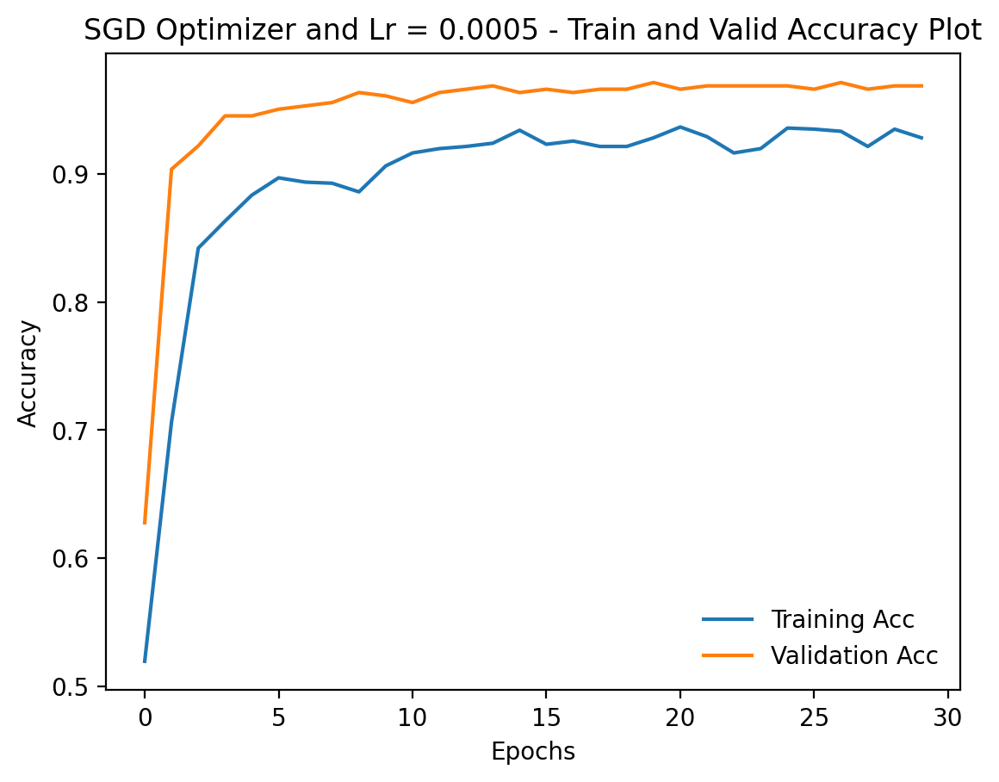

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_acc, label='Training Acc')
plt.plot(valid_acc, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.0005 - Train and Valid Accuracy Plot")

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

Loading the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

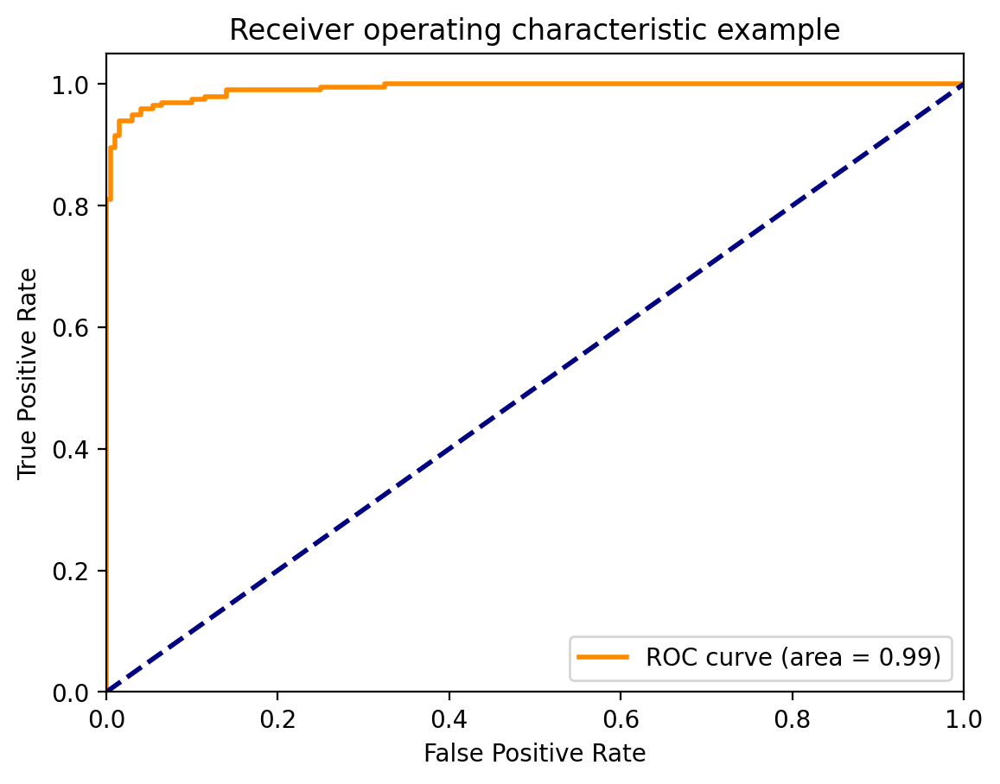

<ipython-input-165-056648a226ce>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


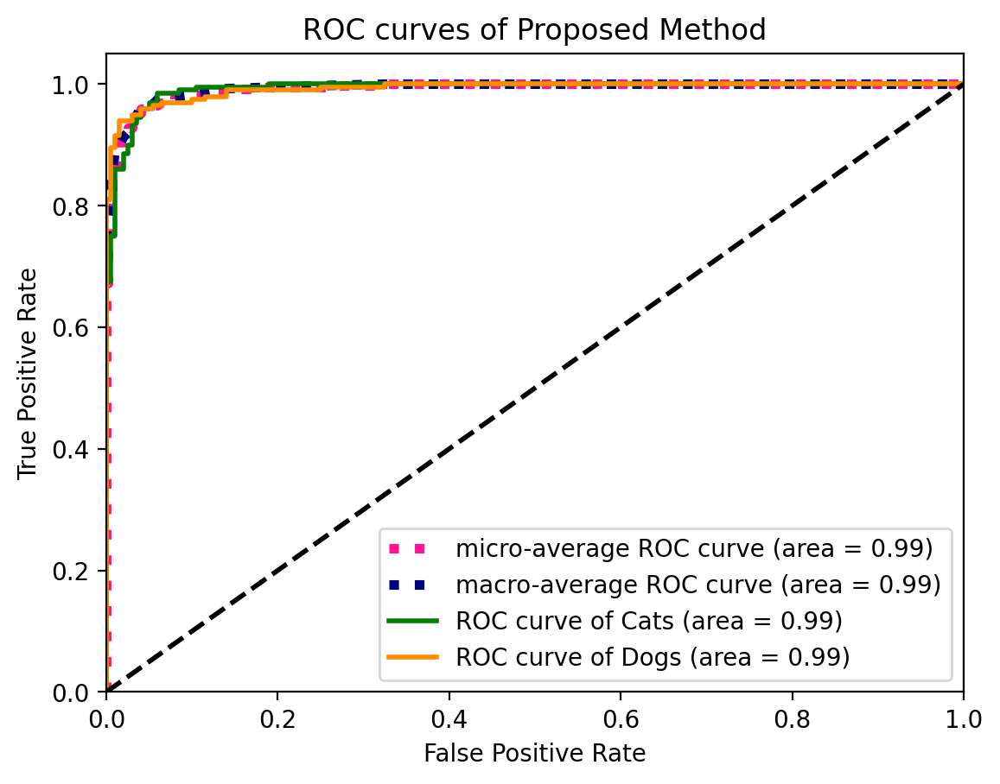

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Cats (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Dogs (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[197   3]
 [ 13 187]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


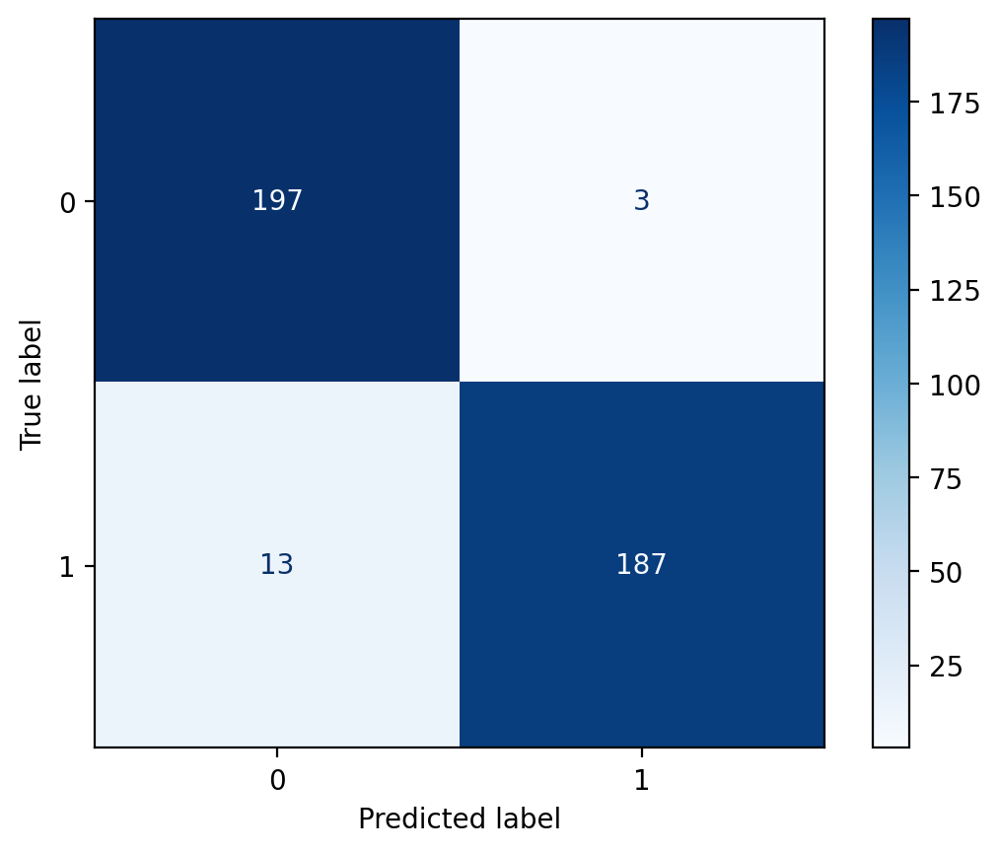

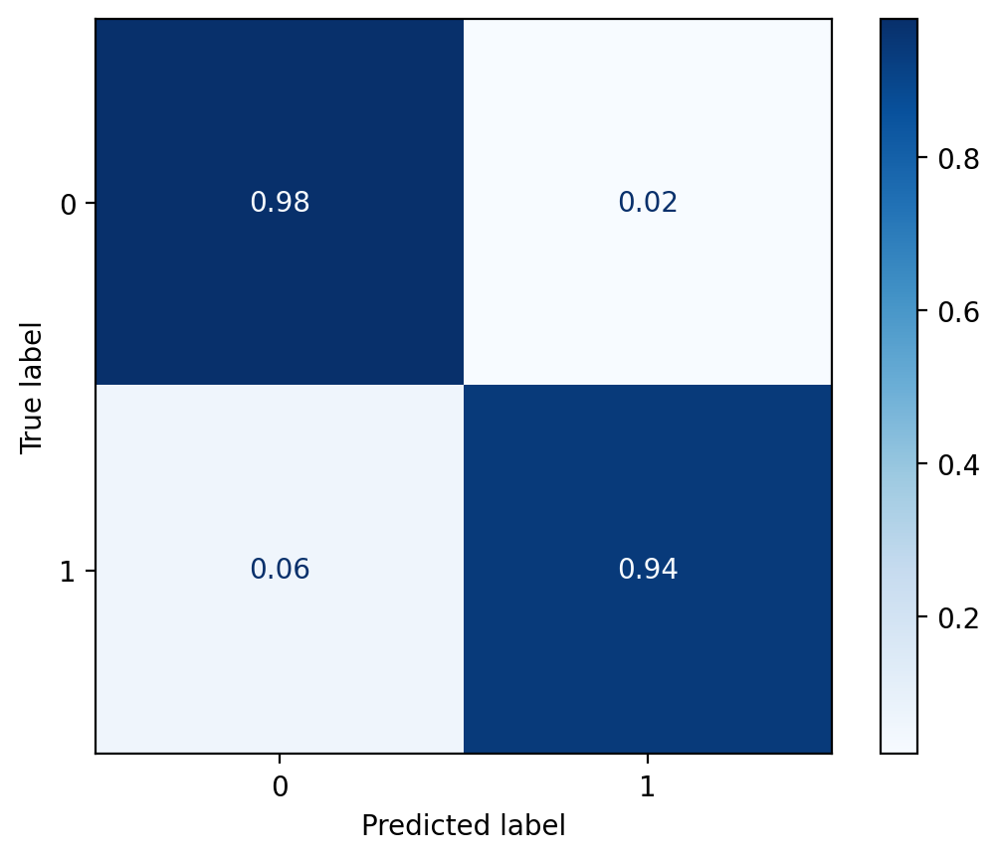

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.94, Recall: 0.98, F1_score: 0.96, Specificity: 0.94


##### RMSprop Optimizer

###### RMSprop Optimizer and lr = 0.01

Setting the hyperparameters and train the model

In [ ]:
pretrained_model = models.resnet50(pretrained = True)
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(train_ds.classes)

fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)
pretrained_model.fc = fc
model = ResNet(resnet50_config, OUTPUT_DIM)
model.load_state_dict(pretrained_model.state_dict())

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


<All keys matched successfully>

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,512,130 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-2

params = [
          {'params': model.conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.fc.parameters()}
         ]

optimizer = optim.RMSprop(params, lr = FOUND_LR)

In [ ]:
EPOCHS = 30
STEPS_PER_EPOCH = len(train_iter)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [ ]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, acc_k

In [ ]:
def train(model, iterator, optimizer, criterion, scheduler, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()


    for (x, y) in iterator:

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        scheduler.step()

        epoch_loss += loss.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_acc = []
valid_acc = []

best_valid_acc_1 = 0  # Track the best validation top-1 accuracy
best_train_acc_1 = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')
#best_valid_acc_1 = float('inf')
#best_train_acc_1 = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iter, optimizer, criterion, scheduler, device)
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_acc.append(train_acc_1)
    valid_acc.append(valid_acc_1)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc_1 > best_valid_acc_1:
        best_valid_acc_1 = valid_acc_1
    if train_acc_1 > best_train_acc_1:
        best_train_acc_1 = train_acc_1
        print(epoch)
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

0
Epoch: 01 | Epoch Time: 0m 10s
	Train Loss: 1.301 | Train Acc @1:  53.12% | Train Acc @5: 100.00%
	Valid Loss: 8712.822 | Valid Acc @1:  52.08% | Valid Acc @5: 100.00%
Epoch: 02 | Epoch Time: 0m 10s
	Train Loss: 2.096 | Train Acc @1:  49.16% | Train Acc @5: 100.00%
	Valid Loss: 8503.246 | Valid Acc @1:  52.08% | Valid Acc @5: 100.00%
Epoch: 03 | Epoch Time: 0m 10s
	Train Loss: 1.525 | Train Acc @1:  49.49% | Train Acc @5: 100.00%
	Valid Loss: 133.617 | Valid Acc @1:  43.75% | Valid Acc @5: 100.00%
Epoch: 04 | Epoch Time: 0m 10s
	Train Loss: 0.919 | Train Acc @1:  51.86% | Train Acc @5: 100.00%
	Valid Loss: 0.686 | Valid Acc @1:  49.74% | Valid Acc @5: 100.00%
Epoch: 05 | Epoch Time: 0m 10s
	Train Loss: 0.723 | Train Acc @1:  49.92% | Train Acc @5: 100.00%
	Valid Loss: 0.686 | Valid Acc @1:  52.08% | Valid Acc @5: 100.00%
Epoch: 06 | Epoch Time: 0m 10s
	Train Loss: 0.777 | Train Acc @1:  48.56% | Train Acc @5: 100.00%
	Valid Loss: 0.702 | Valid Acc @1:  48.44% | Valid Acc @5: 100.00%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc_1 * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc_1 * 100))

Lowest valid_loss: 67.37%
Best valid_Acc: 61.72%
Lowest train_loss: 67.60%
Best train_Acc: 57.43%


Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.01 - Train and Valid Loss Plot')

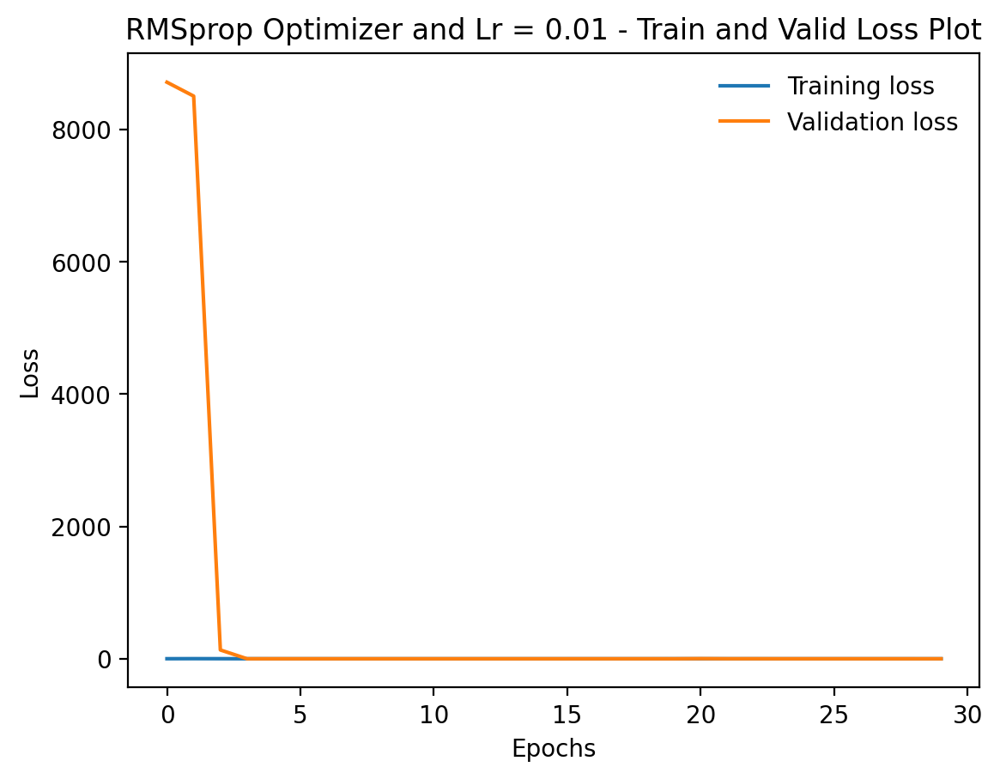

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.01 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.01 - Train and Valid Accuracy Plot')

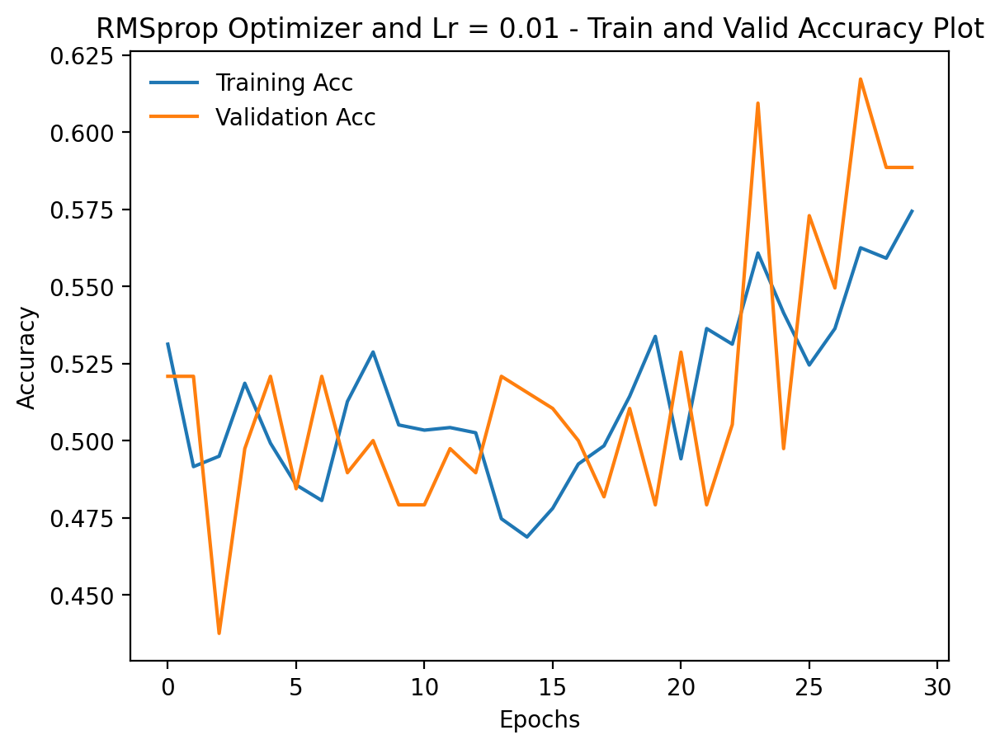

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_acc, label='Training Acc')
plt.plot(valid_acc, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.01 - Train and Valid Accuracy Plot")

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

Loading the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

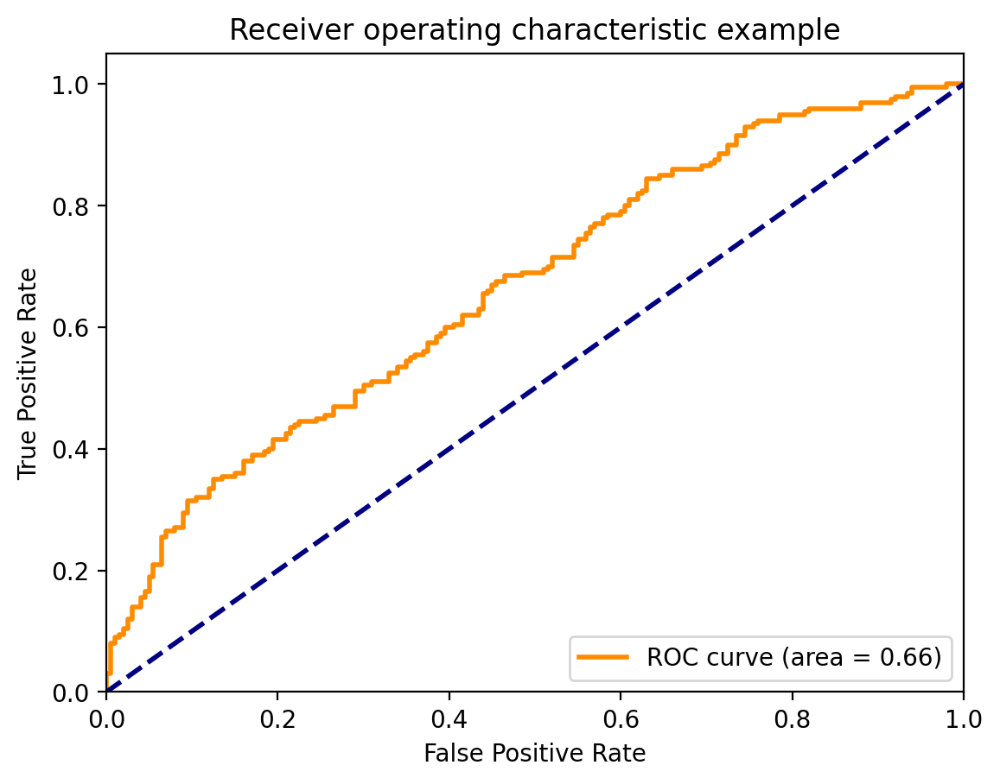

<ipython-input-184-056648a226ce>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


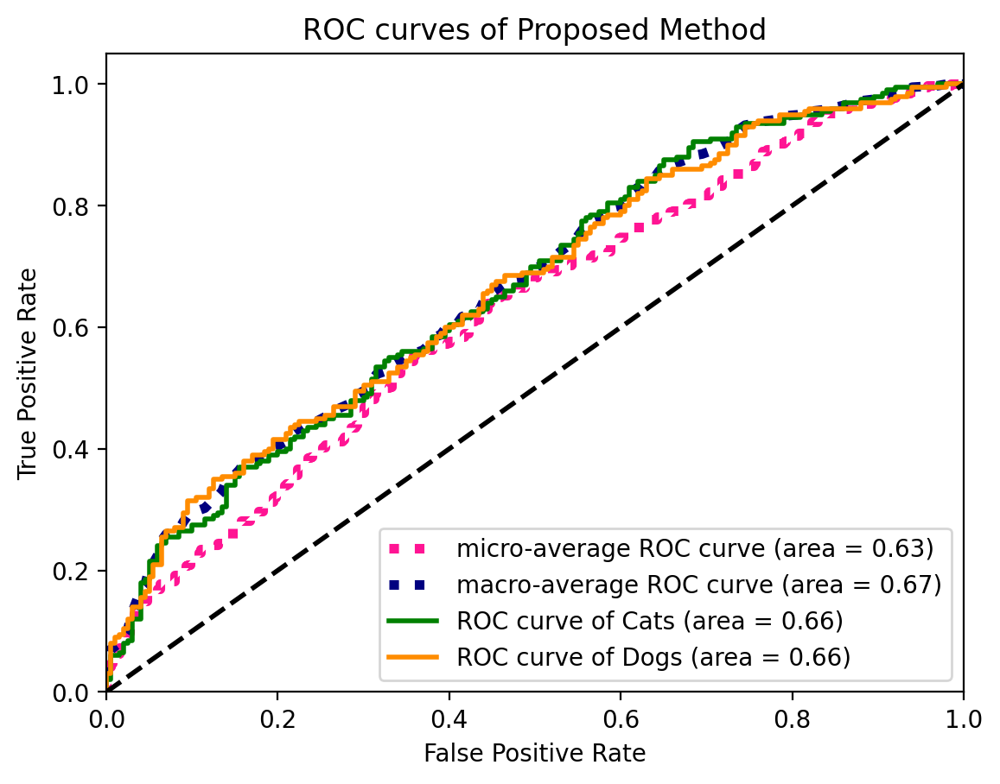

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Cats (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Dogs (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[ 61 139]
 [ 27 173]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


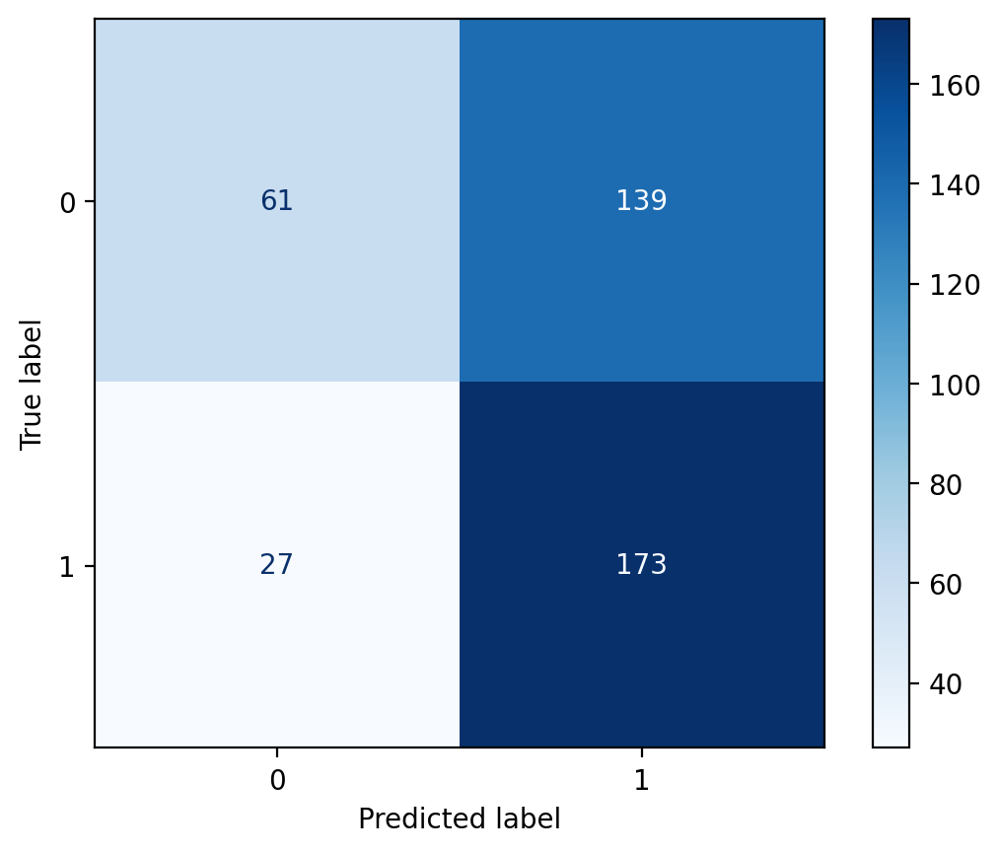

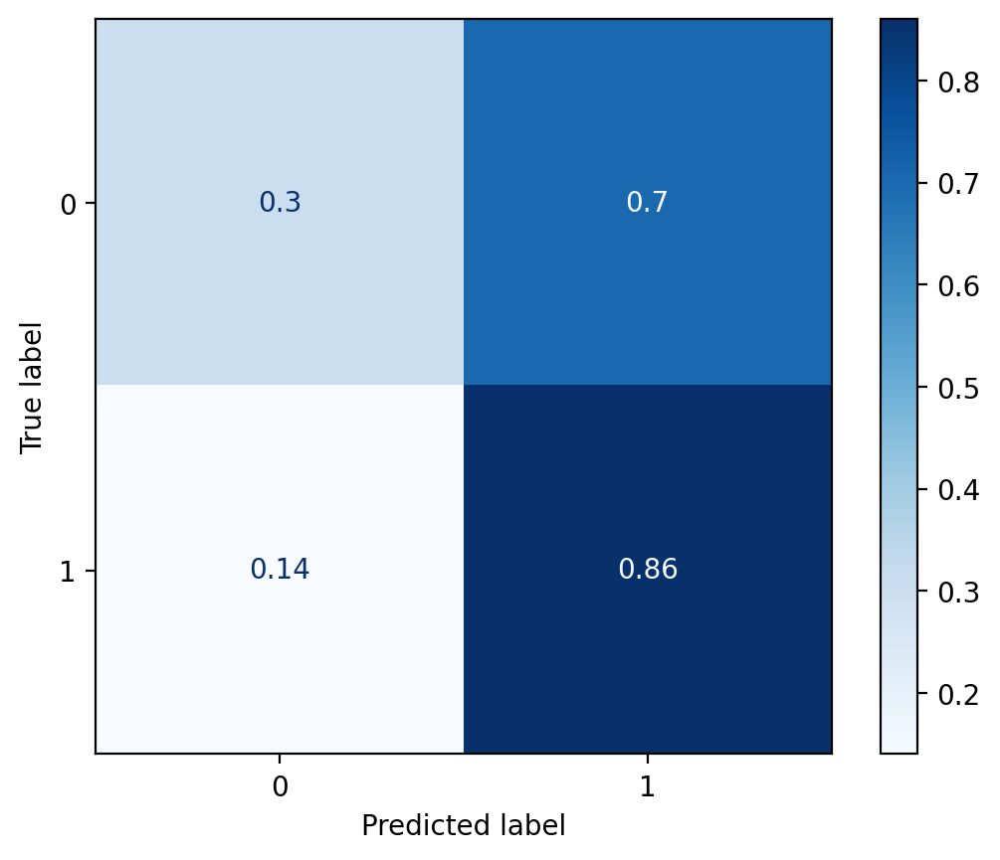

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.69, Recall: 0.30, F1_score: 0.42, Specificity: 0.86


###### RMSprop Optimizer and lr = 0.001

In [ ]:
pretrained_model = models.resnet50(pretrained = True)
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(train_ds.classes)

fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)
pretrained_model.fc = fc
model = ResNet(resnet50_config, OUTPUT_DIM)
model.load_state_dict(pretrained_model.state_dict())

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


<All keys matched successfully>

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,512,130 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-3

params = [
          {'params': model.conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.fc.parameters()}
         ]

optimizer = optim.RMSprop(params, lr = FOUND_LR)

In [ ]:
EPOCHS = 30
STEPS_PER_EPOCH = len(train_iter)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [ ]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, acc_k

In [ ]:
def train(model, iterator, optimizer, criterion, scheduler, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()


    for (x, y) in iterator:

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        scheduler.step()

        epoch_loss += loss.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_acc = []
valid_acc = []

best_valid_acc_1 = 0  # Track the best validation top-1 accuracy
best_train_acc_1 = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')
#best_valid_acc_1 = float('inf')
#best_train_acc_1 = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iter, optimizer, criterion, scheduler, device)
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_acc.append(train_acc_1)
    valid_acc.append(valid_acc_1)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc_1 > best_valid_acc_1:
        best_valid_acc_1 = valid_acc_1
    if train_acc_1 > best_train_acc_1:
        best_train_acc_1 = train_acc_1
        print(epoch)
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

0
Epoch: 01 | Epoch Time: 0m 10s
	Train Loss: 0.507 | Train Acc @1:  78.55% | Train Acc @5: 100.00%
	Valid Loss: 0.974 | Valid Acc @1:  79.17% | Valid Acc @5: 100.00%
1
Epoch: 02 | Epoch Time: 0m 10s
	Train Loss: 0.438 | Train Acc @1:  80.83% | Train Acc @5: 100.00%
	Valid Loss: 101.083 | Valid Acc @1:  59.11% | Valid Acc @5: 100.00%
Epoch: 03 | Epoch Time: 0m 10s
	Train Loss: 0.993 | Train Acc @1:  61.49% | Train Acc @5: 100.00%
	Valid Loss: 11.899 | Valid Acc @1:  53.65% | Valid Acc @5: 100.00%
Epoch: 04 | Epoch Time: 0m 10s
	Train Loss: 0.832 | Train Acc @1:  53.55% | Train Acc @5: 100.00%
	Valid Loss: 0.961 | Valid Acc @1:  56.77% | Valid Acc @5: 100.00%
Epoch: 05 | Epoch Time: 0m 10s
	Train Loss: 0.730 | Train Acc @1:  58.19% | Train Acc @5: 100.00%
	Valid Loss: 0.588 | Valid Acc @1:  67.71% | Valid Acc @5: 100.00%
Epoch: 06 | Epoch Time: 0m 10s
	Train Loss: 0.706 | Train Acc @1:  60.30% | Train Acc @5: 100.00%
	Valid Loss: 1.377 | Valid Acc @1:  73.96% | Valid Acc @5: 100.00%
Epo

In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc_1 * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc_1 * 100))

Lowest valid_loss: 21.80%
Best valid_Acc: 91.15%
Lowest train_loss: 22.89%
Best train_Acc: 90.03%


Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.001 - Train and Valid Loss Plot')

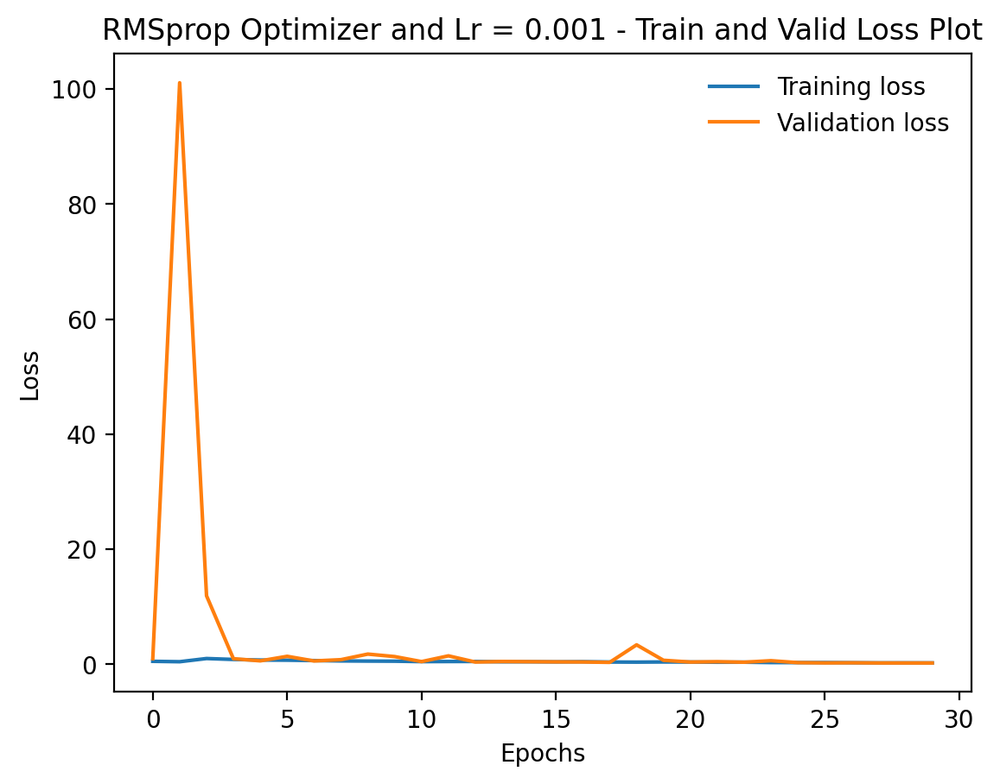

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.001 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.001 - Train and Valid Accuracy Plot')

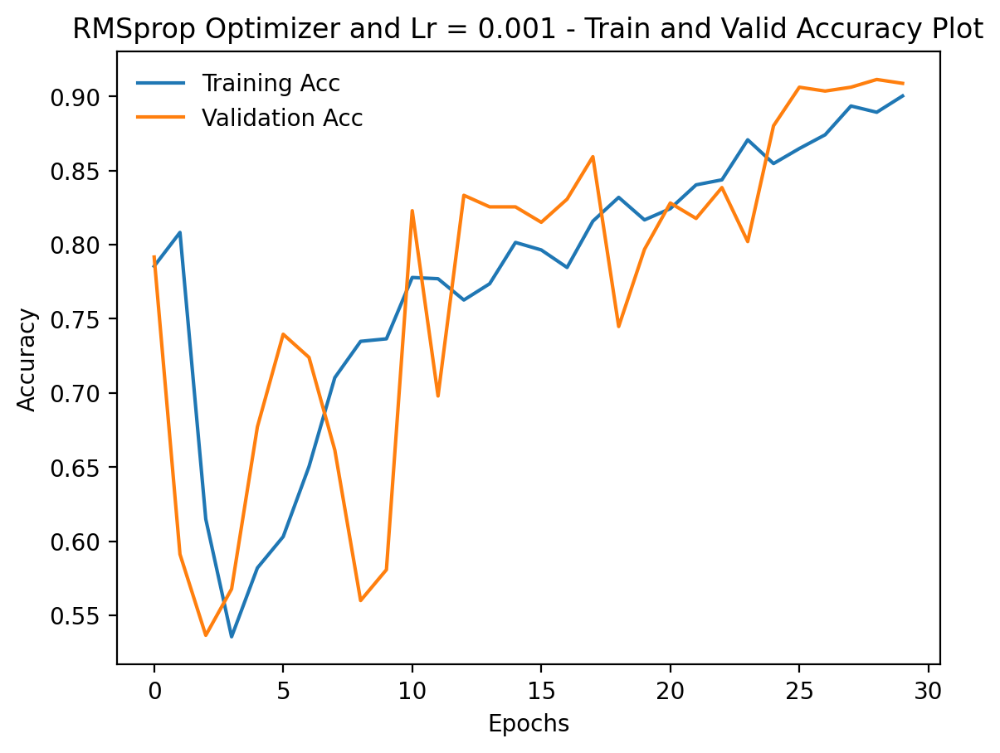

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_acc, label='Training Acc')
plt.plot(valid_acc, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.001 - Train and Valid Accuracy Plot")

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

Loading the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

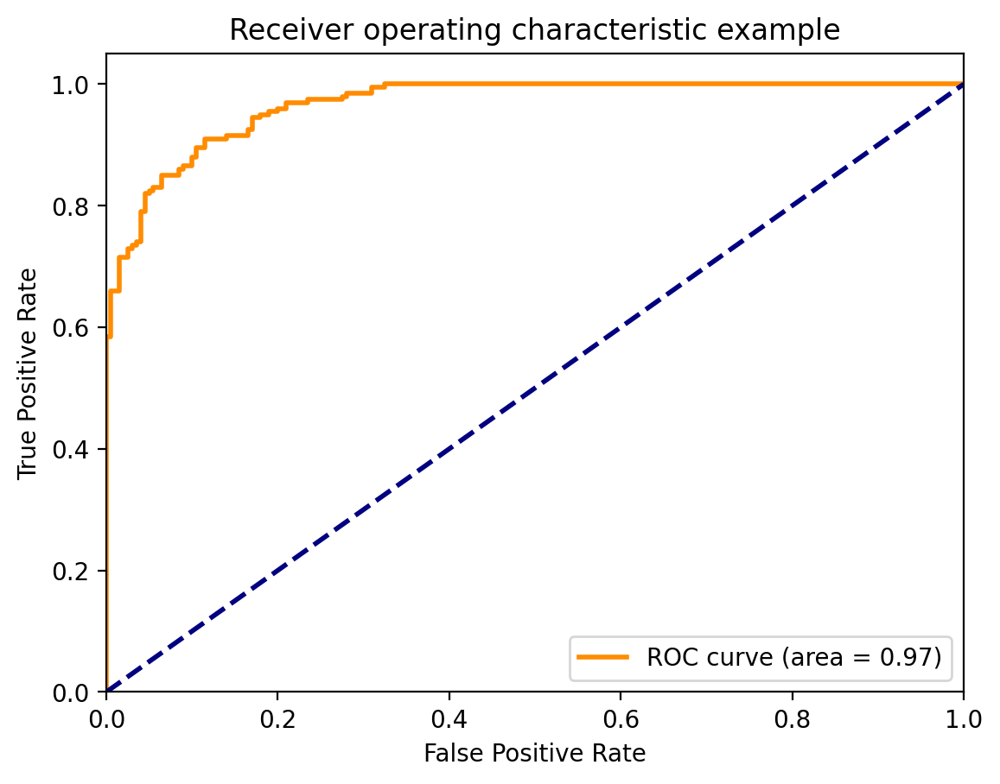

<ipython-input-203-056648a226ce>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


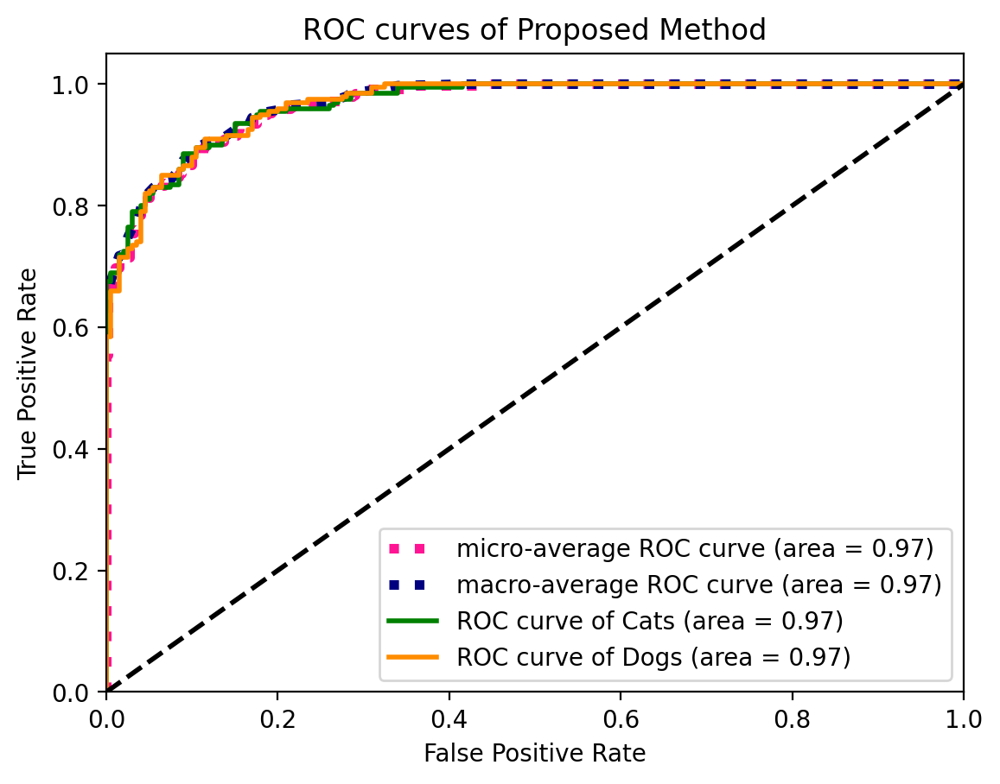

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Cats (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Dogs (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[173  27]
 [ 18 182]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


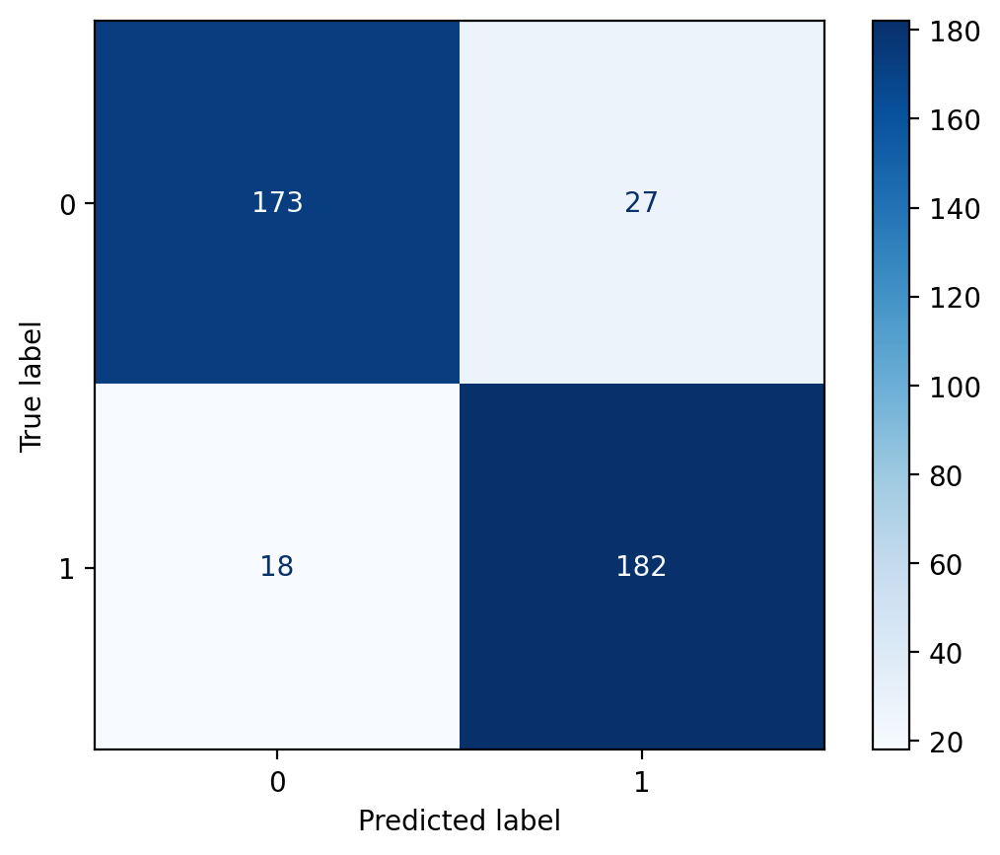

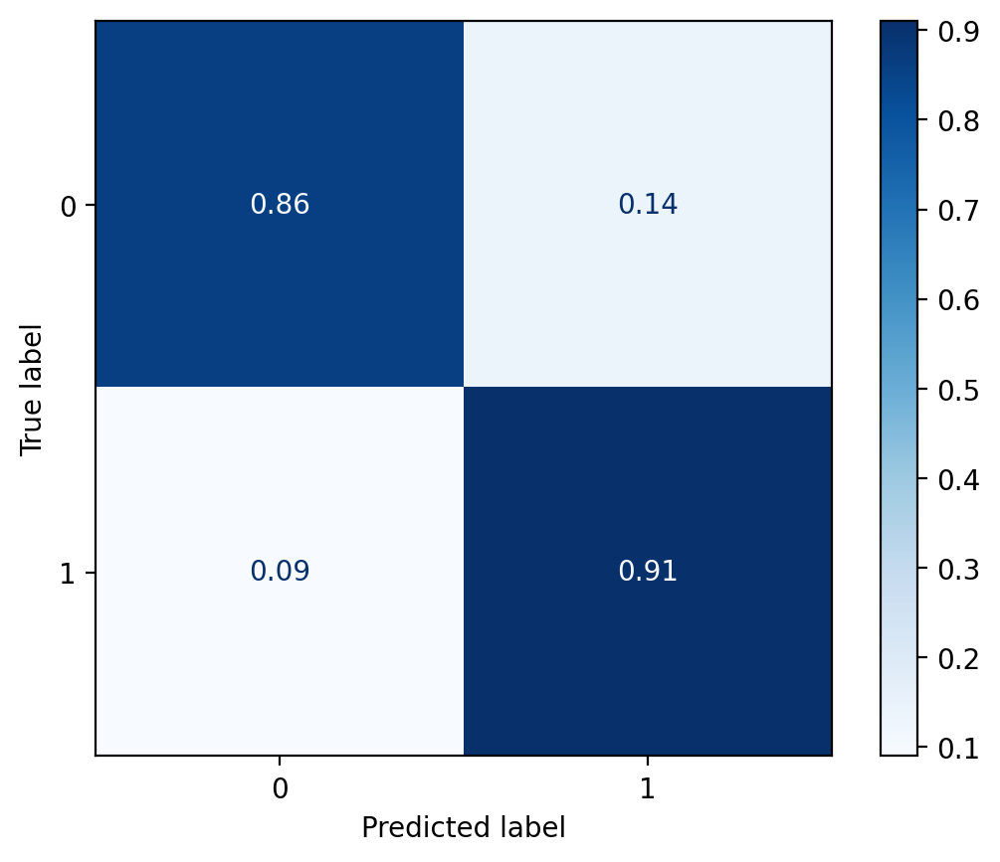

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.91, Recall: 0.86, F1_score: 0.88, Specificity: 0.91


###### RMSprop Optimizer and lr = 0.0001

In [ ]:
pretrained_model = models.resnet50(pretrained = True)
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(train_ds.classes)

fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)
pretrained_model.fc = fc
model = ResNet(resnet50_config, OUTPUT_DIM)
model.load_state_dict(pretrained_model.state_dict())

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


<All keys matched successfully>

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,512,130 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-4

params = [
          {'params': model.conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.fc.parameters()}
         ]

optimizer = optim.RMSprop(params, lr = FOUND_LR)

In [ ]:
EPOCHS = 30
STEPS_PER_EPOCH = len(train_iter)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [ ]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, acc_k

In [ ]:
def train(model, iterator, optimizer, criterion, scheduler, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()


    for (x, y) in iterator:

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        scheduler.step()

        epoch_loss += loss.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_acc = []
valid_acc = []

best_valid_acc_1 = 0  # Track the best validation top-1 accuracy
best_train_acc_1 = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')
#best_valid_acc_1 = float('inf')
#best_train_acc_1 = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iter, optimizer, criterion, scheduler, device)
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_acc.append(train_acc_1)
    valid_acc.append(valid_acc_1)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc_1 > best_valid_acc_1:
        best_valid_acc_1 = valid_acc_1
    if train_acc_1 > best_train_acc_1:
        best_train_acc_1 = train_acc_1
        print(epoch)
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

0
Epoch: 01 | Epoch Time: 0m 10s
	Train Loss: 0.328 | Train Acc @1:  84.88% | Train Acc @5: 100.00%
	Valid Loss: 0.072 | Valid Acc @1:  97.14% | Valid Acc @5: 100.00%
1
Epoch: 02 | Epoch Time: 0m 11s
	Train Loss: 0.188 | Train Acc @1:  92.82% | Train Acc @5: 100.00%
	Valid Loss: 0.364 | Valid Acc @1:  93.23% | Valid Acc @5: 100.00%
Epoch: 03 | Epoch Time: 0m 10s
	Train Loss: 0.178 | Train Acc @1:  92.06% | Train Acc @5: 100.00%
	Valid Loss: 0.224 | Valid Acc @1:  92.97% | Valid Acc @5: 100.00%
Epoch: 04 | Epoch Time: 0m 10s
	Train Loss: 0.218 | Train Acc @1:  90.46% | Train Acc @5: 100.00%
	Valid Loss: 0.138 | Valid Acc @1:  94.79% | Valid Acc @5: 100.00%
4
Epoch: 05 | Epoch Time: 0m 10s
	Train Loss: 0.164 | Train Acc @1:  93.07% | Train Acc @5: 100.00%
	Valid Loss: 0.125 | Valid Acc @1:  96.09% | Valid Acc @5: 100.00%
5
Epoch: 06 | Epoch Time: 0m 10s
	Train Loss: 0.162 | Train Acc @1:  93.16% | Train Acc @5: 100.00%
	Valid Loss: 0.214 | Valid Acc @1:  93.23% | Valid Acc @5: 100.00%
Ep

In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc_1 * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc_1 * 100))

Lowest valid_loss: 7.10%
Best valid_Acc: 97.14%
Lowest train_loss: 5.90%
Best train_Acc: 97.55%


Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.0001 - Train and Valid Loss Plot')

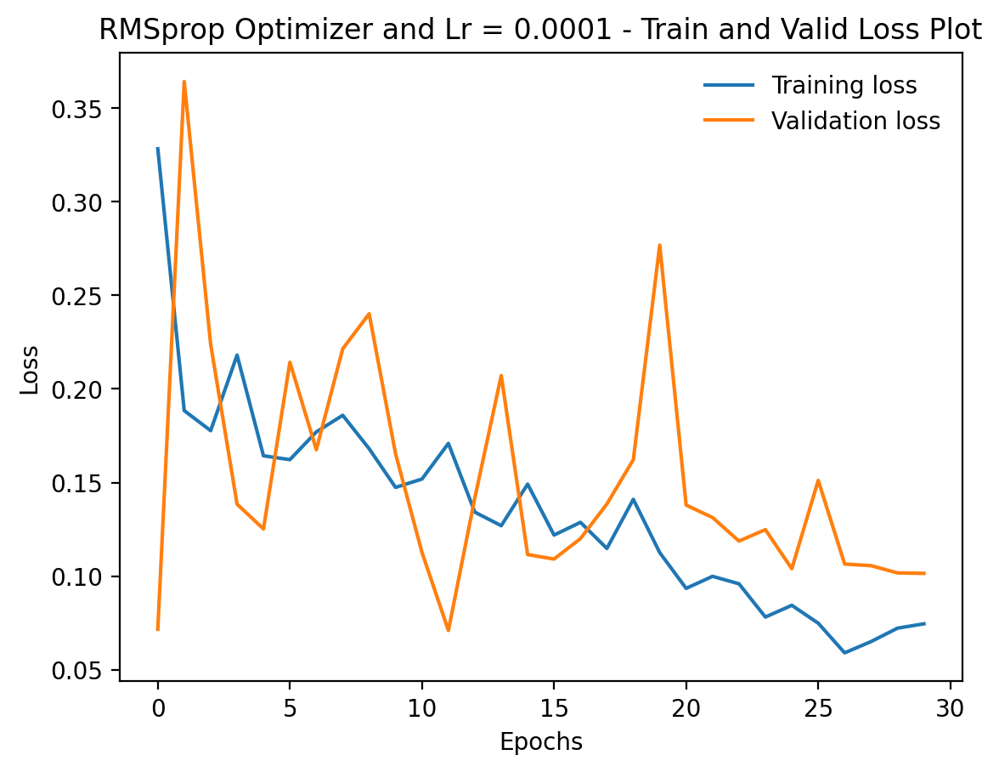

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.0001 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.0001 - Train and Valid Accuracy Plot')

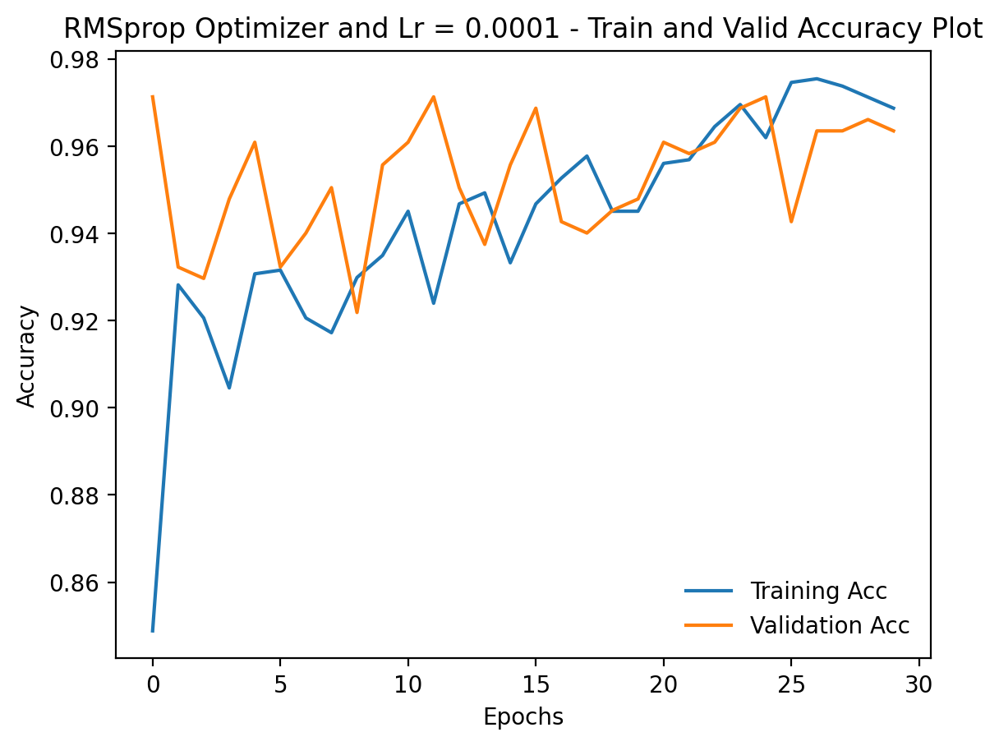

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_acc, label='Training Acc')
plt.plot(valid_acc, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.0001 - Train and Valid Accuracy Plot")

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

Loading the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

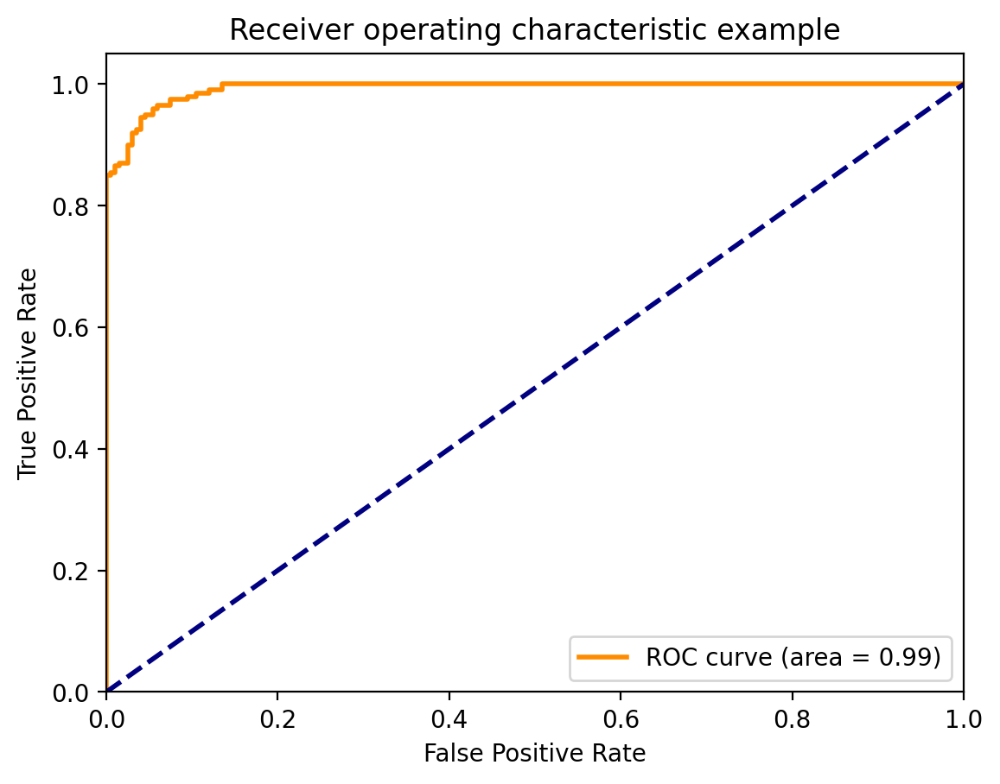

<ipython-input-222-056648a226ce>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


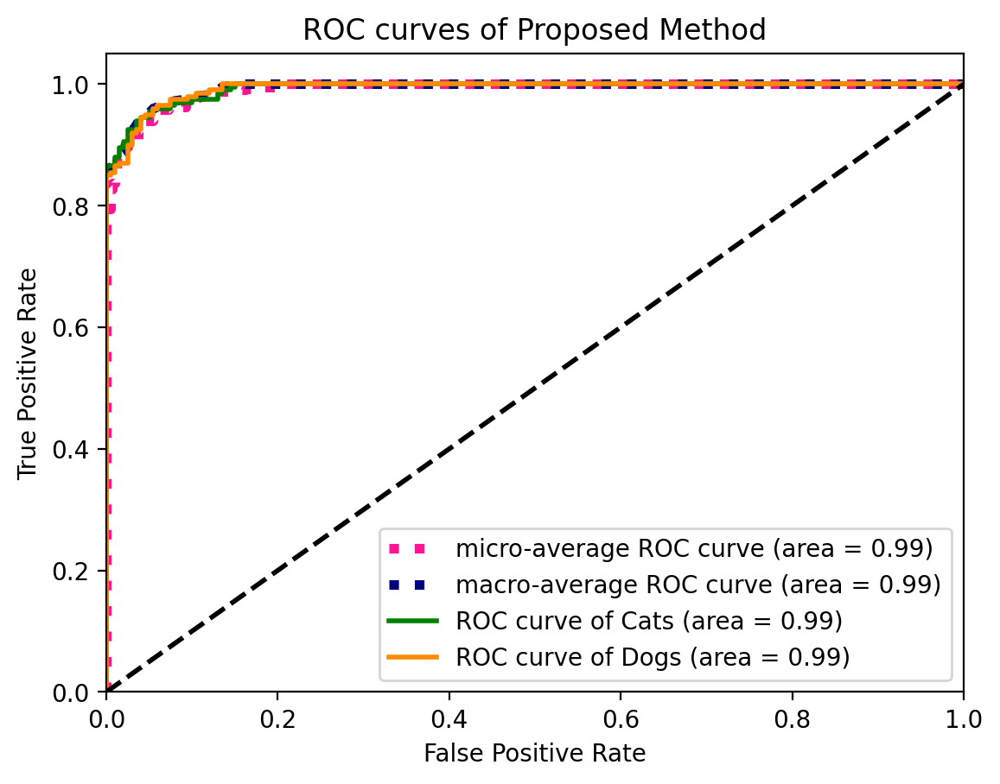

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Cats (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Dogs (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[193   7]
 [ 16 184]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


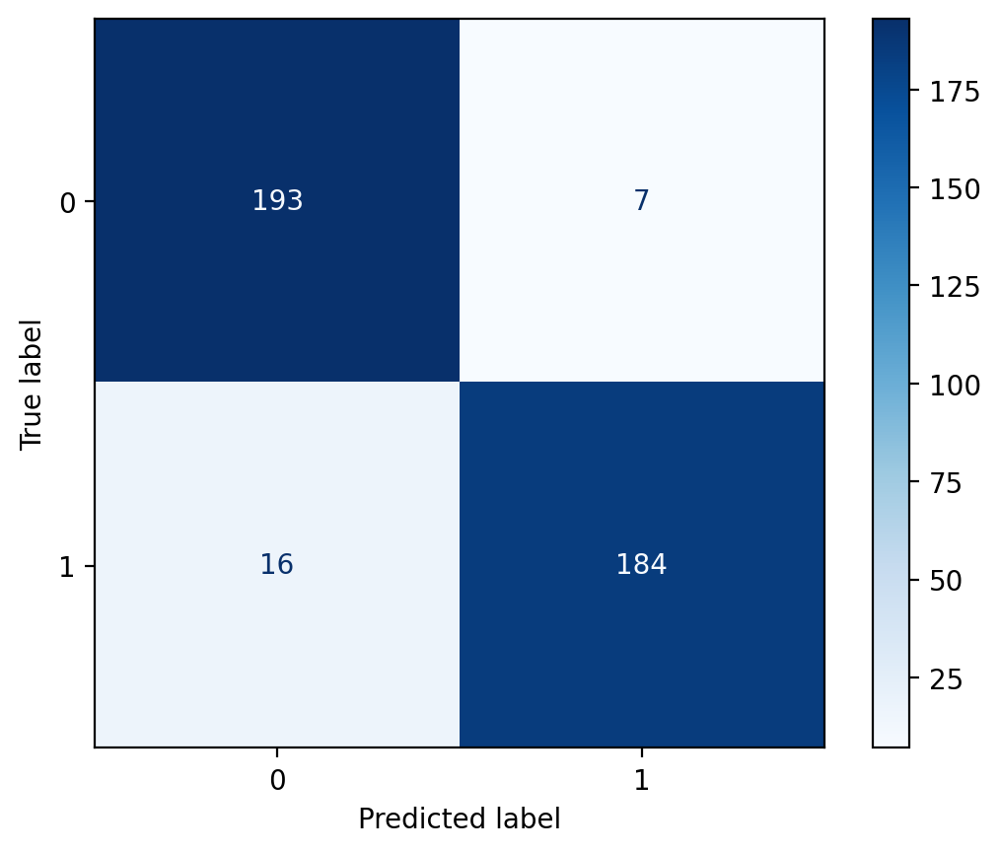

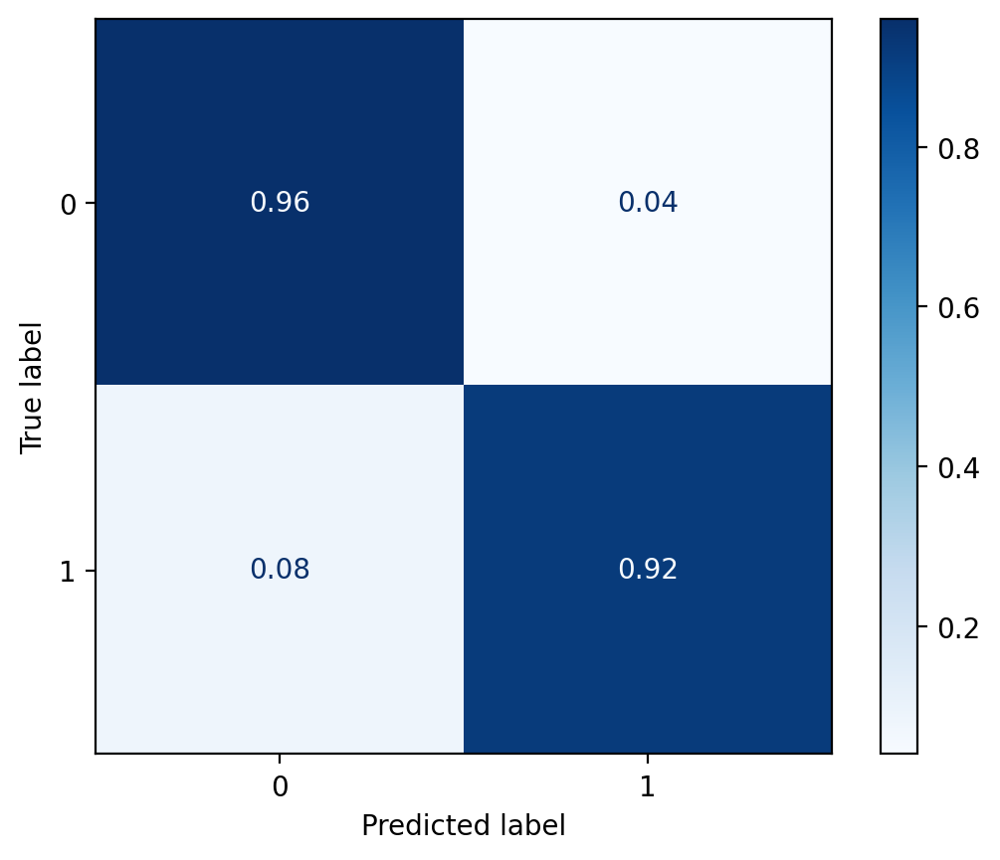

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.92, Recall: 0.96, F1_score: 0.94, Specificity: 0.92


###### RMSprop Optimizer and lr = 0.0005

In [ ]:
pretrained_model = models.resnet50(pretrained = True)
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(train_ds.classes)

fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)
pretrained_model.fc = fc
model = ResNet(resnet50_config, OUTPUT_DIM)
model.load_state_dict(pretrained_model.state_dict())

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


<All keys matched successfully>

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,512,130 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 5e-4

params = [
          {'params': model.conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.fc.parameters()}
         ]

optimizer = optim.RMSprop(params, lr = FOUND_LR)

In [ ]:
EPOCHS = 30
STEPS_PER_EPOCH = len(train_iter)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [ ]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, acc_k

In [ ]:
def train(model, iterator, optimizer, criterion, scheduler, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()


    for (x, y) in iterator:

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        scheduler.step()

        epoch_loss += loss.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_acc = []
valid_acc = []

best_valid_acc_1 = 0  # Track the best validation top-1 accuracy
best_train_acc_1 = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')
#best_valid_acc_1 = float('inf')
#best_train_acc_1 = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iter, optimizer, criterion, scheduler, device)
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_acc.append(train_acc_1)
    valid_acc.append(valid_acc_1)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc_1 > best_valid_acc_1:
        best_valid_acc_1 = valid_acc_1
    if train_acc_1 > best_train_acc_1:
        best_train_acc_1 = train_acc_1
        print(epoch)
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

0
Epoch: 01 | Epoch Time: 0m 10s
	Train Loss: 0.371 | Train Acc @1:  82.69% | Train Acc @5: 100.00%
	Valid Loss: 0.583 | Valid Acc @1:  90.36% | Valid Acc @5: 100.00%
1
Epoch: 02 | Epoch Time: 0m 10s
	Train Loss: 0.301 | Train Acc @1:  88.18% | Train Acc @5: 100.00%
	Valid Loss: 0.390 | Valid Acc @1:  91.15% | Valid Acc @5: 100.00%
Epoch: 03 | Epoch Time: 0m 10s
	Train Loss: 0.341 | Train Acc @1:  83.87% | Train Acc @5: 100.00%
	Valid Loss: 0.421 | Valid Acc @1:  90.36% | Valid Acc @5: 100.00%
Epoch: 04 | Epoch Time: 0m 10s
	Train Loss: 0.438 | Train Acc @1:  82.35% | Train Acc @5: 100.00%
	Valid Loss: 2.008 | Valid Acc @1:  80.47% | Valid Acc @5: 100.00%
Epoch: 05 | Epoch Time: 0m 10s
	Train Loss: 0.468 | Train Acc @1:  82.01% | Train Acc @5: 100.00%
	Valid Loss: 165.067 | Valid Acc @1:  55.99% | Valid Acc @5: 100.00%
Epoch: 06 | Epoch Time: 0m 9s
	Train Loss: 0.821 | Train Acc @1:  65.88% | Train Acc @5: 100.00%
	Valid Loss: 1.780 | Valid Acc @1:  63.80% | Valid Acc @5: 100.00%
Epoch

In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc_1 * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc_1 * 100))

Lowest valid_loss: 18.75%
Best valid_Acc: 93.49%
Lowest train_loss: 18.45%
Best train_Acc: 92.15%


Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.0005 - Train and Valid Loss Plot')

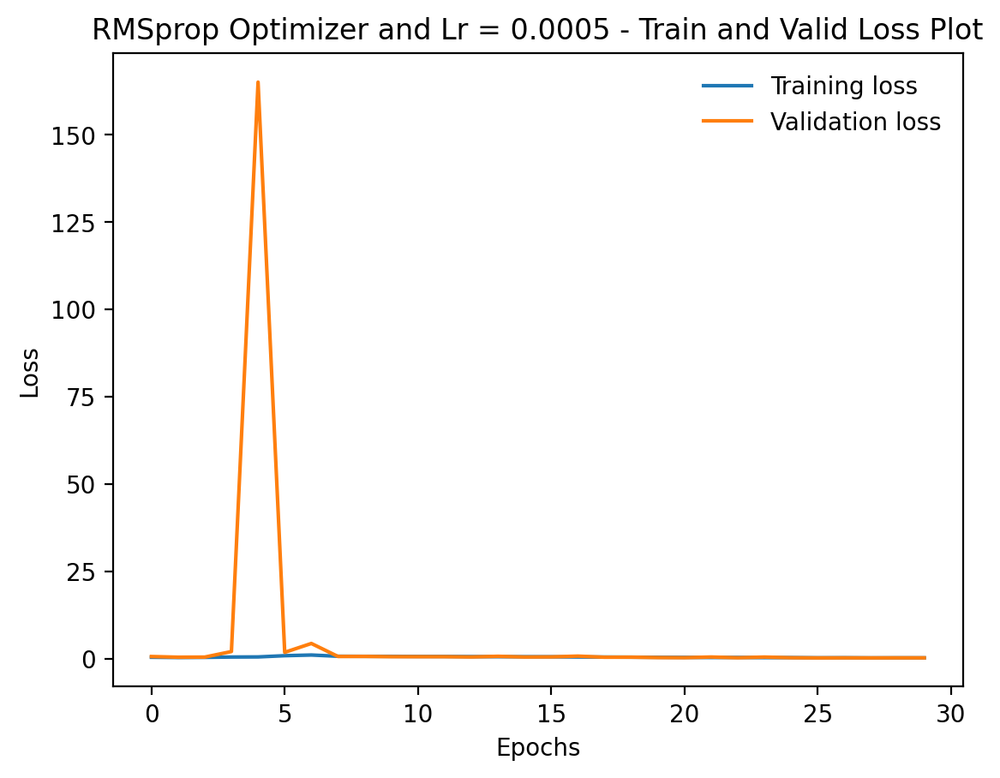

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.0005 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.0005 - Train and Valid Accuracy Plot')

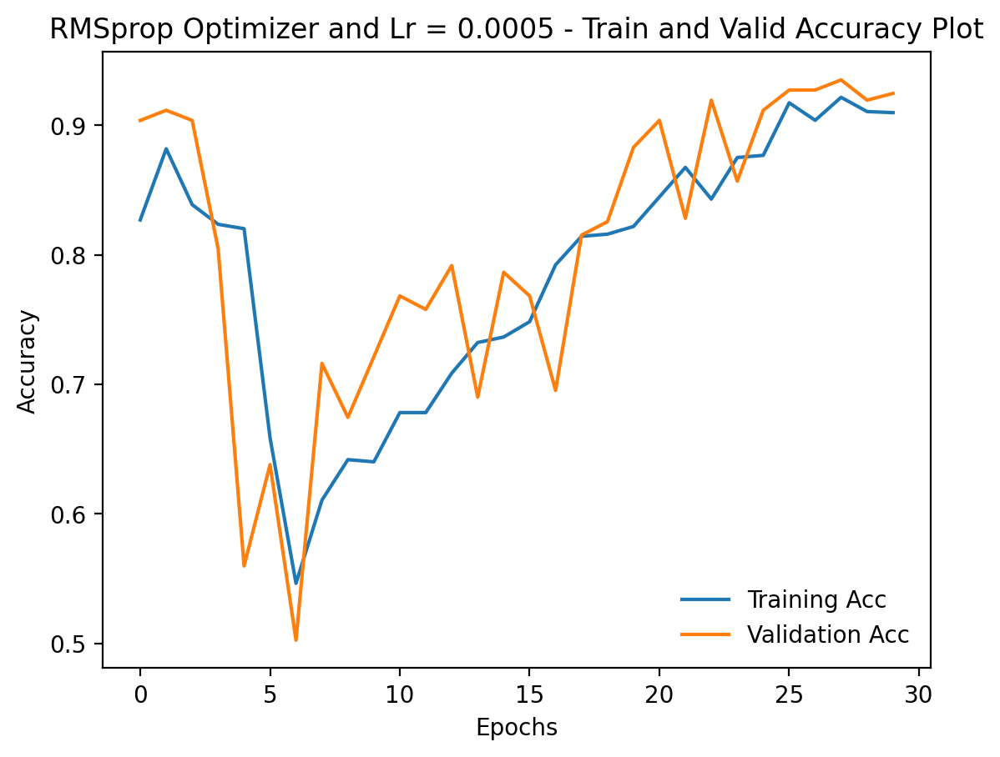

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_acc, label='Training Acc')
plt.plot(valid_acc, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.0005 - Train and Valid Accuracy Plot")

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

Loading the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

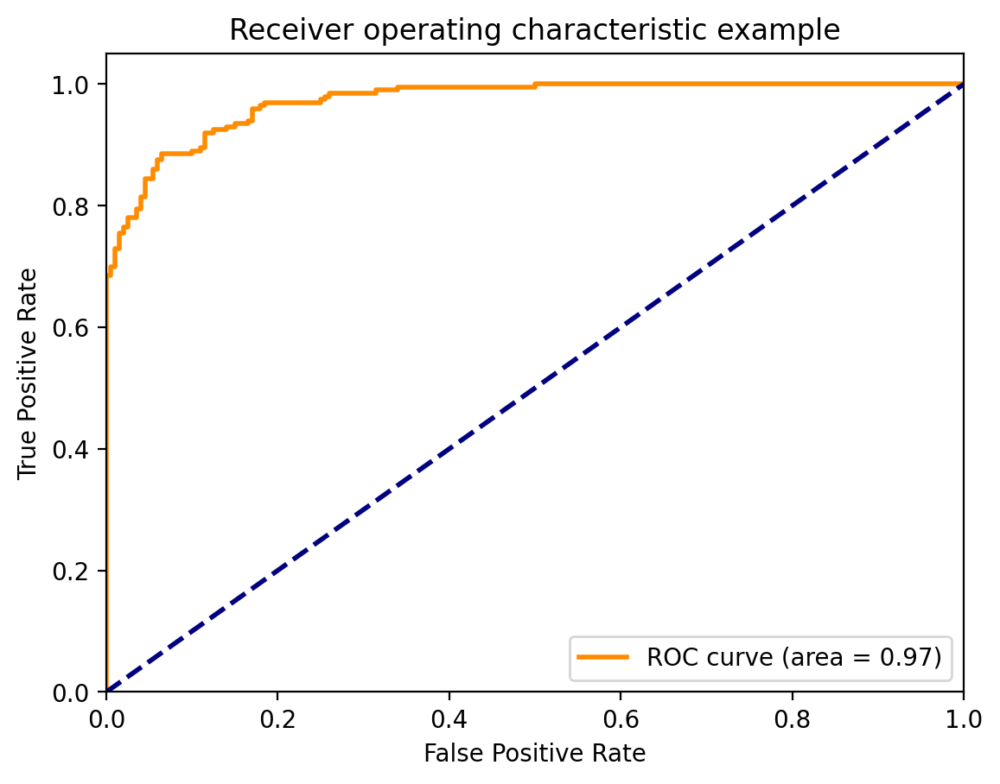

<ipython-input-241-056648a226ce>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


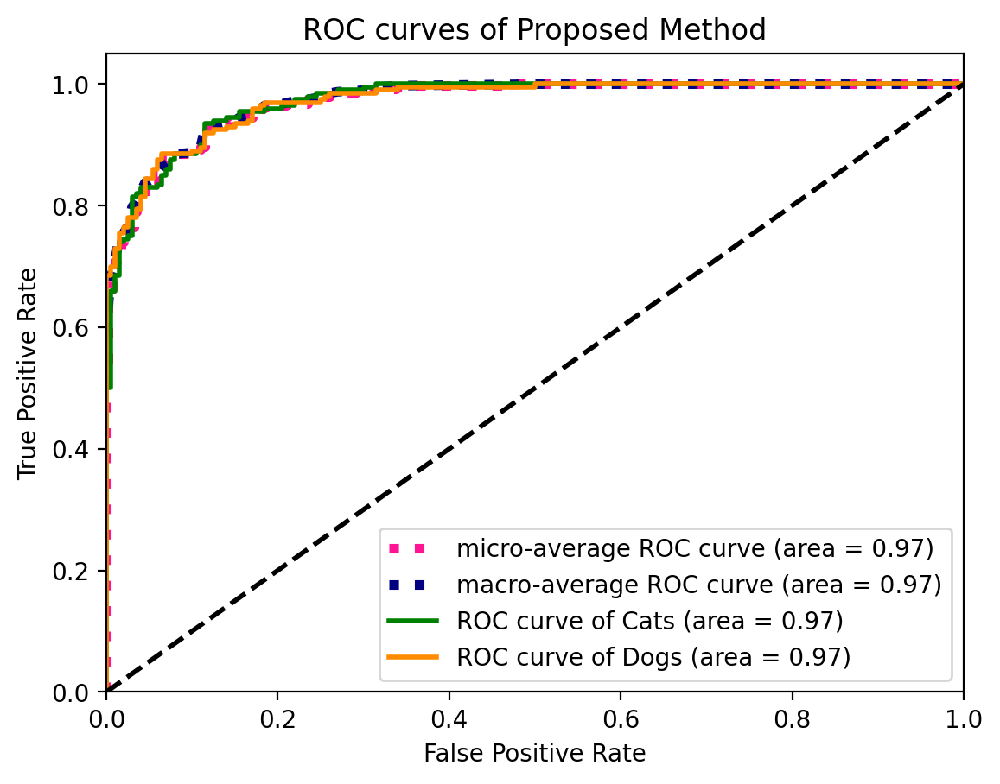

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Cats (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Dogs (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[179  21]
 [ 22 178]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


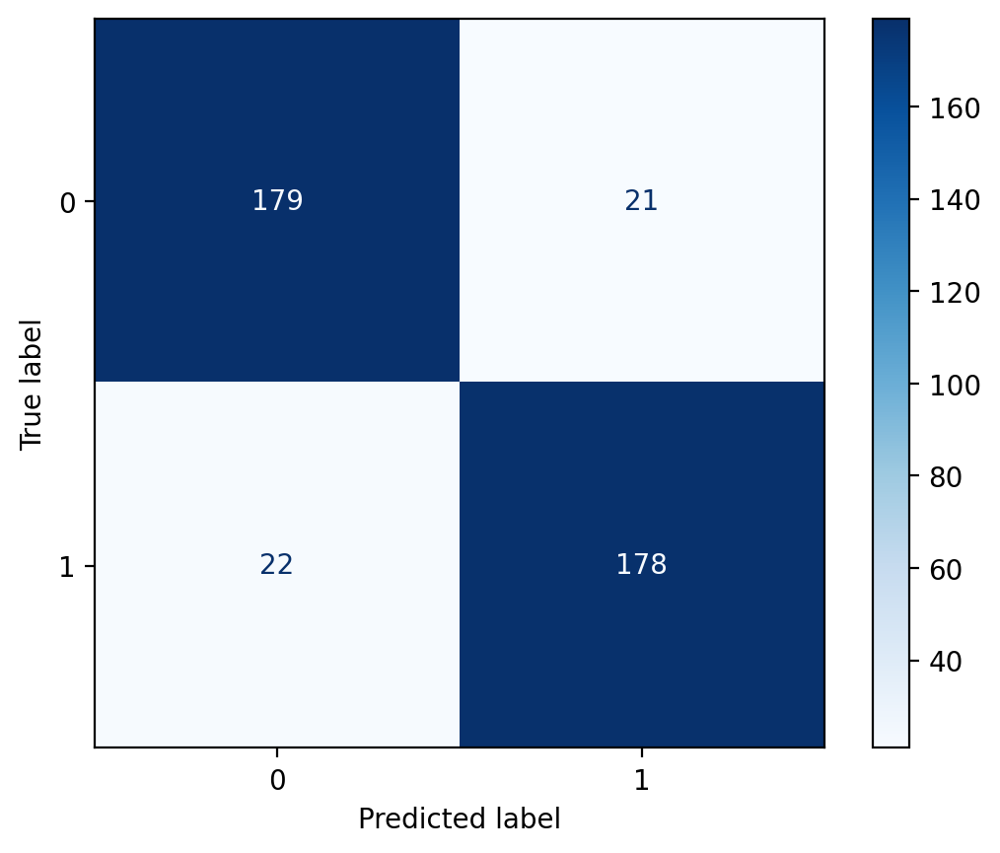

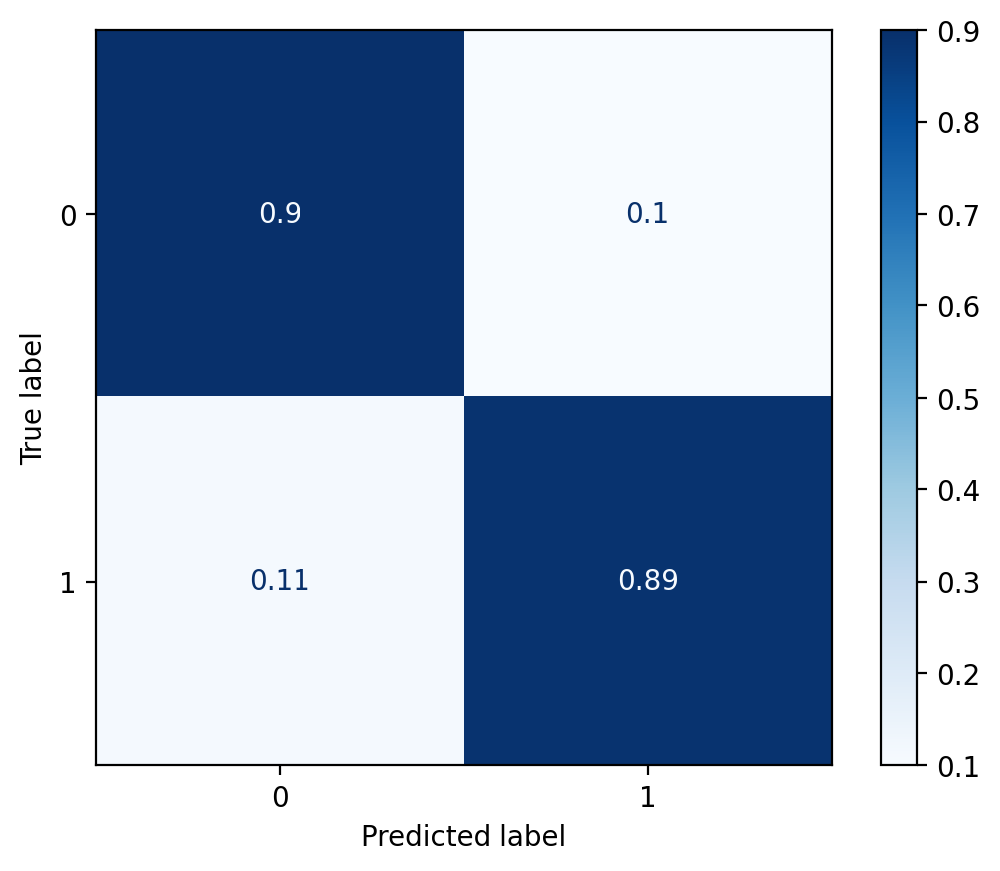

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.89, Recall: 0.90, F1_score: 0.89, Specificity: 0.89


# Define the CNN Pretrained Model Class - VGG

## Defining the CNN - VGG and its variation.
##MIT License: Copyright (c) 2018 Ben Trevett.

Define the CNN - this example will focus on VGG and its variation. DO NOT CHANGE THE CODE IN THESE PARTS. MIT License: Copyright (c) 2018 Ben Trevett.

In [ ]:
class VGG(nn.Module):
    def __init__(self, features, output_dim):
        super().__init__()

        self.features = features

        self.avgpool = nn.AdaptiveAvgPool2d(7)

        self.classifier = nn.Sequential(
            nn.Linear(512 * 7 * 7, 4096),
            nn.ReLU(inplace=True),
            nn.Dropout(0.5),
            nn.Linear(4096, 4096),
            nn.ReLU(inplace=True),
            nn.Dropout(0.5),
            nn.Linear(4096, output_dim),
        )

    def forward(self, x):
        x = self.features(x)
        x = self.avgpool(x)
        h = x.view(x.shape[0], -1)
        x = self.classifier(h)
        return x, h

vgg11_config = [64, 'M', 128, 'M', 256, 256, 'M', 512, 512, 'M', 512, 512, 'M']

vgg13_config = [64, 64, 'M', 128, 128, 'M', 256, 256, 'M', 512, 512, 'M', 512,
                512, 'M']

vgg16_config = [64, 64, 'M', 128, 128, 'M', 256, 256, 256, 'M', 512, 512, 512,
                'M', 512, 512, 512, 'M']

vgg19_config = [64, 64, 'M', 128, 128, 'M', 256, 256, 256, 256, 'M', 512, 512,
                512, 512, 'M', 512, 512, 512, 512, 'M']

def get_vgg_layers(config, batch_norm):

    layers = []
    in_channels = 3

    for c in config:
        assert c == 'M' or isinstance(c, int)
        if c == 'M':
            layers += [nn.MaxPool2d(kernel_size=2)]
        else:
            conv2d = nn.Conv2d(in_channels, c, kernel_size=3, padding=1)
            if batch_norm:
                layers += [conv2d, nn.BatchNorm2d(c), nn.ReLU(inplace=True)]
            else:
                layers += [conv2d, nn.ReLU(inplace=True)]
            in_channels = c

    return nn.Sequential(*layers)

# Experimentation

## Pre-existing deep learning algorithms and optimizer

### Testing a selection of architectures

#### VGG16 with optimization

HERE you can start to define your model, you can use different vgg for your work. Change the OUTPUT_DIM to the number of classes.

In [ ]:
vgg16_layers = get_vgg_layers(vgg16_config, batch_norm=True)
#print(vgg11_layers)

OUTPUT_DIM = 2

model = VGG(vgg16_layers, OUTPUT_DIM)
#print(model)
pretrained_model = models.vgg16_bn(pretrained=True)
#print(pretrained_model)
IN_FEATURES = pretrained_model.classifier[-1].in_features

final_fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16_bn-6c64b313.pth" to /root/.cache/torch/hub/checkpoints/vgg16_bn-6c64b313.pth
100%|██████████| 528M/528M [00:02<00:00, 239MB/s]


In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 134,277,186 trainable parameters


##### Adam Optimizer

###### Adam Optimizer and lr = 0.01

Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-2

params = [
          {'params': model.features.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.classifier.parameters()}
         ]

optimizer = optim.Adam(params, lr=FOUND_LR)

In [ ]:
def calculate_accuracy(y_pred, y):
    top_pred = y_pred.argmax(1, keepdim=True)
    correct = top_pred.eq(y.view_as(top_pred)).sum()
    acc = correct.float() / y.shape[0]
    return acc

In [ ]:
def train(model, iterator, optimizer, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.train()

    for (x, y) in tqdm(iterator, desc="Training", leave=False):

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc = calculate_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc = calculate_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in tqdm(iterator):

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim=-1)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim=0)
    labels = torch.cat(labels, dim=0)
    probs = torch.cat(probs, dim=0)

    return images, labels, probs

In [ ]:
EPOCHS = 30

# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_accs = []
valid_accs = []

best_valid_acc = 0  # Track the best validation top-1 accuracy
best_train_acc = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')

for epoch in trange(EPOCHS, desc="Epochs"):

    start_time = time.monotonic()

    train_loss, train_acc = train(model, train_iter, optimizer, criterion, device)
    valid_loss, valid_acc = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_accs.append(train_acc)
    valid_accs.append(valid_acc)


    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc > best_valid_acc:
        best_valid_acc = valid_acc
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
    print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')

Epochs:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 16s
	Train Loss: 1152.165 | Train Acc: 50.84%
	 Val. Loss: 1521.404 |  Val. Acc: 48.18%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 14s
	Train Loss: 59.050 | Train Acc: 47.47%
	 Val. Loss: 2.147 |  Val. Acc: 51.30%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 14s
	Train Loss: 6.156 | Train Acc: 50.84%
	 Val. Loss: 0.694 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 15s
	Train Loss: 0.897 | Train Acc: 48.23%
	 Val. Loss: 0.694 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 16s
	Train Loss: 0.691 | Train Acc: 52.11%
	 Val. Loss: 11.104 |  Val. Acc: 51.82%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 14s
	Train Loss: 3.207 | Train Acc: 48.14%
	 Val. Loss: 0.694 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 14s
	Train Loss: 0.696 | Train Acc: 49.16%
	 Val. Loss: 0.693 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 14s
	Train Loss: 0.696 | Train Acc: 48.31%
	 Val. Loss: 0.695 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 14s
	Train Loss: 0.724 | Train Acc: 48.06%
	 Val. Loss: 0.854 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 14s
	Train Loss: 0.696 | Train Acc: 49.41%
	 Val. Loss: 0.766 |  Val. Acc: 47.66%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 14s
	Train Loss: 0.697 | Train Acc: 47.64%
	 Val. Loss: 0.692 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 14s
	Train Loss: 0.694 | Train Acc: 50.59%
	 Val. Loss: 0.830 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 14s
	Train Loss: 0.693 | Train Acc: 50.51%
	 Val. Loss: 0.694 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 14s
	Train Loss: 0.695 | Train Acc: 50.17%
	 Val. Loss: 0.695 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 14s
	Train Loss: 0.695 | Train Acc: 50.00%
	 Val. Loss: 0.693 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 16 | Epoch Time: 0m 14s
	Train Loss: 0.693 | Train Acc: 49.92%
	 Val. Loss: 0.722 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 17 | Epoch Time: 0m 14s
	Train Loss: 0.695 | Train Acc: 49.32%
	 Val. Loss: 0.694 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 18 | Epoch Time: 0m 14s
	Train Loss: 0.694 | Train Acc: 49.66%
	 Val. Loss: 0.760 |  Val. Acc: 47.66%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 19 | Epoch Time: 0m 14s
	Train Loss: 0.702 | Train Acc: 51.27%
	 Val. Loss: 0.697 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 20 | Epoch Time: 0m 14s
	Train Loss: 0.695 | Train Acc: 49.41%
	 Val. Loss: 0.692 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 21 | Epoch Time: 0m 14s
	Train Loss: 0.695 | Train Acc: 48.31%
	 Val. Loss: 0.692 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 22 | Epoch Time: 0m 14s
	Train Loss: 0.693 | Train Acc: 49.92%
	 Val. Loss: 0.694 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 23 | Epoch Time: 0m 14s
	Train Loss: 0.695 | Train Acc: 49.41%
	 Val. Loss: 0.693 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 24 | Epoch Time: 0m 14s
	Train Loss: 0.705 | Train Acc: 49.75%
	 Val. Loss: 0.698 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 25 | Epoch Time: 0m 14s
	Train Loss: 0.695 | Train Acc: 49.41%
	 Val. Loss: 0.693 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 26 | Epoch Time: 0m 14s
	Train Loss: 0.694 | Train Acc: 49.16%
	 Val. Loss: 0.692 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 27 | Epoch Time: 0m 14s
	Train Loss: 0.698 | Train Acc: 49.24%
	 Val. Loss: 0.694 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 28 | Epoch Time: 0m 14s
	Train Loss: 0.694 | Train Acc: 49.58%
	 Val. Loss: 0.694 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 29 | Epoch Time: 0m 14s
	Train Loss: 0.694 | Train Acc: 50.34%
	 Val. Loss: 0.693 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 30 | Epoch Time: 0m 14s
	Train Loss: 0.809 | Train Acc: 48.40%
	 Val. Loss: 0.697 |  Val. Acc: 47.92%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc * 100))

Lowest valid_loss: 69.23%
Best valid_Acc: 52.08%
Lowest train_loss: 69.13%
Best train_Acc: 52.11%


Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.01 - Train and Valid Loss Plot')

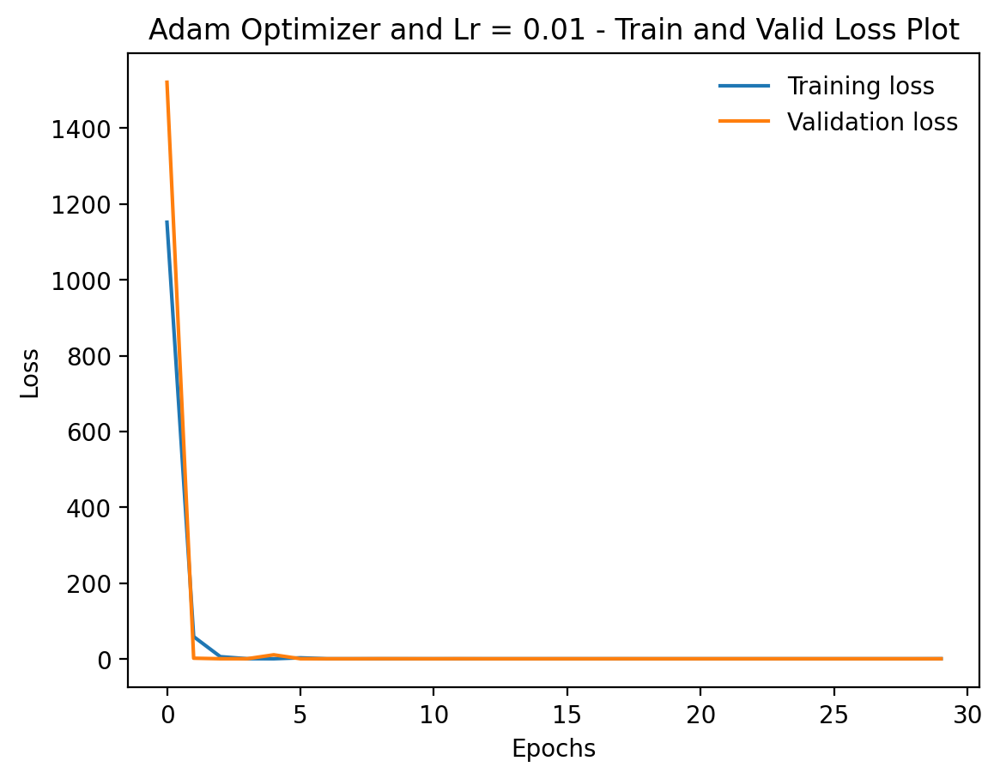

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.01 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.01 - Train and Valid Accuracy Plot')

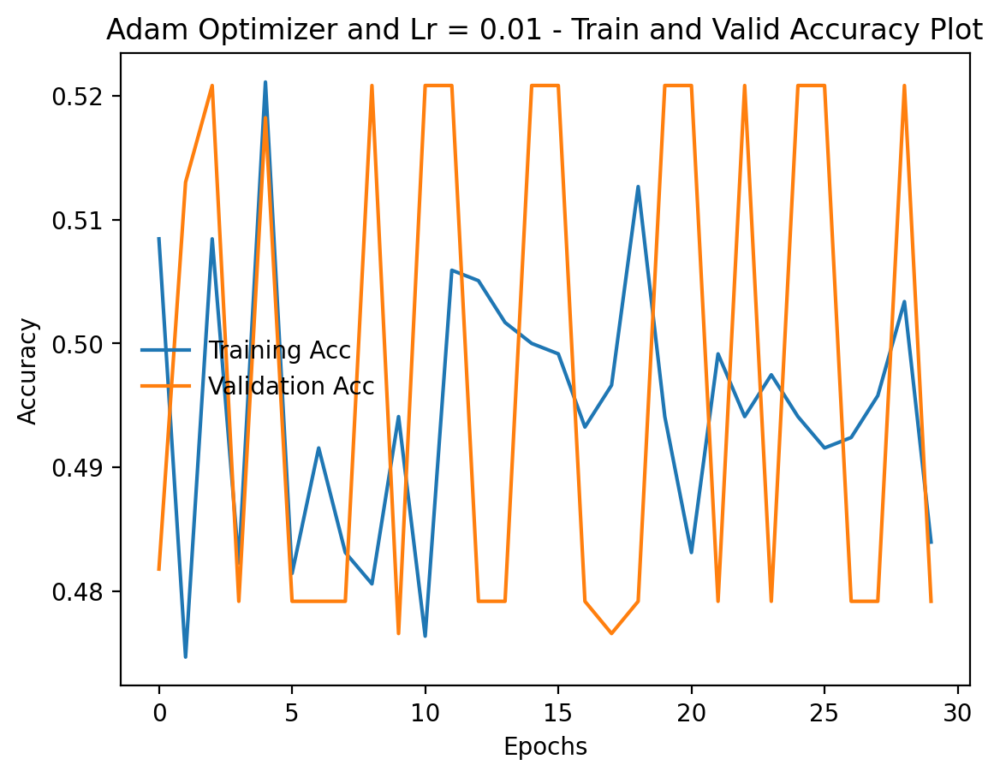

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_accs, label='Training Acc')
plt.plot(valid_accs, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.01 - Train and Valid Accuracy Plot")

TODO: You can load the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

  0%|          | 0/13 [00:00<?, ?it/s]

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

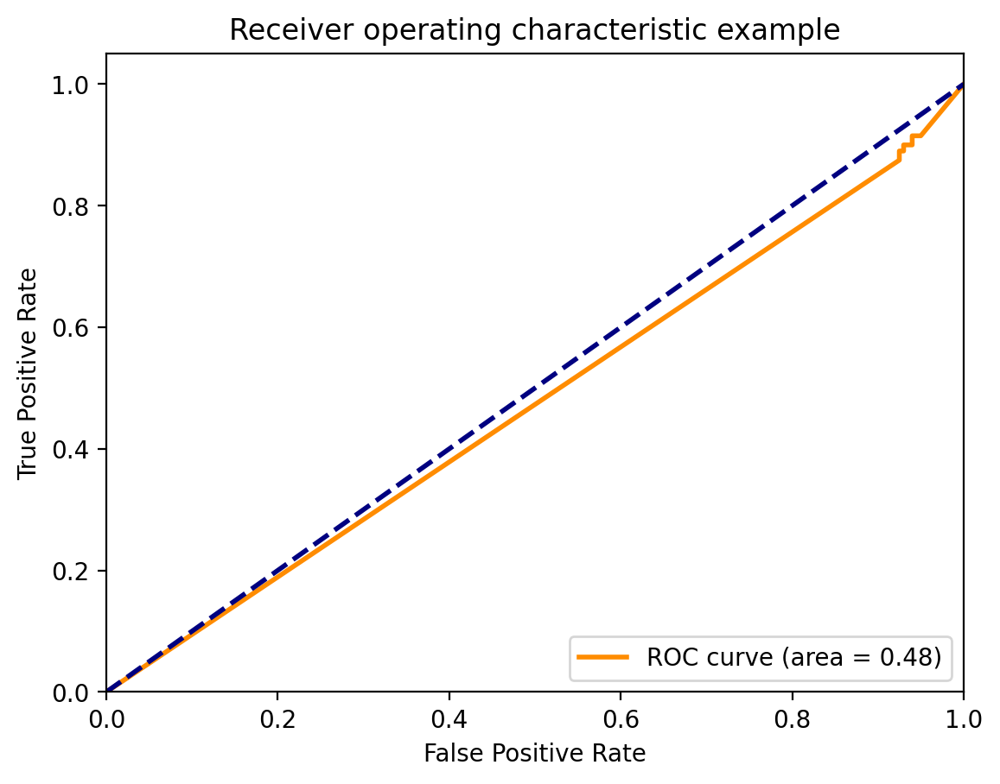

<ipython-input-259-090c2baad2d4>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


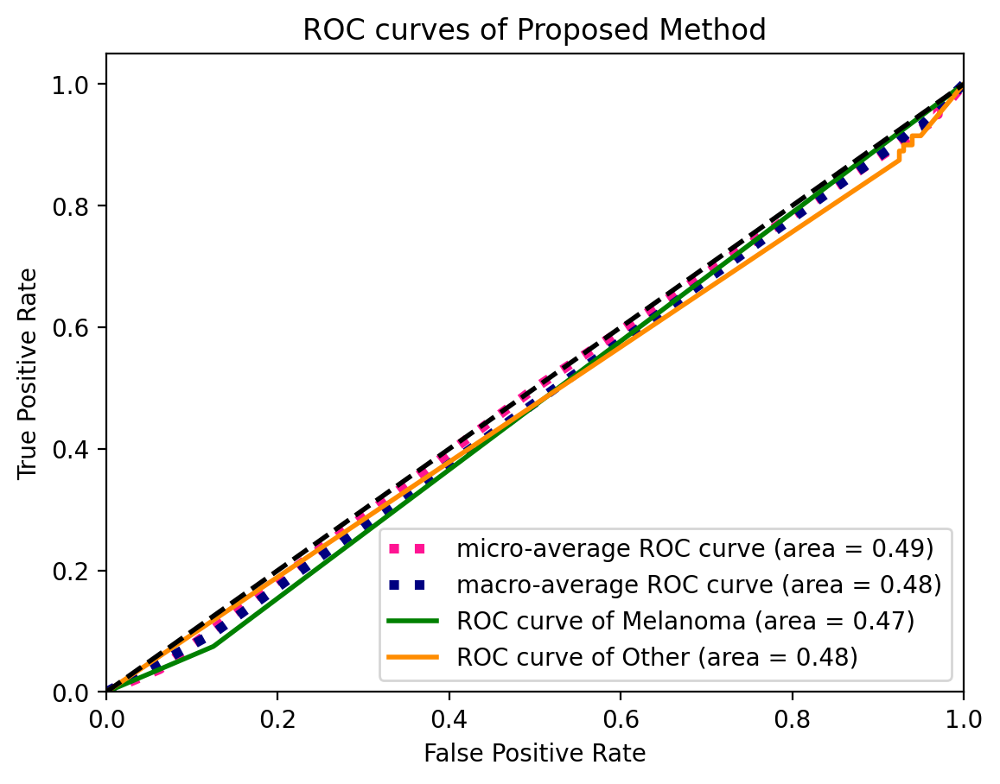

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Melanoma (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Other (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[200   0]
 [200   0]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


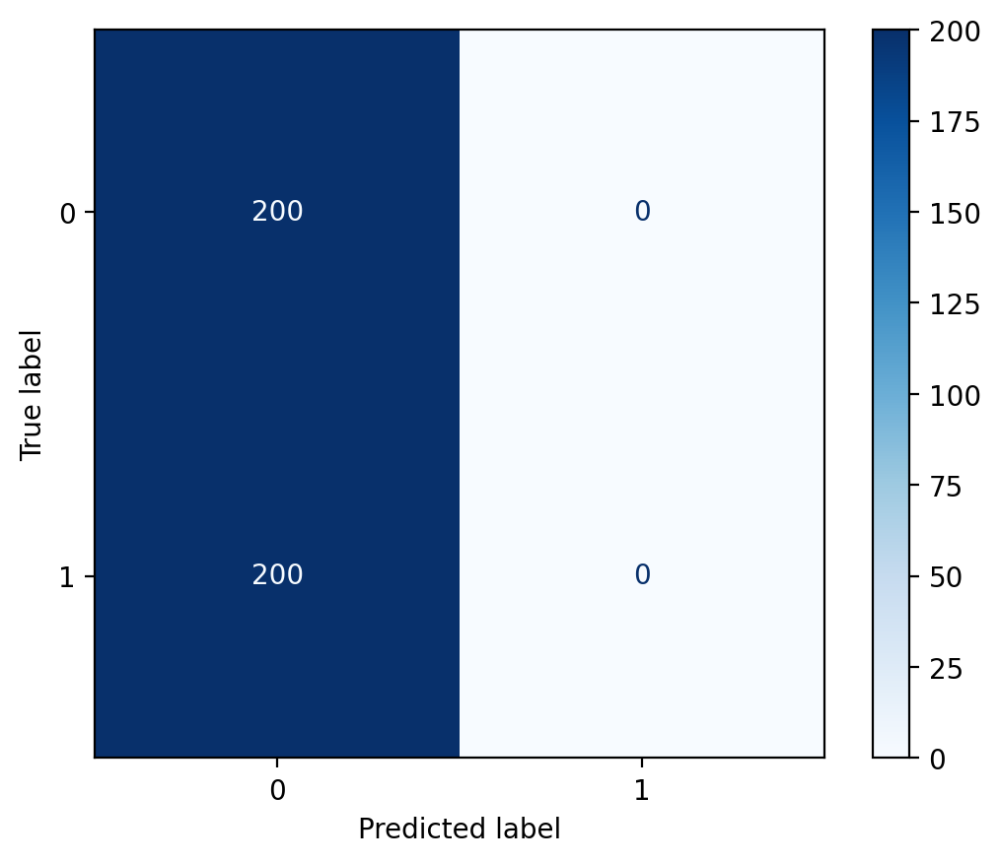

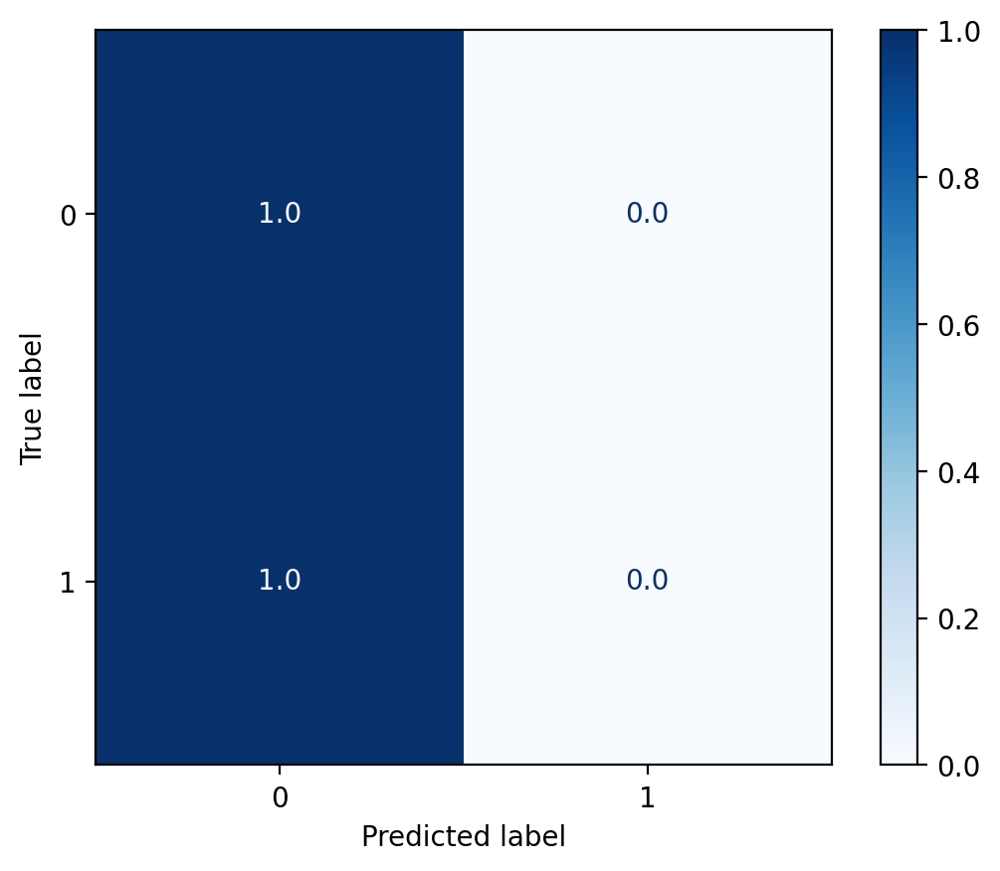

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.50, Recall: 1.00, F1_score: 0.67, Specificity: 0.00


###### Adam Optimizer and lr = 0.001

In [ ]:
vgg16_layers = get_vgg_layers(vgg16_config, batch_norm=True)
#print(vgg11_layers)

OUTPUT_DIM = 2

model = VGG(vgg16_layers, OUTPUT_DIM)
#print(model)
pretrained_model = models.vgg16_bn(pretrained=True)
#print(pretrained_model)
IN_FEATURES = pretrained_model.classifier[-1].in_features

final_fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 134,277,186 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-3

params = [
          {'params': model.features.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.classifier.parameters()}
         ]

optimizer = optim.Adam(params, lr=FOUND_LR)

In [ ]:
def calculate_accuracy(y_pred, y):
    top_pred = y_pred.argmax(1, keepdim=True)
    correct = top_pred.eq(y.view_as(top_pred)).sum()
    acc = correct.float() / y.shape[0]
    return acc

In [ ]:
def train(model, iterator, optimizer, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.train()

    for (x, y) in tqdm(iterator, desc="Training", leave=False):

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc = calculate_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc = calculate_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in tqdm(iterator):

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim=-1)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim=0)
    labels = torch.cat(labels, dim=0)
    probs = torch.cat(probs, dim=0)

    return images, labels, probs

In [ ]:
EPOCHS = 30

# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_accs = []
valid_accs = []

best_valid_acc = 0  # Track the best validation top-1 accuracy
best_train_acc = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')

for epoch in trange(EPOCHS, desc="Epochs"):

    start_time = time.monotonic()

    train_loss, train_acc = train(model, train_iter, optimizer, criterion, device)
    valid_loss, valid_acc = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_accs.append(train_acc)
    valid_accs.append(valid_acc)


    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc > best_valid_acc:
        best_valid_acc = valid_acc
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
    print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')

Epochs:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 16s
	Train Loss: 8.695 | Train Acc: 46.03%
	 Val. Loss: 1.033 |  Val. Acc: 47.14%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 18s
	Train Loss: 1.125 | Train Acc: 48.56%
	 Val. Loss: 1.302 |  Val. Acc: 41.67%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 18s
	Train Loss: 0.949 | Train Acc: 50.08%
	 Val. Loss: 0.994 |  Val. Acc: 57.29%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 16s
	Train Loss: 0.844 | Train Acc: 52.11%
	 Val. Loss: 0.748 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 14s
	Train Loss: 0.751 | Train Acc: 51.44%
	 Val. Loss: 0.676 |  Val. Acc: 55.47%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 21s
	Train Loss: 0.764 | Train Acc: 53.89%
	 Val. Loss: 0.684 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 14s
	Train Loss: 0.765 | Train Acc: 51.44%
	 Val. Loss: 0.684 |  Val. Acc: 54.43%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 14s
	Train Loss: 0.742 | Train Acc: 52.53%
	 Val. Loss: 0.674 |  Val. Acc: 59.38%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 14s
	Train Loss: 0.715 | Train Acc: 53.12%
	 Val. Loss: 0.667 |  Val. Acc: 57.29%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 14s
	Train Loss: 0.710 | Train Acc: 50.93%
	 Val. Loss: 0.676 |  Val. Acc: 58.07%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 14s
	Train Loss: 0.705 | Train Acc: 51.60%
	 Val. Loss: 0.674 |  Val. Acc: 56.51%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 14s
	Train Loss: 0.690 | Train Acc: 51.44%
	 Val. Loss: 0.681 |  Val. Acc: 56.77%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 14s
	Train Loss: 0.693 | Train Acc: 51.10%
	 Val. Loss: 0.682 |  Val. Acc: 54.95%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 14s
	Train Loss: 0.690 | Train Acc: 53.38%
	 Val. Loss: 0.674 |  Val. Acc: 56.25%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 14s
	Train Loss: 0.692 | Train Acc: 51.44%
	 Val. Loss: 0.677 |  Val. Acc: 56.51%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 16 | Epoch Time: 0m 16s
	Train Loss: 0.695 | Train Acc: 54.14%
	 Val. Loss: 0.674 |  Val. Acc: 57.55%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 17 | Epoch Time: 0m 14s
	Train Loss: 0.705 | Train Acc: 50.42%
	 Val. Loss: 0.690 |  Val. Acc: 54.69%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 18 | Epoch Time: 0m 15s
	Train Loss: 0.701 | Train Acc: 53.38%
	 Val. Loss: 0.683 |  Val. Acc: 55.21%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 19 | Epoch Time: 0m 14s
	Train Loss: 0.688 | Train Acc: 52.28%
	 Val. Loss: 0.685 |  Val. Acc: 55.73%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 20 | Epoch Time: 0m 14s
	Train Loss: 0.694 | Train Acc: 51.94%
	 Val. Loss: 0.684 |  Val. Acc: 55.47%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 21 | Epoch Time: 0m 14s
	Train Loss: 0.687 | Train Acc: 52.20%
	 Val. Loss: 0.675 |  Val. Acc: 55.47%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 22 | Epoch Time: 0m 14s
	Train Loss: 0.683 | Train Acc: 52.96%
	 Val. Loss: 0.676 |  Val. Acc: 56.25%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 23 | Epoch Time: 0m 14s
	Train Loss: 0.689 | Train Acc: 52.45%
	 Val. Loss: 0.683 |  Val. Acc: 54.95%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 24 | Epoch Time: 0m 14s
	Train Loss: 0.682 | Train Acc: 52.62%
	 Val. Loss: 0.683 |  Val. Acc: 56.25%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 25 | Epoch Time: 0m 14s
	Train Loss: 0.705 | Train Acc: 52.96%
	 Val. Loss: 0.687 |  Val. Acc: 54.69%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 26 | Epoch Time: 0m 14s
	Train Loss: 0.700 | Train Acc: 52.70%
	 Val. Loss: 0.681 |  Val. Acc: 49.48%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 27 | Epoch Time: 0m 14s
	Train Loss: 0.693 | Train Acc: 51.35%
	 Val. Loss: 0.677 |  Val. Acc: 55.99%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 28 | Epoch Time: 0m 14s
	Train Loss: 0.690 | Train Acc: 52.96%
	 Val. Loss: 0.686 |  Val. Acc: 55.21%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 29 | Epoch Time: 0m 14s
	Train Loss: 0.691 | Train Acc: 52.62%
	 Val. Loss: 0.685 |  Val. Acc: 56.25%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 30 | Epoch Time: 0m 14s
	Train Loss: 0.710 | Train Acc: 50.00%
	 Val. Loss: 0.674 |  Val. Acc: 55.47%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc * 100))

Lowest valid_loss: 66.65%
Best valid_Acc: 59.38%
Lowest train_loss: 68.16%
Best train_Acc: 54.14%


Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.001 - Train and Valid Loss Plot')

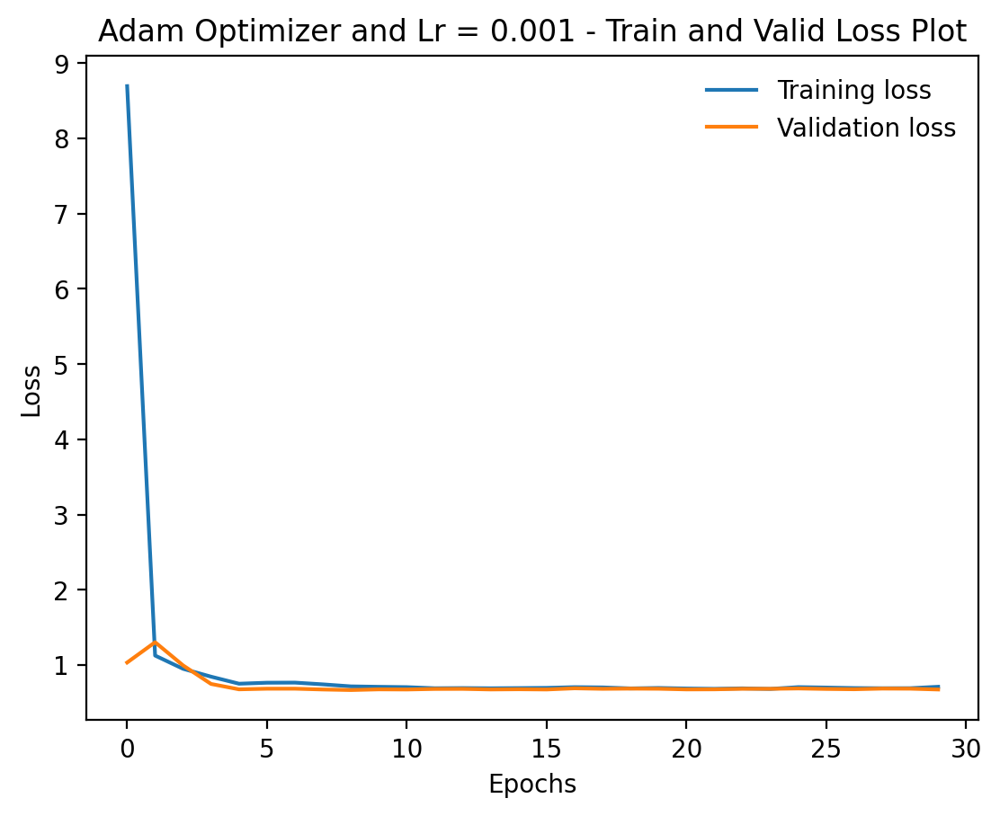

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.001 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.001 - Train and Valid Accuracy Plot')

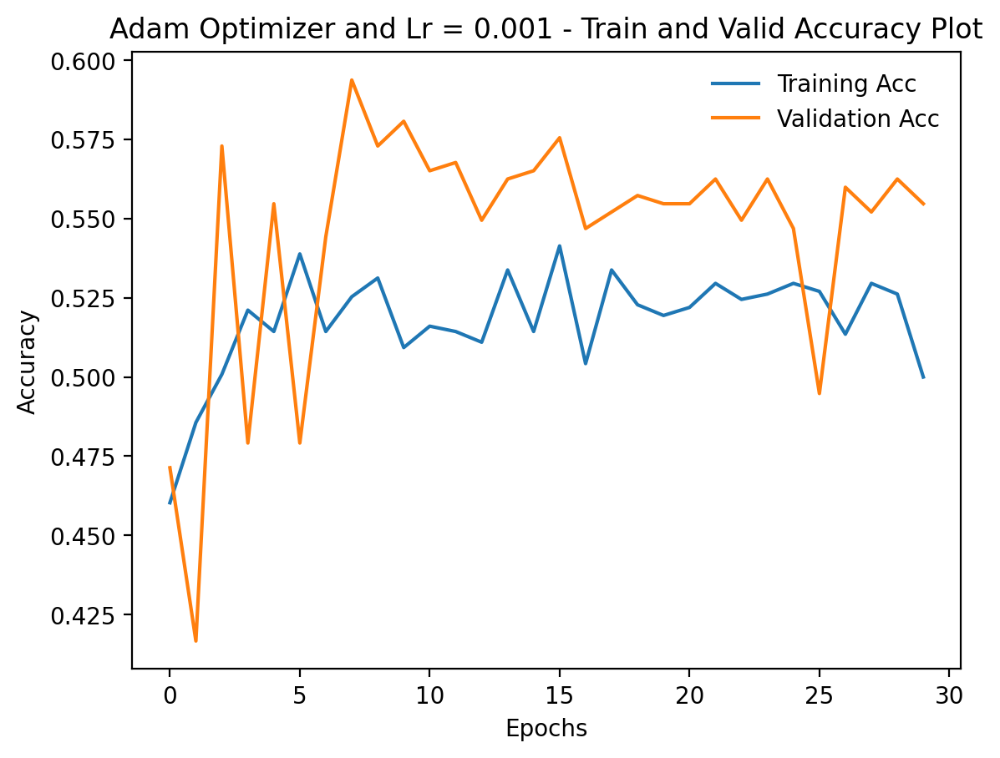

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_accs, label='Training Acc')
plt.plot(valid_accs, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.001 - Train and Valid Accuracy Plot")

TODO: You can load the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

  0%|          | 0/13 [00:00<?, ?it/s]

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

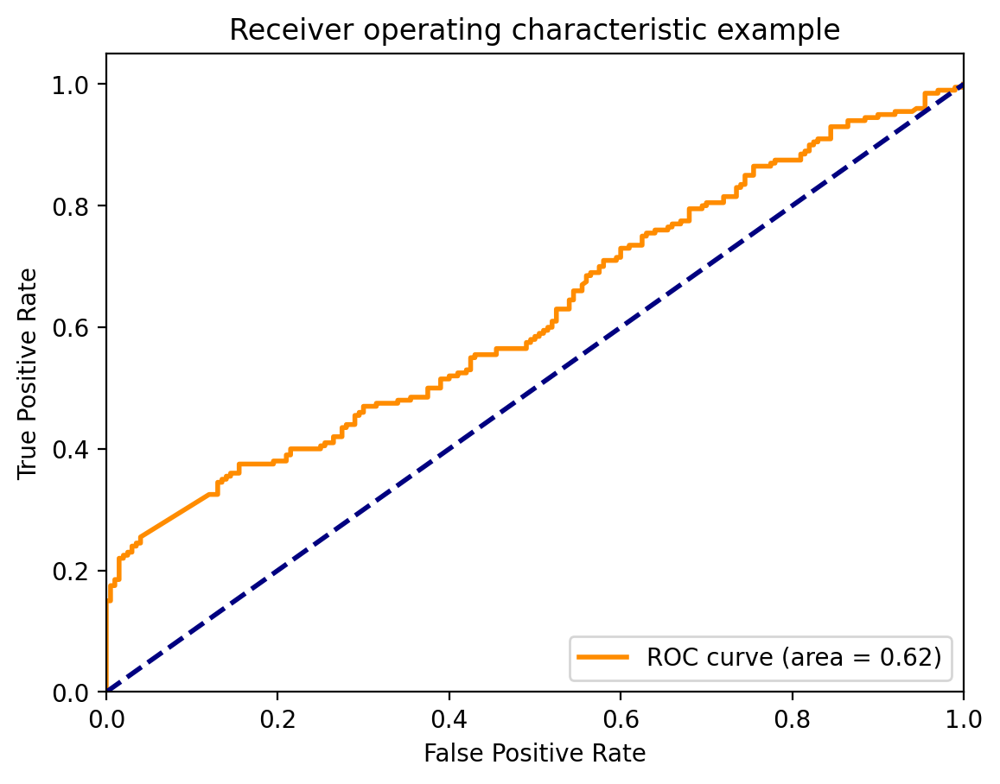

<ipython-input-276-090c2baad2d4>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


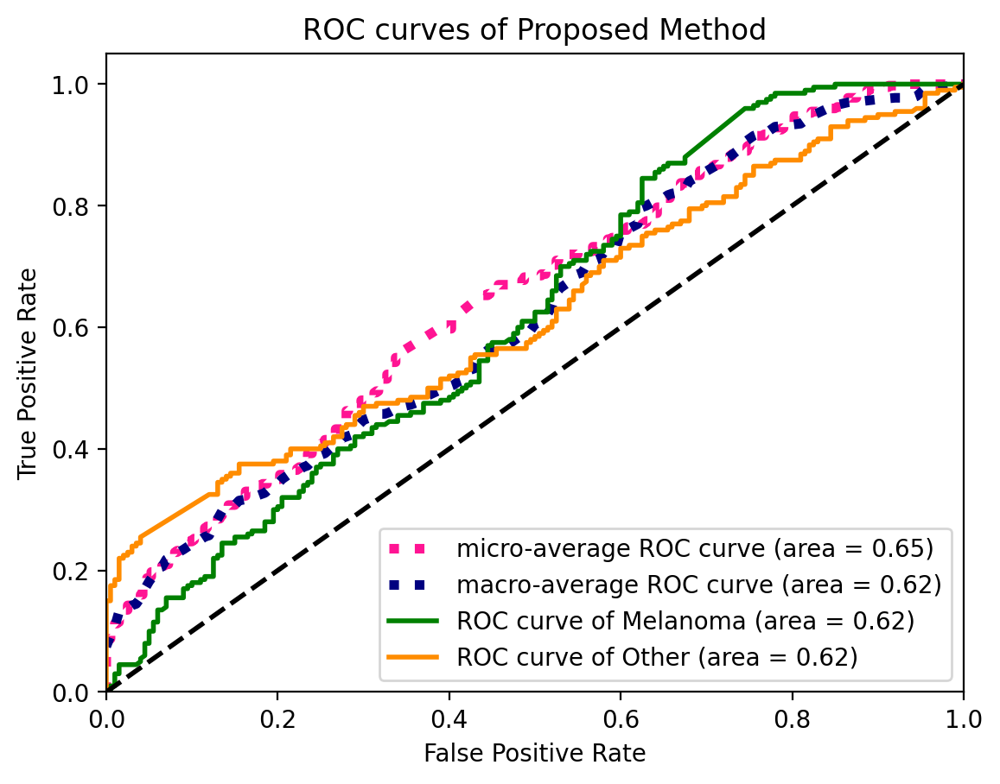

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Melanoma (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Other (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[174  26]
 [135  65]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


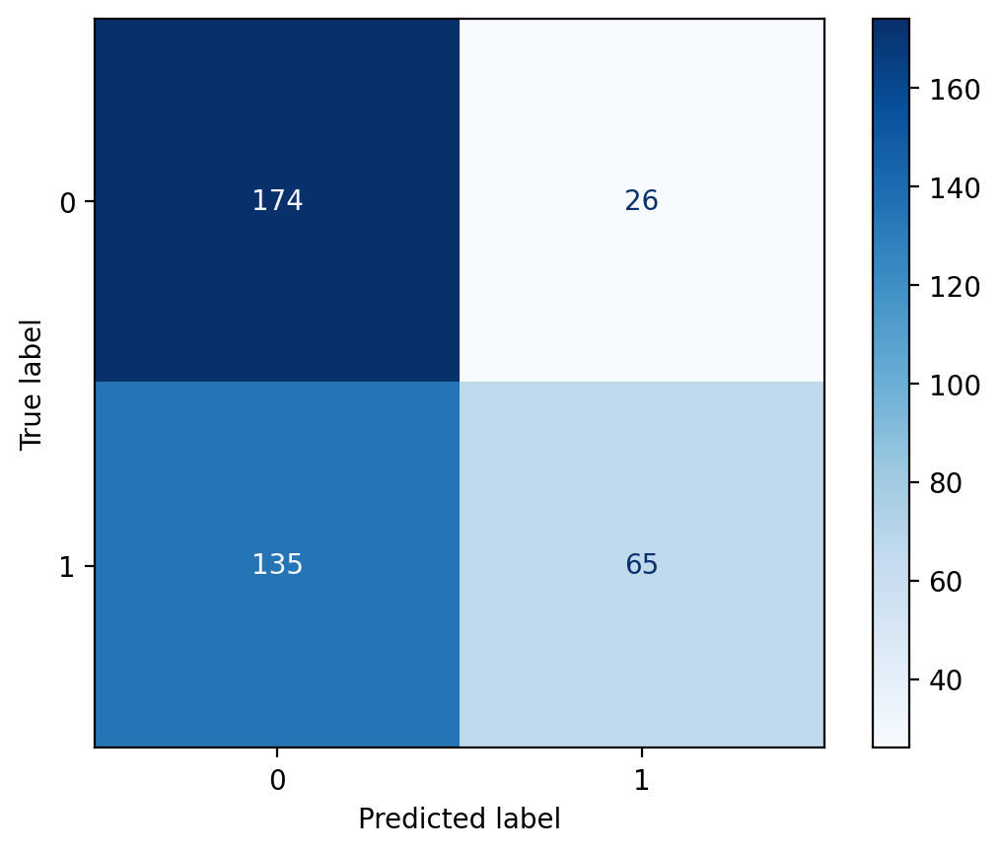

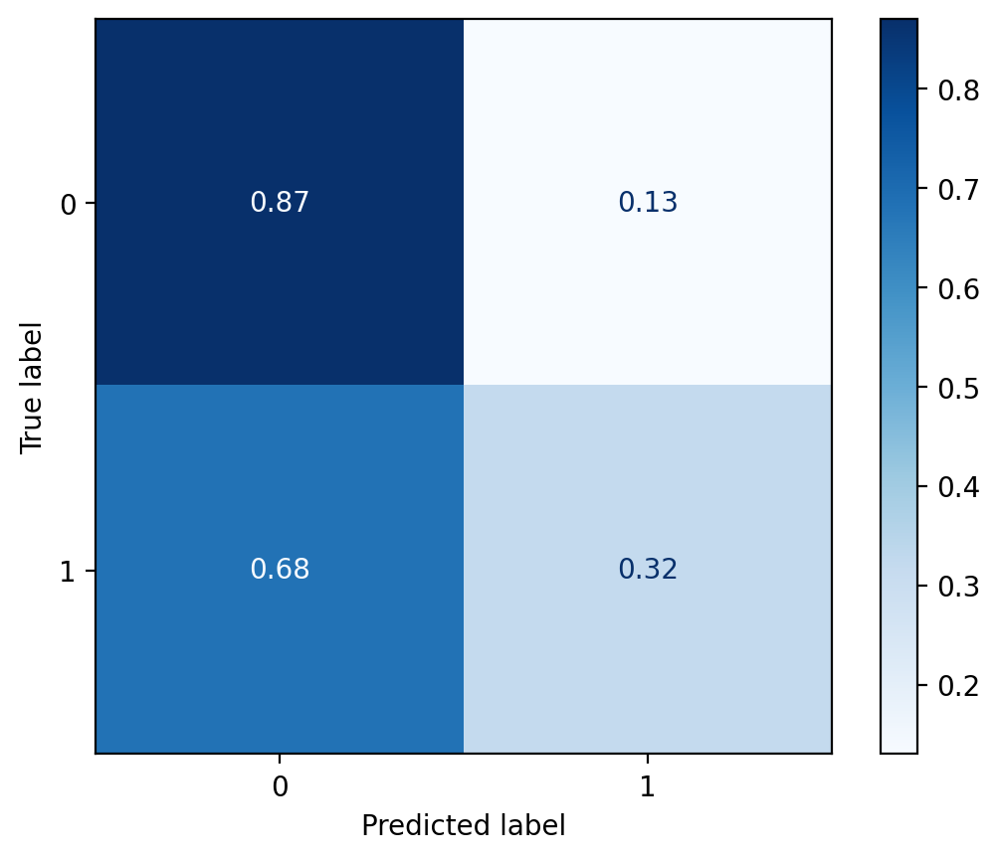

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.56, Recall: 0.87, F1_score: 0.68, Specificity: 0.33


###### Adam Optimizer and lr = 0.0001

In [ ]:
vgg16_layers = get_vgg_layers(vgg16_config, batch_norm=True)
#print(vgg11_layers)

OUTPUT_DIM = 2

model = VGG(vgg16_layers, OUTPUT_DIM)
#print(model)
pretrained_model = models.vgg16_bn(pretrained=True)
#print(pretrained_model)
IN_FEATURES = pretrained_model.classifier[-1].in_features

final_fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 134,277,186 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-4

params = [
          {'params': model.features.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.classifier.parameters()}
         ]

optimizer = optim.Adam(params, lr=FOUND_LR)

In [ ]:
def calculate_accuracy(y_pred, y):
    top_pred = y_pred.argmax(1, keepdim=True)
    correct = top_pred.eq(y.view_as(top_pred)).sum()
    acc = correct.float() / y.shape[0]
    return acc

In [ ]:
def train(model, iterator, optimizer, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.train()

    for (x, y) in tqdm(iterator, desc="Training", leave=False):

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc = calculate_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc = calculate_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in tqdm(iterator):

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim=-1)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim=0)
    labels = torch.cat(labels, dim=0)
    probs = torch.cat(probs, dim=0)

    return images, labels, probs

In [ ]:
EPOCHS = 30

# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_accs = []
valid_accs = []

best_valid_acc = 0  # Track the best validation top-1 accuracy
best_train_acc = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')

for epoch in trange(EPOCHS, desc="Epochs"):

    start_time = time.monotonic()

    train_loss, train_acc = train(model, train_iter, optimizer, criterion, device)
    valid_loss, valid_acc = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_accs.append(train_acc)
    valid_accs.append(valid_acc)


    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc > best_valid_acc:
        best_valid_acc = valid_acc
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
    print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')

Epochs:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 16s
	Train Loss: 1.100 | Train Acc: 51.52%
	 Val. Loss: 0.842 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 15s
	Train Loss: 0.901 | Train Acc: 50.59%
	 Val. Loss: 0.710 |  Val. Acc: 44.53%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 14s
	Train Loss: 0.814 | Train Acc: 51.44%
	 Val. Loss: 0.630 |  Val. Acc: 66.93%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 16s
	Train Loss: 0.759 | Train Acc: 54.48%
	 Val. Loss: 0.654 |  Val. Acc: 64.32%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 14s
	Train Loss: 0.733 | Train Acc: 52.45%
	 Val. Loss: 0.836 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 14s
	Train Loss: 0.717 | Train Acc: 51.94%
	 Val. Loss: 0.631 |  Val. Acc: 64.58%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 17s
	Train Loss: 0.696 | Train Acc: 55.07%
	 Val. Loss: 0.637 |  Val. Acc: 64.58%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 14s
	Train Loss: 0.716 | Train Acc: 54.98%
	 Val. Loss: 0.704 |  Val. Acc: 51.56%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 14s
	Train Loss: 0.699 | Train Acc: 55.07%
	 Val. Loss: 0.679 |  Val. Acc: 53.91%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 16s
	Train Loss: 0.683 | Train Acc: 58.02%
	 Val. Loss: 0.671 |  Val. Acc: 57.29%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 16s
	Train Loss: 0.674 | Train Acc: 60.81%
	 Val. Loss: 0.659 |  Val. Acc: 63.54%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 14s
	Train Loss: 0.672 | Train Acc: 58.61%
	 Val. Loss: 0.672 |  Val. Acc: 54.69%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 14s
	Train Loss: 0.677 | Train Acc: 57.26%
	 Val. Loss: 0.635 |  Val. Acc: 69.53%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 14s
	Train Loss: 0.678 | Train Acc: 56.93%
	 Val. Loss: 0.676 |  Val. Acc: 51.82%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 14s
	Train Loss: 0.658 | Train Acc: 60.47%
	 Val. Loss: 0.632 |  Val. Acc: 66.67%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 16 | Epoch Time: 0m 17s
	Train Loss: 0.656 | Train Acc: 61.49%
	 Val. Loss: 0.669 |  Val. Acc: 63.80%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 17 | Epoch Time: 0m 14s
	Train Loss: 0.668 | Train Acc: 60.39%
	 Val. Loss: 0.632 |  Val. Acc: 68.49%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 18 | Epoch Time: 0m 14s
	Train Loss: 0.663 | Train Acc: 58.70%
	 Val. Loss: 0.648 |  Val. Acc: 62.76%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 19 | Epoch Time: 0m 14s
	Train Loss: 0.648 | Train Acc: 60.98%
	 Val. Loss: 0.638 |  Val. Acc: 63.80%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 20 | Epoch Time: 0m 14s
	Train Loss: 0.660 | Train Acc: 61.40%
	 Val. Loss: 0.639 |  Val. Acc: 59.90%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 21 | Epoch Time: 0m 16s
	Train Loss: 0.648 | Train Acc: 61.74%
	 Val. Loss: 0.641 |  Val. Acc: 63.80%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 22 | Epoch Time: 0m 14s
	Train Loss: 0.641 | Train Acc: 61.74%
	 Val. Loss: 0.600 |  Val. Acc: 66.93%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 23 | Epoch Time: 0m 17s
	Train Loss: 0.645 | Train Acc: 62.33%
	 Val. Loss: 0.583 |  Val. Acc: 70.83%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 24 | Epoch Time: 0m 17s
	Train Loss: 0.625 | Train Acc: 65.20%
	 Val. Loss: 0.666 |  Val. Acc: 62.76%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 25 | Epoch Time: 0m 14s
	Train Loss: 0.644 | Train Acc: 63.51%
	 Val. Loss: 0.634 |  Val. Acc: 64.32%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 26 | Epoch Time: 0m 21s
	Train Loss: 0.625 | Train Acc: 65.37%
	 Val. Loss: 0.643 |  Val. Acc: 64.58%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 27 | Epoch Time: 0m 14s
	Train Loss: 0.634 | Train Acc: 62.50%
	 Val. Loss: 0.638 |  Val. Acc: 60.42%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 28 | Epoch Time: 0m 14s
	Train Loss: 0.621 | Train Acc: 64.36%
	 Val. Loss: 0.668 |  Val. Acc: 66.15%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 29 | Epoch Time: 0m 17s
	Train Loss: 0.618 | Train Acc: 67.57%
	 Val. Loss: 0.606 |  Val. Acc: 65.62%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 30 | Epoch Time: 0m 17s
	Train Loss: 0.599 | Train Acc: 68.75%
	 Val. Loss: 0.584 |  Val. Acc: 70.31%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc * 100))

Lowest valid_loss: 58.26%
Best valid_Acc: 70.83%
Lowest train_loss: 59.91%
Best train_Acc: 68.75%


Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.0001 - Train and Valid Loss Plot')

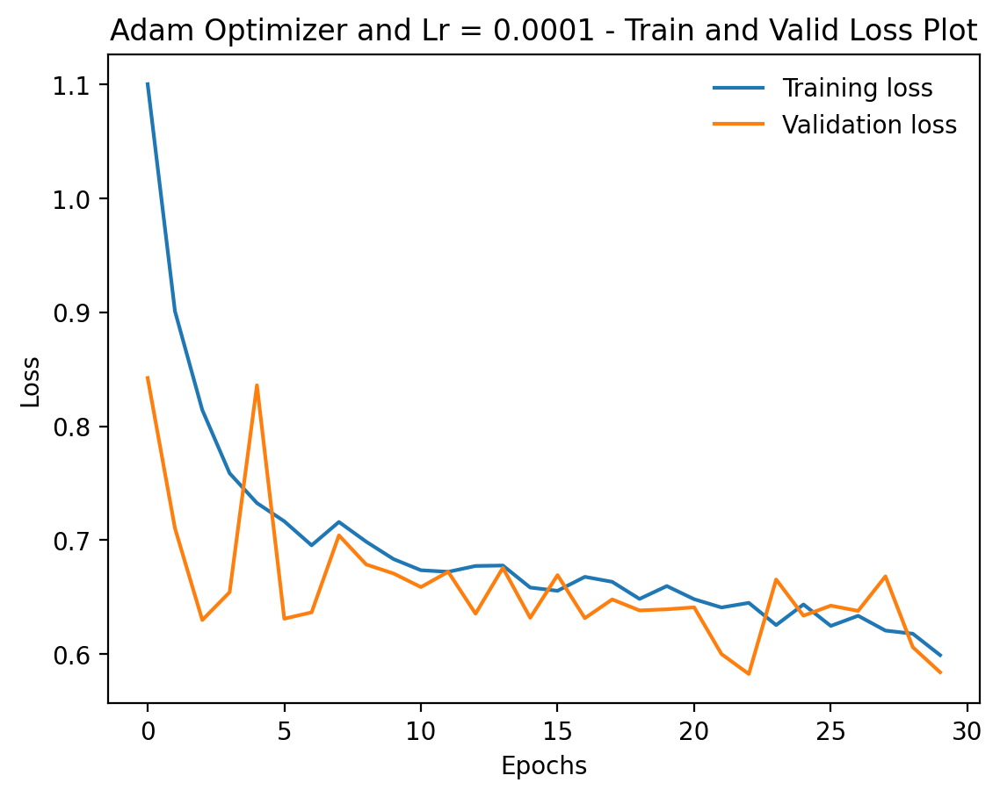

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.0001 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.0001 - Train and Valid Accuracy Plot')

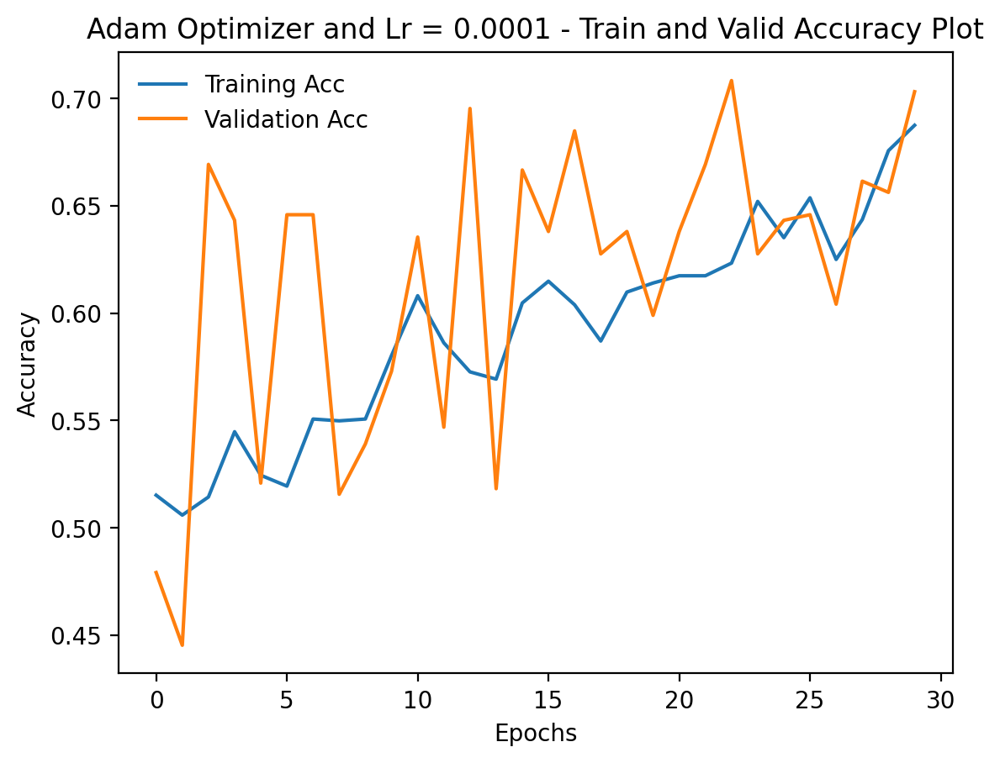

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_accs, label='Training Acc')
plt.plot(valid_accs, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.0001 - Train and Valid Accuracy Plot")

TODO: You can load the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

  0%|          | 0/13 [00:00<?, ?it/s]

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

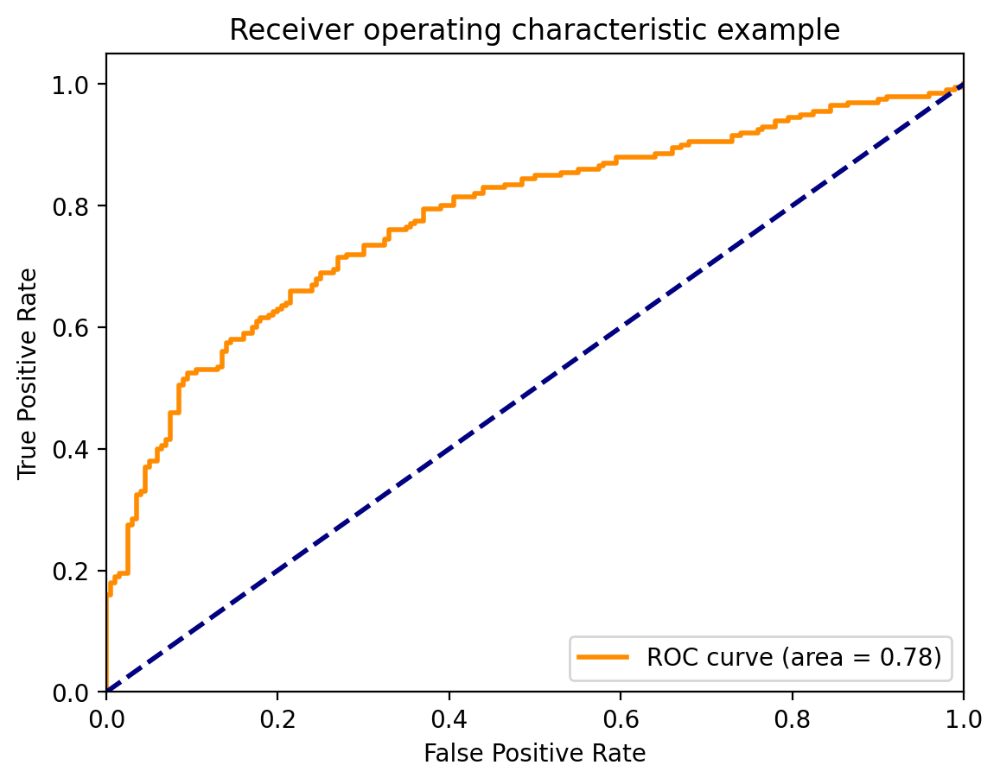

<ipython-input-293-090c2baad2d4>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


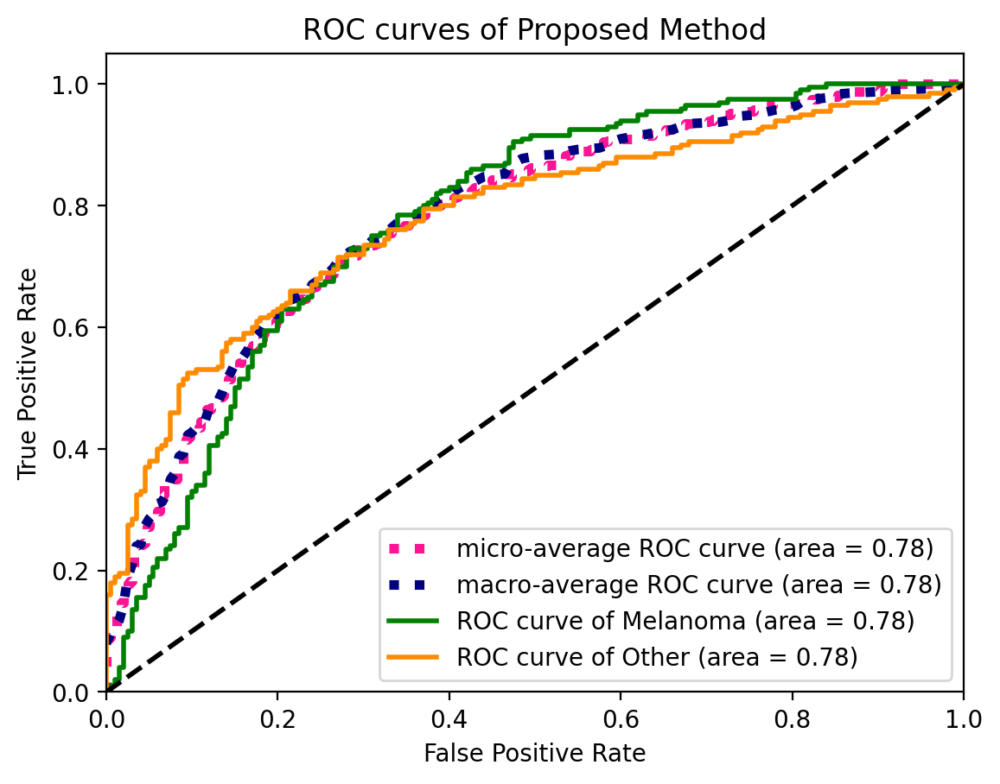

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Melanoma (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Other (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[140  60]
 [ 54 146]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


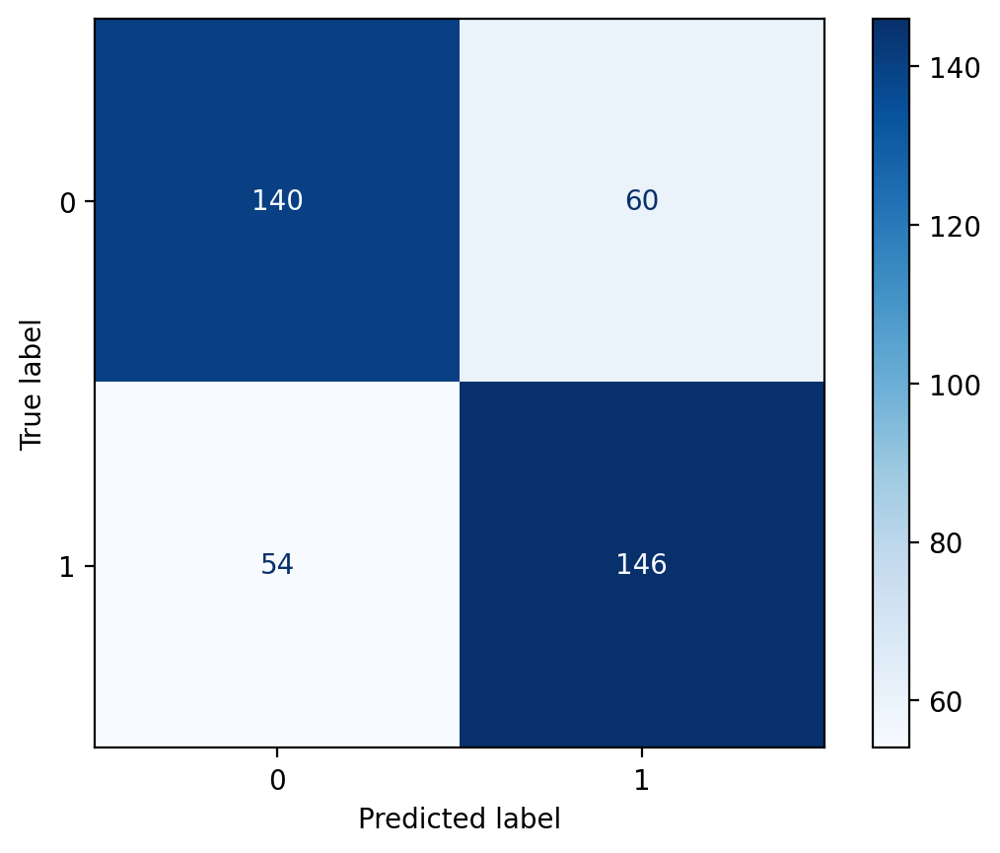

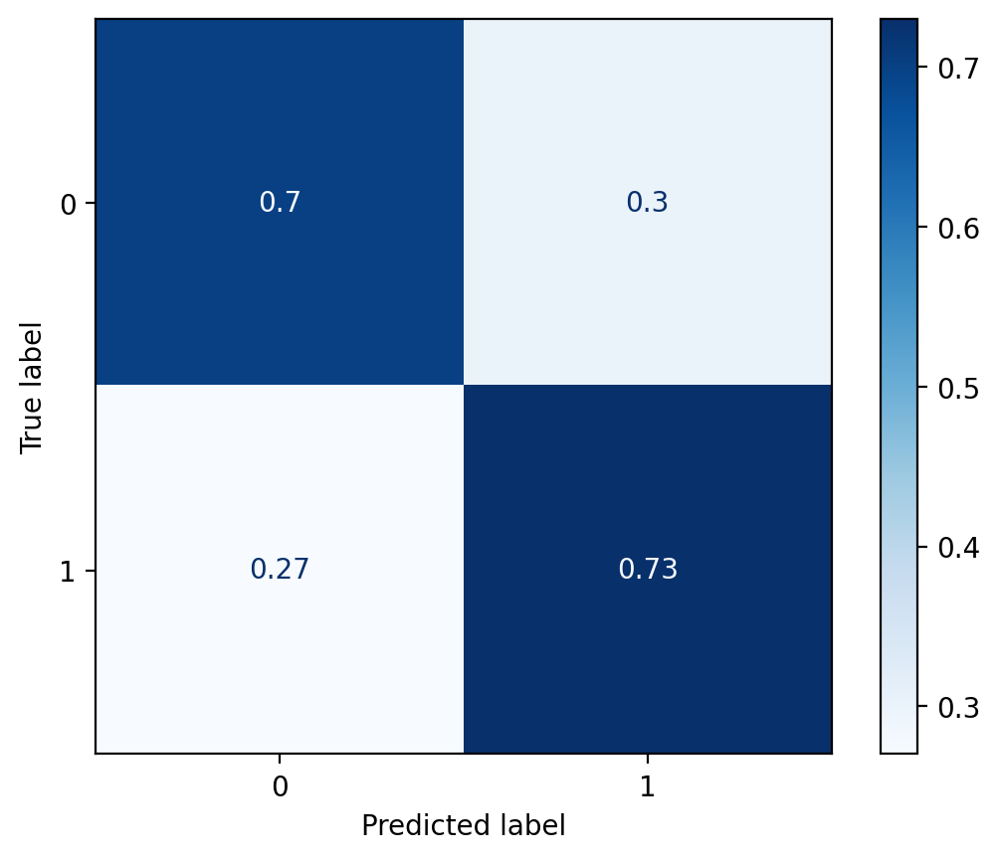

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.72, Recall: 0.70, F1_score: 0.71, Specificity: 0.73


###### Adam Optimizer and lr = 0.0005

In [ ]:
vgg16_layers = get_vgg_layers(vgg16_config, batch_norm=True)
#print(vgg11_layers)

OUTPUT_DIM = 2

model = VGG(vgg16_layers, OUTPUT_DIM)
#print(model)
pretrained_model = models.vgg16_bn(pretrained=True)
#print(pretrained_model)
IN_FEATURES = pretrained_model.classifier[-1].in_features

final_fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 134,277,186 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 5e-4

params = [
          {'params': model.features.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.classifier.parameters()}
         ]

optimizer = optim.Adam(params, lr=FOUND_LR)

In [ ]:
def calculate_accuracy(y_pred, y):
    top_pred = y_pred.argmax(1, keepdim=True)
    correct = top_pred.eq(y.view_as(top_pred)).sum()
    acc = correct.float() / y.shape[0]
    return acc

In [ ]:
def train(model, iterator, optimizer, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.train()

    for (x, y) in tqdm(iterator, desc="Training", leave=False):

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc = calculate_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc = calculate_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in tqdm(iterator):

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim=-1)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim=0)
    labels = torch.cat(labels, dim=0)
    probs = torch.cat(probs, dim=0)

    return images, labels, probs

In [ ]:
EPOCHS = 30

# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_accs = []
valid_accs = []

best_valid_acc = 0  # Track the best validation top-1 accuracy
best_train_acc = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')

for epoch in trange(EPOCHS, desc="Epochs"):

    start_time = time.monotonic()

    train_loss, train_acc = train(model, train_iter, optimizer, criterion, device)
    valid_loss, valid_acc = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_accs.append(train_acc)
    valid_accs.append(valid_acc)


    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc > best_valid_acc:
        best_valid_acc = valid_acc
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
    print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')

Epochs:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 17s
	Train Loss: 5.063 | Train Acc: 49.83%
	 Val. Loss: 0.703 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 14s
	Train Loss: 0.799 | Train Acc: 48.82%
	 Val. Loss: 0.796 |  Val. Acc: 51.82%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 16s
	Train Loss: 0.776 | Train Acc: 51.01%
	 Val. Loss: 1.190 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 14s
	Train Loss: 0.754 | Train Acc: 50.68%
	 Val. Loss: 0.777 |  Val. Acc: 52.86%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 16s
	Train Loss: 0.717 | Train Acc: 52.11%
	 Val. Loss: 0.668 |  Val. Acc: 62.76%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 14s
	Train Loss: 0.711 | Train Acc: 50.17%
	 Val. Loss: 0.724 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 17s
	Train Loss: 0.704 | Train Acc: 53.38%
	 Val. Loss: 0.670 |  Val. Acc: 61.72%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 14s
	Train Loss: 0.708 | Train Acc: 52.53%
	 Val. Loss: 0.671 |  Val. Acc: 61.72%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 14s
	Train Loss: 0.700 | Train Acc: 52.20%
	 Val. Loss: 0.678 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 14s
	Train Loss: 0.703 | Train Acc: 49.92%
	 Val. Loss: 0.672 |  Val. Acc: 61.20%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 14s
	Train Loss: 0.698 | Train Acc: 49.66%
	 Val. Loss: 0.696 |  Val. Acc: 41.41%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 14s
	Train Loss: 0.704 | Train Acc: 50.34%
	 Val. Loss: 0.680 |  Val. Acc: 59.90%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 14s
	Train Loss: 0.692 | Train Acc: 52.45%
	 Val. Loss: 0.677 |  Val. Acc: 61.72%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 19s
	Train Loss: 0.697 | Train Acc: 54.31%
	 Val. Loss: 0.670 |  Val. Acc: 62.24%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 14s
	Train Loss: 0.695 | Train Acc: 51.01%
	 Val. Loss: 0.672 |  Val. Acc: 56.25%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 16 | Epoch Time: 0m 14s
	Train Loss: 0.695 | Train Acc: 53.04%
	 Val. Loss: 0.678 |  Val. Acc: 63.28%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 17 | Epoch Time: 0m 14s
	Train Loss: 0.693 | Train Acc: 51.44%
	 Val. Loss: 0.676 |  Val. Acc: 63.28%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 18 | Epoch Time: 0m 14s
	Train Loss: 0.691 | Train Acc: 52.70%
	 Val. Loss: 0.672 |  Val. Acc: 57.81%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 19 | Epoch Time: 0m 14s
	Train Loss: 0.696 | Train Acc: 50.68%
	 Val. Loss: 0.679 |  Val. Acc: 61.20%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 20 | Epoch Time: 0m 14s
	Train Loss: 0.696 | Train Acc: 49.58%
	 Val. Loss: 0.686 |  Val. Acc: 64.84%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 21 | Epoch Time: 0m 14s
	Train Loss: 0.696 | Train Acc: 50.17%
	 Val. Loss: 0.689 |  Val. Acc: 60.42%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 22 | Epoch Time: 0m 14s
	Train Loss: 0.692 | Train Acc: 50.93%
	 Val. Loss: 0.672 |  Val. Acc: 63.54%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 23 | Epoch Time: 0m 14s
	Train Loss: 0.692 | Train Acc: 53.29%
	 Val. Loss: 0.675 |  Val. Acc: 64.32%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 24 | Epoch Time: 0m 14s
	Train Loss: 0.690 | Train Acc: 52.53%
	 Val. Loss: 0.671 |  Val. Acc: 64.06%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 25 | Epoch Time: 0m 14s
	Train Loss: 0.695 | Train Acc: 50.93%
	 Val. Loss: 0.692 |  Val. Acc: 53.91%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 26 | Epoch Time: 0m 14s
	Train Loss: 0.693 | Train Acc: 50.76%
	 Val. Loss: 0.691 |  Val. Acc: 58.59%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 27 | Epoch Time: 0m 14s
	Train Loss: 0.693 | Train Acc: 51.27%
	 Val. Loss: 0.686 |  Val. Acc: 63.54%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 28 | Epoch Time: 0m 14s
	Train Loss: 0.693 | Train Acc: 50.84%
	 Val. Loss: 0.682 |  Val. Acc: 65.36%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 29 | Epoch Time: 0m 14s
	Train Loss: 0.695 | Train Acc: 50.59%
	 Val. Loss: 0.675 |  Val. Acc: 64.32%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 30 | Epoch Time: 0m 14s
	Train Loss: 0.691 | Train Acc: 52.70%
	 Val. Loss: 0.669 |  Val. Acc: 64.06%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc * 100))

Lowest valid_loss: 66.76%
Best valid_Acc: 65.36%
Lowest train_loss: 69.05%
Best train_Acc: 54.31%


Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.0005 - Train and Valid Loss Plot')

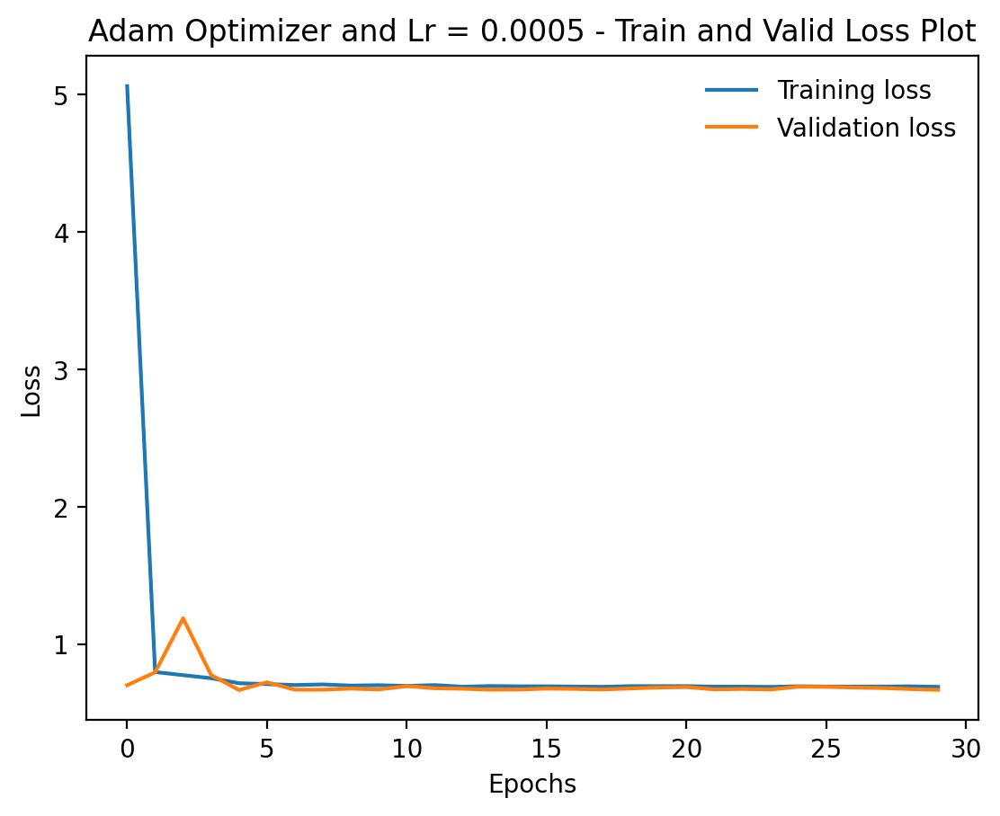

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.0005 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'Adam Optimizer and Lr = 0.0005 - Train and Valid Accuracy Plot')

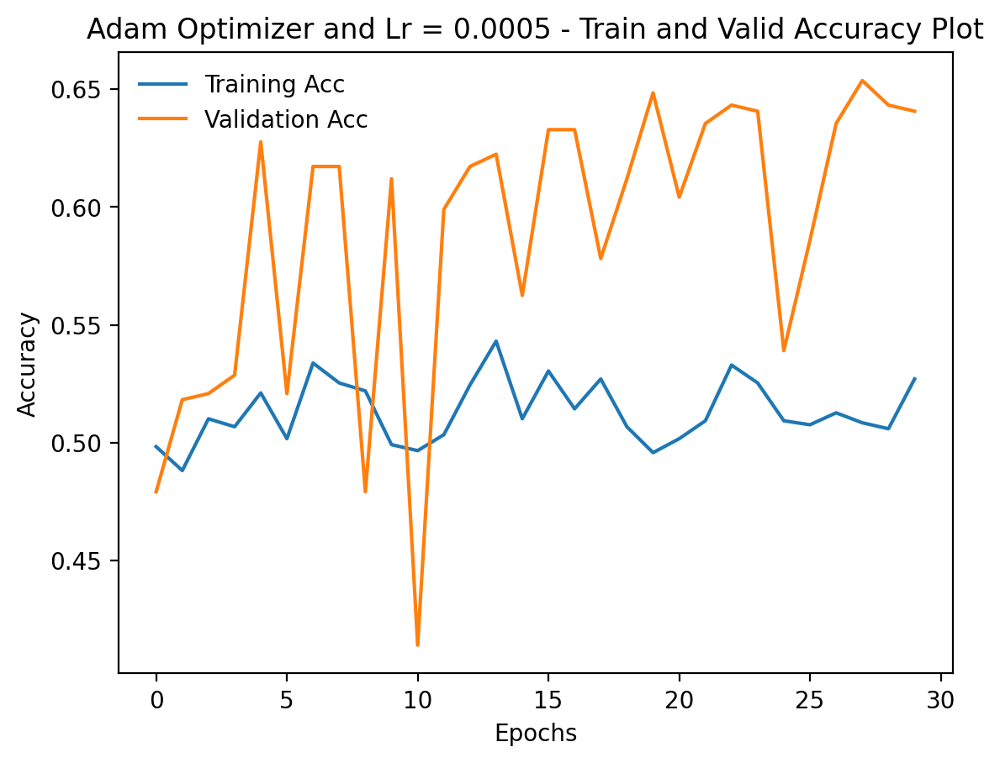

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_accs, label='Training Acc')
plt.plot(valid_accs, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("Adam Optimizer and Lr = 0.0005 - Train and Valid Accuracy Plot")

TODO: You can load the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

  0%|          | 0/13 [00:00<?, ?it/s]

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

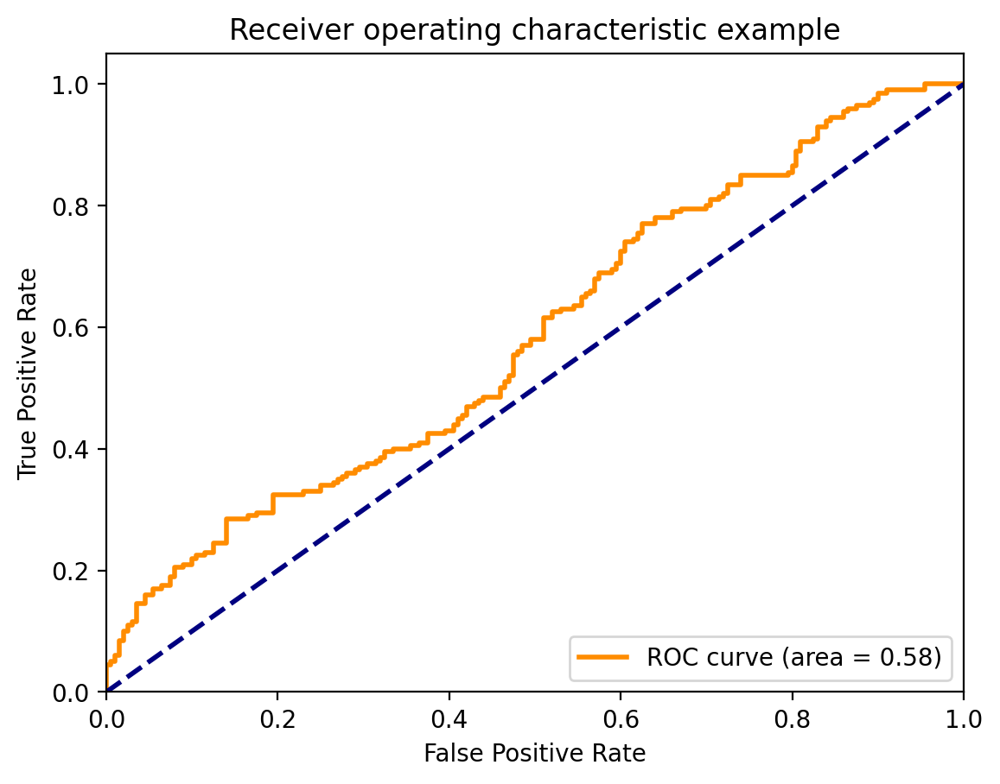

<ipython-input-310-090c2baad2d4>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


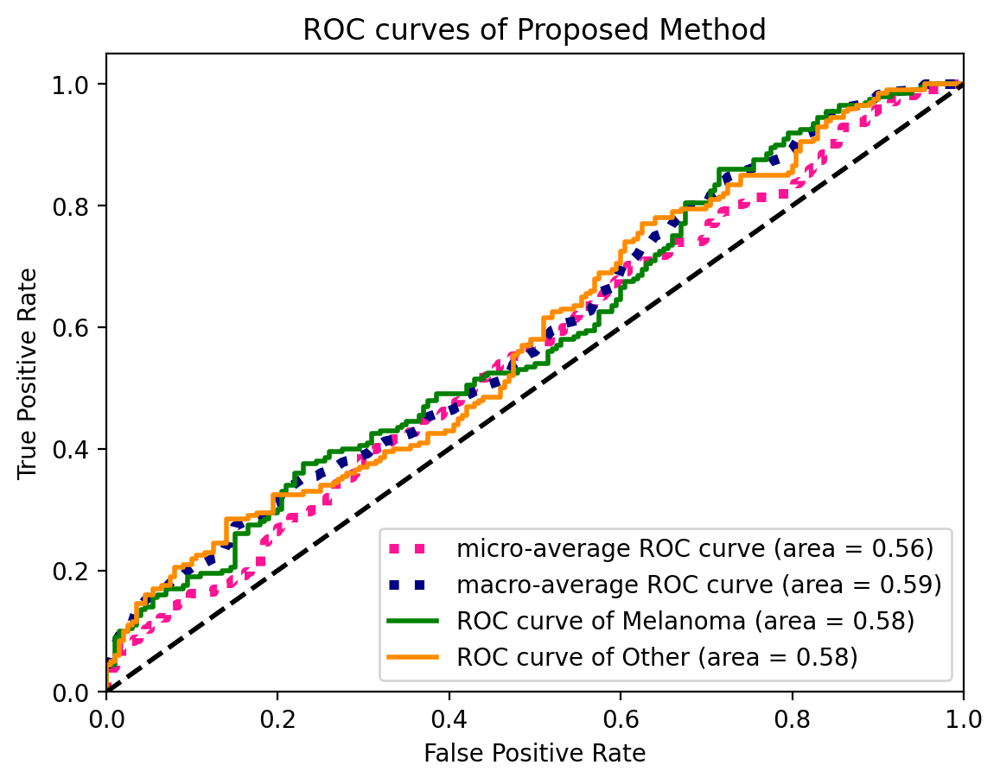

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Melanoma (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Other (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[102  98]
 [ 86 114]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


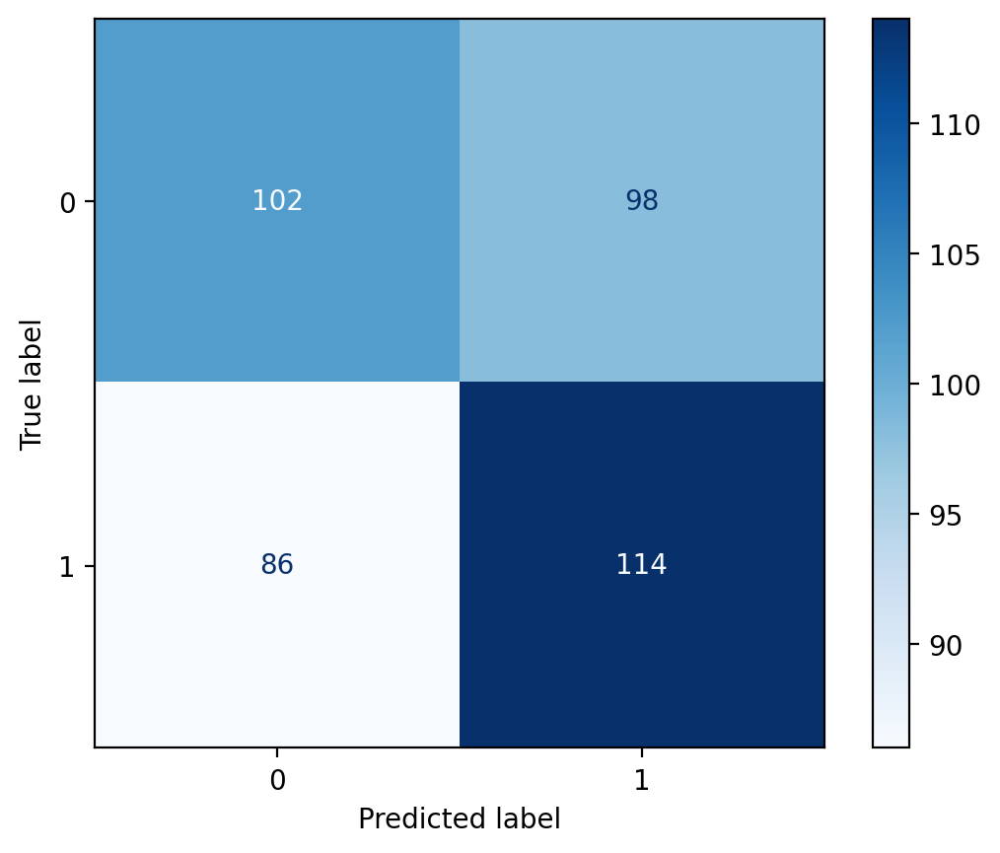

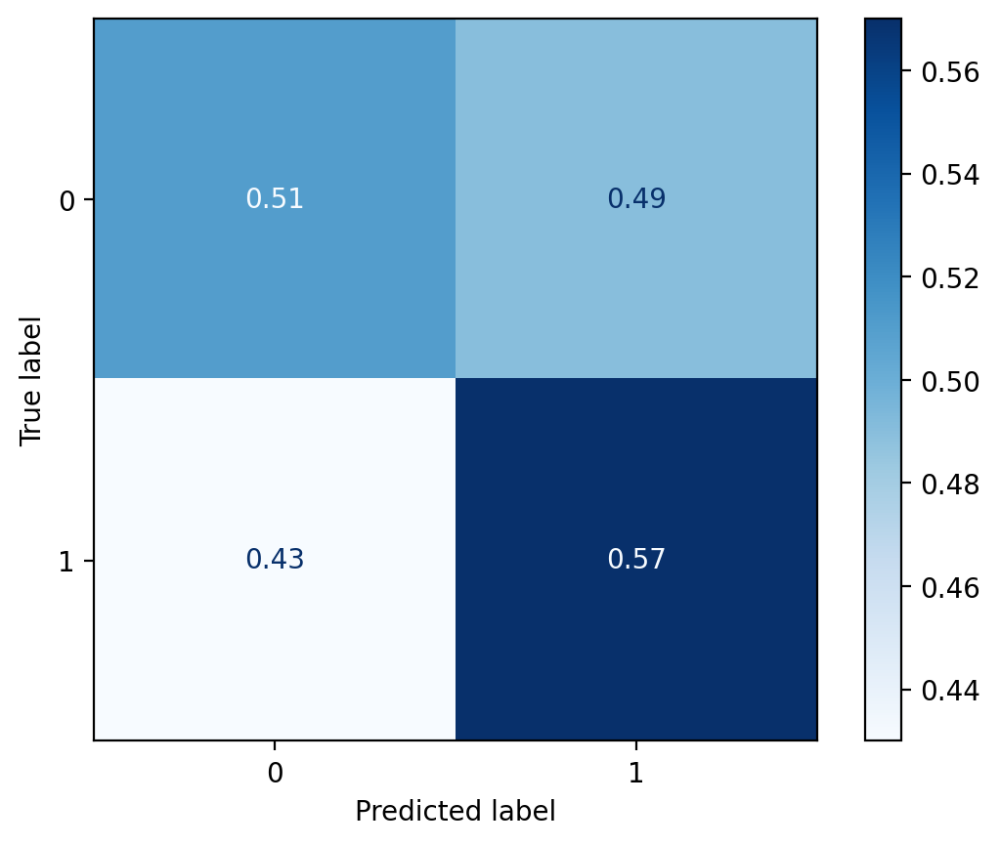

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.54, Recall: 0.51, F1_score: 0.53, Specificity: 0.57


##### SGD Optimizer

###### SGD Optimizer and lr = 0.01

Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-2

params = [
          {'params': model.features.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.classifier.parameters()}
         ]

optimizer = optim.SGD(params, lr=FOUND_LR)

In [ ]:
def calculate_accuracy(y_pred, y):
    top_pred = y_pred.argmax(1, keepdim=True)
    correct = top_pred.eq(y.view_as(top_pred)).sum()
    acc = correct.float() / y.shape[0]
    return acc

In [ ]:
def train(model, iterator, optimizer, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.train()

    for (x, y) in tqdm(iterator, desc="Training", leave=False):

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc = calculate_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc = calculate_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in tqdm(iterator):

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim=-1)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim=0)
    labels = torch.cat(labels, dim=0)
    probs = torch.cat(probs, dim=0)

    return images, labels, probs

In [ ]:
EPOCHS = 30

# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_accs = []
valid_accs = []

best_valid_acc = 0  # Track the best validation top-1 accuracy
best_train_acc = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')

for epoch in trange(EPOCHS, desc="Epochs"):

    start_time = time.monotonic()

    train_loss, train_acc = train(model, train_iter, optimizer, criterion, device)
    valid_loss, valid_acc = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_accs.append(train_acc)
    valid_accs.append(valid_acc)


    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc > best_valid_acc:
        best_valid_acc = valid_acc
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
    print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')

Epochs:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 15s
	Train Loss: 0.693 | Train Acc: 51.52%
	 Val. Loss: 0.672 |  Val. Acc: 61.98%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 15s
	Train Loss: 0.694 | Train Acc: 52.70%
	 Val. Loss: 0.677 |  Val. Acc: 61.98%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 13s
	Train Loss: 0.695 | Train Acc: 50.34%
	 Val. Loss: 0.676 |  Val. Acc: 62.76%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 15s
	Train Loss: 0.690 | Train Acc: 52.96%
	 Val. Loss: 0.669 |  Val. Acc: 62.76%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 13s
	Train Loss: 0.693 | Train Acc: 52.20%
	 Val. Loss: 0.680 |  Val. Acc: 48.44%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 13s
	Train Loss: 0.695 | Train Acc: 51.18%
	 Val. Loss: 0.685 |  Val. Acc: 61.72%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 15s
	Train Loss: 0.691 | Train Acc: 54.14%
	 Val. Loss: 0.675 |  Val. Acc: 62.50%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 13s
	Train Loss: 0.694 | Train Acc: 52.45%
	 Val. Loss: 0.683 |  Val. Acc: 62.50%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 13s
	Train Loss: 0.694 | Train Acc: 53.29%
	 Val. Loss: 0.679 |  Val. Acc: 59.11%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 13s
	Train Loss: 0.689 | Train Acc: 53.97%
	 Val. Loss: 0.677 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 13s
	Train Loss: 0.691 | Train Acc: 53.89%
	 Val. Loss: 0.673 |  Val. Acc: 61.72%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 13s
	Train Loss: 0.693 | Train Acc: 53.29%
	 Val. Loss: 0.672 |  Val. Acc: 62.24%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 13s
	Train Loss: 0.695 | Train Acc: 51.52%
	 Val. Loss: 0.677 |  Val. Acc: 63.02%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 13s
	Train Loss: 0.690 | Train Acc: 53.80%
	 Val. Loss: 0.674 |  Val. Acc: 61.20%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 13s
	Train Loss: 0.689 | Train Acc: 53.46%
	 Val. Loss: 0.672 |  Val. Acc: 61.72%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 16 | Epoch Time: 0m 13s
	Train Loss: 0.696 | Train Acc: 51.35%
	 Val. Loss: 0.682 |  Val. Acc: 61.46%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 17 | Epoch Time: 0m 13s
	Train Loss: 0.696 | Train Acc: 50.84%
	 Val. Loss: 0.685 |  Val. Acc: 63.28%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 18 | Epoch Time: 0m 13s
	Train Loss: 0.696 | Train Acc: 51.01%
	 Val. Loss: 0.681 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 19 | Epoch Time: 0m 13s
	Train Loss: 0.691 | Train Acc: 52.36%
	 Val. Loss: 0.680 |  Val. Acc: 61.98%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 20 | Epoch Time: 0m 13s
	Train Loss: 0.692 | Train Acc: 51.60%
	 Val. Loss: 0.681 |  Val. Acc: 62.50%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 21 | Epoch Time: 0m 13s
	Train Loss: 0.694 | Train Acc: 52.45%
	 Val. Loss: 0.681 |  Val. Acc: 61.46%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 22 | Epoch Time: 0m 13s
	Train Loss: 0.693 | Train Acc: 51.69%
	 Val. Loss: 0.676 |  Val. Acc: 63.54%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 23 | Epoch Time: 0m 13s
	Train Loss: 0.688 | Train Acc: 52.79%
	 Val. Loss: 0.673 |  Val. Acc: 62.50%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 24 | Epoch Time: 0m 13s
	Train Loss: 0.694 | Train Acc: 51.77%
	 Val. Loss: 0.680 |  Val. Acc: 62.76%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 25 | Epoch Time: 0m 13s
	Train Loss: 0.694 | Train Acc: 52.45%
	 Val. Loss: 0.680 |  Val. Acc: 47.66%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 26 | Epoch Time: 0m 13s
	Train Loss: 0.688 | Train Acc: 53.55%
	 Val. Loss: 0.672 |  Val. Acc: 61.20%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 27 | Epoch Time: 0m 13s
	Train Loss: 0.693 | Train Acc: 52.28%
	 Val. Loss: 0.676 |  Val. Acc: 64.32%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 28 | Epoch Time: 0m 13s
	Train Loss: 0.695 | Train Acc: 51.86%
	 Val. Loss: 0.676 |  Val. Acc: 63.54%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 29 | Epoch Time: 0m 13s
	Train Loss: 0.692 | Train Acc: 51.86%
	 Val. Loss: 0.675 |  Val. Acc: 63.54%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 30 | Epoch Time: 0m 13s
	Train Loss: 0.693 | Train Acc: 51.86%
	 Val. Loss: 0.674 |  Val. Acc: 65.10%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc * 100))

Lowest valid_loss: 66.94%
Best valid_Acc: 65.10%
Lowest train_loss: 68.76%
Best train_Acc: 54.14%


Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.01 - Train and Valid Loss Plot')

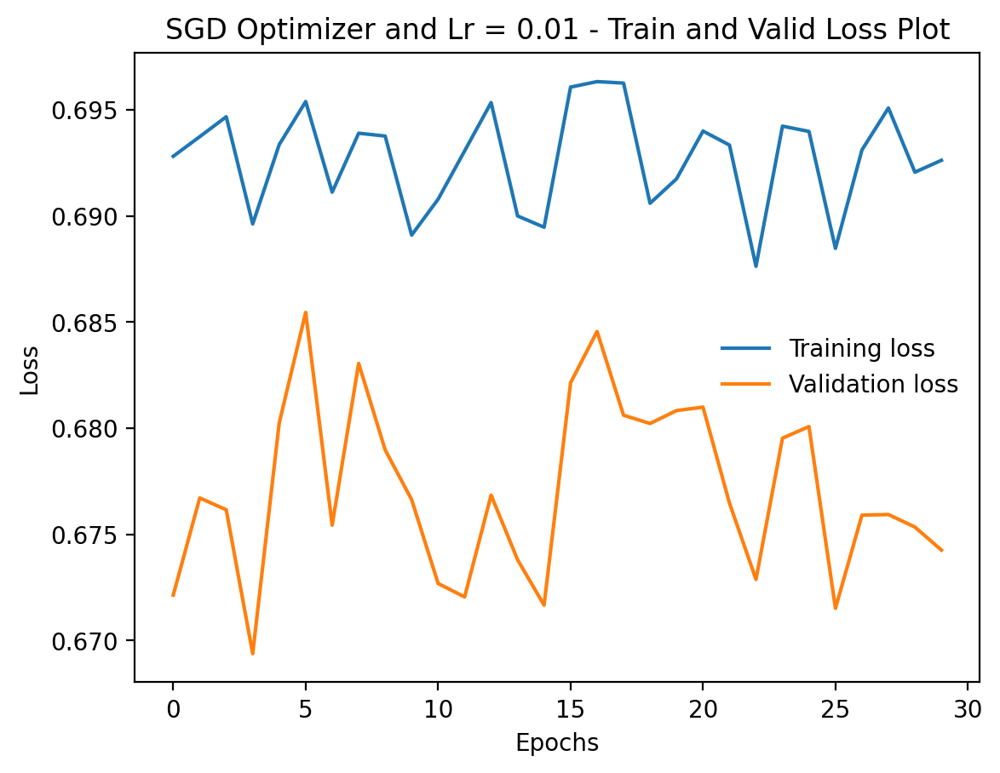

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.01 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.01 - Train and Valid Accuracy Plot')

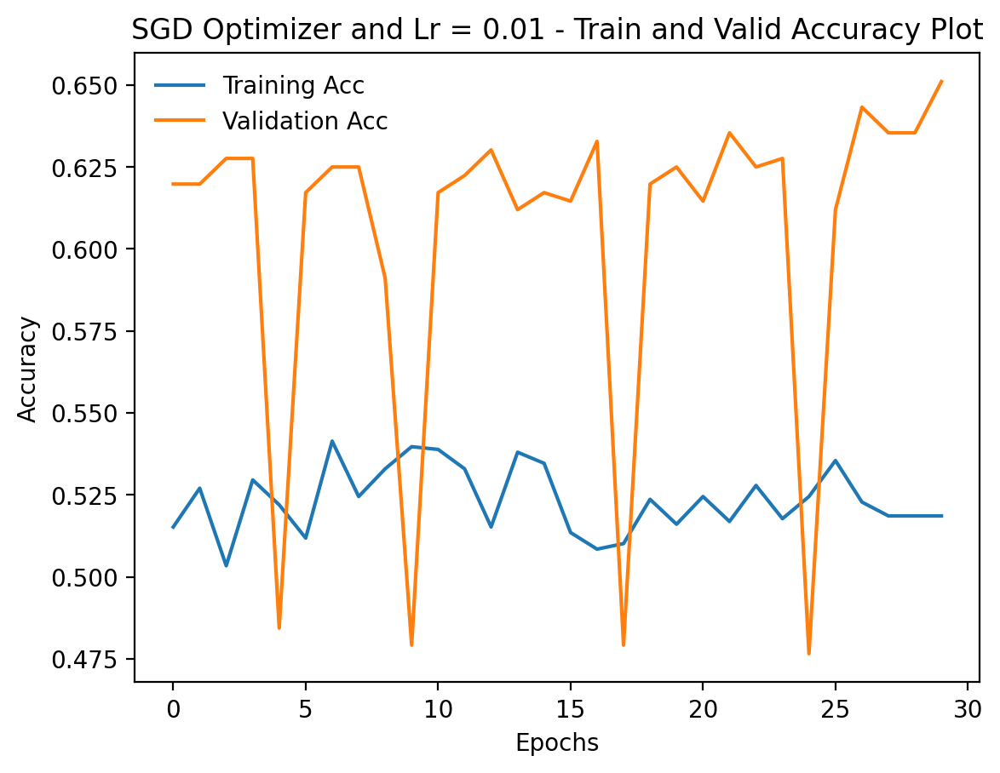

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_accs, label='Training Acc')
plt.plot(valid_accs, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.01 - Train and Valid Accuracy Plot")

TODO: You can load the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

  0%|          | 0/13 [00:00<?, ?it/s]

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

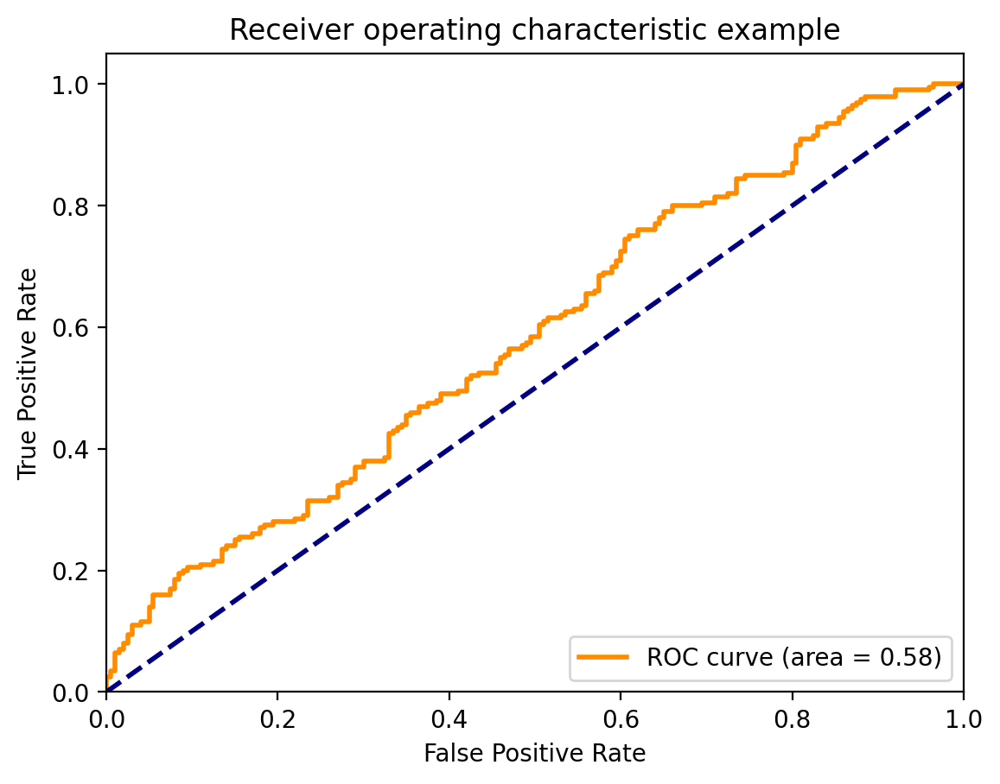

<ipython-input-325-090c2baad2d4>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


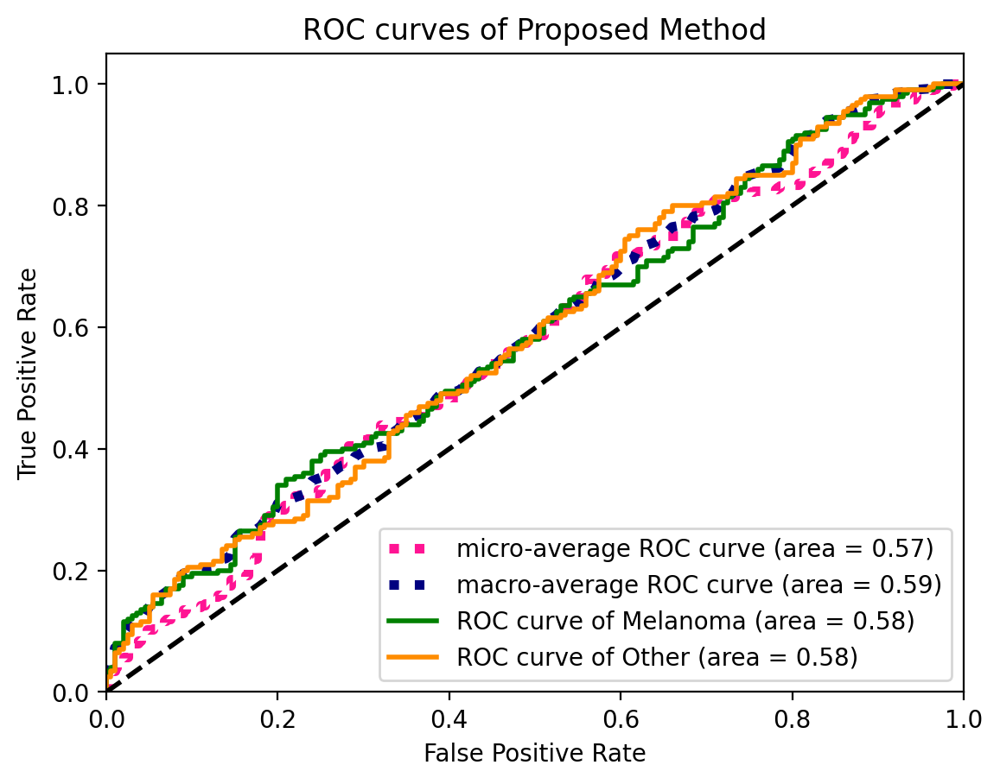

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Melanoma (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Other (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[ 99 101]
 [ 83 117]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


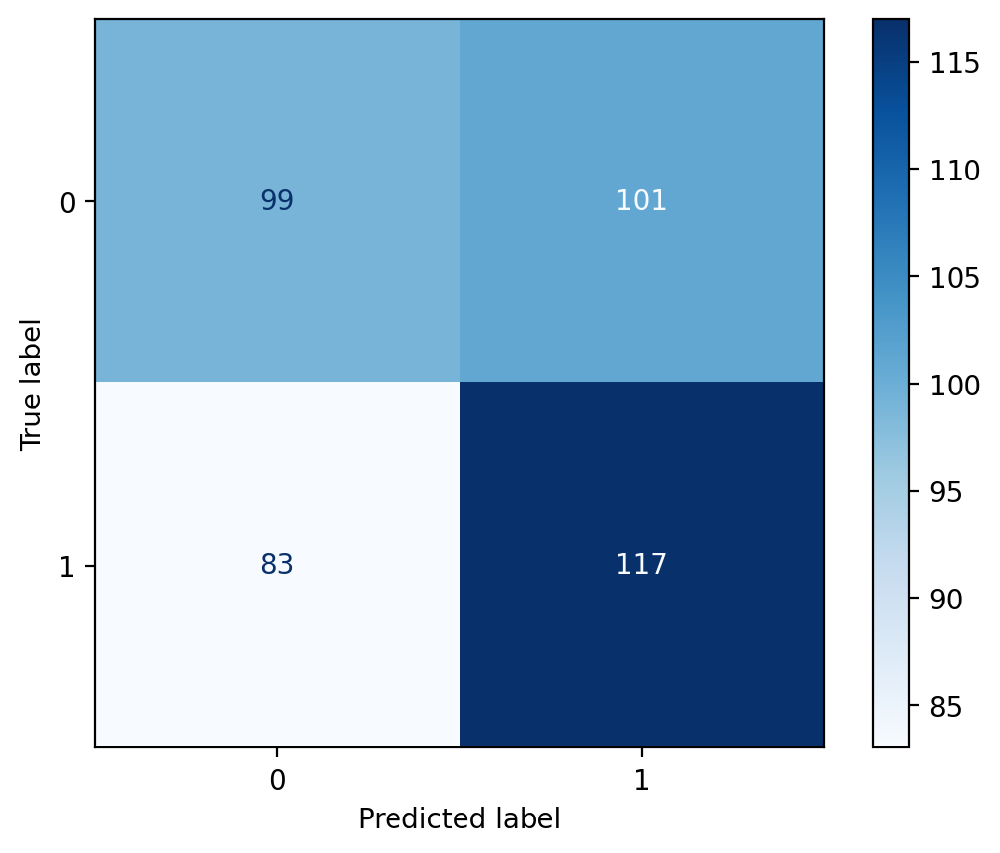

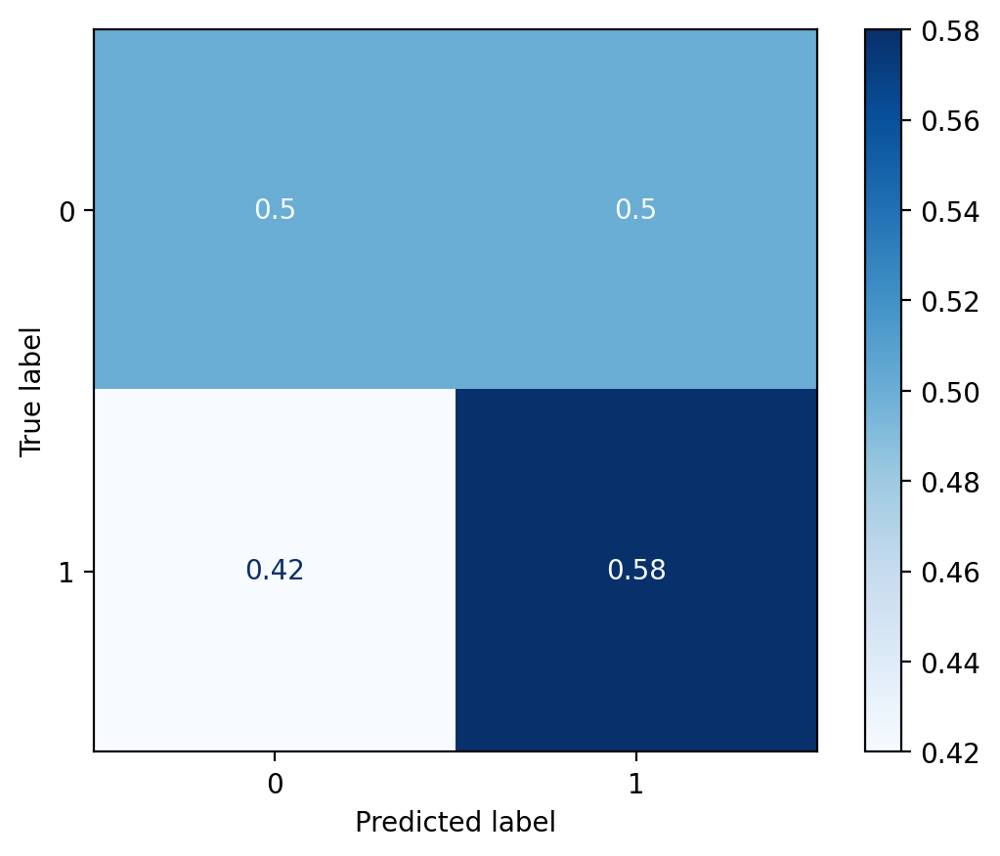

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.54, Recall: 0.49, F1_score: 0.52, Specificity: 0.58


###### SGD Optimizer and lr = 0.001

In [ ]:
vgg16_layers = get_vgg_layers(vgg16_config, batch_norm=True)
#print(vgg11_layers)

OUTPUT_DIM = 2

model = VGG(vgg16_layers, OUTPUT_DIM)
#print(model)
pretrained_model = models.vgg16_bn(pretrained=True)
#print(pretrained_model)
IN_FEATURES = pretrained_model.classifier[-1].in_features

final_fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 134,277,186 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-3

params = [
          {'params': model.features.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.classifier.parameters()}
         ]

optimizer = optim.SGD(params, lr=FOUND_LR)

In [ ]:
def calculate_accuracy(y_pred, y):
    top_pred = y_pred.argmax(1, keepdim=True)
    correct = top_pred.eq(y.view_as(top_pred)).sum()
    acc = correct.float() / y.shape[0]
    return acc

In [ ]:
def train(model, iterator, optimizer, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.train()

    for (x, y) in tqdm(iterator, desc="Training", leave=False):

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc = calculate_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc = calculate_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in tqdm(iterator):

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim=-1)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim=0)
    labels = torch.cat(labels, dim=0)
    probs = torch.cat(probs, dim=0)

    return images, labels, probs

In [ ]:
EPOCHS = 30

# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_accs = []
valid_accs = []

best_valid_acc = 0  # Track the best validation top-1 accuracy
best_train_acc = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')

for epoch in trange(EPOCHS, desc="Epochs"):

    start_time = time.monotonic()

    train_loss, train_acc = train(model, train_iter, optimizer, criterion, device)
    valid_loss, valid_acc = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_accs.append(train_acc)
    valid_accs.append(valid_acc)


    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc > best_valid_acc:
        best_valid_acc = valid_acc
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
    print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')

Epochs:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 15s
	Train Loss: 0.699 | Train Acc: 50.68%
	 Val. Loss: 0.690 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 15s
	Train Loss: 0.698 | Train Acc: 51.77%
	 Val. Loss: 0.673 |  Val. Acc: 67.19%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 15s
	Train Loss: 0.691 | Train Acc: 54.81%
	 Val. Loss: 0.686 |  Val. Acc: 51.56%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 13s
	Train Loss: 0.691 | Train Acc: 52.45%
	 Val. Loss: 0.685 |  Val. Acc: 52.34%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 13s
	Train Loss: 0.697 | Train Acc: 53.04%
	 Val. Loss: 0.664 |  Val. Acc: 63.54%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 13s
	Train Loss: 0.689 | Train Acc: 53.89%
	 Val. Loss: 0.674 |  Val. Acc: 54.69%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 15s
	Train Loss: 0.687 | Train Acc: 55.24%
	 Val. Loss: 0.669 |  Val. Acc: 57.81%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 13s
	Train Loss: 0.690 | Train Acc: 53.38%
	 Val. Loss: 0.669 |  Val. Acc: 57.03%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 13s
	Train Loss: 0.692 | Train Acc: 54.31%
	 Val. Loss: 0.669 |  Val. Acc: 56.77%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 15s
	Train Loss: 0.682 | Train Acc: 55.74%
	 Val. Loss: 0.655 |  Val. Acc: 69.01%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 15s
	Train Loss: 0.686 | Train Acc: 56.59%
	 Val. Loss: 0.669 |  Val. Acc: 55.99%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 13s
	Train Loss: 0.681 | Train Acc: 55.41%
	 Val. Loss: 0.666 |  Val. Acc: 56.51%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 15s
	Train Loss: 0.683 | Train Acc: 57.43%
	 Val. Loss: 0.666 |  Val. Acc: 56.25%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 13s
	Train Loss: 0.686 | Train Acc: 55.66%
	 Val. Loss: 0.662 |  Val. Acc: 57.55%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 15s
	Train Loss: 0.682 | Train Acc: 57.69%
	 Val. Loss: 0.669 |  Val. Acc: 55.47%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 16 | Epoch Time: 0m 13s
	Train Loss: 0.683 | Train Acc: 55.74%
	 Val. Loss: 0.652 |  Val. Acc: 63.80%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 17 | Epoch Time: 0m 13s
	Train Loss: 0.685 | Train Acc: 56.84%
	 Val. Loss: 0.649 |  Val. Acc: 66.93%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 18 | Epoch Time: 0m 13s
	Train Loss: 0.685 | Train Acc: 56.25%
	 Val. Loss: 0.715 |  Val. Acc: 50.26%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 19 | Epoch Time: 0m 13s
	Train Loss: 0.687 | Train Acc: 56.08%
	 Val. Loss: 0.646 |  Val. Acc: 69.27%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 20 | Epoch Time: 0m 13s
	Train Loss: 0.681 | Train Acc: 57.26%
	 Val. Loss: 0.650 |  Val. Acc: 67.45%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 21 | Epoch Time: 0m 13s
	Train Loss: 0.679 | Train Acc: 57.09%
	 Val. Loss: 0.670 |  Val. Acc: 55.73%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 22 | Epoch Time: 0m 16s
	Train Loss: 0.678 | Train Acc: 57.85%
	 Val. Loss: 0.669 |  Val. Acc: 55.21%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 23 | Epoch Time: 0m 13s
	Train Loss: 0.677 | Train Acc: 57.52%
	 Val. Loss: 0.642 |  Val. Acc: 65.36%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 24 | Epoch Time: 0m 13s
	Train Loss: 0.678 | Train Acc: 56.67%
	 Val. Loss: 0.641 |  Val. Acc: 69.01%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 25 | Epoch Time: 0m 13s
	Train Loss: 0.684 | Train Acc: 56.42%
	 Val. Loss: 0.669 |  Val. Acc: 55.21%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 26 | Epoch Time: 0m 13s
	Train Loss: 0.679 | Train Acc: 55.07%
	 Val. Loss: 0.642 |  Val. Acc: 68.49%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 27 | Epoch Time: 0m 13s
	Train Loss: 0.686 | Train Acc: 54.56%
	 Val. Loss: 0.652 |  Val. Acc: 57.81%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 28 | Epoch Time: 0m 13s
	Train Loss: 0.678 | Train Acc: 57.26%
	 Val. Loss: 0.665 |  Val. Acc: 55.47%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 29 | Epoch Time: 0m 15s
	Train Loss: 0.670 | Train Acc: 59.12%
	 Val. Loss: 0.658 |  Val. Acc: 57.81%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 30 | Epoch Time: 0m 13s
	Train Loss: 0.670 | Train Acc: 56.17%
	 Val. Loss: 0.659 |  Val. Acc: 56.25%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc * 100))

Lowest valid_loss: 64.05%
Best valid_Acc: 69.27%
Lowest train_loss: 66.99%
Best train_Acc: 59.12%


Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.001 - Train and Valid Loss Plot')

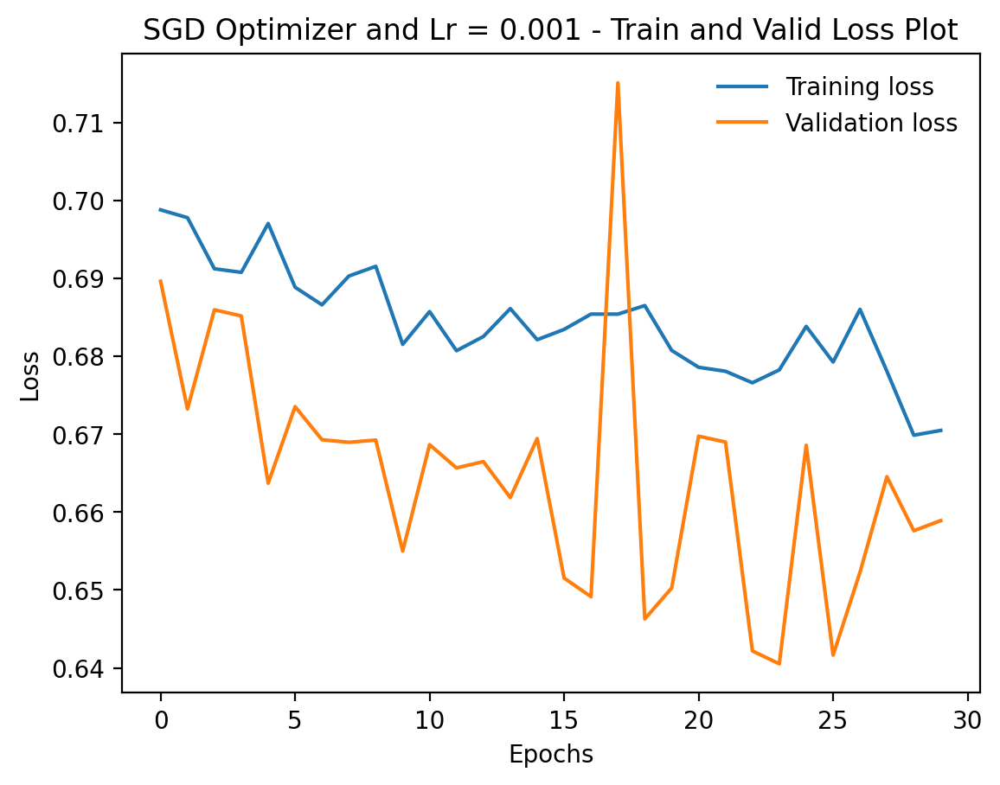

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.001 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.001 - Train and Valid Accuracy Plot')

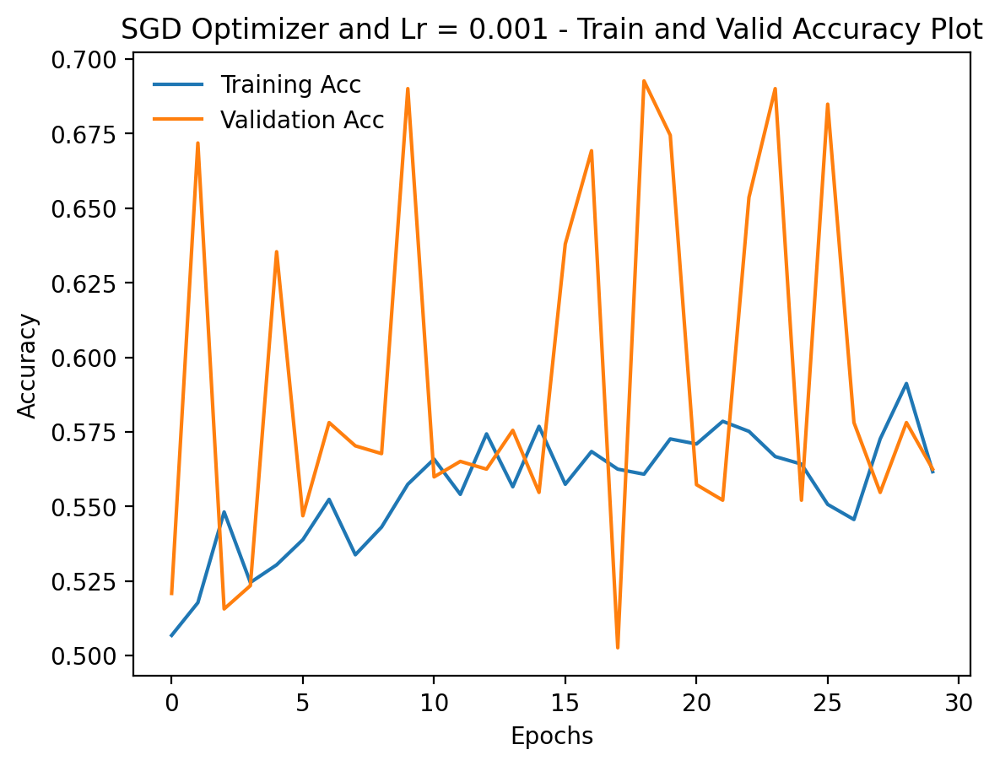

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_accs, label='Training Acc')
plt.plot(valid_accs, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.001 - Train and Valid Accuracy Plot")

TODO: You can load the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

  0%|          | 0/13 [00:00<?, ?it/s]

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

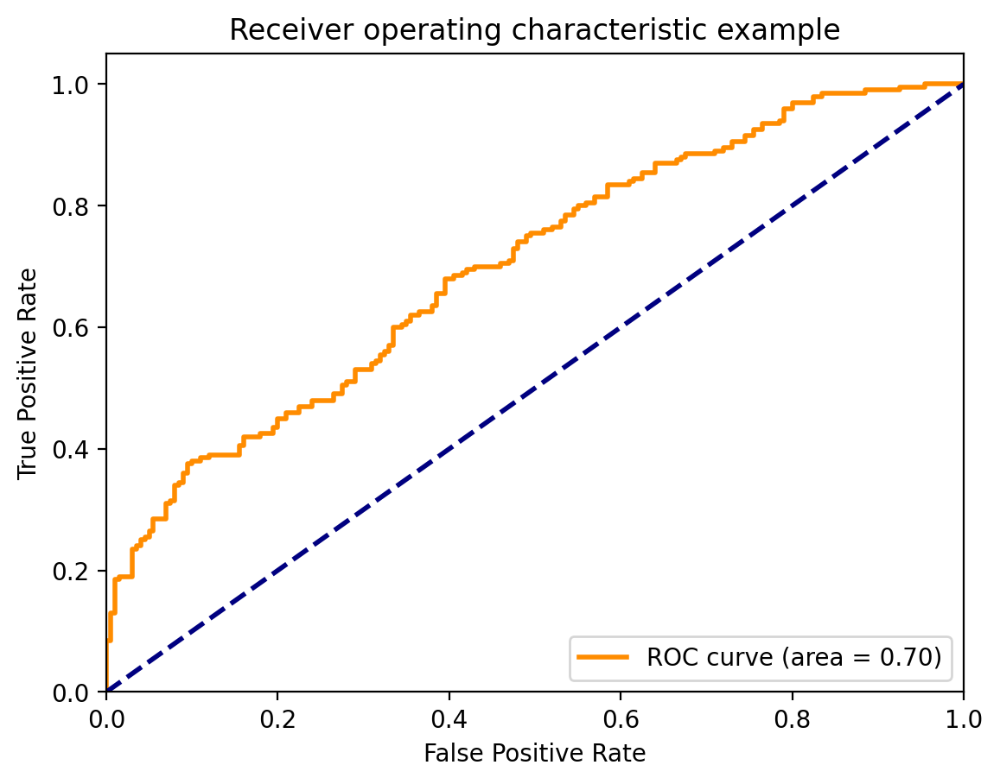

<ipython-input-342-090c2baad2d4>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


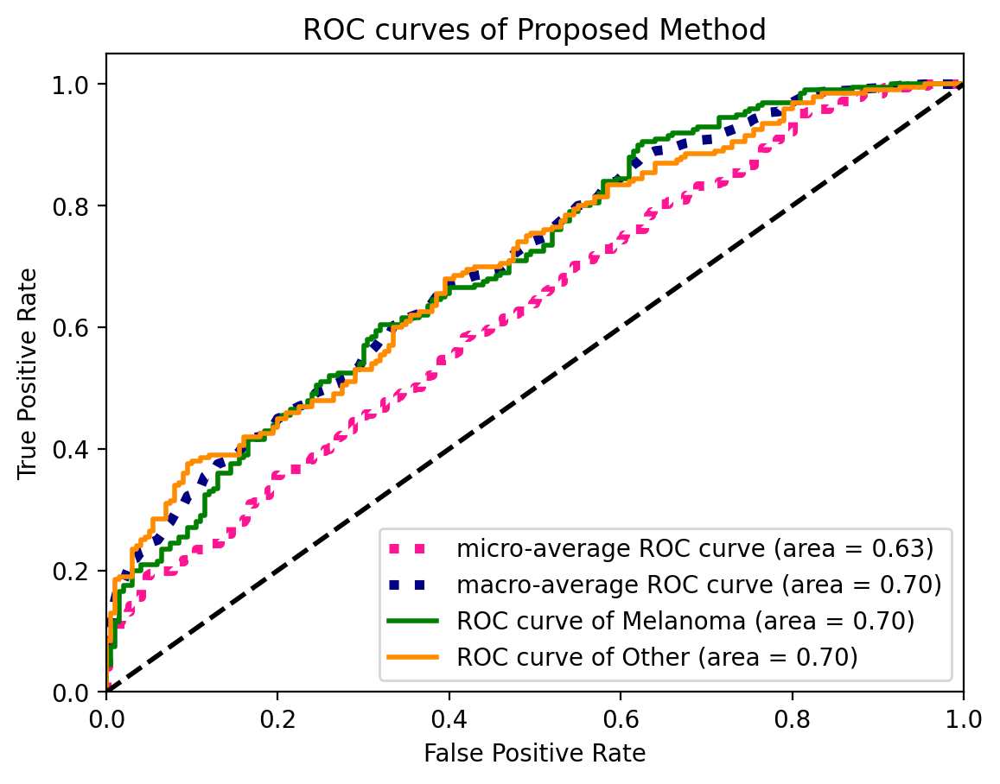

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Melanoma (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Other (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[ 41 159]
 [  8 192]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


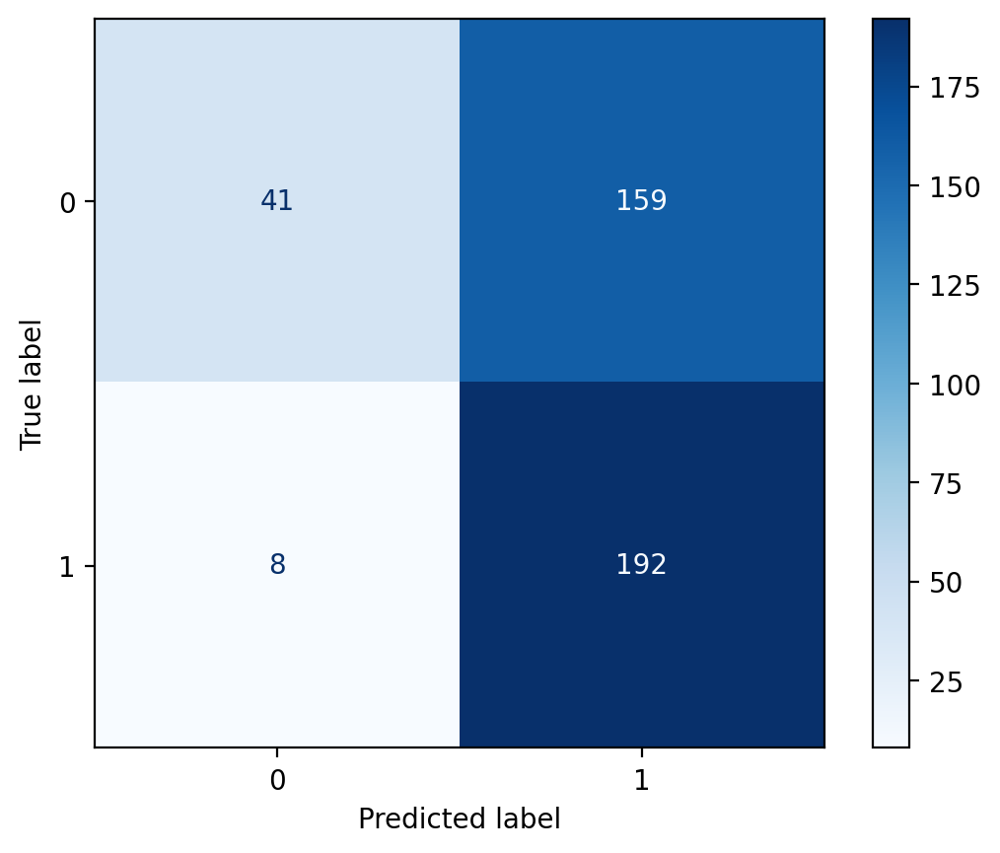

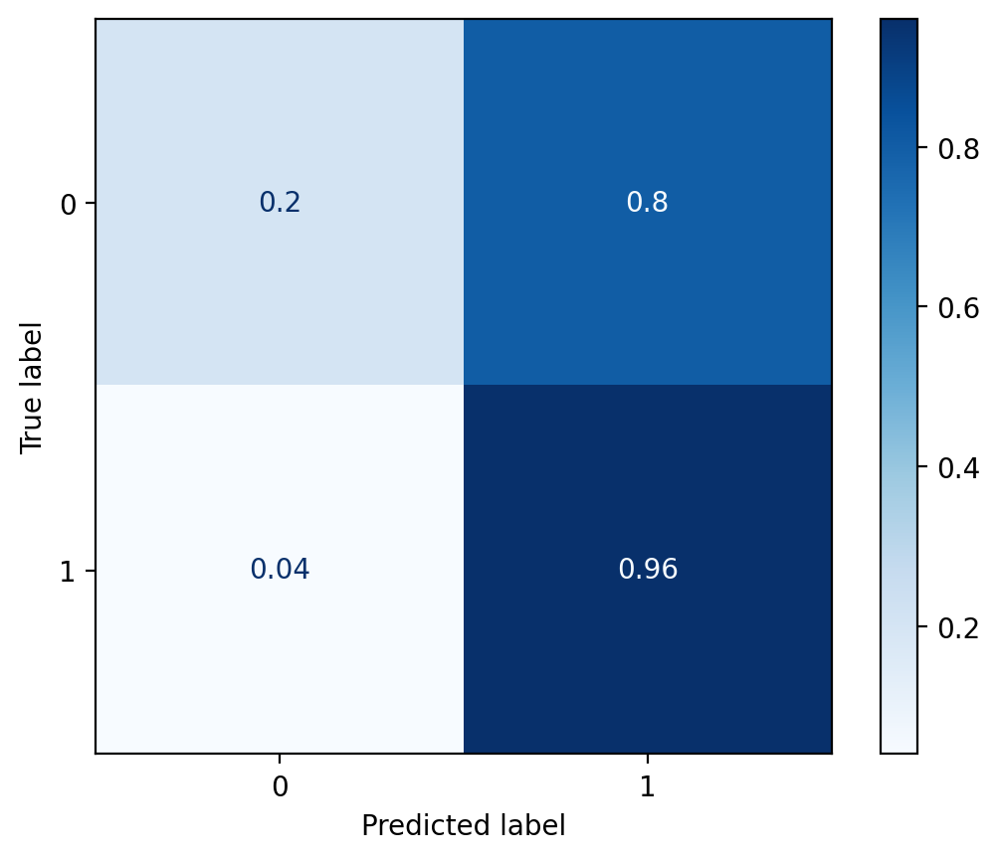

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.84, Recall: 0.20, F1_score: 0.33, Specificity: 0.96


###### SGD Optimizer and lr = 0.0001

In [ ]:
vgg16_layers = get_vgg_layers(vgg16_config, batch_norm=True)
#print(vgg11_layers)

OUTPUT_DIM = 2

model = VGG(vgg16_layers, OUTPUT_DIM)
#print(model)
pretrained_model = models.vgg16_bn(pretrained=True)
#print(pretrained_model)
IN_FEATURES = pretrained_model.classifier[-1].in_features

final_fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 134,277,186 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-4

params = [
          {'params': model.features.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.classifier.parameters()}
         ]

optimizer = optim.SGD(params, lr=FOUND_LR)

In [ ]:
def calculate_accuracy(y_pred, y):
    top_pred = y_pred.argmax(1, keepdim=True)
    correct = top_pred.eq(y.view_as(top_pred)).sum()
    acc = correct.float() / y.shape[0]
    return acc

In [ ]:
def train(model, iterator, optimizer, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.train()

    for (x, y) in tqdm(iterator, desc="Training", leave=False):

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc = calculate_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc = calculate_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in tqdm(iterator):

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim=-1)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim=0)
    labels = torch.cat(labels, dim=0)
    probs = torch.cat(probs, dim=0)

    return images, labels, probs

In [ ]:
EPOCHS = 30

# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_accs = []
valid_accs = []

best_valid_acc = 0  # Track the best validation top-1 accuracy
best_train_acc = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')

for epoch in trange(EPOCHS, desc="Epochs"):

    start_time = time.monotonic()

    train_loss, train_acc = train(model, train_iter, optimizer, criterion, device)
    valid_loss, valid_acc = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_accs.append(train_acc)
    valid_accs.append(valid_acc)


    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc > best_valid_acc:
        best_valid_acc = valid_acc
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
    print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')

Epochs:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 15s
	Train Loss: 0.698 | Train Acc: 50.34%
	 Val. Loss: 0.690 |  Val. Acc: 55.47%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 13s
	Train Loss: 0.698 | Train Acc: 50.17%
	 Val. Loss: 0.679 |  Val. Acc: 55.73%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 13s
	Train Loss: 0.697 | Train Acc: 49.49%
	 Val. Loss: 0.679 |  Val. Acc: 53.12%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 19s
	Train Loss: 0.699 | Train Acc: 51.10%
	 Val. Loss: 0.678 |  Val. Acc: 52.86%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 15s
	Train Loss: 0.700 | Train Acc: 51.77%
	 Val. Loss: 0.677 |  Val. Acc: 55.21%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 13s
	Train Loss: 0.696 | Train Acc: 51.35%
	 Val. Loss: 0.675 |  Val. Acc: 57.29%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 13s
	Train Loss: 0.695 | Train Acc: 50.25%
	 Val. Loss: 0.676 |  Val. Acc: 54.95%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 15s
	Train Loss: 0.689 | Train Acc: 53.21%
	 Val. Loss: 0.675 |  Val. Acc: 54.95%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 13s
	Train Loss: 0.702 | Train Acc: 51.52%
	 Val. Loss: 0.674 |  Val. Acc: 58.07%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 13s
	Train Loss: 0.692 | Train Acc: 53.04%
	 Val. Loss: 0.673 |  Val. Acc: 55.47%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 13s
	Train Loss: 0.703 | Train Acc: 50.76%
	 Val. Loss: 0.671 |  Val. Acc: 56.51%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 13s
	Train Loss: 0.699 | Train Acc: 52.45%
	 Val. Loss: 0.670 |  Val. Acc: 60.94%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 13s
	Train Loss: 0.693 | Train Acc: 53.12%
	 Val. Loss: 0.670 |  Val. Acc: 57.55%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 13s
	Train Loss: 0.701 | Train Acc: 52.36%
	 Val. Loss: 0.670 |  Val. Acc: 58.33%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 13s
	Train Loss: 0.696 | Train Acc: 51.35%
	 Val. Loss: 0.669 |  Val. Acc: 58.85%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 16 | Epoch Time: 0m 15s
	Train Loss: 0.690 | Train Acc: 54.65%
	 Val. Loss: 0.670 |  Val. Acc: 60.42%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 17 | Epoch Time: 0m 13s
	Train Loss: 0.702 | Train Acc: 50.00%
	 Val. Loss: 0.669 |  Val. Acc: 58.33%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 18 | Epoch Time: 0m 13s
	Train Loss: 0.697 | Train Acc: 52.62%
	 Val. Loss: 0.671 |  Val. Acc: 54.43%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 19 | Epoch Time: 0m 13s
	Train Loss: 0.696 | Train Acc: 50.42%
	 Val. Loss: 0.671 |  Val. Acc: 55.73%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 20 | Epoch Time: 0m 13s
	Train Loss: 0.691 | Train Acc: 52.79%
	 Val. Loss: 0.670 |  Val. Acc: 55.99%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 21 | Epoch Time: 0m 13s
	Train Loss: 0.691 | Train Acc: 54.39%
	 Val. Loss: 0.671 |  Val. Acc: 55.73%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 22 | Epoch Time: 0m 13s
	Train Loss: 0.692 | Train Acc: 54.31%
	 Val. Loss: 0.669 |  Val. Acc: 56.77%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 23 | Epoch Time: 0m 13s
	Train Loss: 0.694 | Train Acc: 54.14%
	 Val. Loss: 0.670 |  Val. Acc: 55.21%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 24 | Epoch Time: 0m 13s
	Train Loss: 0.693 | Train Acc: 53.80%
	 Val. Loss: 0.669 |  Val. Acc: 57.03%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 25 | Epoch Time: 0m 13s
	Train Loss: 0.700 | Train Acc: 51.01%
	 Val. Loss: 0.667 |  Val. Acc: 58.07%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 26 | Epoch Time: 0m 13s
	Train Loss: 0.691 | Train Acc: 53.97%
	 Val. Loss: 0.668 |  Val. Acc: 57.55%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 27 | Epoch Time: 0m 13s
	Train Loss: 0.689 | Train Acc: 53.63%
	 Val. Loss: 0.667 |  Val. Acc: 57.03%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 28 | Epoch Time: 0m 13s
	Train Loss: 0.689 | Train Acc: 52.53%
	 Val. Loss: 0.666 |  Val. Acc: 57.29%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 29 | Epoch Time: 0m 13s
	Train Loss: 0.694 | Train Acc: 52.03%
	 Val. Loss: 0.665 |  Val. Acc: 57.29%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 30 | Epoch Time: 0m 13s
	Train Loss: 0.694 | Train Acc: 53.55%
	 Val. Loss: 0.667 |  Val. Acc: 58.07%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc * 100))

Lowest valid_loss: 66.46%
Best valid_Acc: 60.94%
Lowest train_loss: 68.87%
Best train_Acc: 54.65%


Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.0001 - Train and Valid Loss Plot')

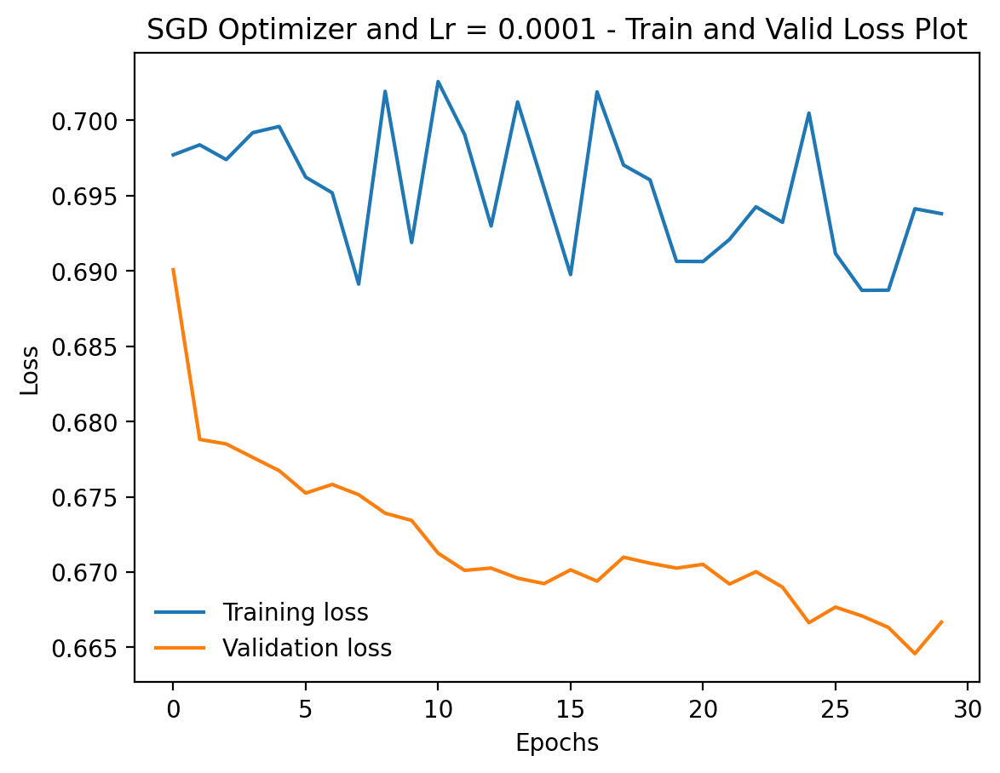

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.0001 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.0001 - Train and Valid Accuracy Plot')

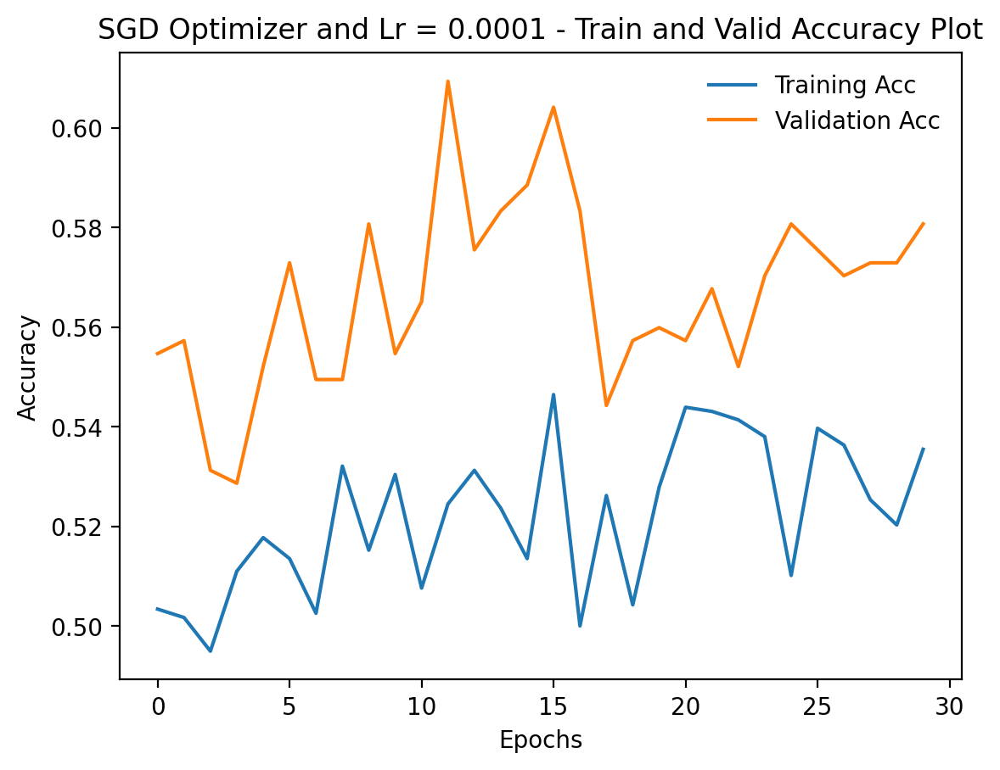

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_accs, label='Training Acc')
plt.plot(valid_accs, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.0001 - Train and Valid Accuracy Plot")

TODO: You can load the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

  0%|          | 0/13 [00:00<?, ?it/s]

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

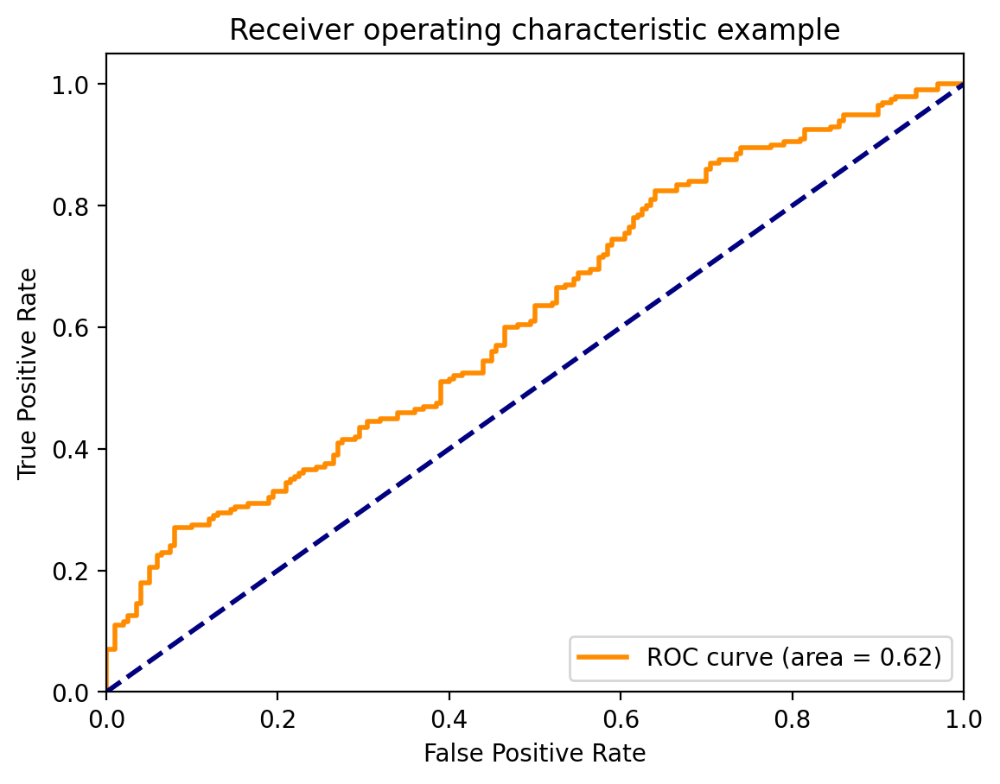

<ipython-input-359-090c2baad2d4>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


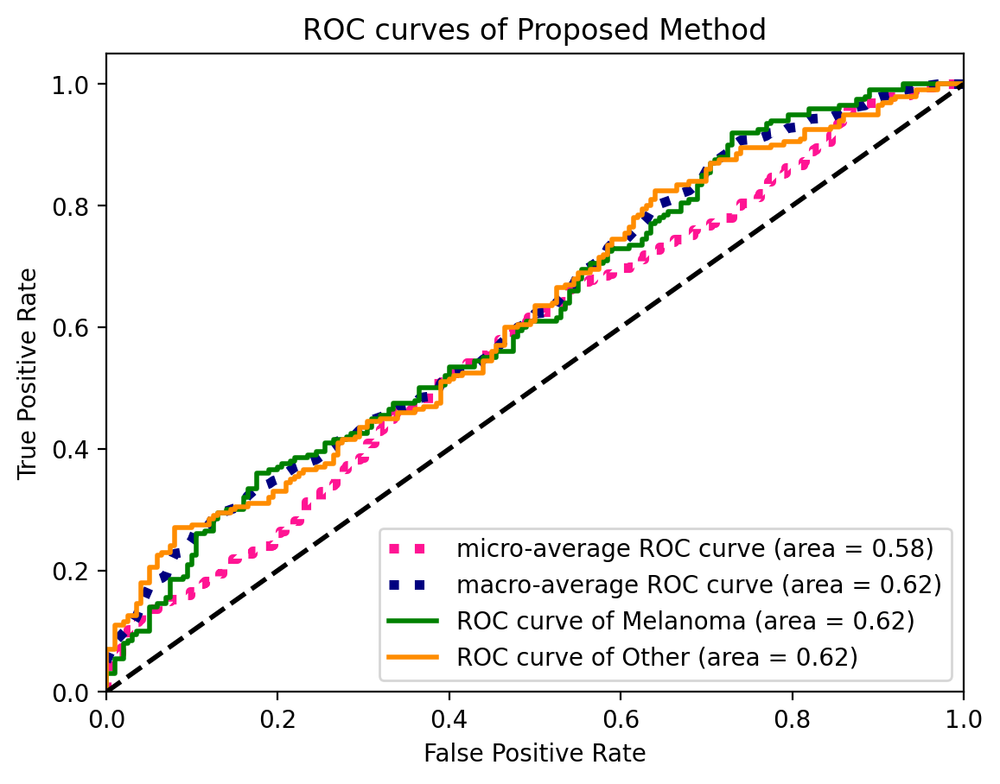

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Melanoma (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Other (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[ 42 158]
 [ 20 180]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


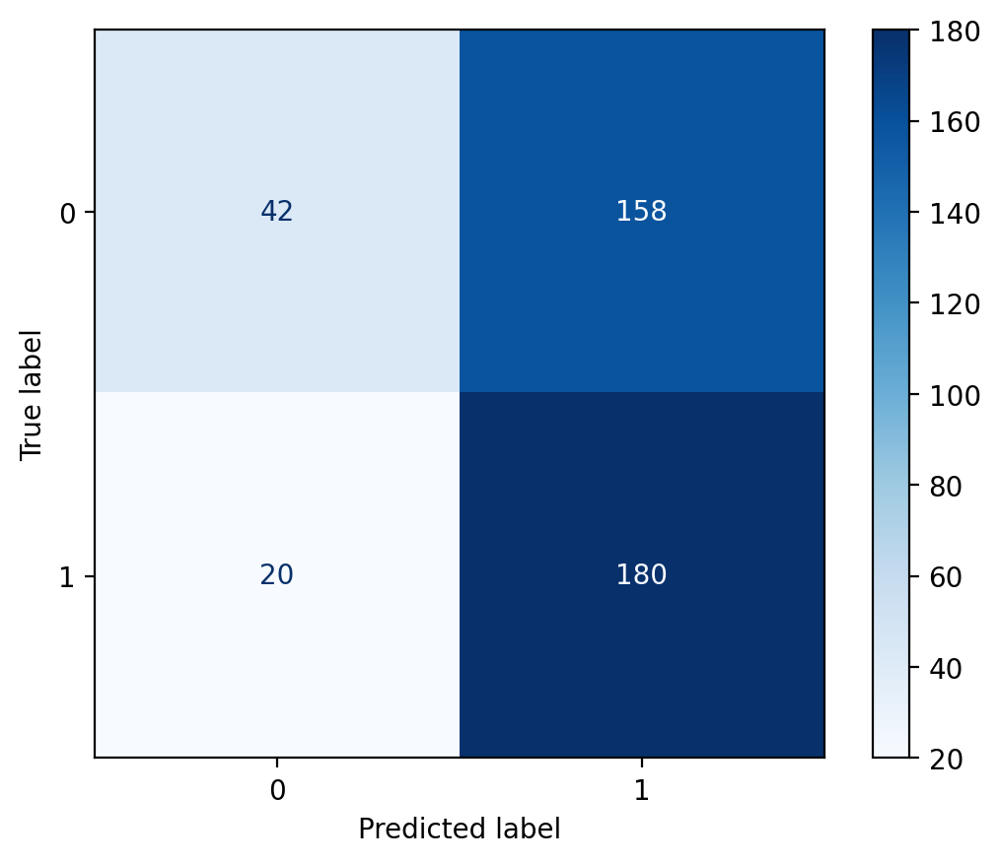

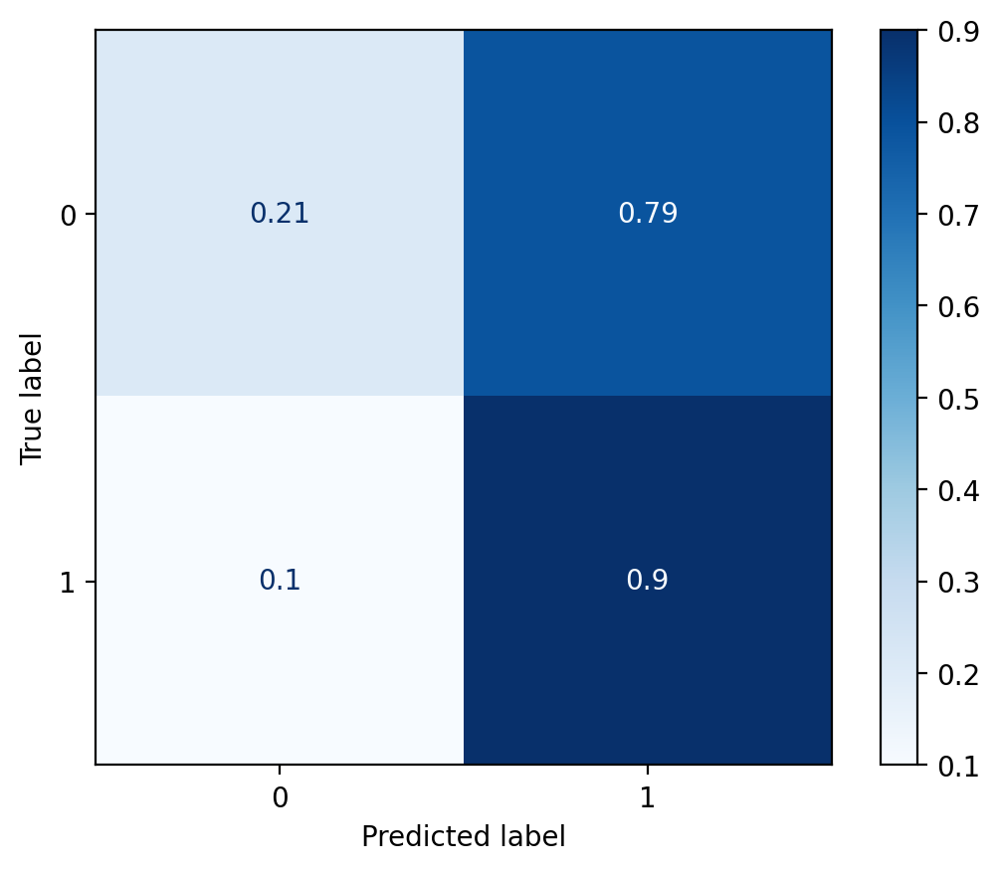

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.68, Recall: 0.21, F1_score: 0.32, Specificity: 0.90


###### SGD Optimizer and lr = 0.0005

In [ ]:
vgg16_layers = get_vgg_layers(vgg16_config, batch_norm=True)
#print(vgg11_layers)

OUTPUT_DIM = 2

model = VGG(vgg16_layers, OUTPUT_DIM)
#print(model)
pretrained_model = models.vgg16_bn(pretrained=True)
#print(pretrained_model)
IN_FEATURES = pretrained_model.classifier[-1].in_features

final_fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 134,277,186 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 5e-4

params = [
          {'params': model.features.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.classifier.parameters()}
         ]

optimizer = optim.SGD(params, lr=FOUND_LR)

In [ ]:
def calculate_accuracy(y_pred, y):
    top_pred = y_pred.argmax(1, keepdim=True)
    correct = top_pred.eq(y.view_as(top_pred)).sum()
    acc = correct.float() / y.shape[0]
    return acc

In [ ]:
def train(model, iterator, optimizer, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.train()

    for (x, y) in tqdm(iterator, desc="Training", leave=False):

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc = calculate_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc = calculate_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in tqdm(iterator):

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim=-1)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim=0)
    labels = torch.cat(labels, dim=0)
    probs = torch.cat(probs, dim=0)

    return images, labels, probs

In [ ]:
EPOCHS = 30

# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_accs = []
valid_accs = []

best_valid_acc = 0  # Track the best validation top-1 accuracy
best_train_acc = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')

for epoch in trange(EPOCHS, desc="Epochs"):

    start_time = time.monotonic()

    train_loss, train_acc = train(model, train_iter, optimizer, criterion, device)
    valid_loss, valid_acc = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_accs.append(train_acc)
    valid_accs.append(valid_acc)


    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc > best_valid_acc:
        best_valid_acc = valid_acc
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
    print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')

Epochs:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 15s
	Train Loss: 0.701 | Train Acc: 51.01%
	 Val. Loss: 0.689 |  Val. Acc: 57.29%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 15s
	Train Loss: 0.695 | Train Acc: 51.27%
	 Val. Loss: 0.675 |  Val. Acc: 57.29%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 15s
	Train Loss: 0.696 | Train Acc: 52.62%
	 Val. Loss: 0.674 |  Val. Acc: 57.03%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 15s
	Train Loss: 0.690 | Train Acc: 54.05%
	 Val. Loss: 0.687 |  Val. Acc: 49.48%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 13s
	Train Loss: 0.696 | Train Acc: 52.53%
	 Val. Loss: 0.671 |  Val. Acc: 55.73%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 15s
	Train Loss: 0.689 | Train Acc: 55.41%
	 Val. Loss: 0.677 |  Val. Acc: 52.60%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 13s
	Train Loss: 0.700 | Train Acc: 51.69%
	 Val. Loss: 0.670 |  Val. Acc: 60.94%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 15s
	Train Loss: 0.681 | Train Acc: 56.84%
	 Val. Loss: 0.671 |  Val. Acc: 54.95%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 13s
	Train Loss: 0.682 | Train Acc: 56.59%
	 Val. Loss: 0.671 |  Val. Acc: 54.95%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 13s
	Train Loss: 0.698 | Train Acc: 54.73%
	 Val. Loss: 0.670 |  Val. Acc: 54.95%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 13s
	Train Loss: 0.685 | Train Acc: 54.73%
	 Val. Loss: 0.670 |  Val. Acc: 53.12%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 13s
	Train Loss: 0.690 | Train Acc: 54.31%
	 Val. Loss: 0.669 |  Val. Acc: 54.69%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 13s
	Train Loss: 0.687 | Train Acc: 55.83%
	 Val. Loss: 0.671 |  Val. Acc: 52.86%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 13s
	Train Loss: 0.692 | Train Acc: 53.80%
	 Val. Loss: 0.674 |  Val. Acc: 52.60%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 13s
	Train Loss: 0.688 | Train Acc: 55.07%
	 Val. Loss: 0.665 |  Val. Acc: 55.73%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 16 | Epoch Time: 0m 15s
	Train Loss: 0.681 | Train Acc: 56.93%
	 Val. Loss: 0.661 |  Val. Acc: 59.90%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 17 | Epoch Time: 0m 13s
	Train Loss: 0.686 | Train Acc: 54.39%
	 Val. Loss: 0.669 |  Val. Acc: 53.39%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 18 | Epoch Time: 0m 13s
	Train Loss: 0.688 | Train Acc: 55.83%
	 Val. Loss: 0.663 |  Val. Acc: 55.47%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 19 | Epoch Time: 0m 13s
	Train Loss: 0.685 | Train Acc: 55.57%
	 Val. Loss: 0.656 |  Val. Acc: 63.02%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 20 | Epoch Time: 0m 13s
	Train Loss: 0.685 | Train Acc: 55.66%
	 Val. Loss: 0.666 |  Val. Acc: 55.21%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 21 | Epoch Time: 0m 13s
	Train Loss: 0.680 | Train Acc: 56.25%
	 Val. Loss: 0.665 |  Val. Acc: 55.99%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 22 | Epoch Time: 0m 15s
	Train Loss: 0.681 | Train Acc: 57.60%
	 Val. Loss: 0.665 |  Val. Acc: 55.21%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 23 | Epoch Time: 0m 13s
	Train Loss: 0.684 | Train Acc: 55.91%
	 Val. Loss: 0.676 |  Val. Acc: 51.04%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 24 | Epoch Time: 0m 13s
	Train Loss: 0.674 | Train Acc: 57.18%
	 Val. Loss: 0.674 |  Val. Acc: 51.30%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 25 | Epoch Time: 0m 13s
	Train Loss: 0.690 | Train Acc: 53.80%
	 Val. Loss: 0.669 |  Val. Acc: 52.86%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 26 | Epoch Time: 0m 13s
	Train Loss: 0.682 | Train Acc: 55.91%
	 Val. Loss: 0.660 |  Val. Acc: 54.43%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 27 | Epoch Time: 0m 15s
	Train Loss: 0.673 | Train Acc: 57.77%
	 Val. Loss: 0.651 |  Val. Acc: 63.80%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 28 | Epoch Time: 0m 13s
	Train Loss: 0.673 | Train Acc: 57.09%
	 Val. Loss: 0.659 |  Val. Acc: 56.51%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 29 | Epoch Time: 0m 15s
	Train Loss: 0.675 | Train Acc: 58.19%
	 Val. Loss: 0.669 |  Val. Acc: 53.39%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 30 | Epoch Time: 0m 13s
	Train Loss: 0.680 | Train Acc: 57.01%
	 Val. Loss: 0.654 |  Val. Acc: 59.90%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc * 100))

Lowest valid_loss: 65.08%
Best valid_Acc: 63.80%
Lowest train_loss: 67.27%
Best train_Acc: 58.19%


Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.0005 - Train and Valid Loss Plot')

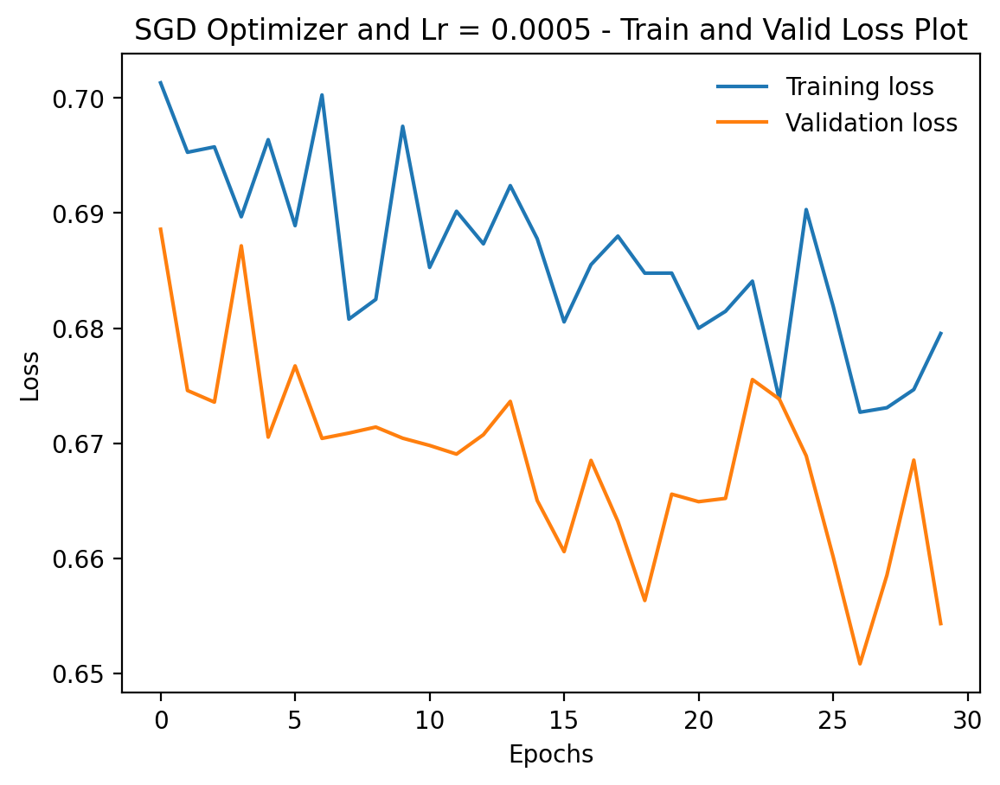

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.0005 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'SGD Optimizer and Lr = 0.0005 - Train and Valid Accuracy Plot')

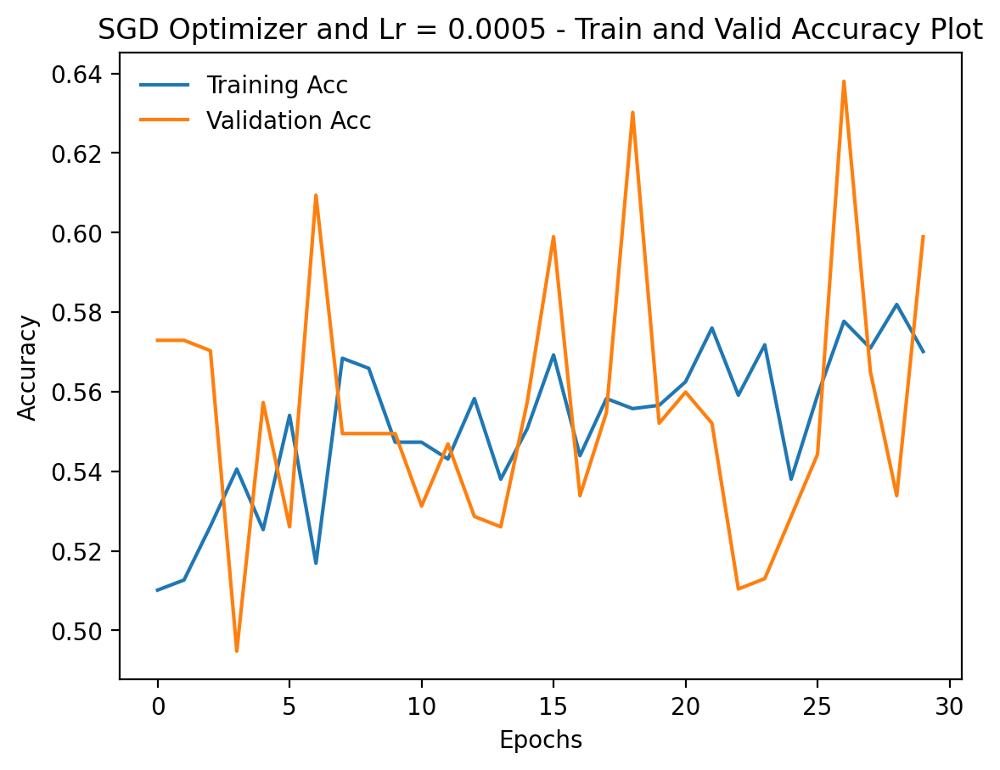

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_accs, label='Training Acc')
plt.plot(valid_accs, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("SGD Optimizer and Lr = 0.0005 - Train and Valid Accuracy Plot")

TODO: You can load the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

  0%|          | 0/13 [00:00<?, ?it/s]

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

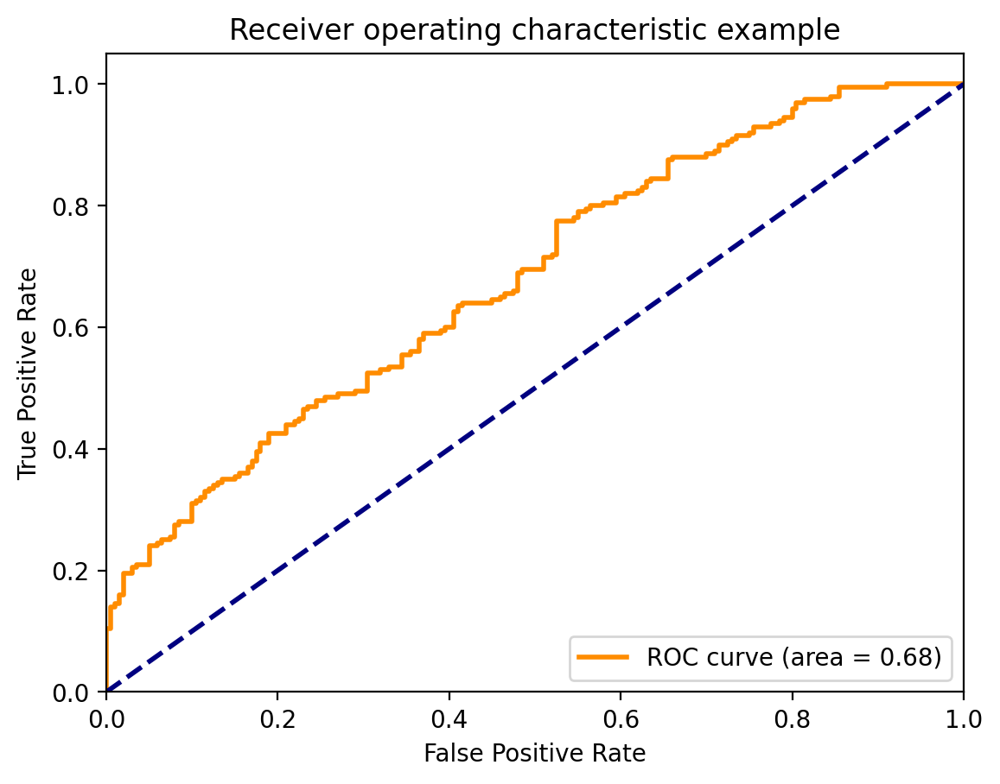

<ipython-input-376-090c2baad2d4>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


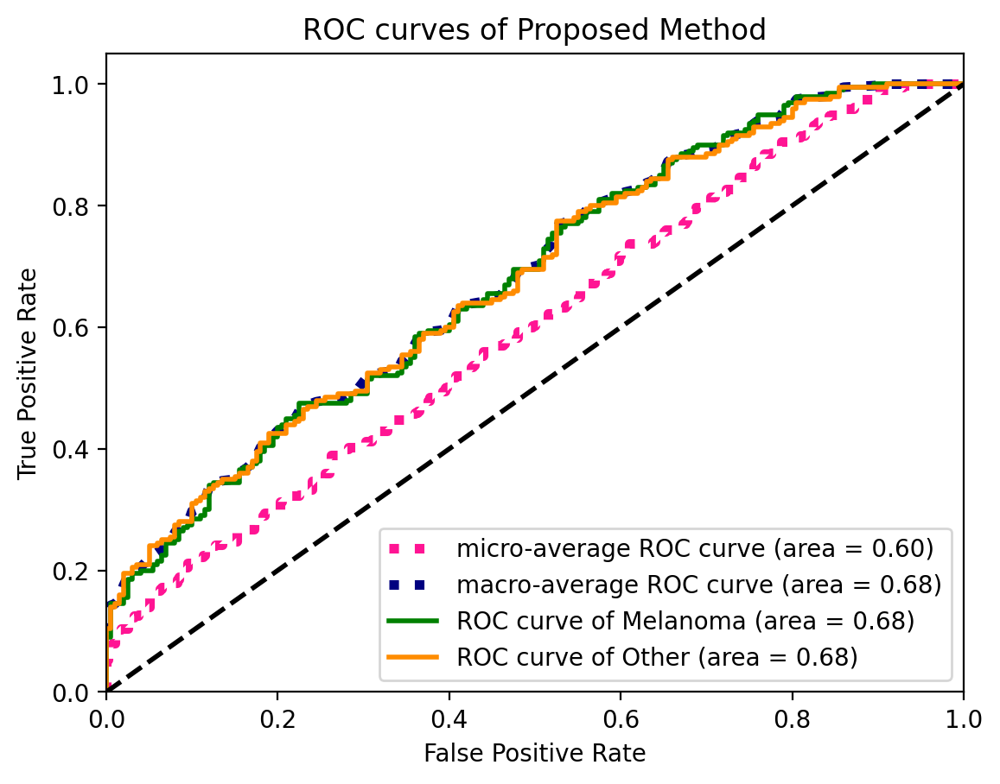

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Melanoma (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Other (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[ 25 175]
 [  1 199]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


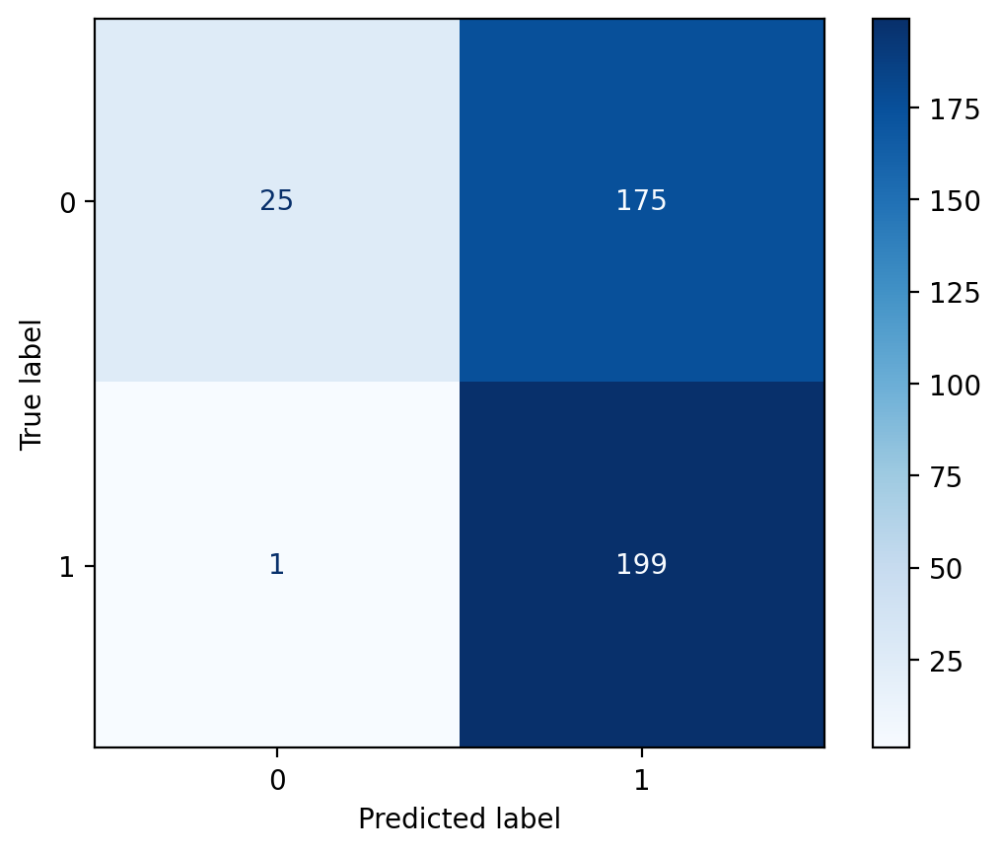

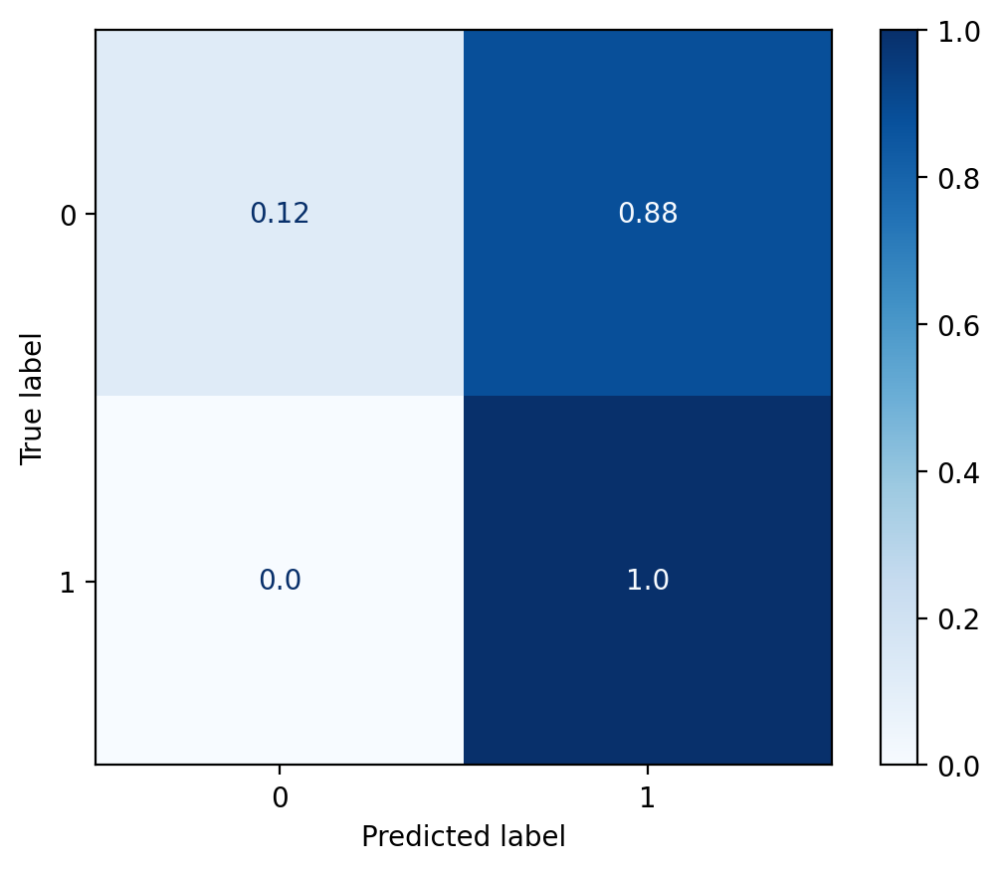

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.96, Recall: 0.12, F1_score: 0.22, Specificity: 0.99


##### RMSprop Optimizer

###### RMSprop Optimizer and lr = 0.01

Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-2

params = [
          {'params': model.features.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.classifier.parameters()}
         ]

optimizer = optim.RMSprop(params, lr=FOUND_LR)

In [ ]:
def calculate_accuracy(y_pred, y):
    top_pred = y_pred.argmax(1, keepdim=True)
    correct = top_pred.eq(y.view_as(top_pred)).sum()
    acc = correct.float() / y.shape[0]
    return acc

In [ ]:
def train(model, iterator, optimizer, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.train()

    for (x, y) in tqdm(iterator, desc="Training", leave=False):

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc = calculate_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc = calculate_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in tqdm(iterator):

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim=-1)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim=0)
    labels = torch.cat(labels, dim=0)
    probs = torch.cat(probs, dim=0)

    return images, labels, probs

In [ ]:
EPOCHS = 30

# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_accs = []
valid_accs = []

best_valid_acc = 0  # Track the best validation top-1 accuracy
best_train_acc = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')

for epoch in trange(EPOCHS, desc="Epochs"):

    start_time = time.monotonic()

    train_loss, train_acc = train(model, train_iter, optimizer, criterion, device)
    valid_loss, valid_acc = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_accs.append(train_acc)
    valid_accs.append(valid_acc)


    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc > best_valid_acc:
        best_valid_acc = valid_acc
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
    print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')

Epochs:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 20s
	Train Loss: 474550.264 | Train Acc: 49.58%
	 Val. Loss: 2027.068 |  Val. Acc: 53.12%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 14s
	Train Loss: 3697.742 | Train Acc: 48.56%
	 Val. Loss: 1705.996 |  Val. Acc: 51.56%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 14s
	Train Loss: 1821.071 | Train Acc: 49.07%
	 Val. Loss: 248.957 |  Val. Acc: 45.57%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 13s
	Train Loss: 597.575 | Train Acc: 48.48%
	 Val. Loss: 714.243 |  Val. Acc: 53.65%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 16s
	Train Loss: 527.456 | Train Acc: 53.38%
	 Val. Loss: 252.395 |  Val. Acc: 44.27%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 13s
	Train Loss: 255.929 | Train Acc: 51.35%
	 Val. Loss: 141.828 |  Val. Acc: 53.39%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 13s
	Train Loss: 200.492 | Train Acc: 51.86%
	 Val. Loss: 80.845 |  Val. Acc: 46.09%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 13s
	Train Loss: 142.755 | Train Acc: 49.41%
	 Val. Loss: 45.555 |  Val. Acc: 53.65%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 13s
	Train Loss: 171.742 | Train Acc: 51.44%
	 Val. Loss: 172.813 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 13s
	Train Loss: 172.816 | Train Acc: 47.64%
	 Val. Loss: 54.065 |  Val. Acc: 48.70%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 13s
	Train Loss: 90.372 | Train Acc: 49.83%
	 Val. Loss: 37.488 |  Val. Acc: 54.17%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 13s
	Train Loss: 77.781 | Train Acc: 51.60%
	 Val. Loss: 20.031 |  Val. Acc: 51.82%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 13s
	Train Loss: 87.801 | Train Acc: 50.00%
	 Val. Loss: 10.284 |  Val. Acc: 49.22%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 13s
	Train Loss: 67.242 | Train Acc: 50.08%
	 Val. Loss: 9.740 |  Val. Acc: 51.30%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 13s
	Train Loss: 171.290 | Train Acc: 48.06%
	 Val. Loss: 7.747 |  Val. Acc: 48.44%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 16 | Epoch Time: 0m 13s
	Train Loss: 49.632 | Train Acc: 49.07%
	 Val. Loss: 5.726 |  Val. Acc: 52.34%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 17 | Epoch Time: 0m 14s
	Train Loss: 64.608 | Train Acc: 49.41%
	 Val. Loss: 12.712 |  Val. Acc: 52.34%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 18 | Epoch Time: 0m 13s
	Train Loss: 307.232 | Train Acc: 48.99%
	 Val. Loss: 54.418 |  Val. Acc: 52.60%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 19 | Epoch Time: 0m 14s
	Train Loss: 247.978 | Train Acc: 51.52%
	 Val. Loss: 21.585 |  Val. Acc: 52.34%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 20 | Epoch Time: 0m 13s
	Train Loss: 12.502 | Train Acc: 50.00%
	 Val. Loss: 1.151 |  Val. Acc: 52.34%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 21 | Epoch Time: 0m 14s
	Train Loss: 20.638 | Train Acc: 49.32%
	 Val. Loss: 0.950 |  Val. Acc: 49.22%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 22 | Epoch Time: 0m 13s
	Train Loss: 112.292 | Train Acc: 48.90%
	 Val. Loss: 9.204 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 23 | Epoch Time: 0m 13s
	Train Loss: 7.247 | Train Acc: 50.08%
	 Val. Loss: 75.509 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 24 | Epoch Time: 0m 13s
	Train Loss: 10.046 | Train Acc: 49.32%
	 Val. Loss: 0.730 |  Val. Acc: 48.96%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 25 | Epoch Time: 0m 13s
	Train Loss: 33.604 | Train Acc: 50.68%
	 Val. Loss: 28.380 |  Val. Acc: 48.18%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 26 | Epoch Time: 0m 13s
	Train Loss: 9.452 | Train Acc: 50.25%
	 Val. Loss: 0.705 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 27 | Epoch Time: 0m 13s
	Train Loss: 1.088 | Train Acc: 51.94%
	 Val. Loss: 0.692 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 28 | Epoch Time: 0m 13s
	Train Loss: 0.739 | Train Acc: 52.28%
	 Val. Loss: 0.709 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 29 | Epoch Time: 0m 13s
	Train Loss: 0.751 | Train Acc: 50.93%
	 Val. Loss: 0.697 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 30 | Epoch Time: 0m 14s
	Train Loss: 1.350 | Train Acc: 49.75%
	 Val. Loss: 0.696 |  Val. Acc: 47.92%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc * 100))

Lowest valid_loss: 69.22%
Best valid_Acc: 54.17%
Lowest train_loss: 73.94%
Best train_Acc: 53.38%


Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.01 - Train and Valid Loss Plot')

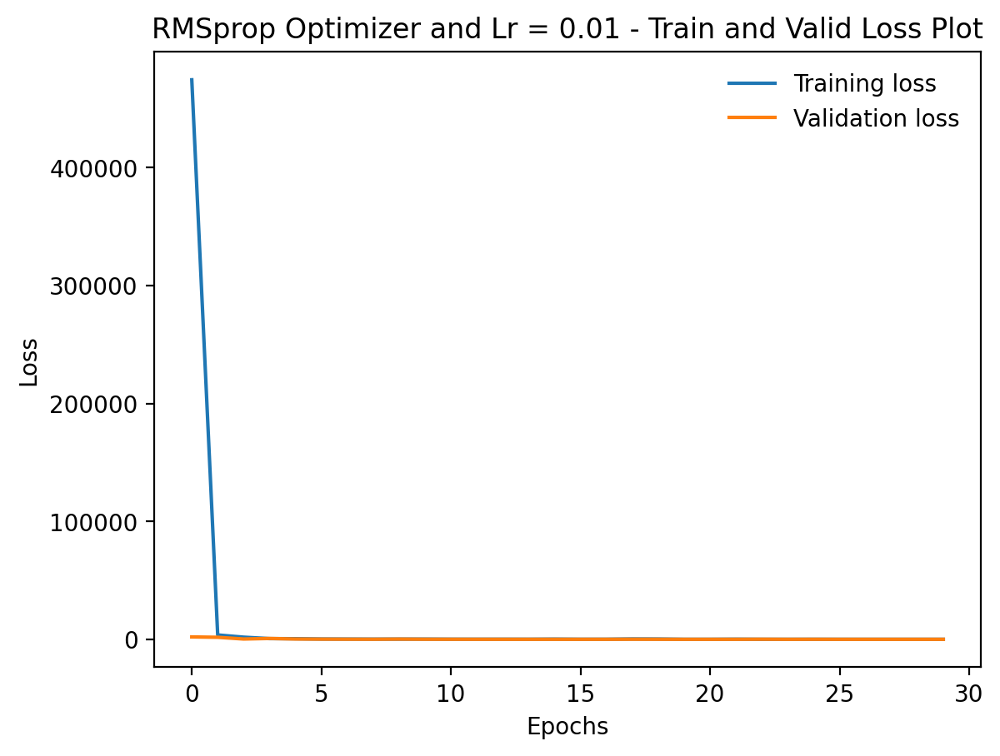

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.01 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.01 - Train and Valid Accuracy Plot')

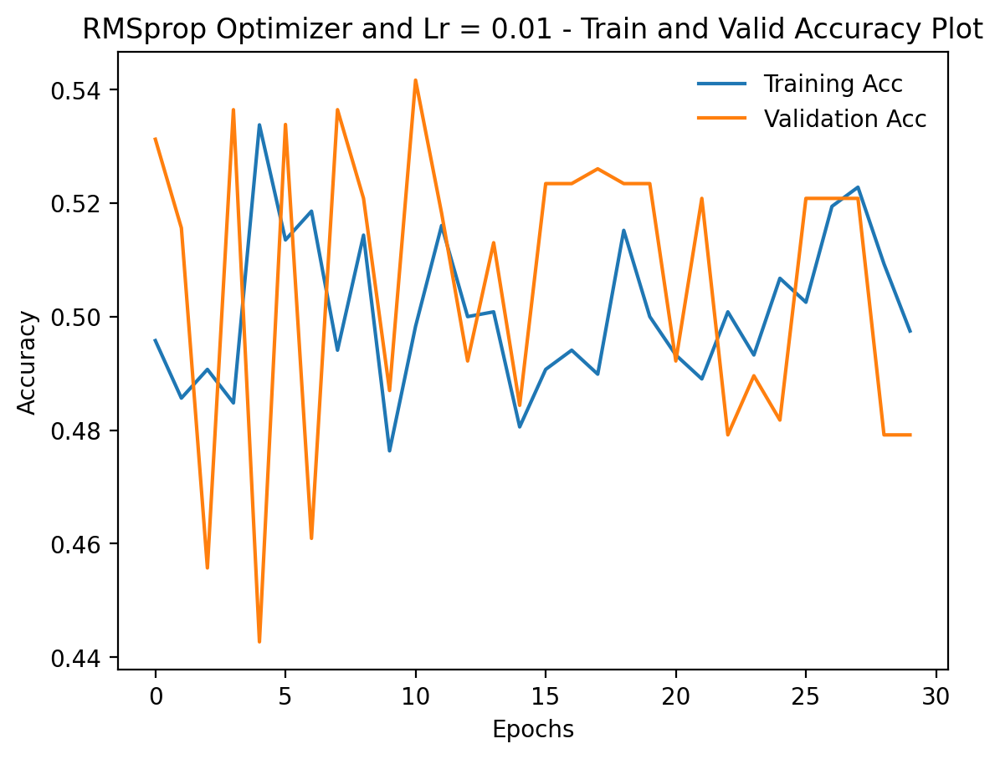

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_accs, label='Training Acc')
plt.plot(valid_accs, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.01 - Train and Valid Accuracy Plot")

TODO: You can load the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

  0%|          | 0/13 [00:00<?, ?it/s]

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

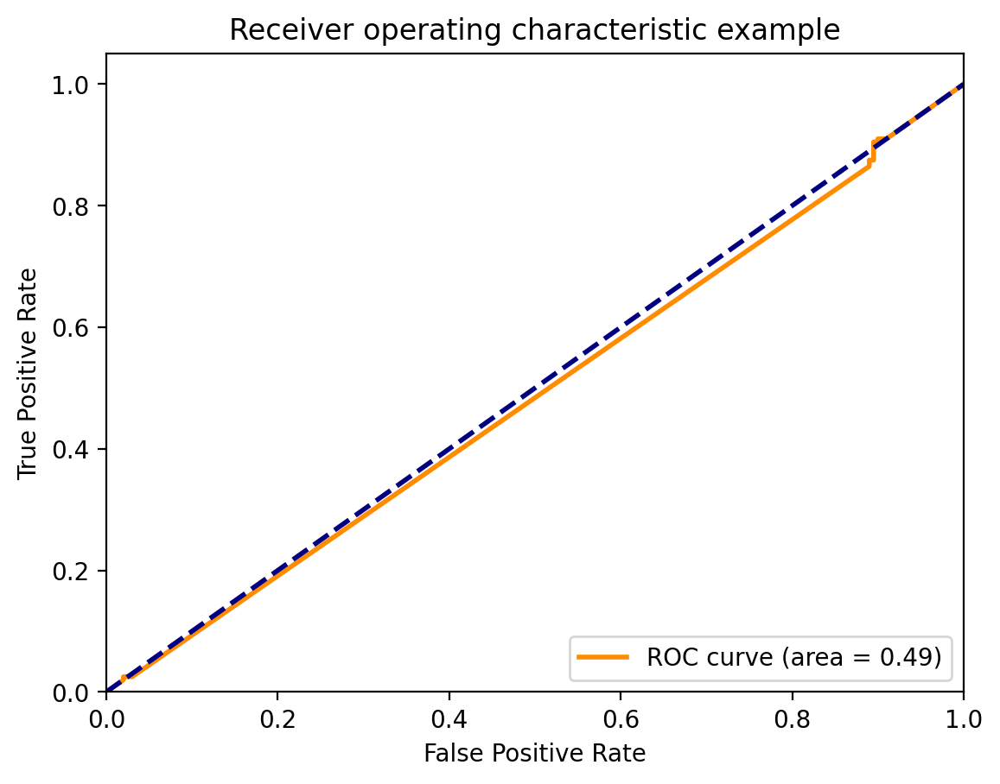

<ipython-input-391-090c2baad2d4>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


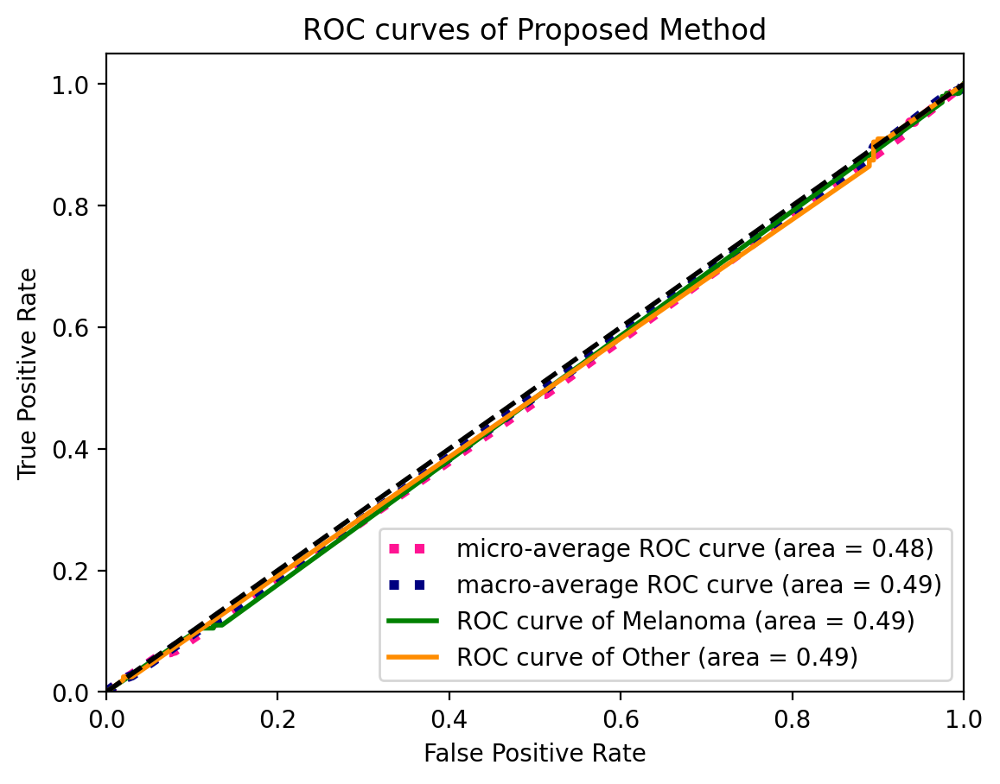

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Melanoma (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Other (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[ 22 178]
 [ 26 174]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


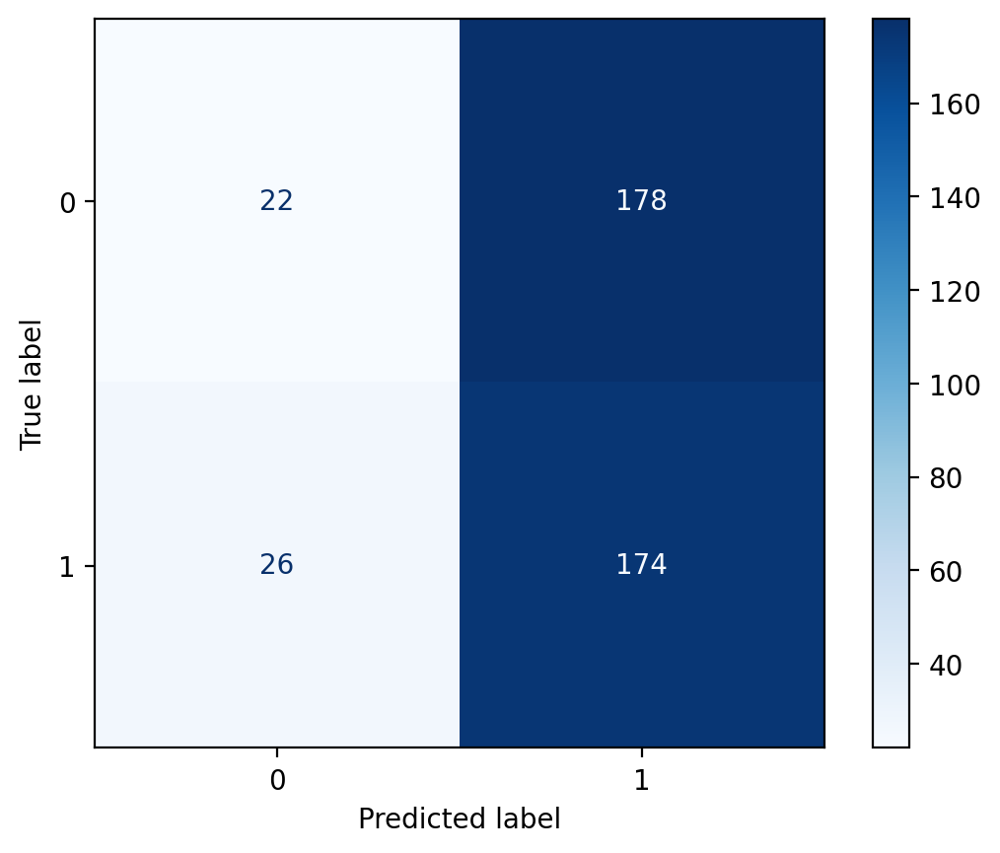

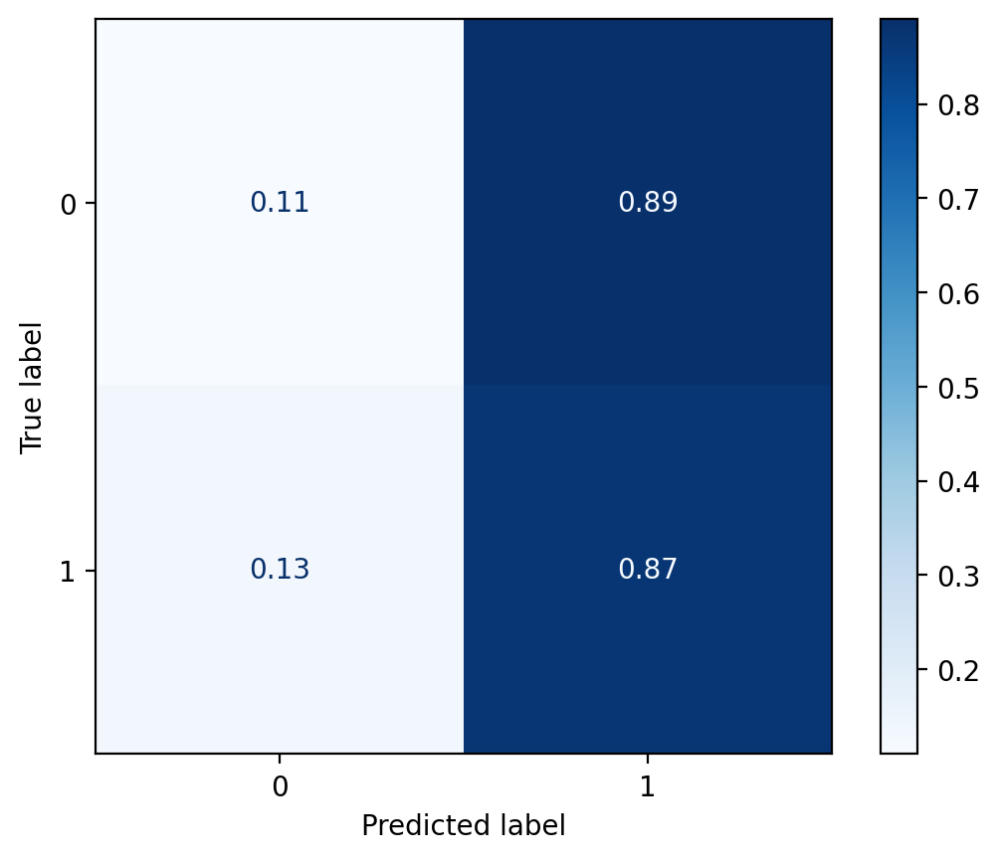

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.46, Recall: 0.11, F1_score: 0.18, Specificity: 0.87


###### RMSprop Optimizer and lr = 0.001

In [ ]:
vgg16_layers = get_vgg_layers(vgg16_config, batch_norm=True)
#print(vgg11_layers)

OUTPUT_DIM = 2

model = VGG(vgg16_layers, OUTPUT_DIM)
#print(model)
pretrained_model = models.vgg16_bn(pretrained=True)
#print(pretrained_model)
IN_FEATURES = pretrained_model.classifier[-1].in_features

final_fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 134,277,186 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-3

params = [
          {'params': model.features.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.classifier.parameters()}
         ]

optimizer = optim.RMSprop(params, lr=FOUND_LR)

In [ ]:
def calculate_accuracy(y_pred, y):
    top_pred = y_pred.argmax(1, keepdim=True)
    correct = top_pred.eq(y.view_as(top_pred)).sum()
    acc = correct.float() / y.shape[0]
    return acc

In [ ]:
def train(model, iterator, optimizer, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.train()

    for (x, y) in tqdm(iterator, desc="Training", leave=False):

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc = calculate_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc = calculate_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in tqdm(iterator):

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim=-1)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim=0)
    labels = torch.cat(labels, dim=0)
    probs = torch.cat(probs, dim=0)

    return images, labels, probs

In [ ]:
EPOCHS = 30

# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_accs = []
valid_accs = []

best_valid_acc = 0  # Track the best validation top-1 accuracy
best_train_acc = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')

for epoch in trange(EPOCHS, desc="Epochs"):

    start_time = time.monotonic()

    train_loss, train_acc = train(model, train_iter, optimizer, criterion, device)
    valid_loss, valid_acc = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_accs.append(train_acc)
    valid_accs.append(valid_acc)


    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc > best_valid_acc:
        best_valid_acc = valid_acc
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
    print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')

Epochs:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 16s
	Train Loss: 864.485 | Train Acc: 51.10%
	 Val. Loss: 15.293 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 14s
	Train Loss: 47.829 | Train Acc: 48.23%
	 Val. Loss: 15.867 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 14s
	Train Loss: 10.267 | Train Acc: 50.17%
	 Val. Loss: 1.814 |  Val. Acc: 52.34%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 14s
	Train Loss: 5.120 | Train Acc: 48.99%
	 Val. Loss: 0.834 |  Val. Acc: 48.44%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 18s
	Train Loss: 2.148 | Train Acc: 52.79%
	 Val. Loss: 0.869 |  Val. Acc: 47.66%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 13s
	Train Loss: 1.323 | Train Acc: 50.51%
	 Val. Loss: 0.750 |  Val. Acc: 51.56%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 14s
	Train Loss: 1.014 | Train Acc: 48.65%
	 Val. Loss: 0.869 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 14s
	Train Loss: 0.853 | Train Acc: 48.40%
	 Val. Loss: 0.751 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 14s
	Train Loss: 0.783 | Train Acc: 49.92%
	 Val. Loss: 0.706 |  Val. Acc: 48.18%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 13s
	Train Loss: 0.726 | Train Acc: 49.58%
	 Val. Loss: 0.723 |  Val. Acc: 46.88%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 13s
	Train Loss: 0.762 | Train Acc: 51.10%
	 Val. Loss: 0.697 |  Val. Acc: 48.96%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 13s
	Train Loss: 0.894 | Train Acc: 50.68%
	 Val. Loss: 0.704 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 14s
	Train Loss: 0.738 | Train Acc: 50.00%
	 Val. Loss: 0.700 |  Val. Acc: 51.04%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 14s
	Train Loss: 0.720 | Train Acc: 50.76%
	 Val. Loss: 0.697 |  Val. Acc: 53.12%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 13s
	Train Loss: 0.742 | Train Acc: 49.83%
	 Val. Loss: 0.692 |  Val. Acc: 51.56%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 16 | Epoch Time: 0m 13s
	Train Loss: 0.715 | Train Acc: 50.25%
	 Val. Loss: 0.691 |  Val. Acc: 53.12%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 17 | Epoch Time: 0m 14s
	Train Loss: 0.735 | Train Acc: 49.49%
	 Val. Loss: 0.694 |  Val. Acc: 47.66%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 18 | Epoch Time: 0m 14s
	Train Loss: 0.700 | Train Acc: 47.38%
	 Val. Loss: 0.693 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 19 | Epoch Time: 0m 13s
	Train Loss: 0.714 | Train Acc: 50.84%
	 Val. Loss: 0.692 |  Val. Acc: 52.34%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 20 | Epoch Time: 0m 13s
	Train Loss: 0.698 | Train Acc: 49.83%
	 Val. Loss: 0.694 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 21 | Epoch Time: 0m 13s
	Train Loss: 0.695 | Train Acc: 50.00%
	 Val. Loss: 0.695 |  Val. Acc: 51.82%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 22 | Epoch Time: 0m 13s
	Train Loss: 0.696 | Train Acc: 47.64%
	 Val. Loss: 0.693 |  Val. Acc: 51.82%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 23 | Epoch Time: 0m 13s
	Train Loss: 0.702 | Train Acc: 48.31%
	 Val. Loss: 0.695 |  Val. Acc: 51.82%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 24 | Epoch Time: 0m 13s
	Train Loss: 0.704 | Train Acc: 47.64%
	 Val. Loss: 0.693 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 25 | Epoch Time: 0m 13s
	Train Loss: 0.703 | Train Acc: 51.10%
	 Val. Loss: 0.693 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 26 | Epoch Time: 0m 14s
	Train Loss: 0.798 | Train Acc: 48.40%
	 Val. Loss: 0.694 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 27 | Epoch Time: 0m 13s
	Train Loss: 0.863 | Train Acc: 50.08%
	 Val. Loss: 0.693 |  Val. Acc: 51.82%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 28 | Epoch Time: 0m 13s
	Train Loss: 0.719 | Train Acc: 49.83%
	 Val. Loss: 0.693 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 29 | Epoch Time: 0m 13s
	Train Loss: 0.713 | Train Acc: 50.42%
	 Val. Loss: 0.693 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 30 | Epoch Time: 0m 13s
	Train Loss: 0.702 | Train Acc: 47.97%
	 Val. Loss: 0.693 |  Val. Acc: 52.34%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc * 100))

Lowest valid_loss: 69.13%
Best valid_Acc: 53.12%
Lowest train_loss: 69.50%
Best train_Acc: 52.79%


Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.001 - Train and Valid Loss Plot')

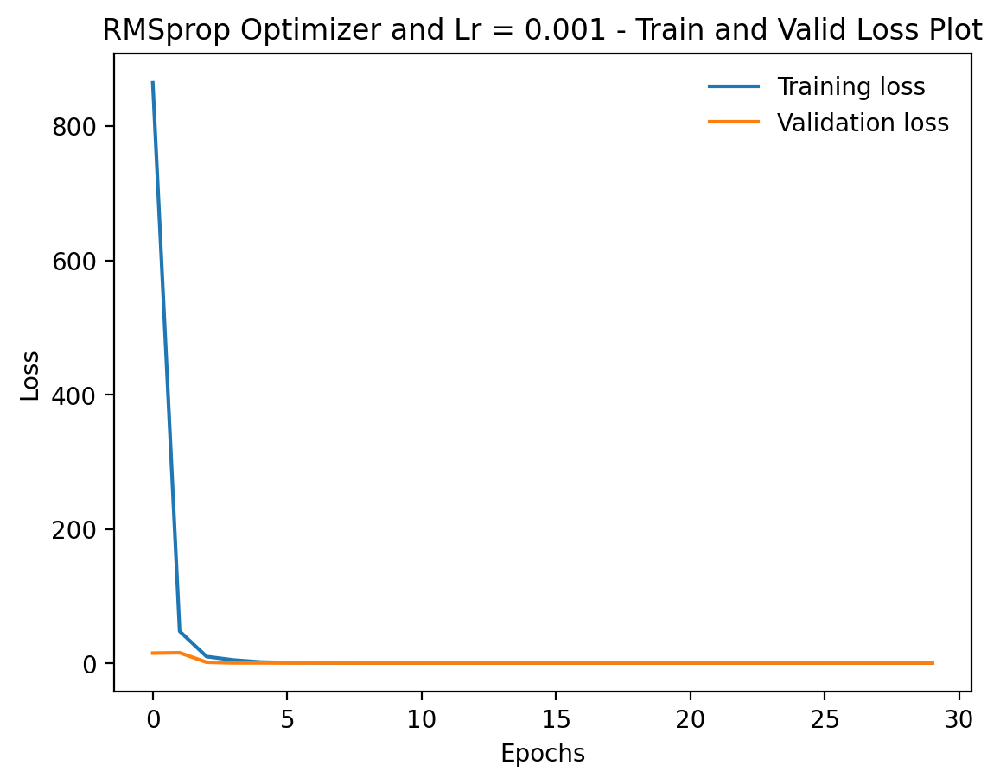

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.001 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.001 - Train and Valid Accuracy Plot')

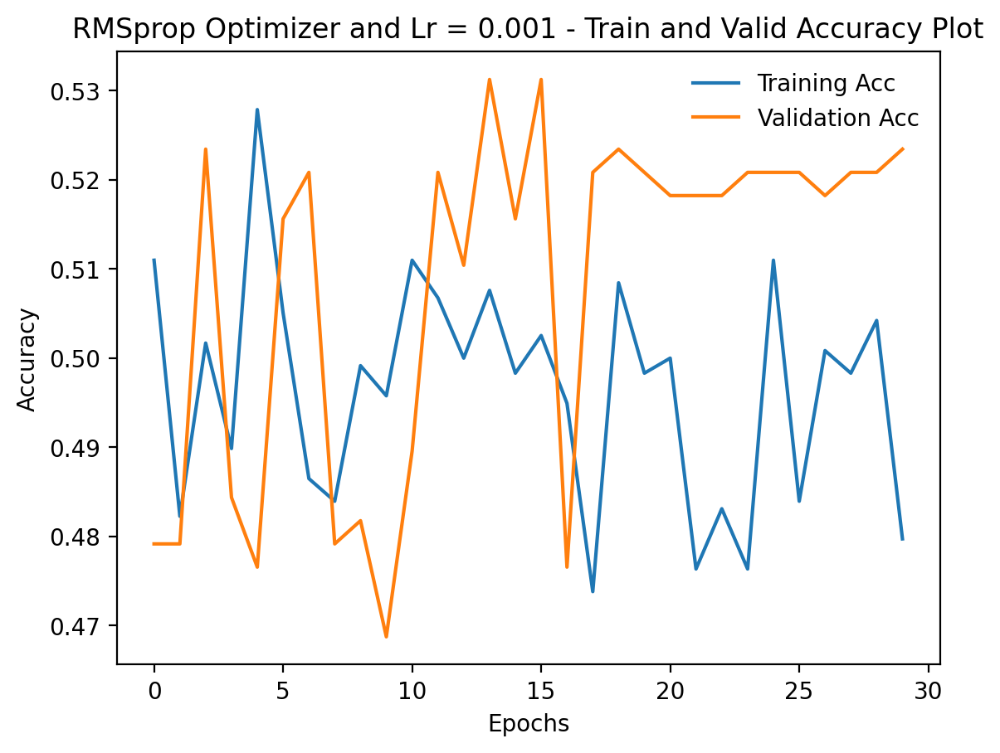

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_accs, label='Training Acc')
plt.plot(valid_accs, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.001 - Train and Valid Accuracy Plot")

TODO: You can load the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

  0%|          | 0/13 [00:00<?, ?it/s]

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

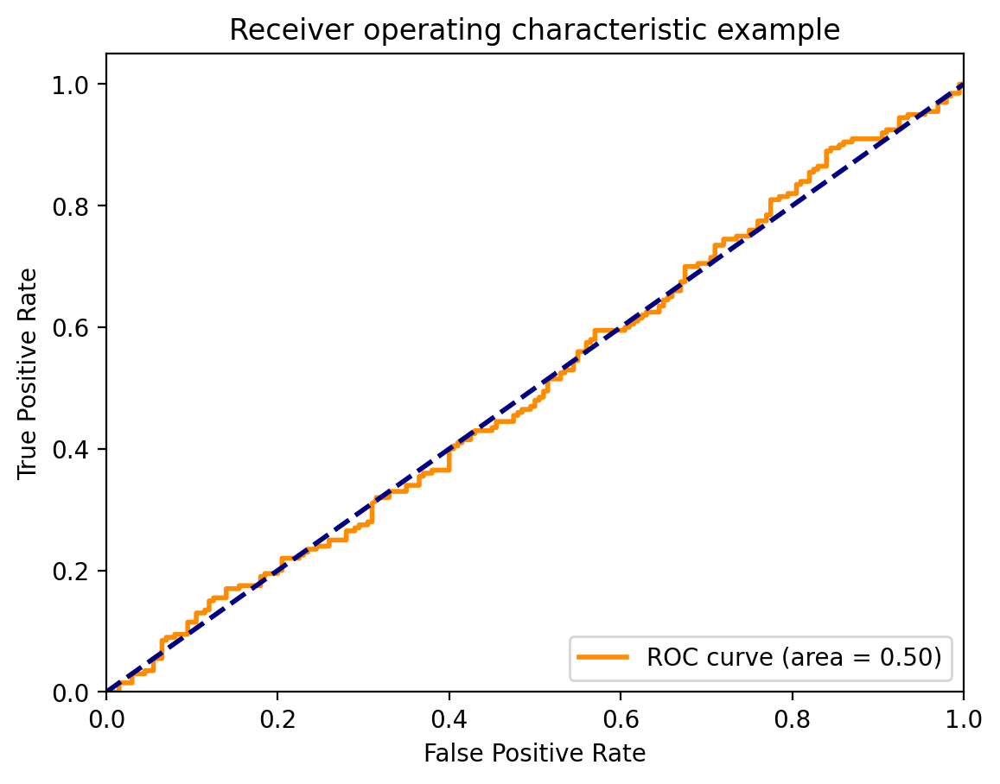

<ipython-input-408-090c2baad2d4>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


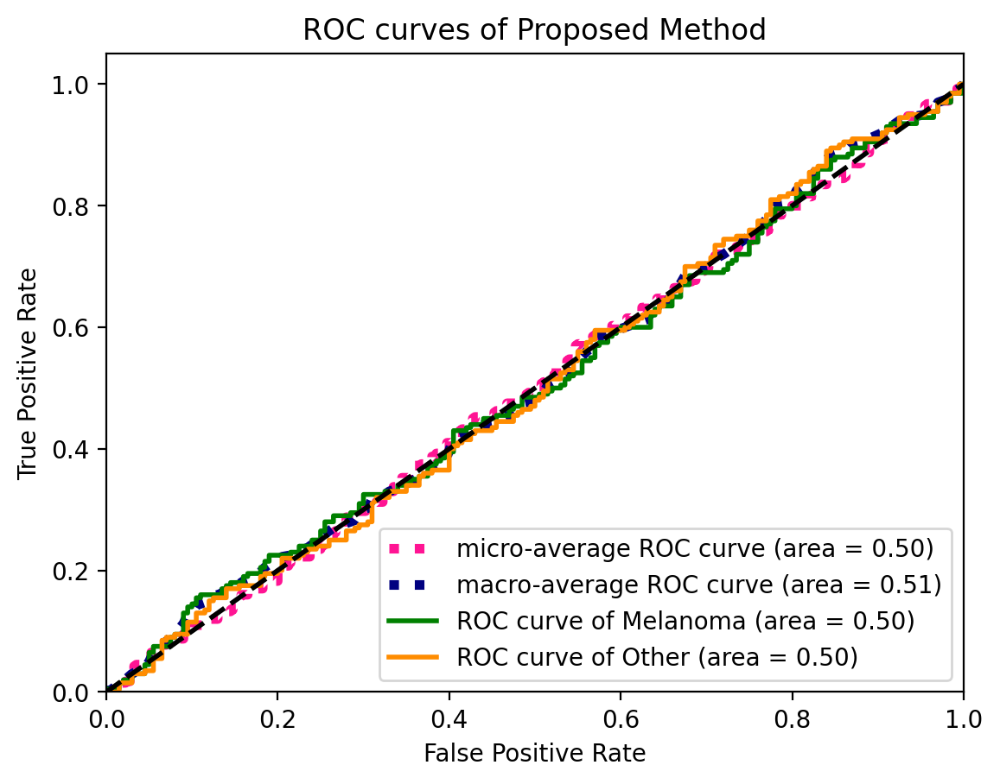

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Melanoma (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Other (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[  0 200]
 [  0 200]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


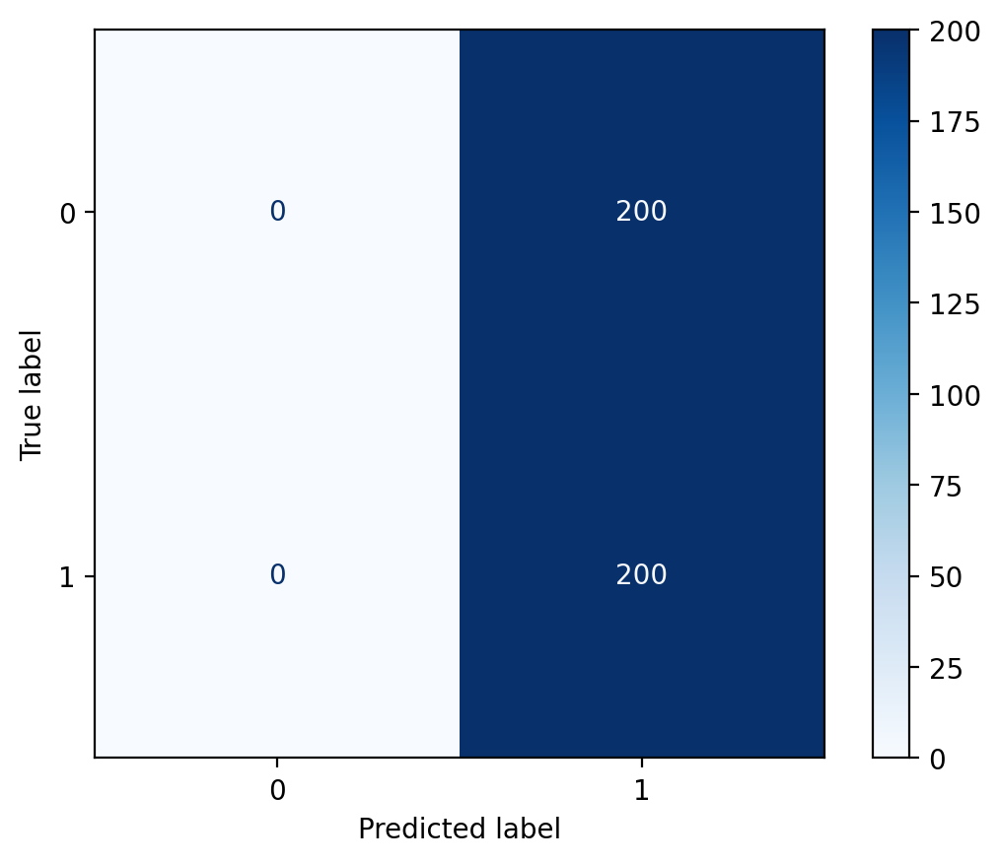

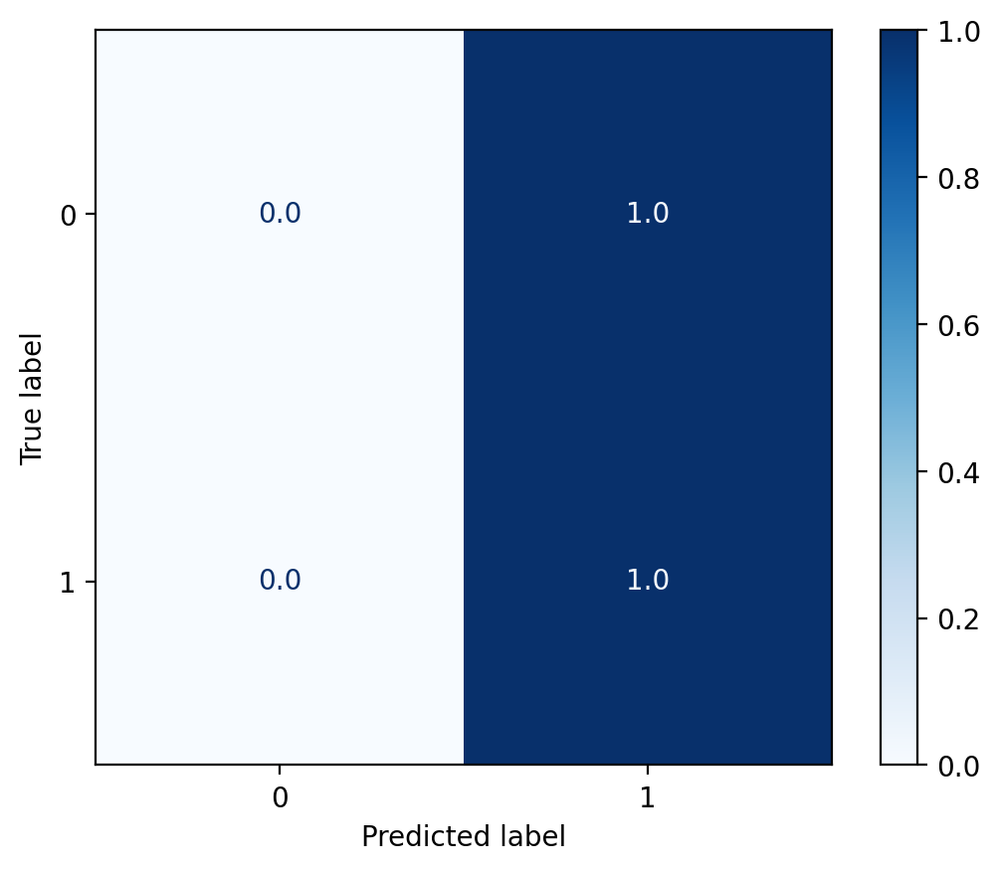

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: nan, Recall: 0.00, F1_score: nan, Specificity: 1.00


<ipython-input-410-6baead3b1659>:7: RuntimeWarning: invalid value encountered in long_scalars
  precision = tp/(tp + fp)


###### RMSprop Optimizer and lr = 0.0001

In [ ]:
vgg16_layers = get_vgg_layers(vgg16_config, batch_norm=True)
#print(vgg11_layers)

OUTPUT_DIM = 2

model = VGG(vgg16_layers, OUTPUT_DIM)
#print(model)
pretrained_model = models.vgg16_bn(pretrained=True)
#print(pretrained_model)
IN_FEATURES = pretrained_model.classifier[-1].in_features

final_fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 134,277,186 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 1e-4

params = [
          {'params': model.features.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.classifier.parameters()}
         ]

optimizer = optim.RMSprop(params, lr=FOUND_LR)

In [ ]:
def calculate_accuracy(y_pred, y):
    top_pred = y_pred.argmax(1, keepdim=True)
    correct = top_pred.eq(y.view_as(top_pred)).sum()
    acc = correct.float() / y.shape[0]
    return acc

In [ ]:
def train(model, iterator, optimizer, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.train()

    for (x, y) in tqdm(iterator, desc="Training", leave=False):

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc = calculate_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc = calculate_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in tqdm(iterator):

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim=-1)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim=0)
    labels = torch.cat(labels, dim=0)
    probs = torch.cat(probs, dim=0)

    return images, labels, probs

In [ ]:
EPOCHS = 30

# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_accs = []
valid_accs = []

best_valid_acc = 0  # Track the best validation top-1 accuracy
best_train_acc = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')

for epoch in trange(EPOCHS, desc="Epochs"):

    start_time = time.monotonic()

    train_loss, train_acc = train(model, train_iter, optimizer, criterion, device)
    valid_loss, valid_acc = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_accs.append(train_acc)
    valid_accs.append(valid_acc)


    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc > best_valid_acc:
        best_valid_acc = valid_acc
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
    print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')

Epochs:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 16s
	Train Loss: 6.889 | Train Acc: 50.17%
	 Val. Loss: 0.708 |  Val. Acc: 51.30%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 20s
	Train Loss: 0.895 | Train Acc: 50.59%
	 Val. Loss: 0.673 |  Val. Acc: 59.38%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 14s
	Train Loss: 0.812 | Train Acc: 48.90%
	 Val. Loss: 0.687 |  Val. Acc: 64.58%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 16s
	Train Loss: 0.767 | Train Acc: 50.76%
	 Val. Loss: 0.659 |  Val. Acc: 60.68%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 16s
	Train Loss: 0.779 | Train Acc: 52.62%
	 Val. Loss: 0.860 |  Val. Acc: 45.05%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 14s
	Train Loss: 0.736 | Train Acc: 52.03%
	 Val. Loss: 0.730 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 13s
	Train Loss: 0.754 | Train Acc: 48.31%
	 Val. Loss: 0.707 |  Val. Acc: 62.76%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 16s
	Train Loss: 0.721 | Train Acc: 52.96%
	 Val. Loss: 0.725 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 14s
	Train Loss: 0.724 | Train Acc: 51.52%
	 Val. Loss: 0.652 |  Val. Acc: 61.98%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 14s
	Train Loss: 0.714 | Train Acc: 50.51%
	 Val. Loss: 0.698 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 14s
	Train Loss: 0.724 | Train Acc: 47.89%
	 Val. Loss: 0.704 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 14s
	Train Loss: 0.719 | Train Acc: 51.44%
	 Val. Loss: 0.712 |  Val. Acc: 51.56%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 13s
	Train Loss: 0.709 | Train Acc: 51.86%
	 Val. Loss: 0.678 |  Val. Acc: 56.51%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 14s
	Train Loss: 0.708 | Train Acc: 52.53%
	 Val. Loss: 0.700 |  Val. Acc: 51.30%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 16s
	Train Loss: 0.695 | Train Acc: 54.81%
	 Val. Loss: 0.683 |  Val. Acc: 57.55%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 16 | Epoch Time: 0m 16s
	Train Loss: 0.700 | Train Acc: 55.24%
	 Val. Loss: 0.706 |  Val. Acc: 51.56%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 17 | Epoch Time: 0m 16s
	Train Loss: 0.682 | Train Acc: 58.45%
	 Val. Loss: 0.742 |  Val. Acc: 48.18%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 18 | Epoch Time: 0m 14s
	Train Loss: 0.685 | Train Acc: 57.94%
	 Val. Loss: 0.763 |  Val. Acc: 50.00%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 19 | Epoch Time: 0m 14s
	Train Loss: 0.683 | Train Acc: 56.59%
	 Val. Loss: 0.712 |  Val. Acc: 49.22%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 20 | Epoch Time: 0m 16s
	Train Loss: 0.669 | Train Acc: 60.81%
	 Val. Loss: 0.765 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 21 | Epoch Time: 0m 14s
	Train Loss: 0.678 | Train Acc: 58.53%
	 Val. Loss: 0.789 |  Val. Acc: 52.08%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 22 | Epoch Time: 0m 14s
	Train Loss: 0.671 | Train Acc: 60.39%
	 Val. Loss: 0.617 |  Val. Acc: 66.67%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 23 | Epoch Time: 0m 14s
	Train Loss: 0.679 | Train Acc: 58.02%
	 Val. Loss: 0.638 |  Val. Acc: 65.62%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 24 | Epoch Time: 0m 20s
	Train Loss: 0.660 | Train Acc: 61.74%
	 Val. Loss: 0.661 |  Val. Acc: 59.38%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 25 | Epoch Time: 0m 14s
	Train Loss: 0.656 | Train Acc: 59.71%
	 Val. Loss: 0.647 |  Val. Acc: 65.36%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 26 | Epoch Time: 0m 14s
	Train Loss: 0.661 | Train Acc: 60.22%
	 Val. Loss: 0.669 |  Val. Acc: 59.38%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 27 | Epoch Time: 0m 16s
	Train Loss: 0.640 | Train Acc: 62.50%
	 Val. Loss: 0.637 |  Val. Acc: 65.36%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 28 | Epoch Time: 0m 14s
	Train Loss: 0.653 | Train Acc: 61.82%
	 Val. Loss: 0.663 |  Val. Acc: 63.28%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 29 | Epoch Time: 0m 16s
	Train Loss: 0.642 | Train Acc: 63.09%
	 Val. Loss: 0.662 |  Val. Acc: 66.67%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 30 | Epoch Time: 0m 14s
	Train Loss: 0.655 | Train Acc: 61.49%
	 Val. Loss: 0.631 |  Val. Acc: 64.58%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc * 100))

Lowest valid_loss: 61.67%
Best valid_Acc: 66.67%
Lowest train_loss: 64.02%
Best train_Acc: 63.09%


Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.0001 - Train and Valid Loss Plot')

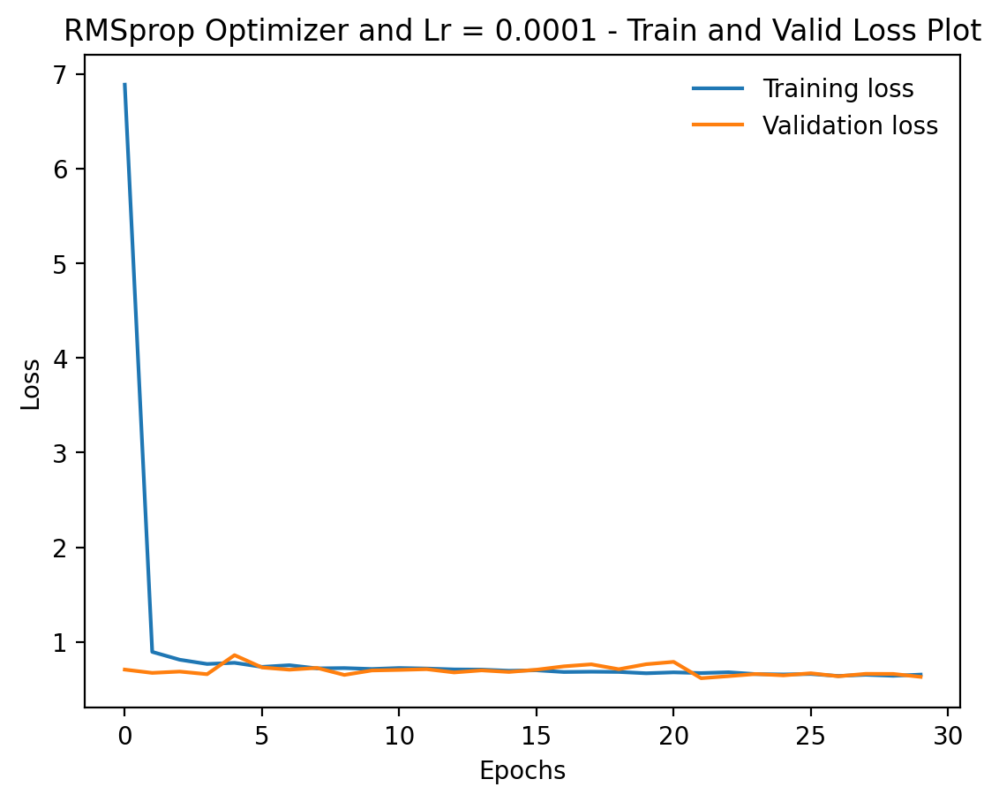

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.0001 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.0001 - Train and Valid Accuracy Plot')

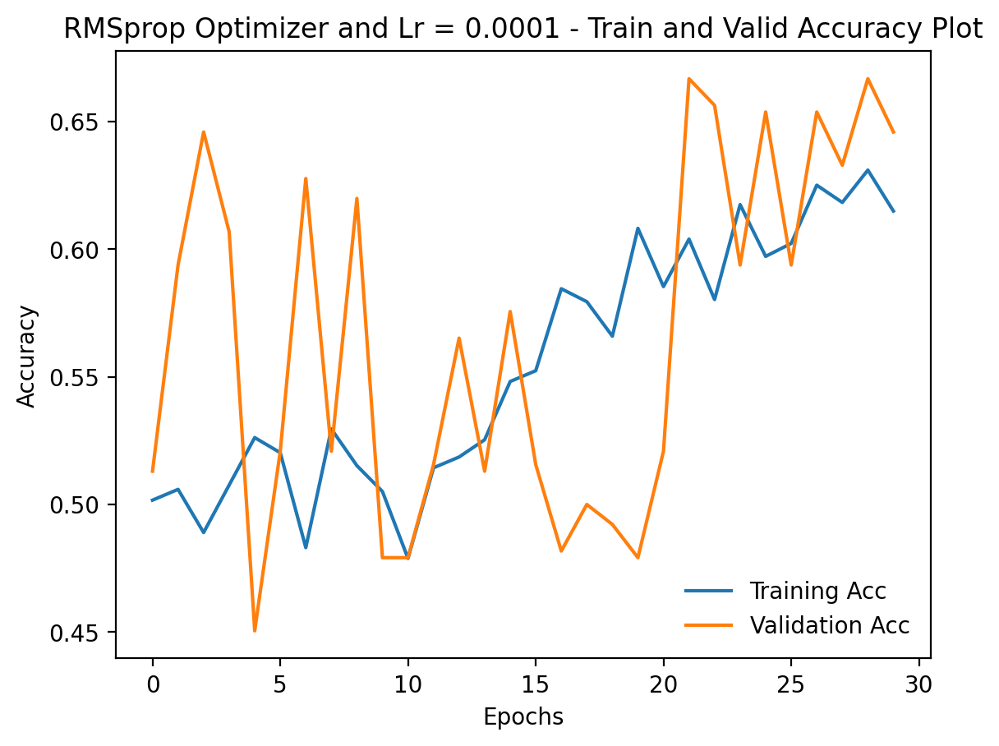

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_accs, label='Training Acc')
plt.plot(valid_accs, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.0001 - Train and Valid Accuracy Plot")

TODO: You can load the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

  0%|          | 0/13 [00:00<?, ?it/s]

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

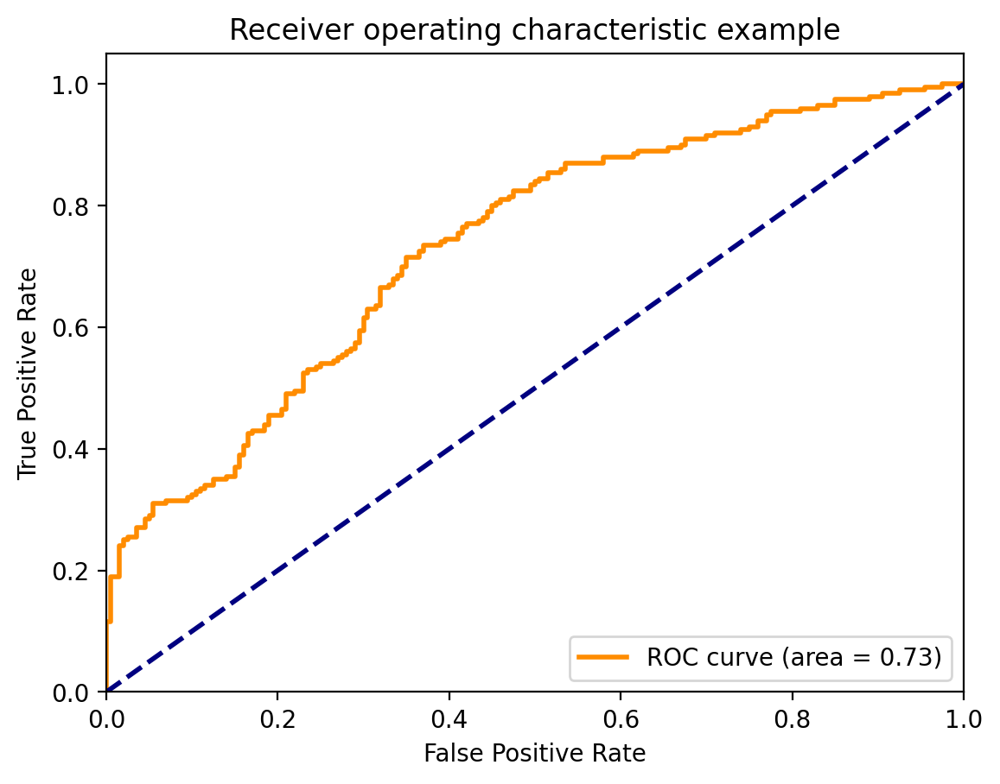

<ipython-input-425-090c2baad2d4>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


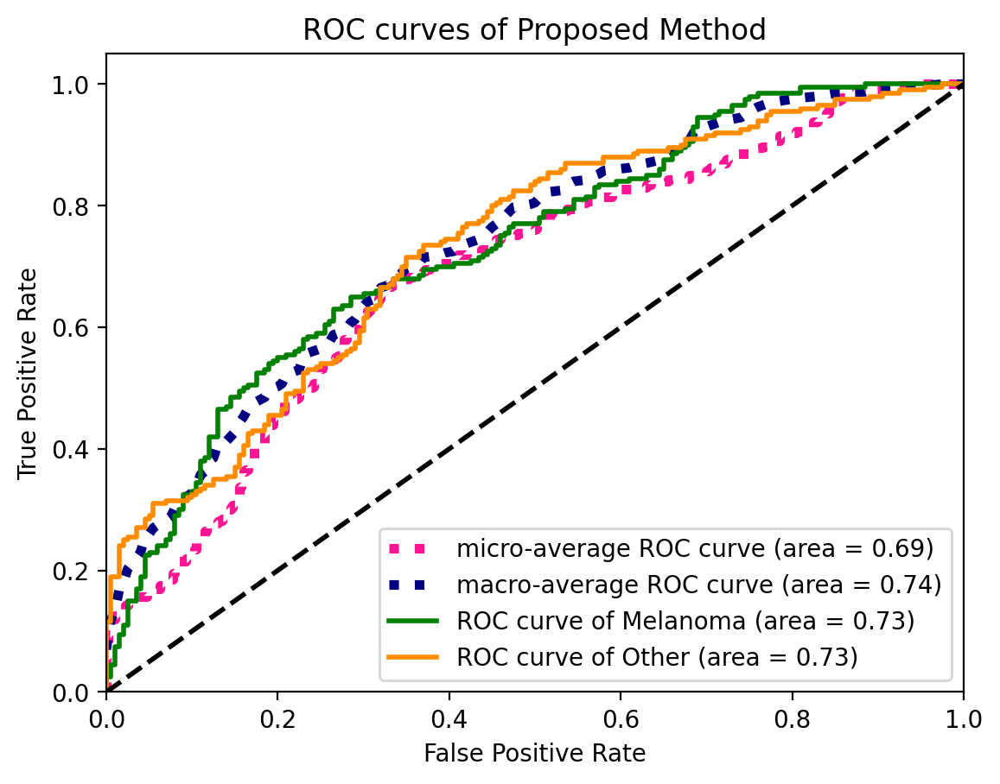

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Melanoma (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Other (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[ 97 103]
 [ 30 170]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


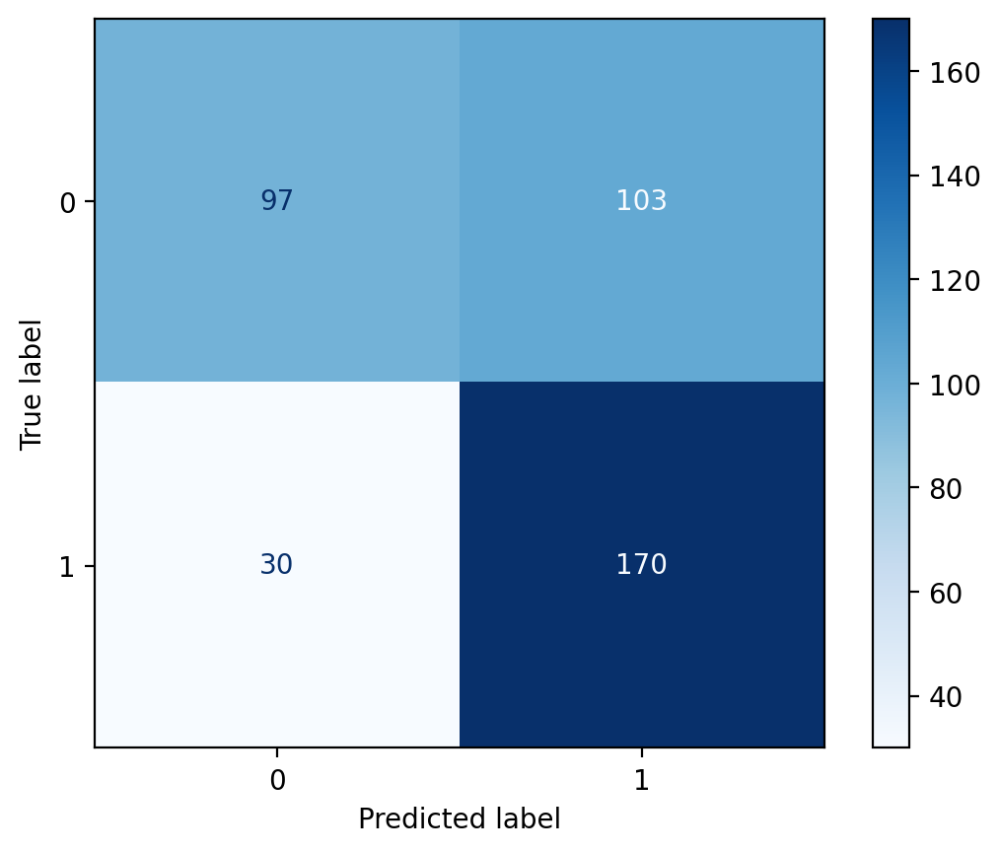

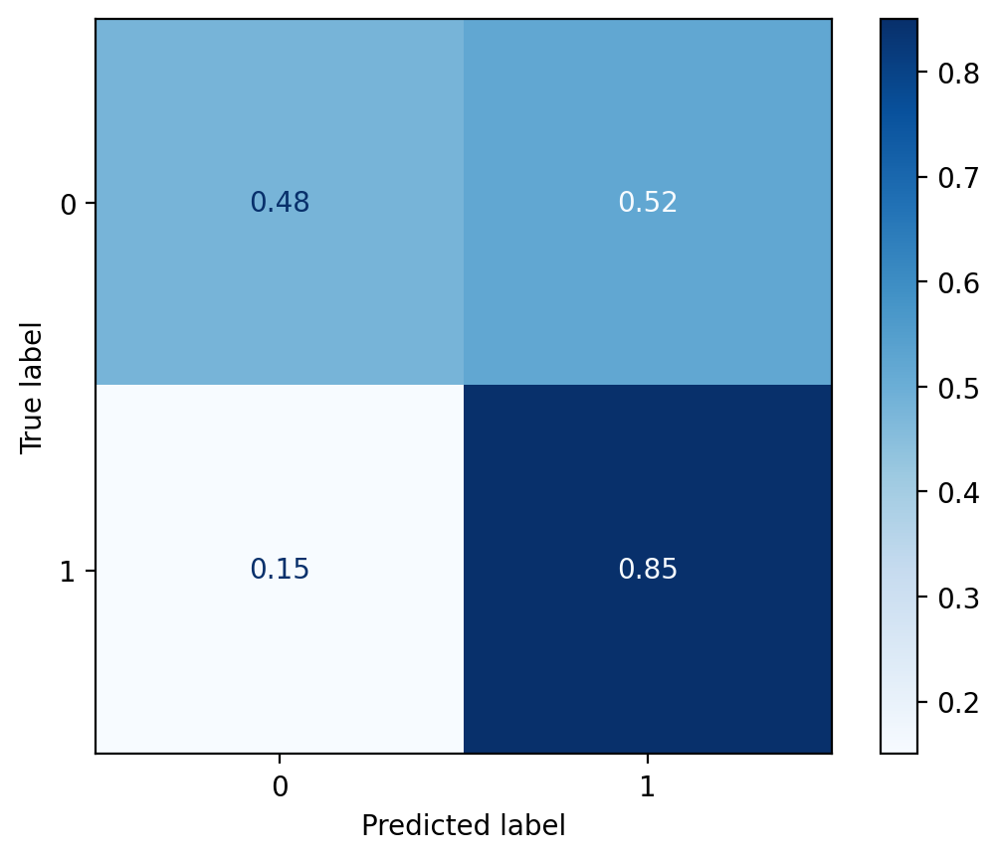

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.76, Recall: 0.48, F1_score: 0.59, Specificity: 0.85


###### RMSprop Optimizer and lr = 0.0005

In [ ]:
vgg16_layers = get_vgg_layers(vgg16_config, batch_norm=True)
#print(vgg11_layers)

OUTPUT_DIM = 2

model = VGG(vgg16_layers, OUTPUT_DIM)
#print(model)
pretrained_model = models.vgg16_bn(pretrained=True)
#print(pretrained_model)
IN_FEATURES = pretrained_model.classifier[-1].in_features

final_fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 134,277,186 trainable parameters


Setting the hyperparameters and train the model

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

FOUND_LR = 5e-4

params = [
          {'params': model.features.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.classifier.parameters()}
         ]

optimizer = optim.RMSprop(params, lr=FOUND_LR)

In [ ]:
def calculate_accuracy(y_pred, y):
    top_pred = y_pred.argmax(1, keepdim=True)
    correct = top_pred.eq(y.view_as(top_pred)).sum()
    acc = correct.float() / y.shape[0]
    return acc

In [ ]:
def train(model, iterator, optimizer, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.train()

    for (x, y) in tqdm(iterator, desc="Training", leave=False):

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc = calculate_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc = calculate_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [ ]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in tqdm(iterator):

            x = x.to(device)

            y_pred, _ = model(x)

            y_prob = F.softmax(y_pred, dim=-1)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim=0)
    labels = torch.cat(labels, dim=0)
    probs = torch.cat(probs, dim=0)

    return images, labels, probs

In [ ]:
EPOCHS = 30

# keeping-track-of-losses
train_losses = []
valid_losses = []
# keeping-track-of-accuracies
train_accs = []
valid_accs = []

best_valid_acc = 0  # Track the best validation top-1 accuracy
best_train_acc = 0  # Track the best training top-1 accuracy

best_valid_loss = float('inf')
best_train_loss = float('inf')

for epoch in trange(EPOCHS, desc="Epochs"):

    start_time = time.monotonic()

    train_loss, train_acc = train(model, train_iter, optimizer, criterion, device)
    valid_loss, valid_acc = evaluate(model, valid_iter, criterion, device)

    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_accs.append(train_acc)
    valid_accs.append(valid_acc)


    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
    if valid_acc > best_valid_acc:
        best_valid_acc = valid_acc
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(model.state_dict(), 'best-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
    print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')

Epochs:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 20s
	Train Loss: 172.626 | Train Acc: 50.42%
	 Val. Loss: 2.173 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 20s
	Train Loss: 6.739 | Train Acc: 51.18%
	 Val. Loss: 1.800 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 14s
	Train Loss: 2.919 | Train Acc: 50.93%
	 Val. Loss: 1.429 |  Val. Acc: 45.57%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 14s
	Train Loss: 3.132 | Train Acc: 49.49%
	 Val. Loss: 0.784 |  Val. Acc: 47.92%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 17s
	Train Loss: 1.518 | Train Acc: 51.44%
	 Val. Loss: 0.744 |  Val. Acc: 53.12%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 14s
	Train Loss: 1.617 | Train Acc: 50.93%
	 Val. Loss: 0.703 |  Val. Acc: 51.82%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 14s
	Train Loss: 1.222 | Train Acc: 50.00%
	 Val. Loss: 0.692 |  Val. Acc: 47.66%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 14s
	Train Loss: 1.076 | Train Acc: 49.83%
	 Val. Loss: 0.685 |  Val. Acc: 47.66%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 16s
	Train Loss: 0.964 | Train Acc: 51.94%
	 Val. Loss: 0.691 |  Val. Acc: 53.39%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 14s
	Train Loss: 0.935 | Train Acc: 50.34%
	 Val. Loss: 0.688 |  Val. Acc: 47.66%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 19s
	Train Loss: 0.814 | Train Acc: 52.03%
	 Val. Loss: 0.780 |  Val. Acc: 46.35%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 14s
	Train Loss: 0.774 | Train Acc: 47.80%
	 Val. Loss: 0.685 |  Val. Acc: 54.69%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 14s
	Train Loss: 0.752 | Train Acc: 51.35%
	 Val. Loss: 0.680 |  Val. Acc: 54.43%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 14s
	Train Loss: 0.730 | Train Acc: 48.90%
	 Val. Loss: 0.691 |  Val. Acc: 47.66%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 16s
	Train Loss: 0.754 | Train Acc: 54.65%
	 Val. Loss: 0.704 |  Val. Acc: 55.73%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 16 | Epoch Time: 0m 14s
	Train Loss: 0.764 | Train Acc: 52.03%
	 Val. Loss: 0.683 |  Val. Acc: 54.95%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 17 | Epoch Time: 0m 13s
	Train Loss: 0.734 | Train Acc: 51.52%
	 Val. Loss: 0.706 |  Val. Acc: 52.86%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 18 | Epoch Time: 0m 14s
	Train Loss: 0.694 | Train Acc: 53.46%
	 Val. Loss: 0.683 |  Val. Acc: 48.96%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 19 | Epoch Time: 0m 14s
	Train Loss: 0.743 | Train Acc: 50.00%
	 Val. Loss: 0.689 |  Val. Acc: 53.39%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 20 | Epoch Time: 0m 14s
	Train Loss: 0.732 | Train Acc: 50.84%
	 Val. Loss: 0.683 |  Val. Acc: 54.43%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 21 | Epoch Time: 0m 14s
	Train Loss: 0.711 | Train Acc: 52.53%
	 Val. Loss: 0.677 |  Val. Acc: 55.99%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 22 | Epoch Time: 0m 14s
	Train Loss: 0.687 | Train Acc: 54.05%
	 Val. Loss: 0.675 |  Val. Acc: 56.25%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 23 | Epoch Time: 0m 14s
	Train Loss: 0.708 | Train Acc: 54.39%
	 Val. Loss: 0.669 |  Val. Acc: 56.25%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 24 | Epoch Time: 0m 14s
	Train Loss: 0.702 | Train Acc: 53.80%
	 Val. Loss: 0.672 |  Val. Acc: 59.11%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 25 | Epoch Time: 0m 14s
	Train Loss: 0.694 | Train Acc: 53.29%
	 Val. Loss: 0.693 |  Val. Acc: 61.98%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 26 | Epoch Time: 0m 14s
	Train Loss: 0.693 | Train Acc: 53.72%
	 Val. Loss: 0.678 |  Val. Acc: 58.33%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 27 | Epoch Time: 0m 14s
	Train Loss: 0.688 | Train Acc: 52.87%
	 Val. Loss: 0.683 |  Val. Acc: 57.29%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 28 | Epoch Time: 0m 14s
	Train Loss: 0.707 | Train Acc: 53.04%
	 Val. Loss: 0.684 |  Val. Acc: 54.95%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 29 | Epoch Time: 0m 14s
	Train Loss: 0.680 | Train Acc: 53.29%
	 Val. Loss: 0.679 |  Val. Acc: 56.51%


Training:   0%|          | 0/37 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/12 [00:00<?, ?it/s]

Epoch: 30 | Epoch Time: 0m 13s
	Train Loss: 0.689 | Train Acc: 53.63%
	 Val. Loss: 0.670 |  Val. Acc: 55.73%


In [ ]:
# Print best results
print("Lowest valid_loss: {:.2f}%".format(best_valid_loss * 100))
print("Best valid_Acc: {:.2f}%".format(best_valid_acc * 100))
print("Lowest train_loss: {:.2f}%".format(best_train_loss * 100))
print("Best train_Acc: {:.2f}%".format(best_train_acc * 100))

Lowest valid_loss: 66.87%
Best valid_Acc: 61.98%
Lowest train_loss: 68.00%
Best train_Acc: 54.65%


Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.0005 - Train and Valid Loss Plot')

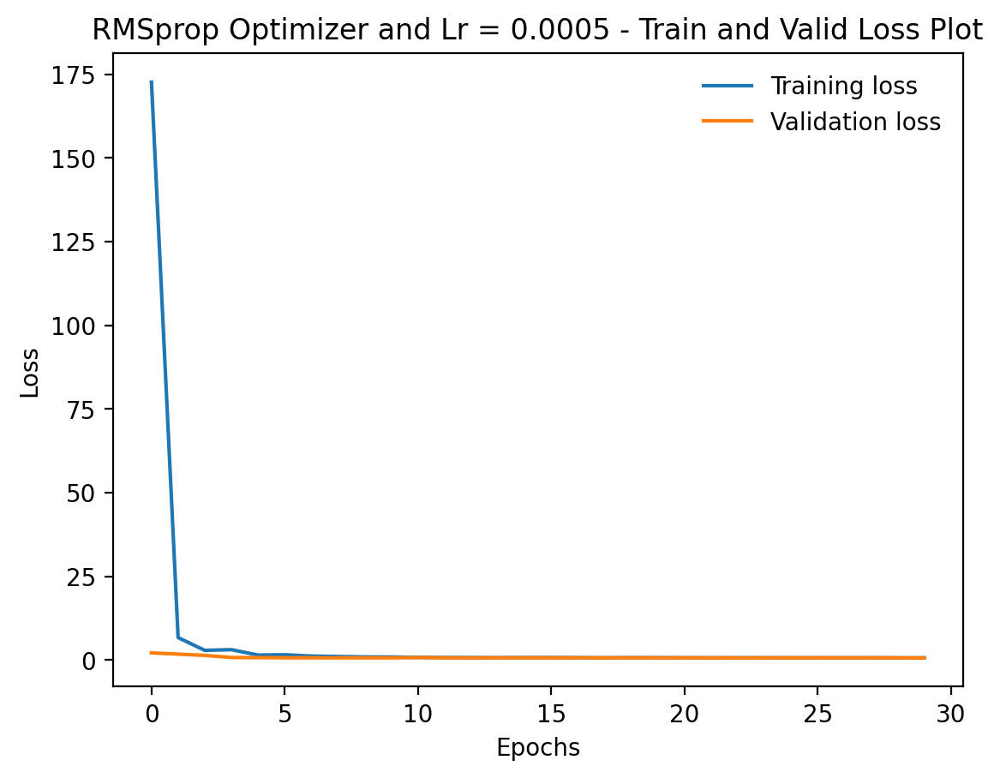

In [ ]:
# Train and Valid loss plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.0005 - Train and Valid Loss Plot")

Text(0.5, 1.0, 'RMSprop Optimizer and Lr = 0.0005 - Train and Valid Accuracy Plot')

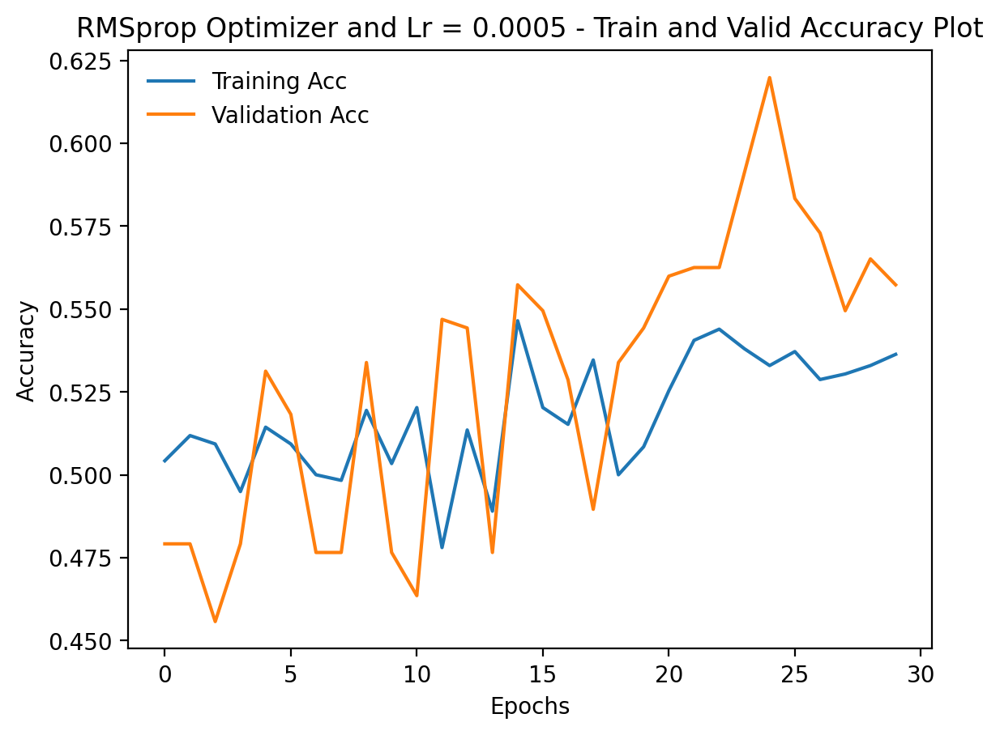

In [ ]:
# Train and Valid Accuracy plot
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.plot(train_accs, label='Training Acc')
plt.plot(valid_accs, label='Validation Acc')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(frameon=False)
plt.title("RMSprop Optimizer and Lr = 0.0005 - Train and Valid Accuracy Plot")

TODO: You can load the best model

In [ ]:
model.load_state_dict(torch.load('best-model.pt'))

<All keys matched successfully>

In [ ]:
images, labels, probs = get_predictions(model, test_iter)

  0%|          | 0/13 [00:00<?, ?it/s]

In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Dogs-vs-Cats_Split/Test_GroundTruth.csv')
y_test = np.array(test.drop(['Name'], axis=1))

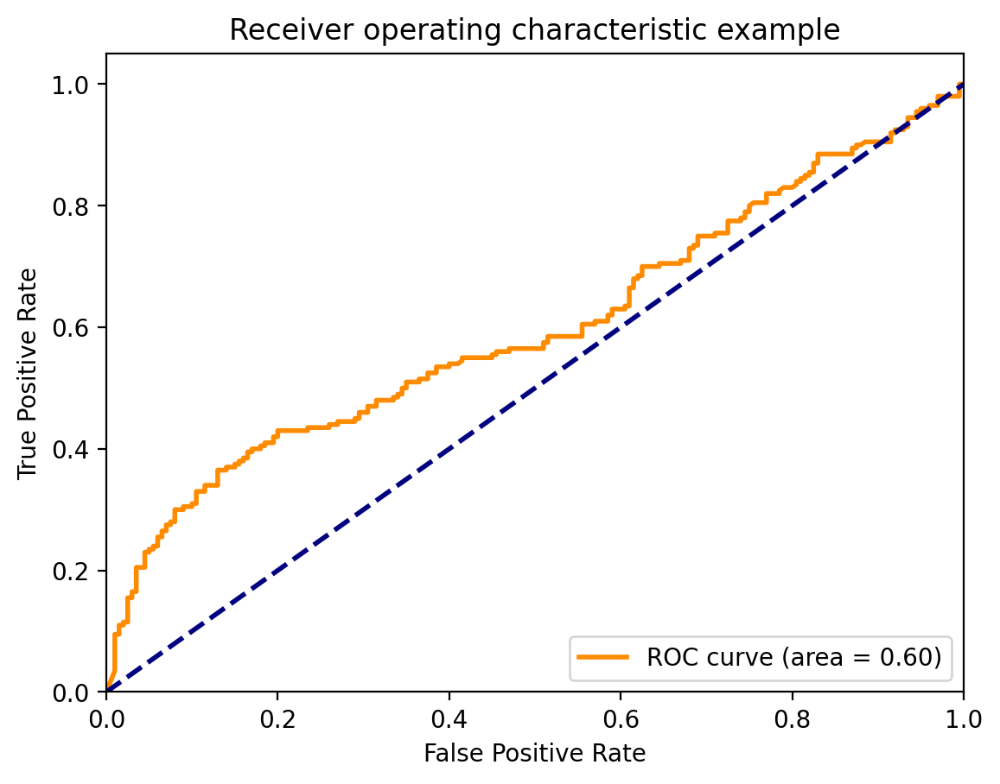

<ipython-input-442-090c2baad2d4>:45: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


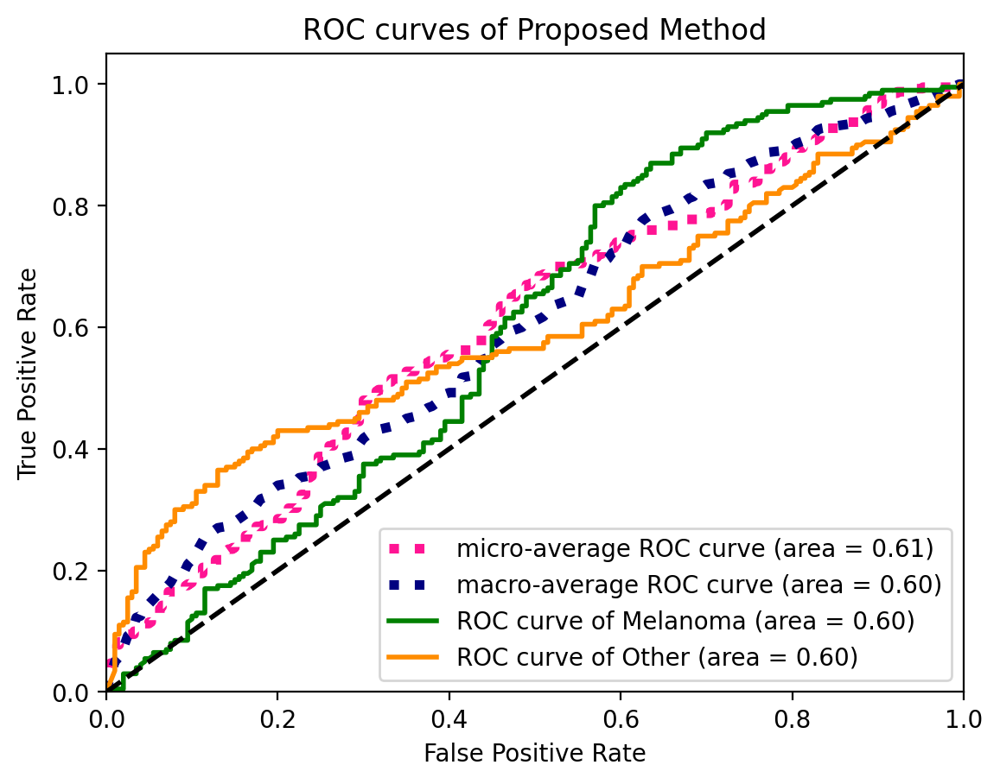

In [ ]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
#change to OneVsOneClassifier for generalized AUC
#from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_fscore_support

n_classes=2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[1], tpr[1], color='darkorange',lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

plt.plot(fpr[0], tpr[0], color='green', lw=lw,
         label='ROC curve of Melanoma (area = {1:0.2f})'
         ''.format(0, roc_auc[0]))

plt.plot(fpr[1], tpr[1], color='darkorange', lw=lw,
         label='ROC curve of Other (area = {1:0.2f})'
         ''.format(1, roc_auc[1]))

# if you need more classes
# plt.plot(fpr[2], tpr[2], color='red', lw=lw,
#          label='ROC curve of third class (area = {1:0.2f})'
#          ''.format(1, roc_auc[2]))

# plt.plot(fpr[3], tpr[3], color='cornflowerblue', lw=lw,
#          label='ROC curve of fourth class (area = {1:0.2f})'
#          ''.format(1, roc_auc[3]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curves of Proposed Method')
plt.legend(loc="lower right")
plt.show()

[[194   6]
 [168  32]]
[0 1]
[200 200]
[[200. 200.]
 [200. 200.]]


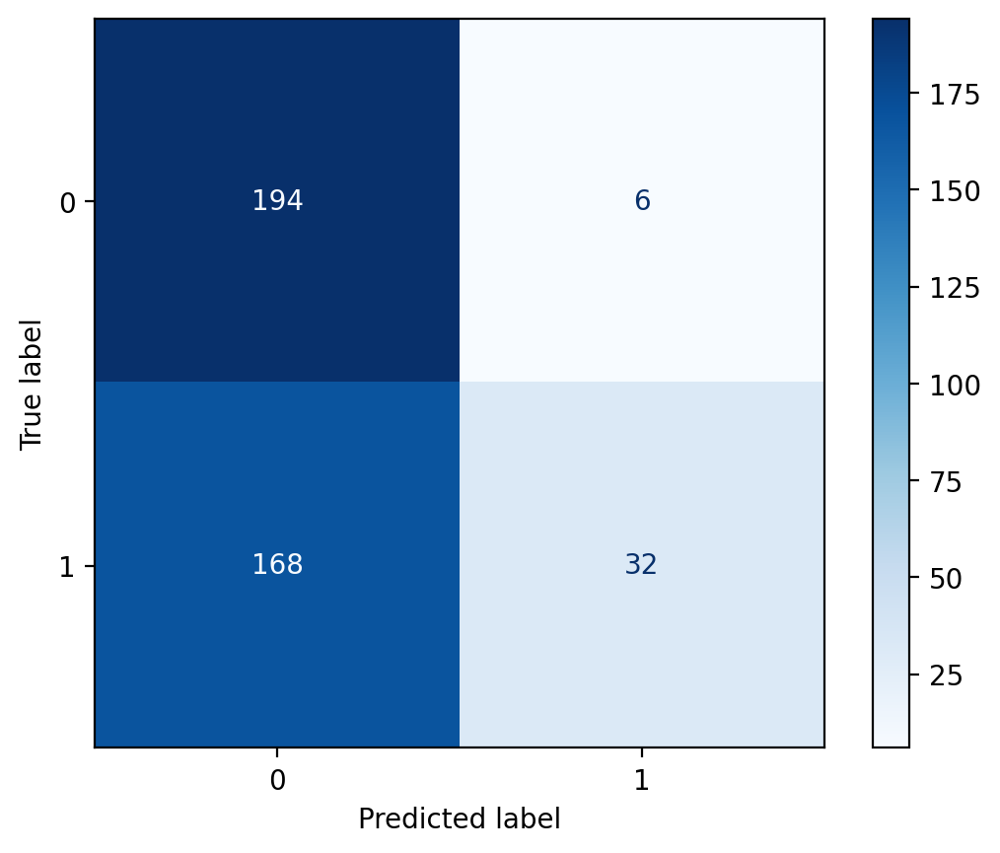

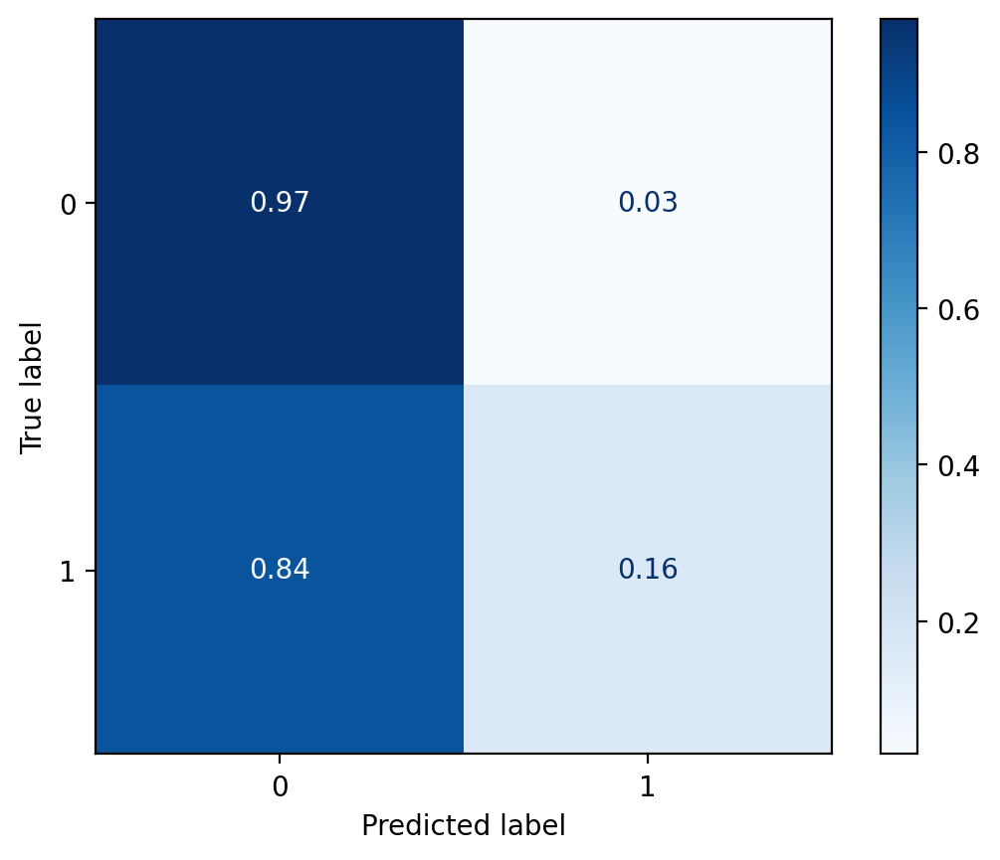

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from matplotlib.colors import Normalize
from sklearn.metrics import ConfusionMatrixDisplay

pred_class = np.argmax(probs,axis=1)
true_class = np.argmax(y_test, axis=1)

cm=confusion_matrix(true_class, pred_class)
class_names = unique_labels(true_class, pred_class)
print(cm)
print(class_names)

disp = ConfusionMatrixDisplay(cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)

C = cm
divisor = np.zeros((2,2))
divisor[0][:] = 200
divisor[1][:] = 200
cm_normalised=np.divide(cm, divisor)
print(np.transpose(C.sum(axis=1)))
print(divisor)
cm_normalised = np.round(cm_normalised, 2)
disp = ConfusionMatrixDisplay(cm_normalised, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, values_format='')

Calculating the precision, recall, and f1-score for the fine-tuned model

In [ ]:
cm = confusion_matrix(true_class, pred_class)
tp = cm[0, 0]
fp = cm[1, 0]
fn = cm[0, 1]
tn = cm[1, 1]

precision = tp/(tp + fp)
recall = tp/(tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)
specificity = tn / (tn + fp)

print("Precision: {:.2f}, Recall: {:.2f}, F1_score: {:.2f}, Specificity: {:.2f}".format(precision, recall, f1_score, specificity))


Precision: 0.54, Recall: 0.97, F1_score: 0.69, Specificity: 0.16
